<p style="background-color:#FF1493; font-family:calibri; color:white; font-size:40px; text-align:center; border-radius:50px 50px;">Breast Cancer Risk Prediction</p>

<img src="https://github.com/sanjushasuresh/BREAST-CANCER-RISK-PREDICTION/blob/main/Image.jpeg?raw=true" width="1000"> <p style="text-align:center">Image generated with Microsoft Designer</p>

# <p style="background-color:#FF1493; font-family:calibri; color:white; font-size:35px; text-align:center; border-radius:50px 50px;">1. Importing Libraries</p>

In [2]:
import pingouin as pg
import datetime as dt
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

from scipy.stats import mode
from scipy.stats import chi2_contingency
from sklearn.impute import KNNImputer
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, OrdinalEncoder, StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold, cross_val_score, GridSearchCV

from sklearn.metrics import roc_auc_score, roc_curve, mean_squared_error
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier

from lifelines import KaplanMeierFitter, CoxPHFitter
from lifelines.utils import concordance_index

import ipywidgets as widgets
from IPython.display import display, HTML

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

# <p style="background-color:#FF1493; font-family:calibri; color:white; font-size:35px; text-align:center; border-radius:50px 50px;">2. Data Collection</p>

In [5]:
df=pd.read_csv("Breast Cancer METABRIC.csv")

In [7]:
df.head()

,Patient ID,Age at Diagnosis,Type of Breast Surgery,Cancer Type,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,Overall Survival (Months),Overall Survival Status,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,Sex,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,MB-0000,75.65,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,NaN,No,claudin-low,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,4ER+,Right,10.0,NaN,6.044,IDC,140.500000,Living,Negative,Yes,138.65,Not Recurred,Female,ER-/HER2-,22.0,2.0,Living
1,MB-0002,43.19,Breast Conserving,Breast Cancer,Breast Invasive Ductal Carcinoma,High,No,LumA,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Pre,4ER+,Right,0.0,2.0,4.020,IDC,84.633333,Living,Positive,Yes,83.52,Not Recurred,Female,ER+/HER2- High Prolif,10.0,1.0,Living
2,MB-0005,48.87,Mastectomy,Breast Cancer,Breast Invasive Ductal Carcinoma,High,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Ductal/NST,Yes,Pre,3,Right,1.0,2.0,4.030,IDC,163.700000,Deceased,Positive,No,151.28,Recurred,Female,NaN,15.0,2.0,Died of Disease
3,MB-0006,47.68,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Mixed,Yes,Pre,9,Right,3.0,1.0,4.050,MDLC,164.933333,Living,Positive,Yes,162.76,Not Recurred,Female,NaN,25.0,2.0,Living
4,MB-0008,76.97,Mastectomy,Breast Cancer,Breast Mixed Ductal and Lobular Carcinoma,High,Yes,LumB,1.0,Positve,Positive,3.0,Neutral,Negative,Mixed,Yes,Post,9,Right,8.0,2.0,6.080,MDLC,41.366667,Deceased,Positive,Yes,18.55,Recurred,Female,ER+/HER2- High Prolif,40.0,2.0,Died of Disease


# <p style="background-color:#FF1493; font-family:calibri; color:white; font-size:35px; text-align:center; border-radius:50px 50px;">3. Data Overview</p>

<a id="basic"></a>
## <b><span style='color:#FF69B4'>Step 3.1 |</span><span style='color:#FF1493'> Dataset Basic Information</span></b>

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2509 entries, 0 to 2508
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Patient ID                      2509 non-null   object 
 1   Age at Diagnosis                2498 non-null   float64
 2   Type of Breast Surgery          1955 non-null   object 
 3   Cancer Type                     2509 non-null   object 
 4   Cancer Type Detailed            2509 non-null   object 
 5   Cellularity                     1917 non-null   object 
 6   Chemotherapy                    1980 non-null   object 
 7   Pam50 + Claudin-low subtype     1980 non-null   object 
 8   Cohort                          2498 non-null   float64
 9   ER status measured by IHC       2426 non-null   object 
 10  ER Status                       2469 non-null   object 
 11  Neoplasm Histologic Grade       2388 non-null   float64
 12  HER2 status measured by SNP6    19

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h2 align="left"><font color=#FF1493>Inferences:</font></h2>

* __Number of Entries__: The dataset consists of __2509 entries__, ranging from index 0 to 2508.
    
    
* __Columns__: There are __34 columns__ in the dataset corresponding to various attributes of the patients.
    
    
* __Data Types__: Most of the columns (24 out of 34) are of the __object__ data type.
    
    
* __Missing Values__: There are missing values in many columns, except in Patient ID, Cancer Type, Cancer Type Detailed, Oncotree Code, and Sex columns.

<a id="num_statistics"></a>
## <b><span style='color:#FF69B4'>Step 3.2 |</span><span style='color:#FF1493'> Summary Statistics for Numerical Variables</span></b>

In [15]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age at Diagnosis,2498.0,60.420300,13.032997,21.93,50.920000,61.110000,70.000000,96.29
Cohort,2498.0,2.900320,1.962216,1.00,1.000000,3.000000,4.000000,9.00
Neoplasm Histologic Grade,2388.0,2.412060,0.649363,1.00,2.000000,3.000000,3.000000,3.00
Lymph nodes examined positive,2243.0,1.950513,4.017774,0.00,0.000000,0.000000,2.000000,45.00
Mutation Count,2357.0,5.578702,3.967967,1.00,3.000000,5.000000,7.000000,80.00
Nottingham prognostic index,2287.0,4.028787,1.189092,1.00,3.048000,4.044000,5.040000,7.20
Overall Survival (Months),1981.0,125.244271,76.111772,0.00,60.866667,116.466667,185.133333,355.20
Relapse Free Status (Months),2388.0,108.842487,76.519494,0.00,40.560000,99.095000,167.640000,384.21
Tumor Size,2360.0,26.220093,15.370883,1.00,17.000000,22.410000,30.000000,182.00
Tumor Stage,1788.0,1.713647,0.655307,0.00,1.000000,2.000000,2.000000,4.00


<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Numerical Features:</font></h3>

* __`Age at Diagnosis`__: The average age of the patients is approximately 60 years, with the youngest being 21 and the oldest 96 years.
* __`Cohort`__: The average cohort group to which many patients belong is approximately the 3rd group, ranging from 1 to 9.
* __`Neoplasm Histologic Grade`__: The average histologic grade of the neoplasm is around 2.4, ranging from 1 to 3.
* __`Lymph nodes examined positive`__: The average number of lymph nodes that tested positive for cancer is around 2(1.95), with a range from 0 to 45.
* __`Mutation Count`__: The average of the total number of genetic mutations identified in the tumor is about 5.57, with values ranging from 1 to 80.
* __`Nottingham prognostic index`__: The average prognostic score based on tumor size, lymph node status, and histologic grade is 4, ranging from 1 to 7(7.2).
* __`Overall Survival (Months)`__: The average of the total number of months survived by patients is about 125 months, with a minimum of 0 months and a maximum of 355 months.
* __`Relapse Free Status (Months)`__: The average time in months the patient remained free from cancer relapse is 108 months, with a minimum of 0 months and a maximum of 384 months.
* __`Tumor Size`__: The average size of the primary tumor is 26 mm, with the smallest size being 1 mm and the largest being 182 mm.
* __`Tumor Stage`__: The average stage of the tumor is 1.7; approximately 2, ranging from 0 to 4.

<a id="cat_statistics"></a>
## <b><span style='color:#FF69B4'>Step 3.3 |</span><span style='color:#FF1493'> Summary Statistics for Categorical  Variables</span></b>

In [19]:
df.describe(include='object').T

,count,unique,top,freq
Patient ID,2509,2509,MB-0000,1
Type of Breast Surgery,1955,2,Mastectomy,1170
Cancer Type,2509,2,Breast Cancer,2506
Cancer Type Detailed,2509,8,Breast Invasive Ductal Carcinoma,1865
Cellularity,1917,3,High,965
Chemotherapy,1980,2,No,1568
Pam50 + Claudin-low subtype,1980,7,LumA,700
ER status measured by IHC,2426,2,Positve,1817
ER Status,2469,2,Positive,1825
HER2 status measured by SNP6,1980,4,Neutral,1436


<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Categorical Features:</font></h3>

* __`Patient ID`__: All the values in Patient ID are unique.
* __`Type of Breast Surgery`__: Two unique types of breast surgery are present. The most common type is "__Mastectomy__", occurring 1170 times.
* __`Cancer Type`__: There are two types of cancer, and the most frequent one is "__Breast Cancer__", which appears 2506 times.
* __`Cancer Type Detailed`__: Eight unique subtypes of cancer are present. The most common result is "__Breast Invasive Ductal Carcinoma__", appearing 1865 times.
  - Indicating that most of the women are diagnosed with the Breast Invasive Ductal Carcinoma Cancer.
* __`Cellularity`__: There are three unique values, which is 'High', 'Moderate', and 'Low'. The most frequent value is "__High__" , which is observed 965 times.
* __`Chemotherapy`__: Two unique values are present, indicating 'Yes' or 'No'. The most frequent is "__No__", which occurs 1568 times.
  - Indicating that most of the patients did not get the chemotherapy treatment.
* __`Pam50 + Claudin-low subtype`__: There are seven unique values for the number of subtypes based on gene expression profiling, including Pam50 and Claudin-low classifications, with "__LumA__" being the most frequent, occurring 700 times.
* __`ER status measured by IHC`__: Two unique results are available. The most common estrogen receptor status as measured by Immunohistochemistry is "__Positive__", observed 1817 times.
* __`ER Status`__: Two unique results are available. The most common ER Status is again "__Positive__", observed 1825 times.
* __`HER2 status measured by SNP6`__: There are four unique values. Out of which "__Neutral__" status is the highest, occurring 1436 times.
* __`HER2 Status`__: Two unique values are present, indicating 'Positive' or 'Negative'. The most frequent is "__Negative__", which occurs 1733 times.
* __`Tumor Other Histologic Subtype`__: There are eight other histologic subtypes of tumor. Where "__Ductal/NST__" subtype is the most common with 1810 occurrences. 
* __`Hormone Therapy`__: Two unique values are present, indicating 'Yes' or 'No'. The most frequent is "__Yes__", which occurs 1216 times.
  - Indicating that most of the patients got the hormone therapy treatment.
* __`Inferred Menopausal State`__: There are two menopausal states. And most of the patients i.e. 1556 patients are in "__Postmenopausal__" state.
* __`Integrative Cluster`__: There are 11 integrative clusters. Out of which "__8th__" cluster is most common, ocurring 299 times.
* __`Primary Tumor Laterality`__: Two unique values of laterality are present, which is 'Left' or 'Right'. The most common is "__Left__", which occurs 973 times.
* __`Oncotree Code`__: There are eight unique codes that represents the type of cancer based on the OncoTree classification, with "__IDC__" being the most frequent, occurring 1865 times.
* __`Overall Survival Status`__: Two unique values indicate the 'Living' or 'Deceased' status. And most of the patients i.e. 1144 patients are "__Deceased__".
* __`PR Status`__: Two unique results are available. The most common ER Status is again "__Positive__", observed 1040 times.
* __`Radio Therapy`__: Two unique values are present, indicating 'Yes' or 'No'. The most frequent is "__Yes__", which occurs 1173 times.
  - Indicating that most of the patients got the radio therapy treatment.
* __`Relapse Free Status`__: Two unique results are available. The most common Status is "__Not Recurred__", observed 1486 times.
  - Indicating that most of the patients did not have a relapse of cancer.
* __`Sex`__: There is only 1 unique value, which is obviously "__Female__"
* __`3-Gene classifier subtype`__: There are 4 subtypes based on the expression of three specific genes. The most frequent is "__ER+/HER2- Low Prolif__", which occurs 640 times.
* __`Patient's Vital Status`__: There are three unique values, which is 'Living', 'Died of Disease', and 'Died of other causes'. The most frequent value is "__Living__" , which is observed 837 times.

# <p style="background-color:#FF1493; font-family:calibri; color:white; font-size:35px; text-align:center; border-radius:50px 50px;">4. Data Preprocessing</p>

<a id="cat_statistics"></a>
## <b><span style='color:#FF69B4'>Step 4.1 |</span><span style='color:#FF1493'>  Irrelevant Feature Removal</span></b>

In [24]:
df['Cancer Type'].value_counts()

Cancer Type
Breast Cancer     2506
Breast Sarcoma       3
Name: count, dtype: int64

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">
The 'Cancer Type' and the 'Cancer Type Detailed' columns are similar. The column 'Cancer Type' does not have much value, as it indicates most of the values as Breast Cancer. Whereas, 'Cancer Type Detailed' column gives us more information. So we will drop the 'Cancer Type' column. Along with it we will also drop the 'Patient ID' and 'Sex' columns as they don't help us in yiedling better results.

In [27]:
df.drop(['Patient ID', 'Sex', 'Cancer Type'], axis=1, inplace=True)

In [29]:
df['Integrative Cluster'].value_counts()

Integrative Cluster
8       299
3       290
4ER+    260
10      226
7       190
5       190
9       146
1       139
6        85
4ER-     83
2        72
Name: count, dtype: int64

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">
    
* Integrative clusters are divided into 10 categories. Here 4ER+ & 4ER- are together in the 4th cluster. So we need to replace those two values. 
* 'Integrative Cluster' consists of numerical values but are of object datatype. So let us change the datatype for better interpretation.

In [32]:
df['Integrative Cluster'] = df['Integrative Cluster'].str.replace('4ER+', '4')
df['Integrative Cluster'] = df['Integrative Cluster'].str.replace('4ER-', '4')

In [34]:
df['Integrative Cluster'] = pd.to_numeric(df['Integrative Cluster'], errors='coerce')

In [36]:
df.shape

(2509, 31)

In [38]:
df.head()

,Age at Diagnosis,Type of Breast Surgery,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,Overall Survival (Months),Overall Survival Status,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,75.65,Mastectomy,Breast Invasive Ductal Carcinoma,NaN,No,claudin-low,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,4.0,Right,10.0,NaN,6.044,IDC,140.500000,Living,Negative,Yes,138.65,Not Recurred,ER-/HER2-,22.0,2.0,Living
1,43.19,Breast Conserving,Breast Invasive Ductal Carcinoma,High,No,LumA,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Pre,4.0,Right,0.0,2.0,4.020,IDC,84.633333,Living,Positive,Yes,83.52,Not Recurred,ER+/HER2- High Prolif,10.0,1.0,Living
2,48.87,Mastectomy,Breast Invasive Ductal Carcinoma,High,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Ductal/NST,Yes,Pre,3.0,Right,1.0,2.0,4.030,IDC,163.700000,Deceased,Positive,No,151.28,Recurred,NaN,15.0,2.0,Died of Disease
3,47.68,Mastectomy,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Mixed,Yes,Pre,9.0,Right,3.0,1.0,4.050,MDLC,164.933333,Living,Positive,Yes,162.76,Not Recurred,NaN,25.0,2.0,Living
4,76.97,Mastectomy,Breast Mixed Ductal and Lobular Carcinoma,High,Yes,LumB,1.0,Positve,Positive,3.0,Neutral,Negative,Mixed,Yes,Post,9.0,Right,8.0,2.0,6.080,MDLC,41.366667,Deceased,Positive,Yes,18.55,Recurred,ER+/HER2- High Prolif,40.0,2.0,Died of Disease


<a id="cat_statistics"></a>
## <b><span style='color:#FF69B4'>Step 4.2 |</span><span style='color:#FF1493'>  Missing Values Treatment</span></b>

In [41]:
df.isna().sum()

Age at Diagnosis                   11
Type of Breast Surgery            554
Cancer Type Detailed                0
Cellularity                       592
Chemotherapy                      529
Pam50 + Claudin-low subtype       529
Cohort                             11
ER status measured by IHC          83
ER Status                          40
Neoplasm Histologic Grade         121
HER2 status measured by SNP6      529
HER2 Status                       529
Tumor Other Histologic Subtype    135
Hormone Therapy                   529
Inferred Menopausal State         529
Integrative Cluster               529
Primary Tumor Laterality          639
Lymph nodes examined positive     266
Mutation Count                    152
Nottingham prognostic index       222
Oncotree Code                       0
Overall Survival (Months)         528
Overall Survival Status           528
PR Status                         529
Radio Therapy                     529
Relapse Free Status (Months)      121
Relapse Free

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

* All other columns have missing values except the 'Cancer Type Detailed' and 'Oncotree Code' columns.
* Let us treat the missing values in the columns using the imputation methods.

<a id="cat_statistics"></a>
### <b><span style='color:#FF69B4'>Step 4.2.1 |</span><span style='color:#FF1493'>  Treating missing values in categorical columns</span></b>

### <b><span style='color:#FF69B4'>Mode imputation for categorical features

In [52]:
categorical_columns = df.iloc[:, [1, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 16, 20, 22, 23, 24, 26, 27, 30]]

In [48]:
# Using the mode imputation
for column in categorical_columns:
    df[column].fillna(df[column].mode()[0], inplace=True)

In [54]:
categorical_columns.isna().sum()

Type of Breast Surgery            0
Cancer Type Detailed              0
Cellularity                       0
Chemotherapy                      0
Pam50 + Claudin-low subtype       0
ER status measured by IHC         0
ER Status                         0
HER2 status measured by SNP6      0
HER2 Status                       0
Tumor Other Histologic Subtype    0
Hormone Therapy                   0
Inferred Menopausal State         0
Primary Tumor Laterality          0
Oncotree Code                     0
Overall Survival Status           0
PR Status                         0
Radio Therapy                     0
Relapse Free Status               0
3-Gene classifier subtype         0
Patient's Vital Status            0
dtype: int64

### <b><span style='color:#FF69B4'>Step 4.2.2 |</span><span style='color:#FF1493'>  Treating missing values in numerical columns</span></b>

### <b><span style='color:#FF69B4'>Median imputation for numerical/continuous features

In [64]:
numerical_columns = df.iloc[:, [0, 6, 9, 15, 17, 18, 19, 21, 25, 28, 29]]

In [60]:
# Using the median imputation
for column in numerical_columns:
    df[column].fillna(df[column].median(), inplace=True)

In [66]:
numerical_columns.isna().sum()

Age at Diagnosis                 0
Cohort                           0
Neoplasm Histologic Grade        0
Integrative Cluster              0
Lymph nodes examined positive    0
Mutation Count                   0
Nottingham prognostic index      0
Overall Survival (Months)        0
Relapse Free Status (Months)     0
Tumor Size                       0
Tumor Stage                      0
dtype: int64

In [68]:
df.isna().sum()

Age at Diagnosis                  0
Type of Breast Surgery            0
Cancer Type Detailed              0
Cellularity                       0
Chemotherapy                      0
Pam50 + Claudin-low subtype       0
Cohort                            0
ER status measured by IHC         0
ER Status                         0
Neoplasm Histologic Grade         0
HER2 status measured by SNP6      0
HER2 Status                       0
Tumor Other Histologic Subtype    0
Hormone Therapy                   0
Inferred Menopausal State         0
Integrative Cluster               0
Primary Tumor Laterality          0
Lymph nodes examined positive     0
Mutation Count                    0
Nottingham prognostic index       0
Oncotree Code                     0
Overall Survival (Months)         0
Overall Survival Status           0
PR Status                         0
Radio Therapy                     0
Relapse Free Status (Months)      0
Relapse Free Status               0
3-Gene classifier subtype   

## <b><span style='color:#FF69B4'>Step 4.3 |</span><span style='color:#FF1493'>  Duplicate Treatment</span></b>

In [71]:
# Checking for duplicate values
duplicates = df[df.duplicated(keep='first')]
print(duplicates.shape)
duplicates

(6, 31)


,Age at Diagnosis,Type of Breast Surgery,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,Overall Survival (Months),Overall Survival Status,PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
2144,61.11,Mastectomy,Invasive Breast Carcinoma,High,No,LumA,3.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,5.0,Left,0.0,5.0,4.044,BRCA,116.466667,Deceased,Positive,Yes,99.095,Not Recurred,ER+/HER2- Low Prolif,22.41,0.0,Living
2307,43.00,Mastectomy,Breast Invasive Ductal Carcinoma,High,No,LumA,7.0,Positve,Positive,2.0,Neutral,Negative,Ductal/NST,Yes,Post,5.0,Left,0.0,1.0,4.044,IDC,116.466667,Deceased,Positive,Yes,99.095,Not Recurred,ER+/HER2- Low Prolif,22.41,2.0,Living
2320,61.11,Mastectomy,Invasive Breast Carcinoma,High,No,LumA,3.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,5.0,Left,0.0,5.0,4.044,BRCA,116.466667,Deceased,Positive,Yes,99.095,Not Recurred,ER+/HER2- Low Prolif,22.41,0.0,Living
2324,61.11,Mastectomy,Invasive Breast Carcinoma,High,No,LumA,3.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,5.0,Left,0.0,5.0,4.044,BRCA,116.466667,Deceased,Positive,Yes,99.095,Not Recurred,ER+/HER2- Low Prolif,22.41,0.0,Living
2496,61.11,Mastectomy,Invasive Breast Carcinoma,High,No,LumA,3.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,5.0,Left,0.0,5.0,4.044,BRCA,116.466667,Deceased,Positive,Yes,99.095,Not Recurred,ER+/HER2- Low Prolif,22.41,0.0,Living
2508,61.11,Mastectomy,Invasive Breast Carcinoma,High,No,LumA,3.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,5.0,Left,0.0,5.0,4.044,BRCA,116.466667,Deceased,Positive,Yes,99.095,Not Recurred,ER+/HER2- Low Prolif,22.41,0.0,Living


In [73]:
# Dropping the duplicate columns
df.drop_duplicates(inplace=True)

## <b><span style='color:#FF69B4'>Step 4.4 |</span><span style='color:#FF1493'>  Outlier Treatment</span></b>

In [76]:
# Checking for the skewness
!pip install scipy
import scipy
scipy.stats.skew(df.iloc[:, [0, 6, 9, 15, 17, 18, 19, 21, 25, 28, 29]], axis = 0, bias = True)

array([-0.15653841,  1.24395067, -0.72560001,  0.22292996,  4.04480675,
        4.97297356, -0.07934035,  0.49796071,  0.54973258,  3.14771032,
       -0.1175147 ])

### <b><span style='color:#FF69B4'>Step 4.4.1 |</span><span style='color:#FF1493'> Checking and printing the outliers in the numerical columns</span></b>

In [79]:
for column in numerical_columns:
  print(f"\nValue counts for {column}:")
  freq = df[column].value_counts(normalize=False)
  print(freq)


Value counts for Age at Diagnosis:
Age at Diagnosis
52.00    11
45.00    11
47.00    10
64.00    10
60.00     9
         ..
69.52     1
61.97     1
81.11     1
37.53     1
67.58     1
Name: count, Length: 1843, dtype: int64

Value counts for Cohort:
Cohort
1.0    809
3.0    769
2.0    288
4.0    238
5.0    170
7.0    104
8.0     82
9.0     40
6.0      3
Name: count, dtype: int64

Value counts for Neoplasm Histologic Grade:
Neoplasm Histologic Grade
3.0    1314
2.0     975
1.0     214
Name: count, dtype: int64

Value counts for Integrative Cluster:
Integrative Cluster
5.0     713
4.0     343
8.0     299
3.0     290
10.0    226
7.0     190
9.0     146
1.0     139
6.0      85
2.0      72
Name: count, dtype: int64

Value counts for Lymph nodes examined positive:
Lymph nodes examined positive
0.0     1456
1.0      379
2.0      189
3.0      127
4.0       63
6.0       52
5.0       49
7.0       29
8.0       22
9.0       18
14.0      17
10.0      14
11.0      14
16.0      11
15.0      10
12.0 

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

* The numerical columns with many unique values are 'Age at Diagnosis', 'Nottingham prognostic index', 'Overall Survival (Months)', and 'Relapse Free Status (Months)'. We cannot manually check the outliers and remove them, so we will use the IQR method for them later.
* The numerical columns with less range of unique values are 'Cohort', 'Neoplasm Histologic Grade', 'Integrative Cluster', 'Lymph nodes examined positive', 'Mutation Count', 'Tumor Size', and 'Tumor Stage'. We can initially check the outliers manually and double-check with the IQR method.
* In Cohort, we can see that 6 has the lowest count. It can be considered as an outlier so we will drop it.
* Neoplasm Histologic Grade seems to have a good distribution of count for each grade. There are no outliers in this column.
* In the Integrative Cluster, even though cluster 2 has less count compared to others, they can be potential data points. 
* The number of lymph nodes is constant till 26. The remaining lymph nodes are 30, 31, 33, 41, 45. Also, they occur only once, so we will drop those values where the lymph nodes are greater than 25.
* Similarly, the mutation count is constant till 23. We will drop the values greater than 23.
* There is an irregular distribution of tumor sizes. The extreme values are 120, 130, 150, 160, 180, and 182, where most of them occur only once. So let us drop the values greater than 100.
* In the Tumor Stage, even though stage 4 has less count compared to others, they can be potential data points. 

In [82]:
df.drop(df[df['Cohort'] == 6].index, inplace=True)

In [84]:
df.drop(df[df['Lymph nodes examined positive'] > 25].index, inplace=True)

In [86]:
df.drop(df[df['Mutation Count'] > 23].index, inplace=True)

In [88]:
df.drop(df[df['Tumor Size'] > 100].index, inplace=True)

In [90]:
def detect_outliers_iqr(df, column):
    """Detects outliers in a column using the IQR method.

    Args:
        df: The DataFrame containing the data.
        column: The name of the column to check for outliers.

    Returns:
        A list of outliers in the given column.
    """
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[column][(df[column] < lower_bound) | (df[column] > upper_bound)].tolist()
    return outliers

# Finding and printing outliers for each numeric column
for column in df.select_dtypes(include='number').columns:
    outliers = detect_outliers_iqr(df, column)
    print(f"Outliers in {column}: {outliers}")

Outliers in Age at Diagnosis: [21.93]
Outliers in Cohort: [9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0, 9.0]
Outliers in Neoplasm Histologic Grade: []
Outliers in Integrative Cluster: []
Outliers in Lymph nodes examined positive: [10.0, 8.0, 11.0, 24.0, 16.0, 6.0, 6.0, 9.0, 6.0, 22.0, 7.0, 7.0, 6.0, 7.0, 6.0, 21.0, 13.0, 6.0, 7.0, 12.0, 9.0, 6.0, 8.0, 8.0, 14.0, 25.0, 6.0, 6.0, 10.0, 6.0, 6.0, 7.0, 6.0, 10.0, 7.0, 16.0, 6.0, 15.0, 13.0, 11.0, 8.0, 19.0, 15.0, 16.0, 19.0, 11.0, 7.0, 22.0, 6.0, 15.0, 18.0, 6.0, 17.0, 7.0, 10.0, 21.0, 7.0, 23.0, 7.0, 6.0, 8.0, 14.0, 14.0, 6.0, 14.0, 25.0, 15.0, 13.0, 9.0, 9.0, 8.0, 12.0, 6.0, 10.0, 9.0, 15.0, 10.0, 6.0, 11.0, 7.0, 18.0, 11.0, 9.0, 8.0, 7.0, 6.0, 6.0, 6.0, 8.0, 7.0, 6.0, 6.0, 10.0, 6.0, 13.0, 16.0, 8.0, 24.0, 18.0, 7.0, 6.0, 6.0, 9.0, 14.0, 9.0, 8.0, 9.0, 11.0, 11.0, 7.0, 19.0, 14.0, 6.0, 12.0, 6.

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

* We can safely drop the outliers in 'Age at Diagnosis', 'Overall Survival (Months)', and 'Relapse Free Status (Months)' since they are less in number.
* But the outliers in 'Cohort', 'Lymph nodes examined positive', 'Mutation Count', 'Tumor Size', and 'Tumor Stage' can be potential data points. **An outlier can be a possible observation even if it's an extreme. We must only remove outliers if they are errors in the data. Removing them can sometimes lead to wrong analysis. Such outliers are called "true outliers".**
* Since we are not dropping the other outliers, we can use transformation methods later in code to mitigate their effects without losing valuable data.

In [93]:
df.drop(df[df['Age at Diagnosis'] == 21.93].index, inplace=True)

In [95]:
df.drop(df[df['Overall Survival (Months)'].isin([337.03333330000004, 298.03333330000004, 355.2, 330.3666667, 335.7333333, 335.6, 300.7, 307.9333333, 307.6333333, 296.8666667, 322.8333333, 318.2, 300.8666667, 297.8, 297.2333333, 299.4, 301.2333333])].index, inplace=True)

In [97]:
df.drop(df[df['Relapse Free Status (Months)'].isin([346.38, 359.08, 384.21, 370.03])].index, inplace=True)

### <b><span style='color:#FF69B4'>Step 4.4.2 |</span><span style='color:#FF1493'> Checking and printing the outliers in the categorical columns</span></b>

In [100]:
for column in categorical_columns:
  print(f"Value counts for {column}:")
  freq = df[column].value_counts(normalize=False)
  outliers = freq[freq < 0.01 * len(df)]
  print(freq)
  print(f"Outliers in {outliers}: \n")

Value counts for Type of Breast Surgery:
Type of Breast Surgery
Mastectomy           1680
Breast Conserving     776
Name: count, dtype: int64
Outliers in Series([], Name: count, dtype: int64): 

Value counts for Cancer Type Detailed:
Cancer Type Detailed
Breast Invasive Ductal Carcinoma             1831
Breast Mixed Ductal and Lobular Carcinoma     264
Breast Invasive Lobular Carcinoma             187
Invasive Breast Carcinoma                     124
Breast Invasive Mixed Mucinous Carcinoma       25
Breast                                         21
Breast Angiosarcoma                             2
Metaplastic Breast Cancer                       2
Name: count, dtype: int64
Outliers in Cancer Type Detailed
Breast                       21
Breast Angiosarcoma           2
Metaplastic Breast Cancer     2
Name: count, dtype: int64: 

Value counts for Cellularity:
Cellularity
High        1520
Moderate     723
Low          213
Name: count, dtype: int64
Outliers in Series([], Name: count, dtype:

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

* Here, we are filtering the frequency counts to identify values that occur less than 1% of the time that can be considered outliers.
* There appears to be outliers in 'Cancer Type Detailed', 'Pam50 + Claudin-low subtype', 'HER2 status measured by SNP6', 'Tumor Other Histologic Subtype', and 'Oncotree Code'.
* We can safely drop the necessary outliers in those columns.

In [103]:
exclude = ('Breast', 'Breast Angiosarcoma', 'Metaplastic Breast Cancer')
df = df[~(df['Cancer Type Detailed'].isin(exclude))]

In [105]:
df = df[~(df['Pam50 + Claudin-low subtype'].isin(['NC']))]

In [107]:
df = df[~(df['HER2 status measured by SNP6'].isin(['Undef']))]

In [109]:
exclude = ('Other', 'Metaplastic')
df = df[~(df['Tumor Other Histologic Subtype'].isin(exclude))]

In [111]:
exclude = ('PBS', 'MBC')
df = df[~(df['Oncotree Code'].isin(exclude))]

In [113]:
df.shape

(2420, 31)

# <p style="background-color:#FF1493; font-family:calibri; color:white; font-size:35px; text-align:center; border-radius:50px 50px;">5. EDA</p>

## <b><span style='color:#FF69B4'>Step 5.1 |</span><span style='color:#FF1493'> Summary Statistics</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">
Let us check the summary statistics again after the cleaning process to get a good idea of how the data is distributed now.

### <b><span style='color:#FF69B4'>Step 5.1.1 |</span><span style='color:#FF1493'> Summary Statistics for Numerical Variables</span></b>

In [119]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age at Diagnosis,2420.0,60.476649,13.015275,26.36,50.935000,61.110000,70.042500,96.290000
Cohort,2420.0,2.899587,1.965872,1.00,1.000000,3.000000,4.000000,9.000000
Neoplasm Histologic Grade,2420.0,2.437603,0.647308,1.00,2.000000,3.000000,3.000000,3.000000
Integrative Cluster,2420.0,5.559504,2.457109,1.00,4.000000,5.000000,8.000000,10.000000
Lymph nodes examined positive,2420.0,1.642562,3.422551,0.00,0.000000,0.000000,2.000000,25.000000
Mutation Count,2420.0,5.430165,3.195517,1.00,3.000000,5.000000,7.000000,23.000000
Nottingham prognostic index,2420.0,4.029924,1.119355,1.00,3.052000,4.044000,5.036000,7.200000
Overall Survival (Months),2420.0,122.198471,65.849719,0.00,76.208333,116.466667,162.783333,292.666667
Relapse Free Status (Months),2420.0,107.124023,72.867170,0.00,42.600000,99.095000,162.387500,332.930000
Tumor Size,2420.0,25.610694,13.232858,1.00,18.000000,22.410000,30.000000,100.000000


<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Numerical Features:</font></h3>

* __`Age at Diagnosis`__: The average age of the patients is approximately 60 years, with the youngest being 26 and the oldest 96 years.
* __`Cohort`__: The average cohort group to which many patients belong is approximately the 3rd group, ranging from 1 to 9.
* __`Neoplasm Histologic Grade`__: The average histologic grade of the neoplasm is around 2.4, ranging from 1 to 3.
* __`Integrative Cluster`__: The average number of integrative cluster is 5.5(6), ranging from 1 to 10.
* __`Lymph nodes examined positive`__: The average number of lymph nodes that tested positive for cancer is around 1.64, with a range from 0 to 25.
* __`Mutation Count`__: The average of the total number of genetic mutations identified in the tumor is about 5.43, with values ranging from 1 to 23.
* __`Nottingham prognostic index`__: The average prognostic score based on tumor size, lymph node status, and histologic grade is 4, ranging from 1 to 7(7.2).
* __`Overall Survival (Months)`__: The average of the total number of months survived by patients is about 122 months, with a minimum of 0 months and a maximum of 292 months.
* __`Relapse Free Status (Months)`__: The average time in months the patient remained free from cancer relapse is 107 months, with a minimum of 0 months and a maximum of 332 months.
* __`Tumor Size`__: The average size of the primary tumor is 25 mm, with the smallest size being 1 mm and the largest being 100 mm.
* __`Tumor Stage`__: The average stage of the tumor is 1.8; approximately 2, ranging from 0 to 4.

### <b><span style='color:#FF69B4'>Step 5.1.2 |</span><span style='color:#FF1493'> Summary Statistics for Categorical Variables</span></b>

In [123]:
df.describe(include='object').T

,count,unique,top,freq
Type of Breast Surgery,2420,2,Mastectomy,1656
Cancer Type Detailed,2420,5,Breast Invasive Ductal Carcinoma,1822
Cellularity,2420,3,High,1499
Chemotherapy,2420,2,No,2023
Pam50 + Claudin-low subtype,2420,6,LumA,1190
ER status measured by IHC,2420,2,Positve,1831
ER Status,2420,2,Positive,1799
HER2 status measured by SNP6,2420,3,Neutral,1897
HER2 Status,2420,2,Negative,2178
Tumor Other Histologic Subtype,2420,6,Ductal/NST,1892


<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Categorical Features:</font></h3>

* __`Type of Breast Surgery`__: Two unique types of breast surgery are present. The most common type is "__Mastectomy__", occurring 1656 times.
* __`Cancer Type Detailed`__: Five unique subtypes of cancer are present. The most common result is "__Breast Invasive Ductal Carcinoma__", appearing 1822 times.
  - Indicating that most of the women are diagnosed with Breast Invasive Ductal Carcinoma Cancer.
* __`Cellularity`__: There are three unique values, which are 'High', 'Moderate', and 'Low'. The most frequent value is "__High__", which is observed 1499 times.
* __`Chemotherapy`__: Two unique values are present, indicating 'Yes' or 'No'. The most frequent is "__No__", which occurs 2023 times.
  - Indicating that most of the patients did not get the chemotherapy treatment.
* __`Pam50 + Claudin-low subtype`__: There are six unique values for the number of subtypes based on gene expression profiling, including Pam50 and Claudin-low classifications, with "__LumA__" being the most frequent, occurring 1190 times.
* __`ER status measured by IHC`__: Two unique results are available. The most common estrogen receptor status as measured by Immunohistochemistry is "__Positive__", observed 1813 times.
* __`ER Status`__: Two unique results are available. The most common ER Status is again "__Positive__", observed 1799 times.
* __`HER2 status measured by SNP6`__: There are three unique values. Out of which "__Neutral__" status is the highest, occurring 1897 times.
* __`HER2 Status`__: Two unique values are present, indicating 'Positive' or 'Negative'. The most frequent is "__Negative__", which occurs 2178 times.
* __`Tumor Other Histologic Subtype`__: There are six other histologic subtypes of tumor. Where the "__Ductal/NST__" subtype is the most common with 1892 occurrences. 
* __`Hormone Therapy`__: Two unique values are present, indicating 'Yes' or 'No'. The most frequent is "__Yes__", which occurs 1696 times.
  - Indicating that most of the patients got the hormone therapy treatment.
* __`Inferred Menopausal State`__: There are two menopausal states. And most of the patients i.e. 2010 patients are in the "__Postmenopausal__" state.
* __`Primary Tumor Laterality`__: Two unique values of laterality are present, which are 'Left' or 'Right'. The most common is "__Left__", which occurs 1548 times.
* __`Oncotree Code`__: There are five unique codes that represent the type of cancer based on the OncoTree classification, with "__IDC__" being the most frequent, occurring 1822 times.
* __`Overall Survival Status`__: Two unique values indicate the 'Living' or 'Deceased' status. And most of the patients i.e. 1614 patients are "__Deceased__".
* __`PR Status`__: Two unique results are available. The most common ER Status is again "__Positive__", observed 1511 times.
* __`Radio Therapy`__: Two unique values are present, indicating 'Yes' or 'No'. The most frequent is "__Yes__", which occurs 1643 times.
  - Indicating that most of the patients got the radiotherapy treatment.
* __`Relapse Free Status`__: Two unique results are available. The most common Status is "__Not Recurred__", observed 1456 times.
  - Indicating that most of the patients did not have a relapse of cancer.
* __`3-Gene classifier subtype`__: There are 4 subtypes based on the expression of three specific genes. The most frequent is "__ER+/HER2- Low Prolif__", which occurs 1336 times.
* __`Patient's Vital Status`__: There are three unique values, which are 'Living', 'Died of Disease', and 'Died of other causes'. The most frequent value is "__Living__", which is observed 1315 times.

## <b><span style='color:#FF69B4'>Step 5.2 |</span><span style='color:#FF1493'> Univariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Step 5.2.1 |</span><span style='color:#FF1493'> Numerical Variables Univariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Histogram KDE Plot

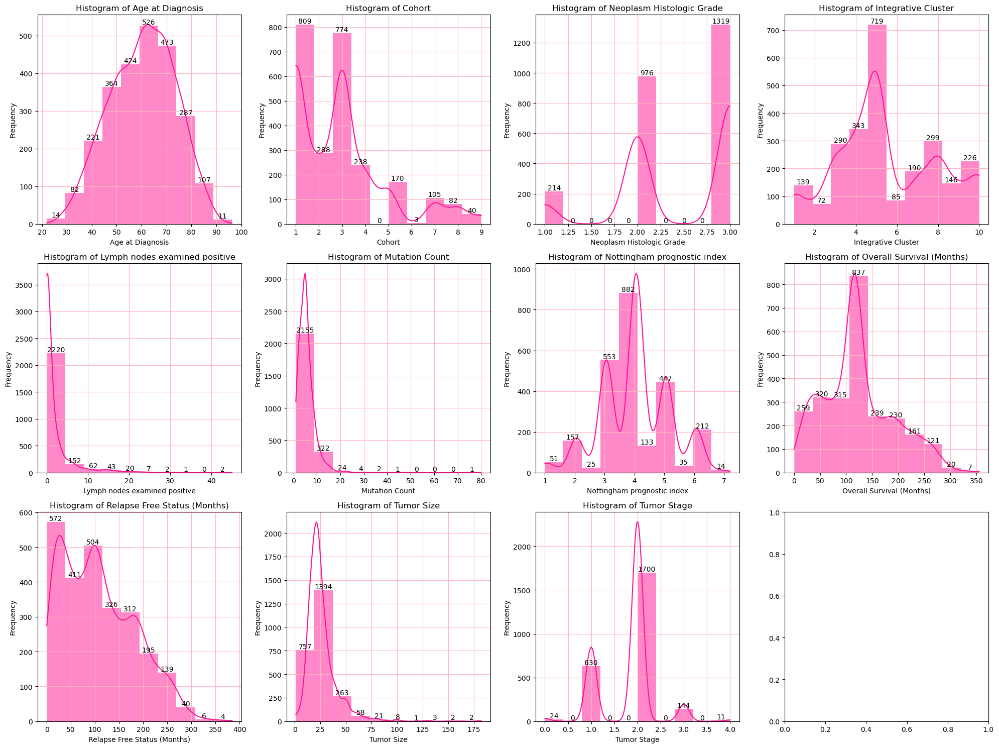

In [129]:
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# Flattening the axes array for easier iteration
axes = axes.flatten()

for i, column in enumerate(numerical_columns):
    sns.histplot(numerical_columns[column], bins=10, kde=True, edgecolor='none', color='#FF1493', ax=axes[i])
    axes[i].set_title(f'Histogram of {column}')
    axes[i].set_xlabel(column)
    axes[i].set_ylabel('Frequency')
    axes[i].grid(color='#FFB6C1')

    # Adding count labels on top of each bar
    for p in axes[i].patches:
        axes[i].annotate(f'{int(p.get_height())}', 
                         (p.get_x() + p.get_width() / 2, p.get_height()), 
                         ha='center', va='bottom')
        
plt.tight_layout()
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Inferences:</font></h3>

* __`Age at Diagnosis`__: We can observe that 526 patients are of an average age of 60 years. The distribution is normal.
* __`Cohort`__: Over 809 patients belong to cohort group 1 followed by cohort group 3 with 774 patients. Whereas, very less patients were in groups 4 and 6.
* __`Neoplasm Histologic Grade`__: 1319 patients have a Neoplasm Histologic Grade from 2.8 to 3 and 976 patients come under between 2 to 2.2 histologic grade, followed by 214 patients under 1 to 1.2 histologic grade.
* __`Integrative Cluster`__: Many patients, i.e. 719 patients belong to the 5th cluster. Whereas, a few patients belonged to the 2nd and 6th clusters.
* __`Lymph nodes examined positive`__: Most of the patients, i.e. 2220 have 0 to 5 lymph nodes examined positive. The distribution is highly right-skewed. Whereas only 137 patients have more than 9 positive lymph nodes.
* __`Mutation Count`__: Mutation count follows the same trend and distribution as 'Lymph nodes examined positive' where 2155 patients have mutation count from 0 to 10. Whereas only 32 patients have a mutation count greater than 17.
* __`Nottingham prognostic index`__: Most of the patients have prognostic scores of 3 and 4, with a cumulative count of 1435(882 + 553) patients. Whereas only 14 patients have a score of 7, 25 patients have a score between 2 to 3, and 35 patients have a score between 5 to 6.
* __`Overall Survival (Months)`__: 873 patients survived for about 110 months to 140 months (9 to 11 years). With very less patients after 280 months(23 years). 
* __`Relapse Free Status (Months)`__: Most of the patients i.e. 572 remained free from cancer from 0 to 40 months and 504 patients from 80 to 110 months approximately.
* __`Tumor Size`__: The tumor size of over 1394 patients was from 20mm to 35mm, followed by 757 patients having a tumor size of 0 to 20mm. Whereas only 95 patients had a tumor size above 55mm.
* __`Tumor Stage`__: Most of the women i.e. 1700 have a tumor stage from 2 to 2.4, followed by 630 of them having a tumor stage 1 and 144 having tumor stage 3. 

### <b><span style='color:#FF69B4'>Step 5.2.2 |</span><span style='color:#FF1493'> Categorical Variables Univariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Count Plot

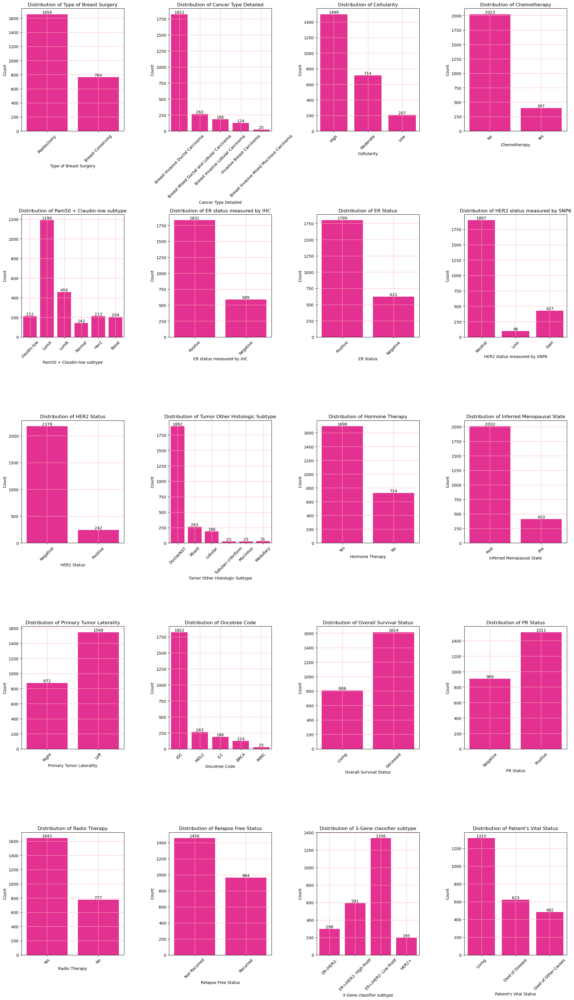

In [133]:
fig, axes = plt.subplots(5, 4, figsize=(20, 35))

axes = axes.flatten()

for i, col in enumerate(categorical_columns):
    sns.countplot(x=col, data=df, edgecolor='none', color='#FF1493', ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(color='#FFB6C1')

    for p in axes[i].patches:
        axes[i].annotate(f'{int(p.get_height())}', 
                         (p.get_x() + p.get_width() / 2, p.get_height()), 
                         ha='center', va='bottom')
        
plt.tight_layout()
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Categorical Features:</font></h3>

* __`Type of Breast Surgery`__: The majority of patients, 1656 in total, underwent mastectomy surgery. On the other hand, 764 patients underwent breast-conserving surgery.
* __`Cancer Type Detailed`__: 1822 women are diagnosed with Breast Invasive Ductal Carcinoma. Whereas only 25 women were diagnosed with Breast Invasive Mixed Mucinous Carcinoma.
* __`Cellularity`__: It is found that 207 patients have poor cellularity while 1499 patients have high cellularity.
* __`Chemotherapy`__: Only 397 patients have received chemotherapy. 2023 patients, however, have not received chemotherapy.
* __`Pam50 + Claudin-low subtype`__: It is observed that 1190 women have LumA subtype. And very few i.e. 142 women have a normal subtype.
* __`ER status measured by IHC`__: Estrogen receptor status measured by IHC is positive in 1831 women and negative in 589 women.
* __`ER Status`__: Estrogen receptor status is positive in 1799 women and negative in 621 women.
* __`HER2 status measured by SNP6`__: According to SNP6, 1897 women have a neutral HER2 status, 427 have a gain, and 96 have a loss.
* __`HER2 Status`__: HER2 status is negative in 2178 women and positive in 242 women.
* __`Tumor Other Histologic Subtype`__: There are 25 individuals with the mucinous subtype and 23 with the tubular/cribriform subtype, whereas around 1892 patients have the histologic subtype of ductal/NST.
* __`Hormone Therapy`__: The majority of the women, 1696, received hormone therapy, while 724 did not.
* __`Inferred Menopausal State`__: 2010 women were postmenopausal, while 410 women were premenopausal.
* __`Primary Tumor Laterality`__: The majority of patients i.e. 1548 have tumors located in the left breast. And 872 patients have tumors in the right breast.
* __`Oncotree Code`__: Over 1822 patients have IDC oncotree code while only 25 patients have IMMC oncotree code.
* __`Overall Survival Status`__: 1614 patients are observed to be deceased and 806 patients to be living.
* __`PR Status`__: PR status is positive in 1511 women and negative in 909 women.
* __`Radio Therapy`__: The majority of the women, 1643, received radiotherapy, while 777 did not.
* __`Relapse Free Status`__: 964 patients experienced a cancer relapse, while 1456 patients did not experience one.
* __`3-Gene classifier subtype`__: Only 195 women had a HER2+ subtype, while 1336 had an ER+/HER2-Low Prolif subtype, 591 an ER+/HER2-High Prolif subtype, and 298 an ER-/HER2-subtype.
* __`Patient's Vital Status`__: It was noted that 482 people died from other reasons, 623 patients died from illness, and 1315 patients were still alive.

## <b><span style='color:#FF69B4'>Step 5.3 |</span><span style='color:#FF1493'> Bivariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Step 5.3.1 |</span><span style='color:#FF1493'> Numerical vs Numerical Bivariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Pair Plot

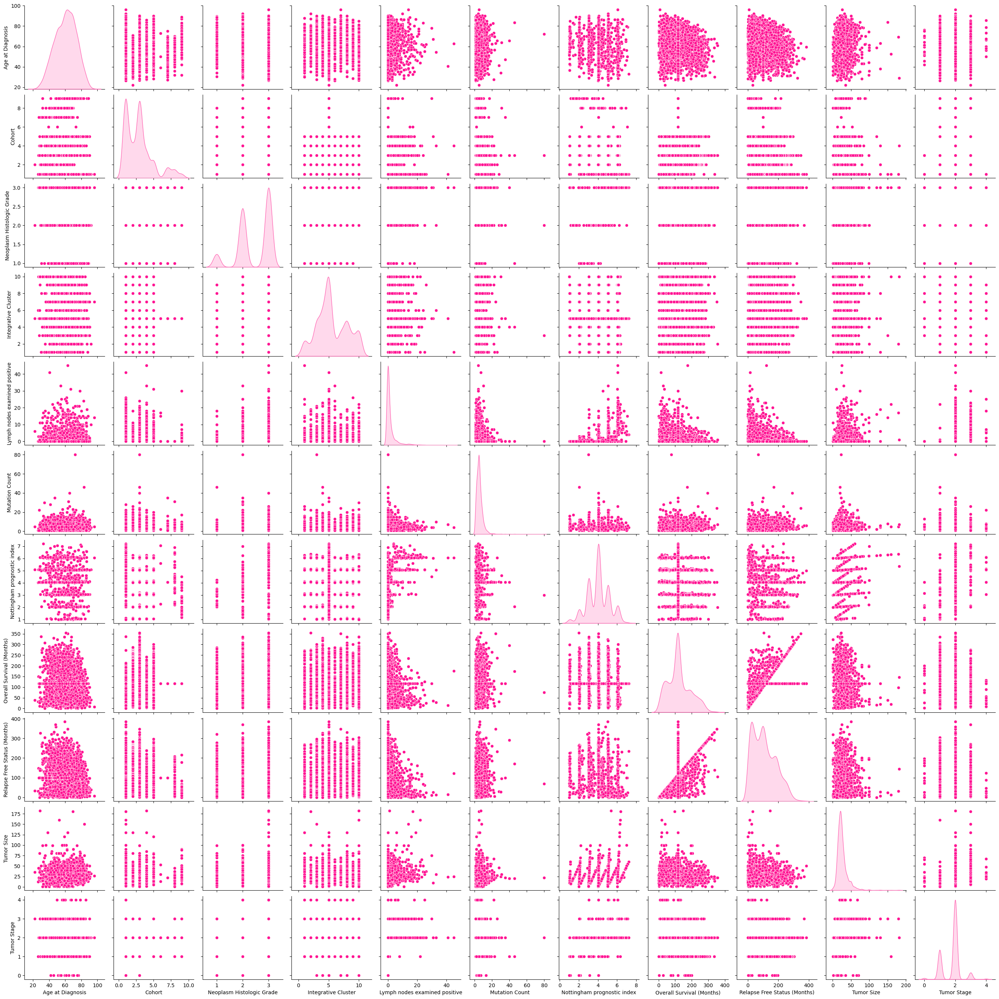

In [140]:
sns.pairplot(data=numerical_columns, diag_kind='kde', plot_kws={'color': '#FF1493'}, diag_kws={'color': '#FF69B4'})
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

From the different scatter plots we can conclude the following:
* Firstly, we can see that there is a high positive correlation between Relapse Free Status (Months) and Overall Survival (Months).
* The parallel dotted lines might suggest no correlation between the variables. For example, Tumor Stage and Neoplasm Histologic Grade do not have much correlation.
* We can also see a few negative correlations in Lymph nodes examined positive vs Overall Survival (Months) and Relapse Free Status (Months). And also with Tumor Size vs Overall Survival (Months) and Relapse Free Status (Months).
* Let us double-check with the correlation heatmap and see if the observations are right.

### <b><span style='color:#FF69B4'>Correlation Heatmap

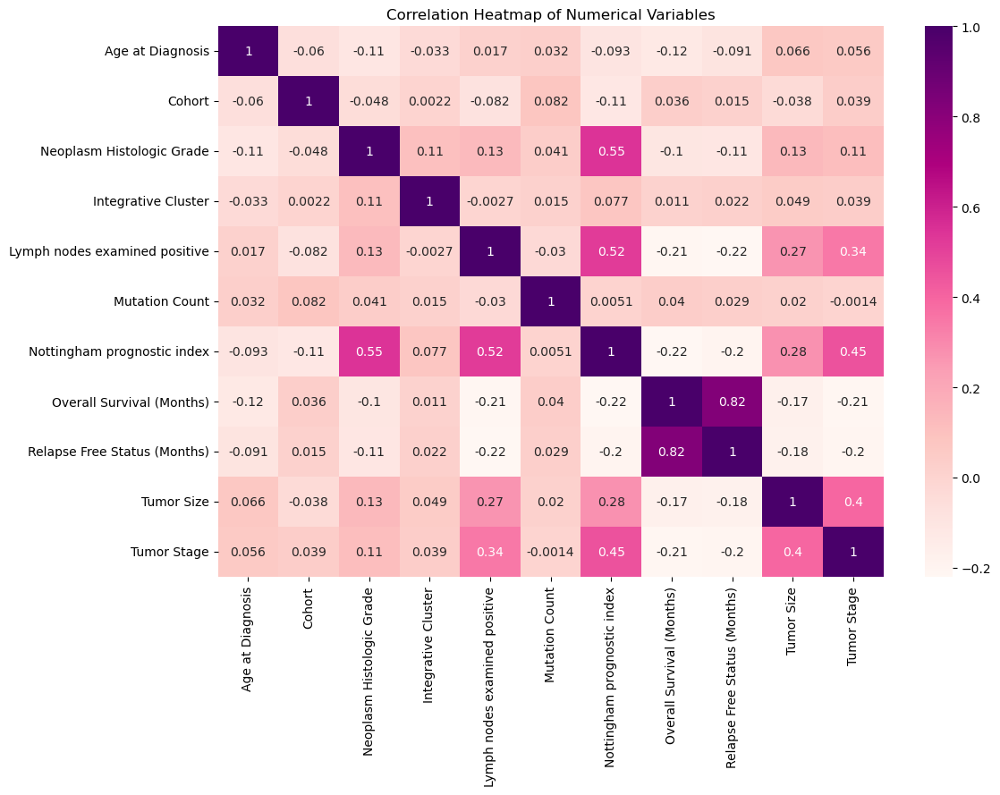

In [144]:
correlation = numerical_columns.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation, annot=True, cmap='RdPu')
plt.title('Correlation Heatmap of Numerical Variables')
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

From the correlation heatmap, we can see that the observations were true. Let us check what else we can conclude. 

**Positive Correlation**
* Relapse Free Status (Months) and Overall Survival (Months) have the highest positive correlation of 0.82.
* Followed by Nottingham Prognostic Index and Neoplasm Histologic Grade with a positive correlation of 0.55.
* Lymph nodes examined positive have a positive correlation of 0.52, with the Nottingham Prognostic Index and 0.34 with Tumor Stage. 
* Tumor Stage and Nottingham Prognostic Index have a positive correlation of 0.45.
* Tumor Stage and Tumor Size have a correlation of 0.4.

**Negative Correlation**
* Both Relapse Free Status (Months) vs Lymph nodes examined positive and Overall Survival (Months) vs Nottingham Prognostic Index have the highest negative correlation of 0.22.
* Tumor Size, Tumor Stage, Relapse Free Status (Months), and Overall Survival (Months) have negative correlations with one another of correlations -0.21, -0.2, -0.18, -0.17.

**Overall, the Nottingham Prognostic Index, Lymph nodes examined positive, Tumor Stage, Tumor Size, Relapse Free Status (Months), and Overall Survival (Months) exhibit more correlations/relationships between the variables.** 

**On the other hand Mutation Count, Integrative Cluster, Cohort, Age at Diagnosis, and Neoplasm Histologic Grade show less correlation with the variables.**

### <b><span style='color:#FF69B4'>Step 5.3.2 |</span><span style='color:#FF1493'> Categorical vs Categorical Bivariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Bar Graph

<Figure size 800x600 with 0 Axes>

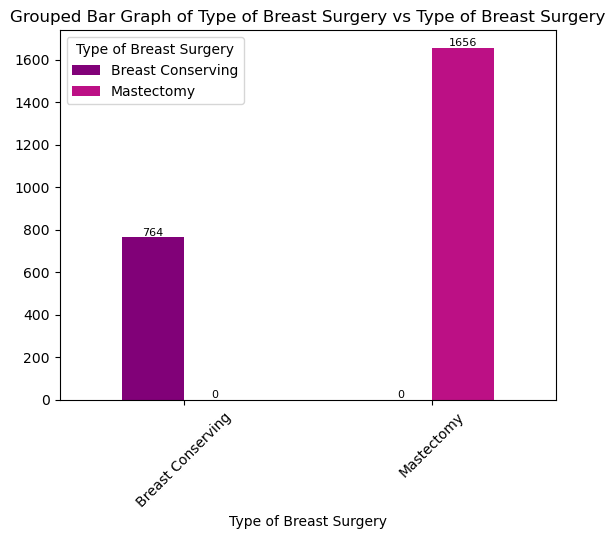

<Figure size 800x600 with 0 Axes>

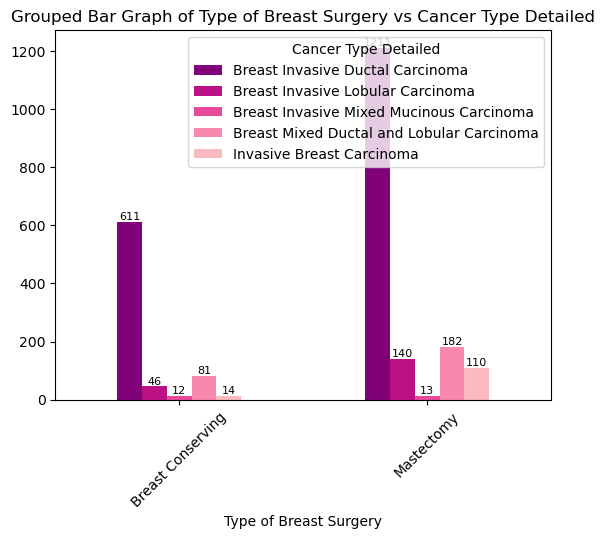

<Figure size 800x600 with 0 Axes>

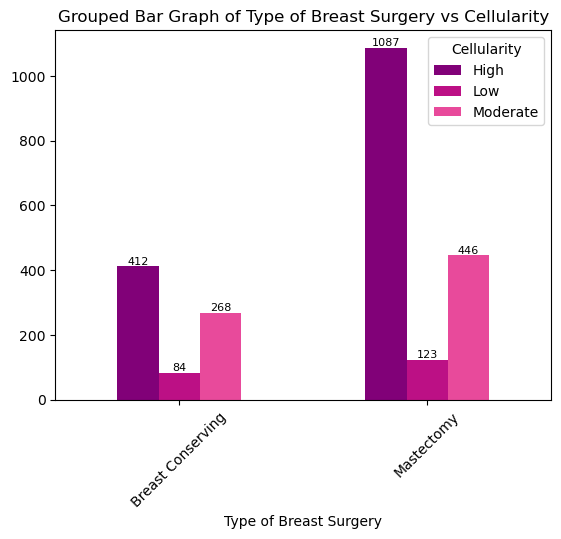

<Figure size 800x600 with 0 Axes>

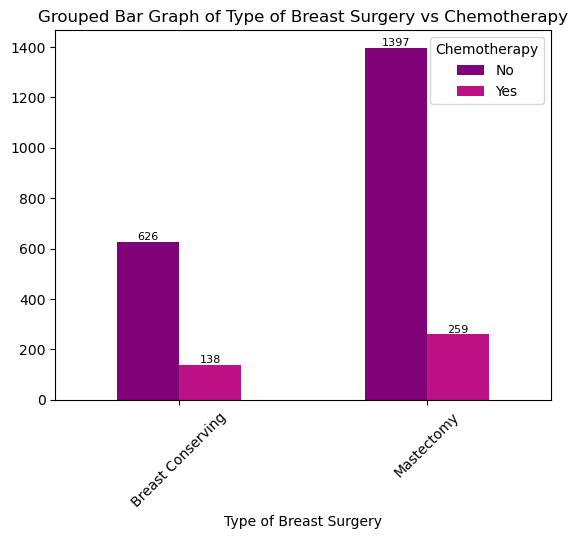

<Figure size 800x600 with 0 Axes>

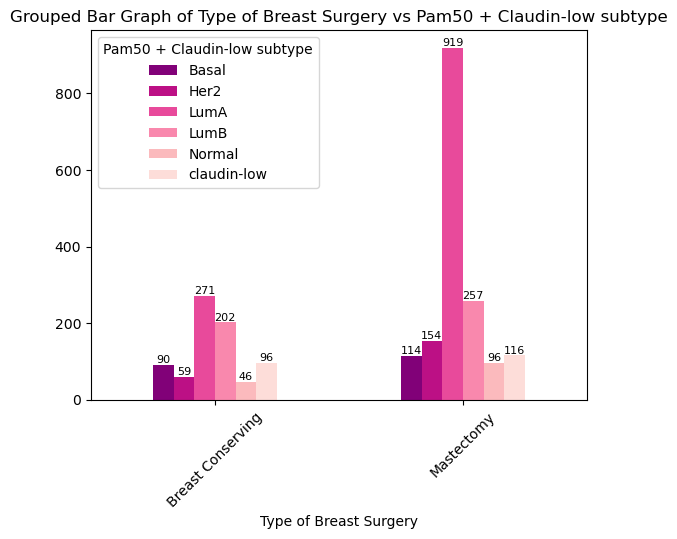

<Figure size 800x600 with 0 Axes>

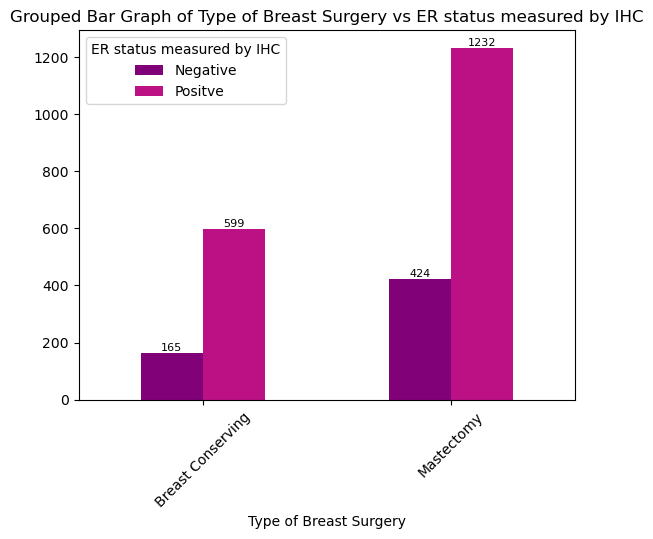

<Figure size 800x600 with 0 Axes>

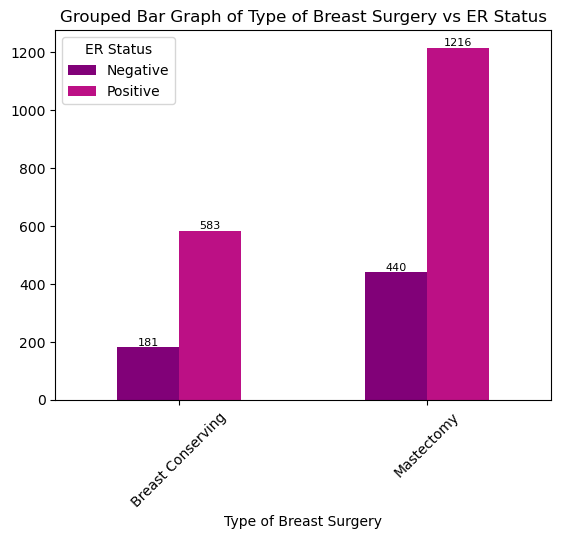

<Figure size 800x600 with 0 Axes>

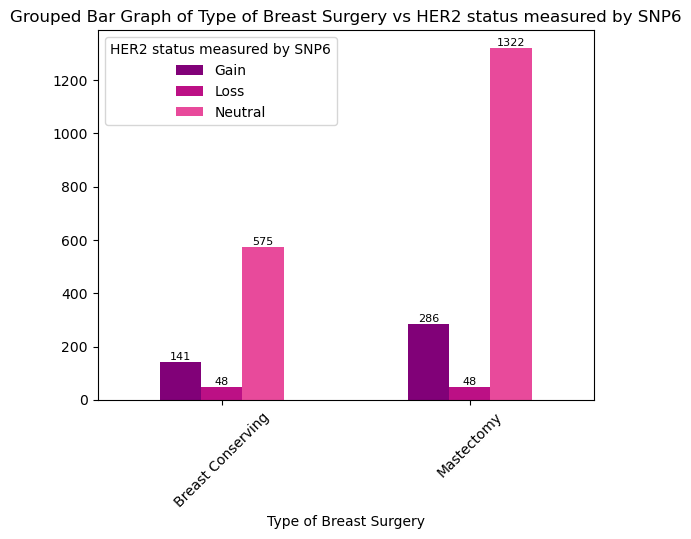

<Figure size 800x600 with 0 Axes>

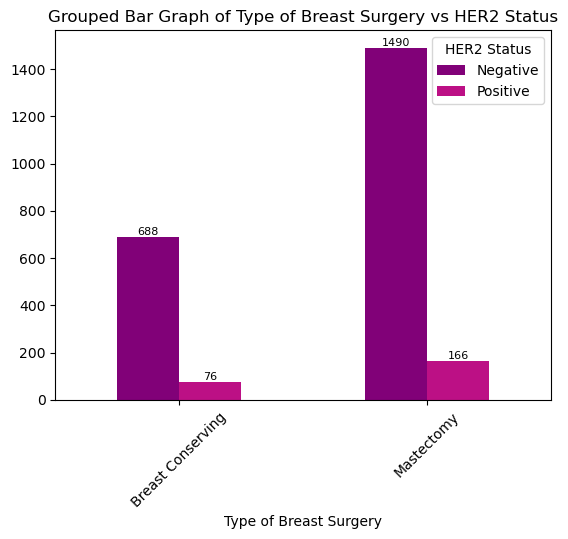

<Figure size 800x600 with 0 Axes>

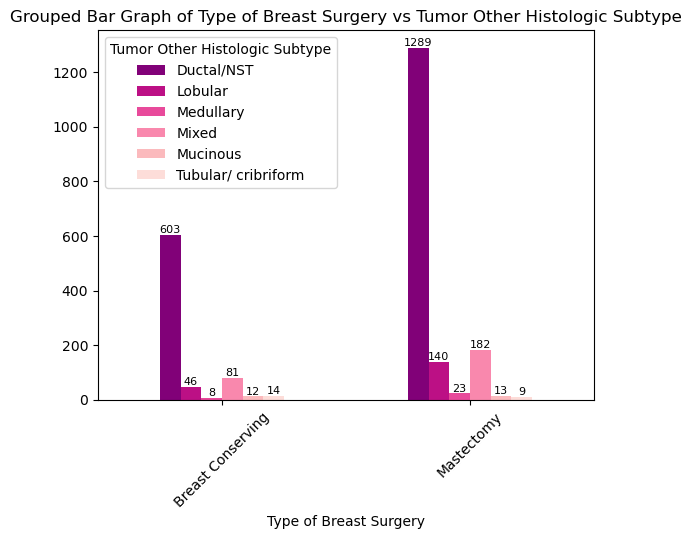

<Figure size 800x600 with 0 Axes>

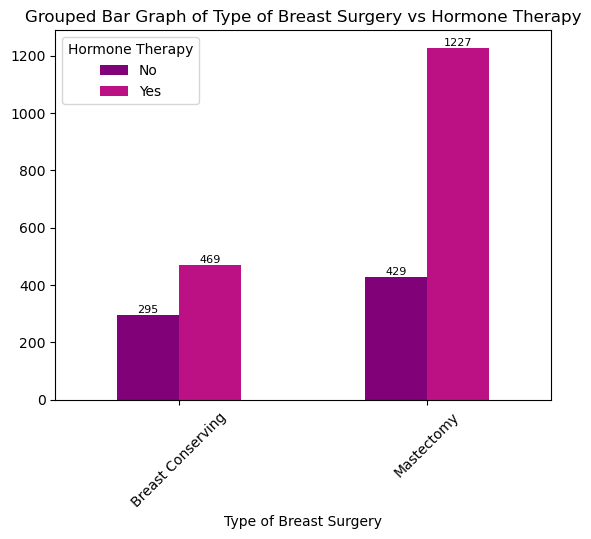

<Figure size 800x600 with 0 Axes>

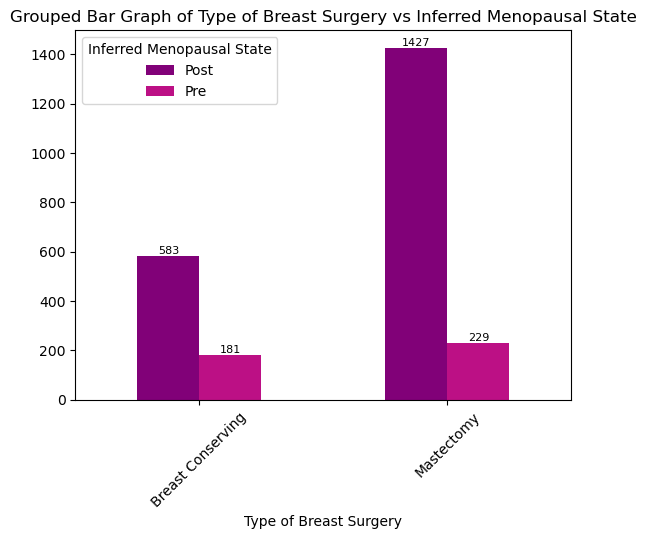

<Figure size 800x600 with 0 Axes>

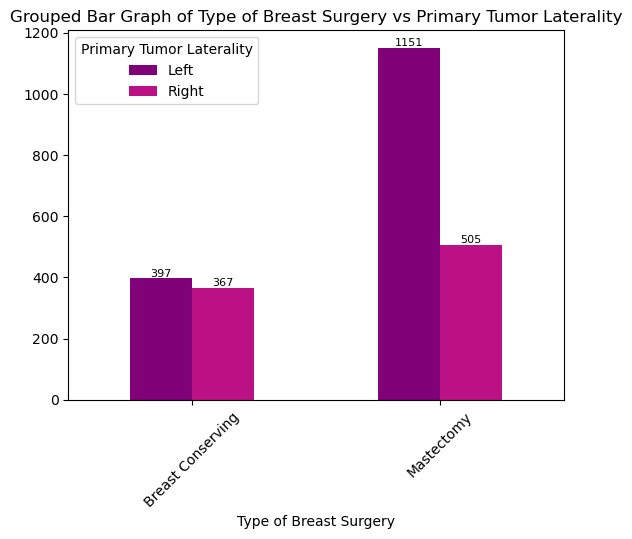

<Figure size 800x600 with 0 Axes>

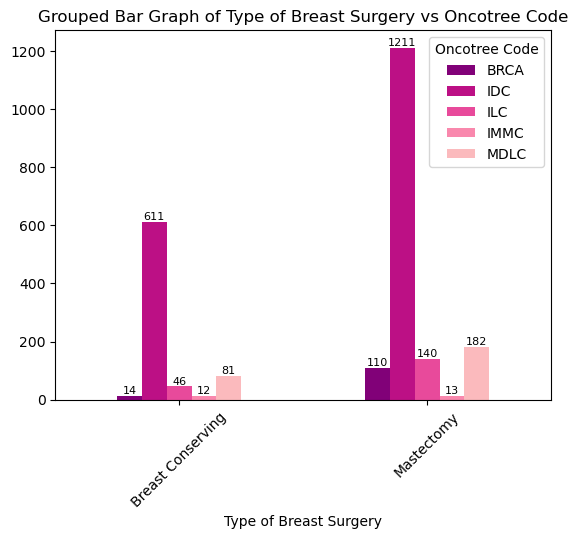

<Figure size 800x600 with 0 Axes>

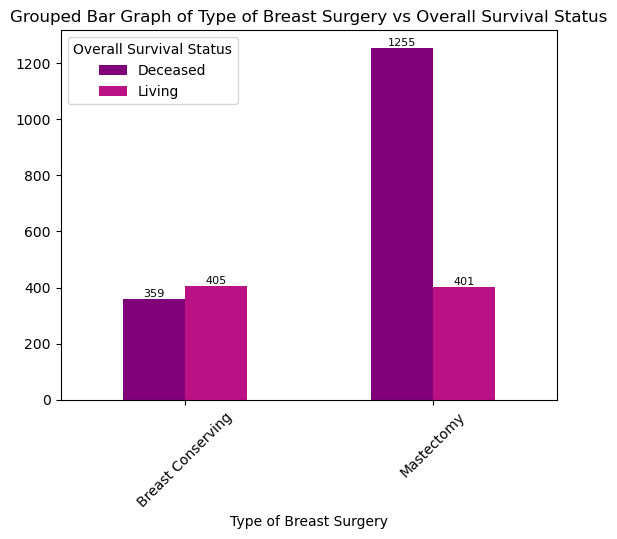

<Figure size 800x600 with 0 Axes>

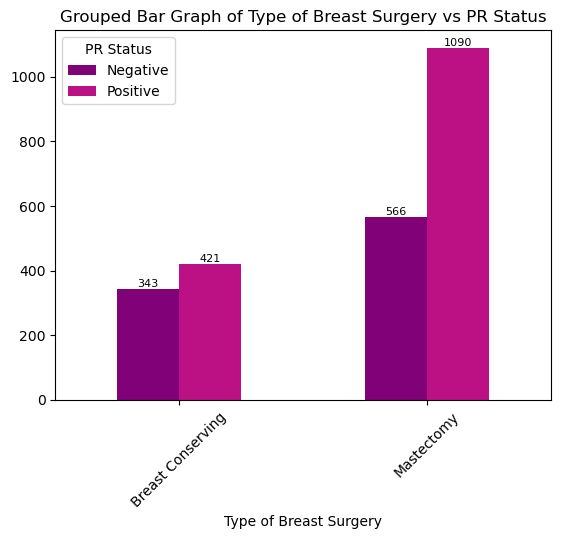

<Figure size 800x600 with 0 Axes>

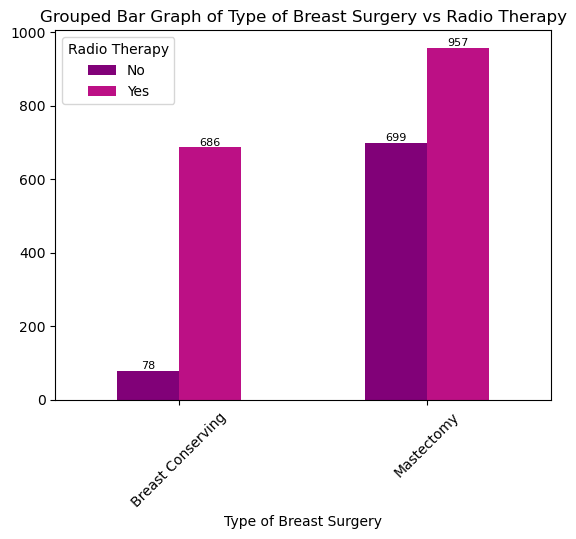

<Figure size 800x600 with 0 Axes>

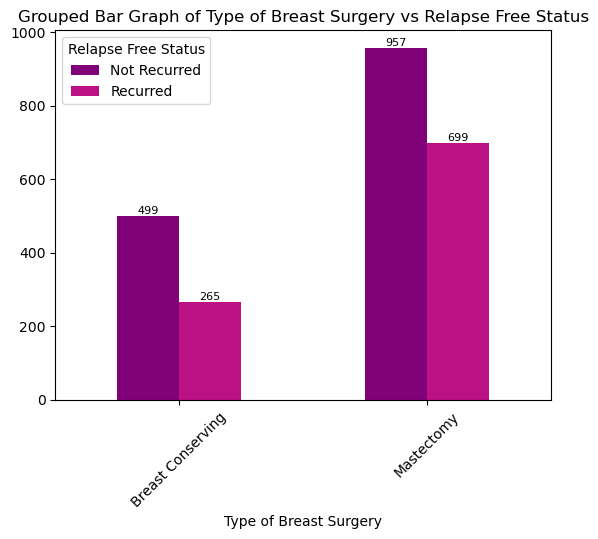

<Figure size 800x600 with 0 Axes>

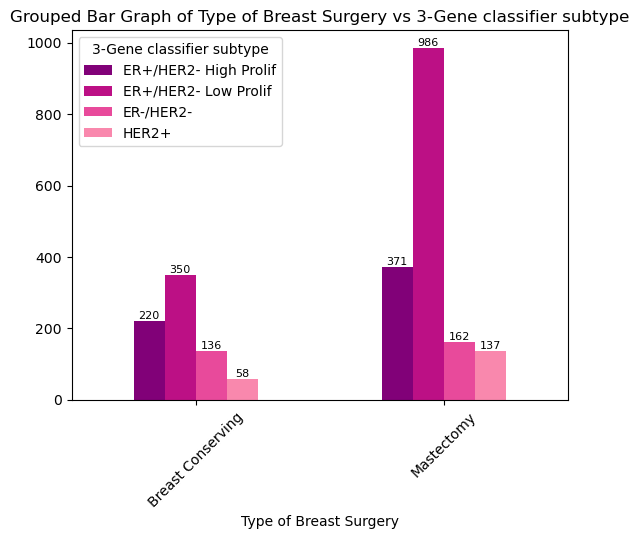

<Figure size 800x600 with 0 Axes>

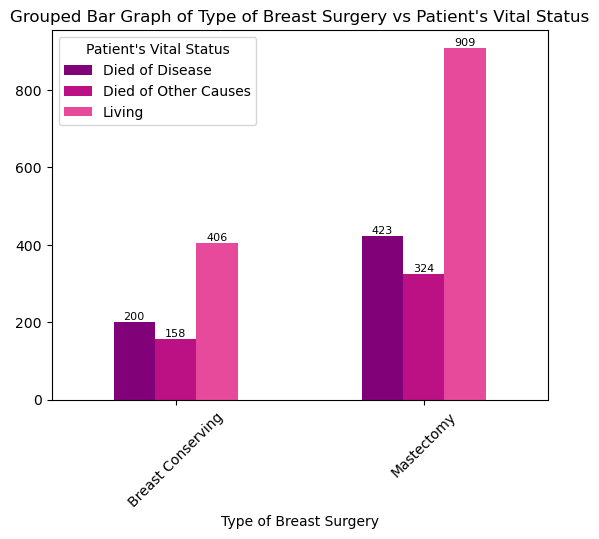

<Figure size 800x600 with 0 Axes>

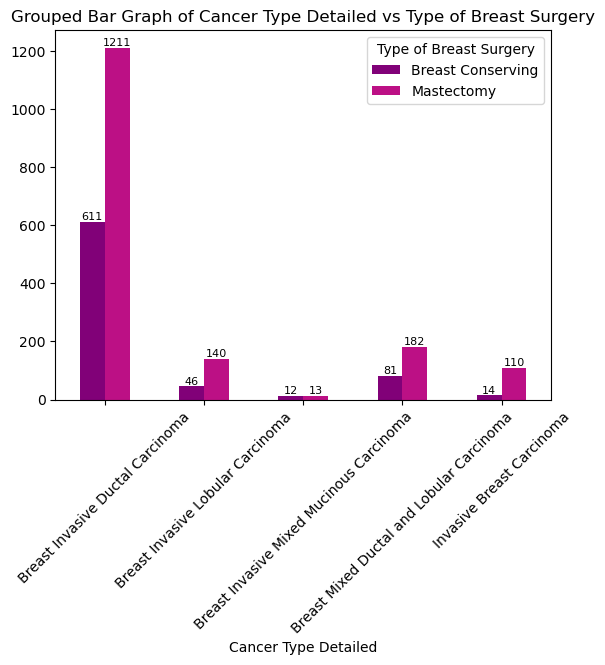

<Figure size 800x600 with 0 Axes>

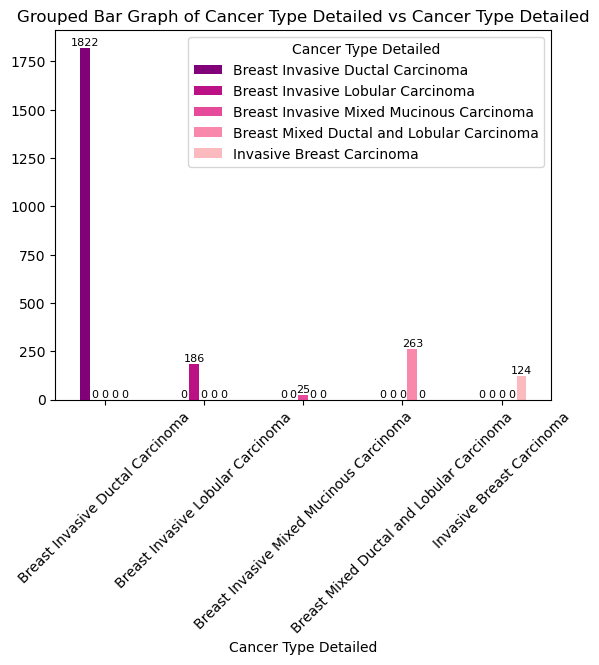

<Figure size 800x600 with 0 Axes>

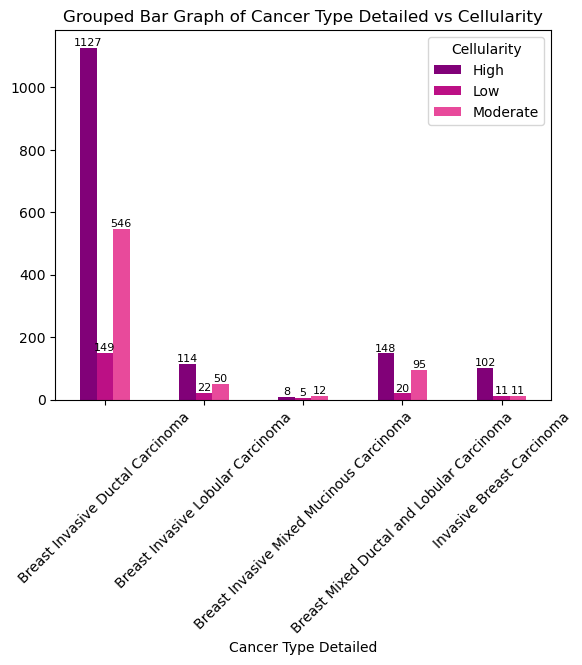

<Figure size 800x600 with 0 Axes>

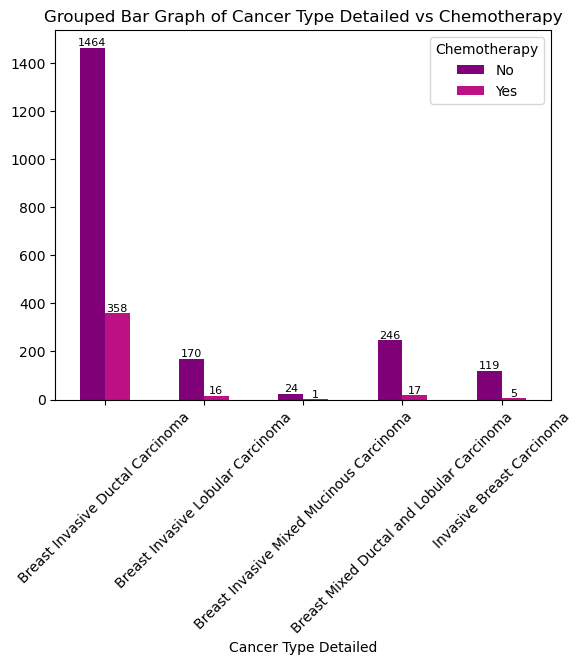

<Figure size 800x600 with 0 Axes>

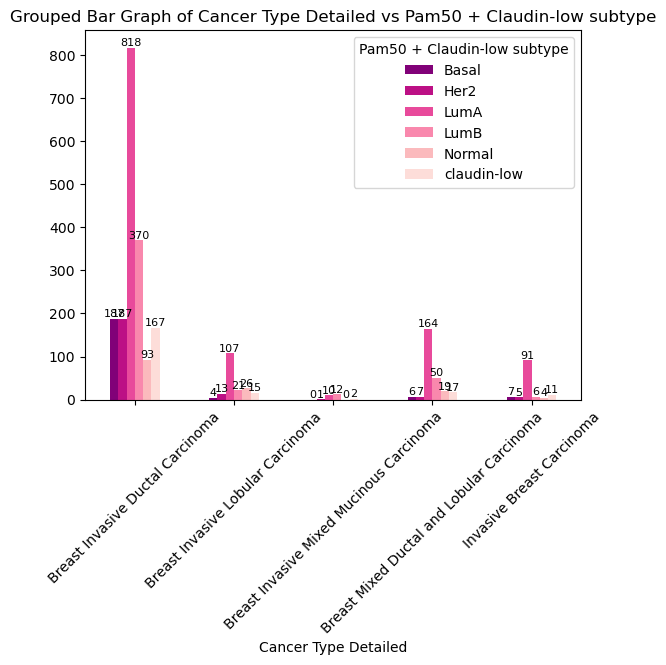

<Figure size 800x600 with 0 Axes>

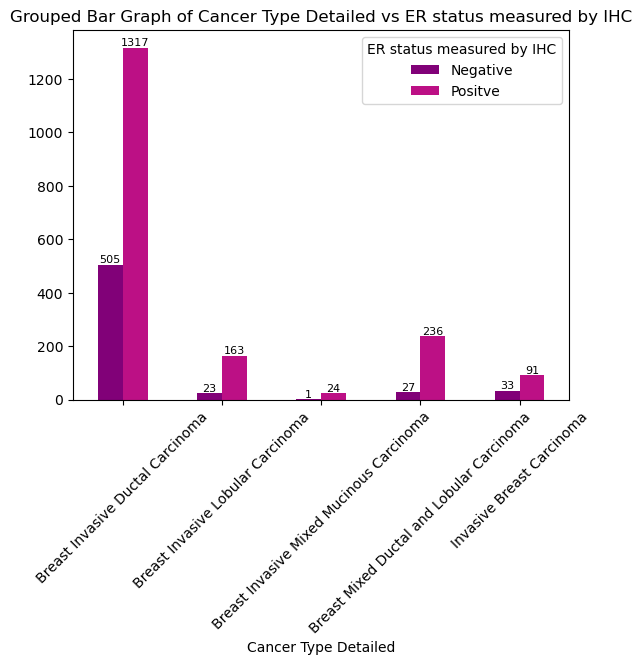

<Figure size 800x600 with 0 Axes>

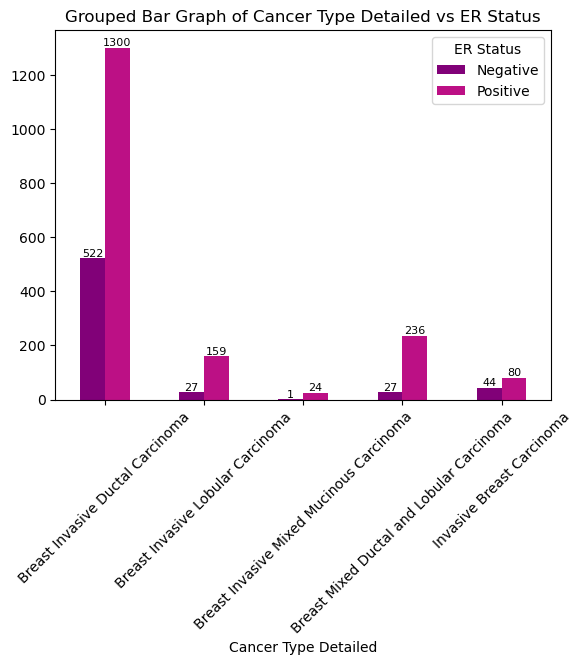

<Figure size 800x600 with 0 Axes>

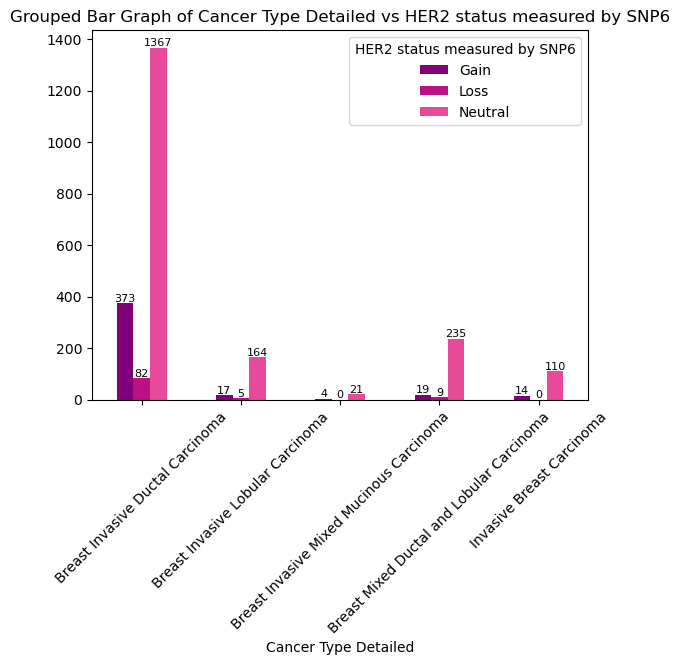

<Figure size 800x600 with 0 Axes>

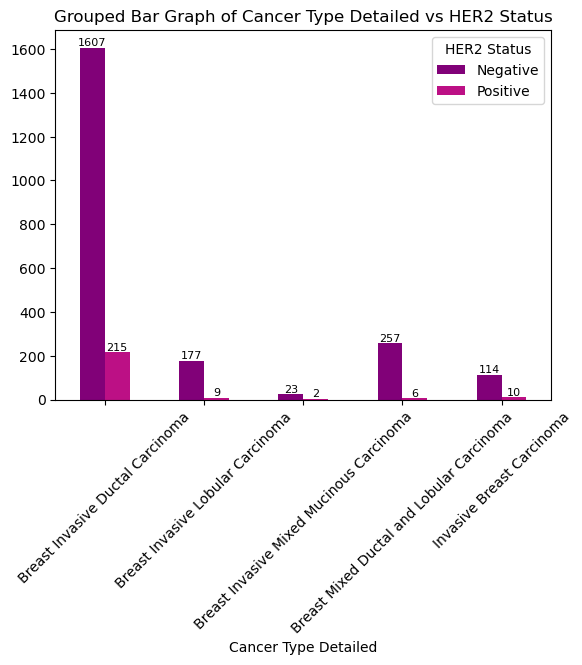

<Figure size 800x600 with 0 Axes>

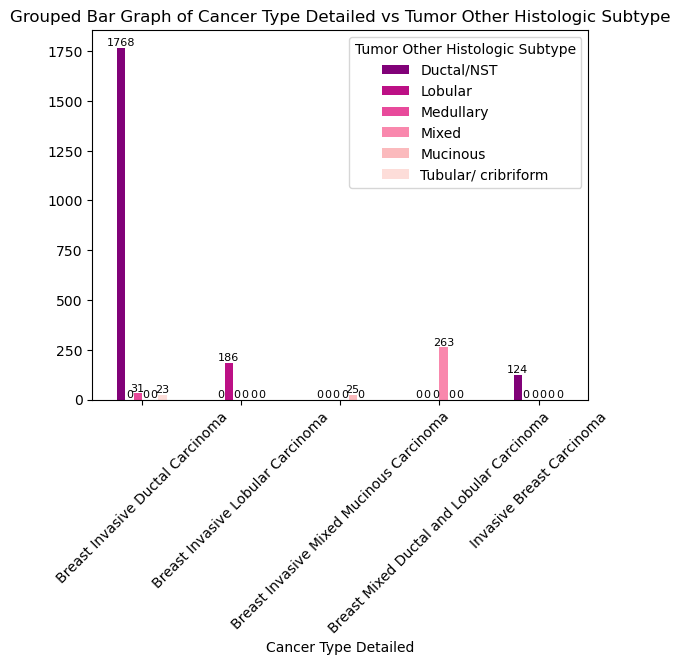

<Figure size 800x600 with 0 Axes>

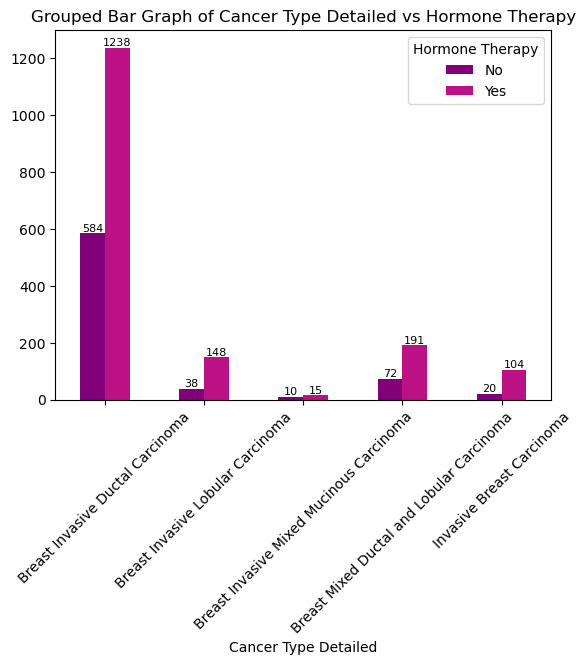

<Figure size 800x600 with 0 Axes>

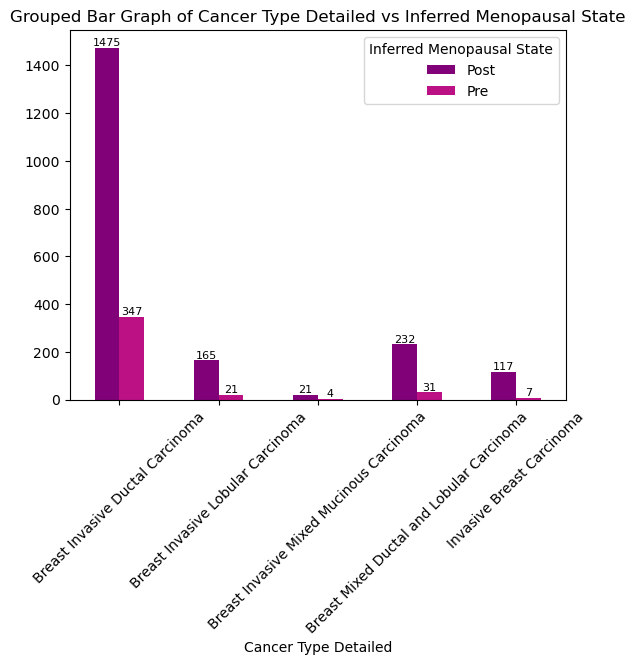

<Figure size 800x600 with 0 Axes>

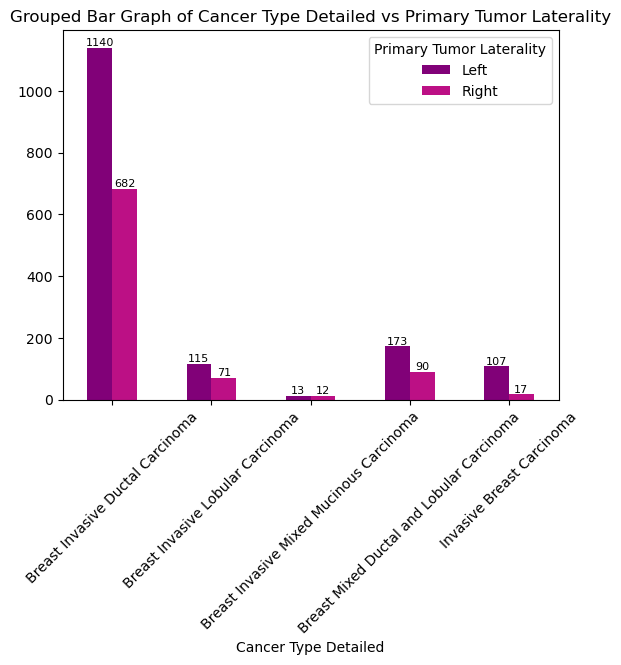

<Figure size 800x600 with 0 Axes>

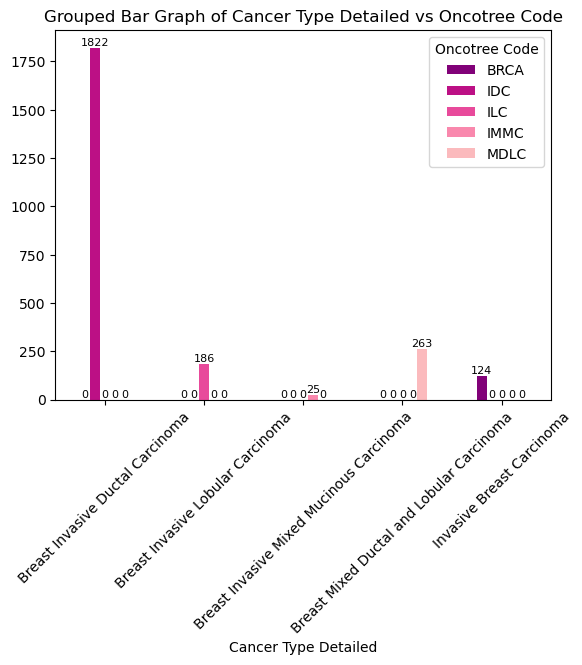

<Figure size 800x600 with 0 Axes>

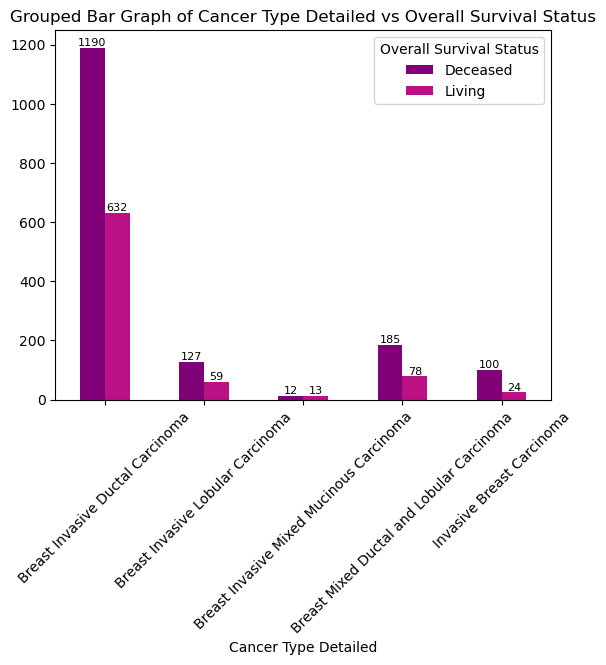

<Figure size 800x600 with 0 Axes>

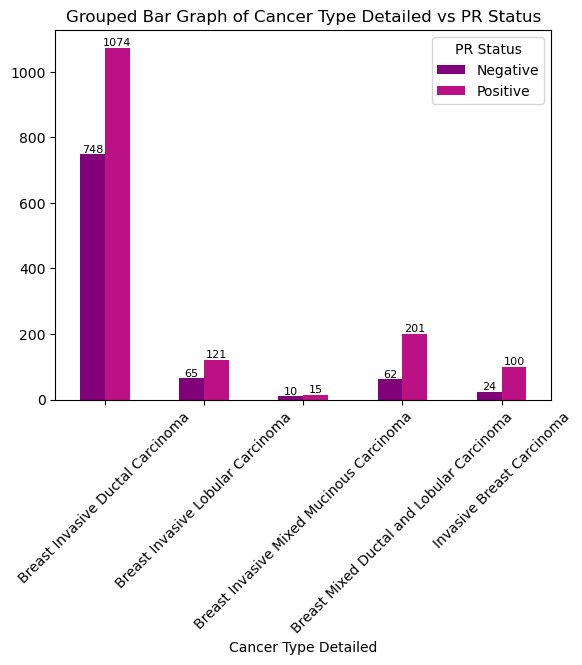

<Figure size 800x600 with 0 Axes>

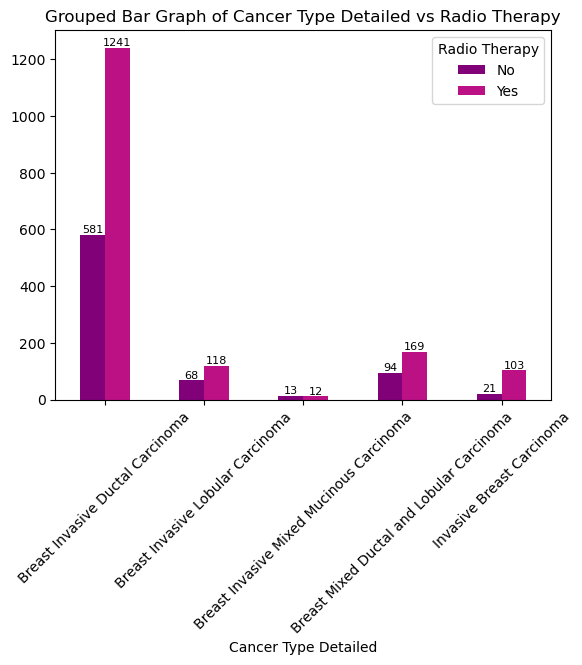

<Figure size 800x600 with 0 Axes>

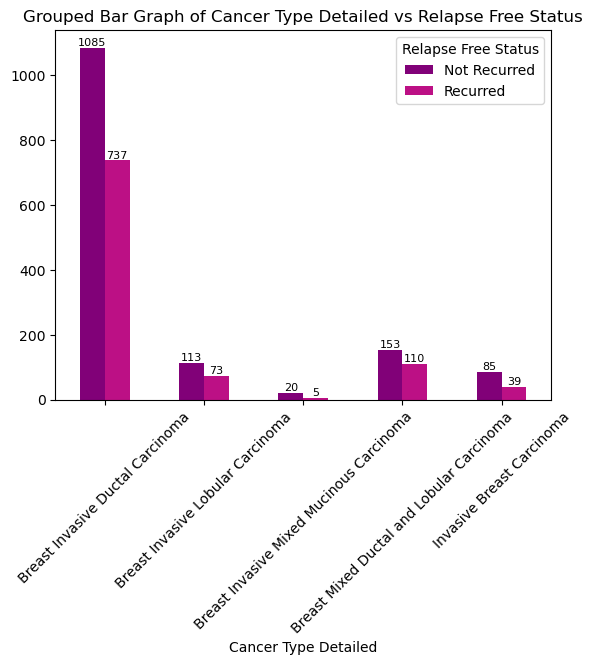

<Figure size 800x600 with 0 Axes>

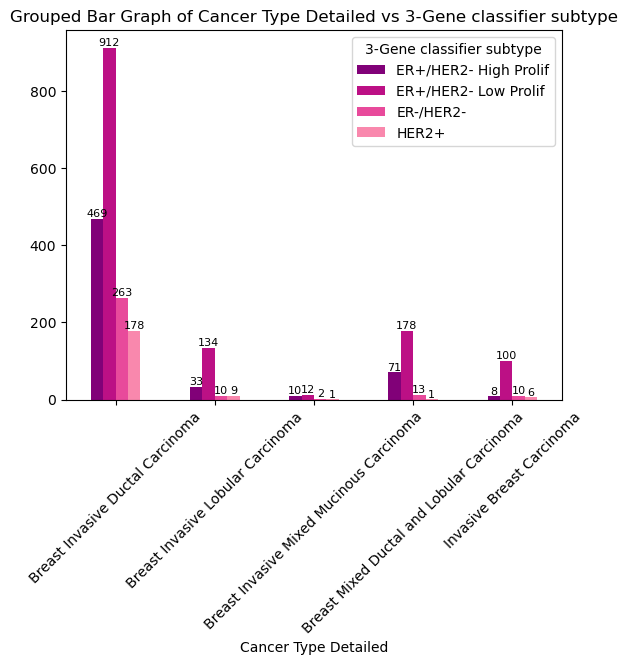

<Figure size 800x600 with 0 Axes>

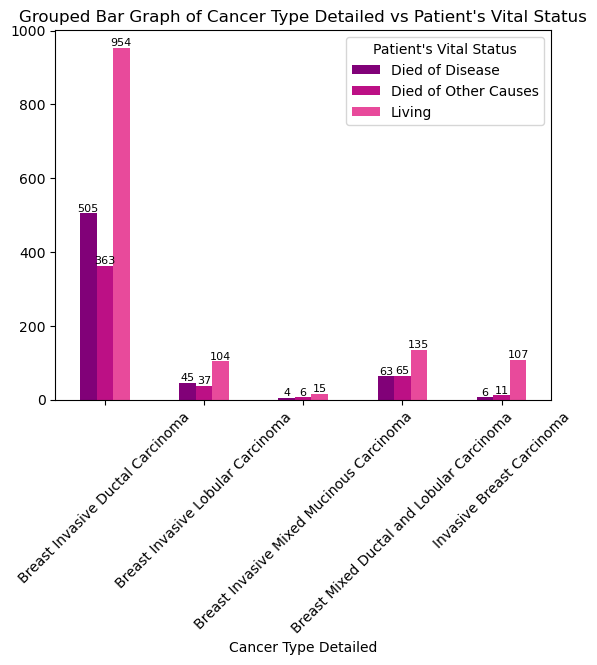

<Figure size 800x600 with 0 Axes>

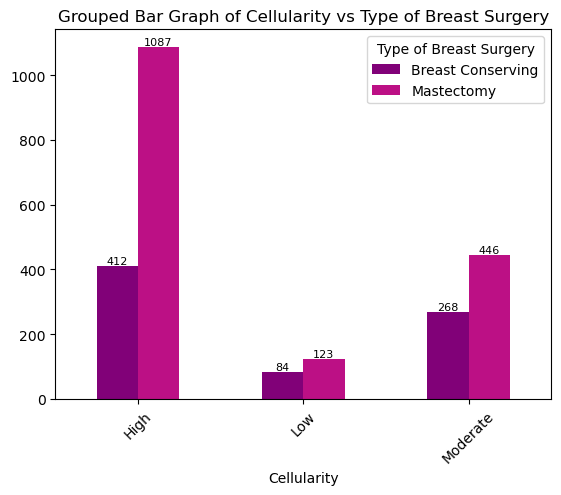

<Figure size 800x600 with 0 Axes>

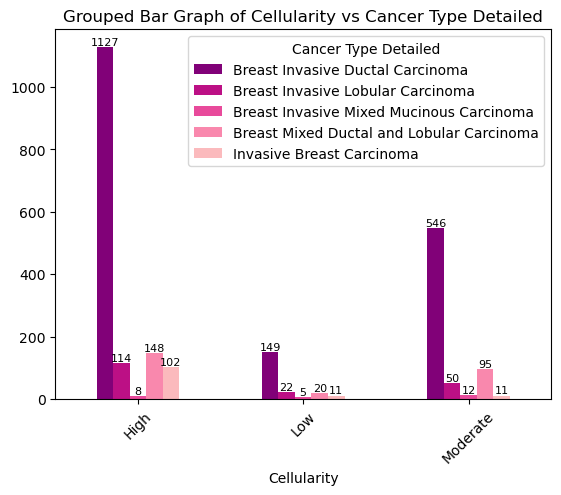

<Figure size 800x600 with 0 Axes>

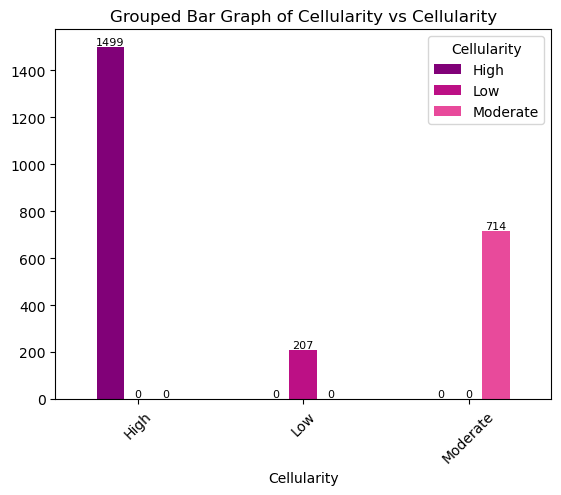

<Figure size 800x600 with 0 Axes>

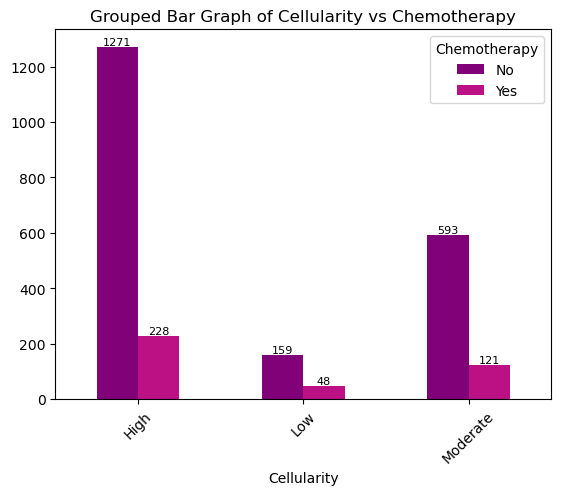

<Figure size 800x600 with 0 Axes>

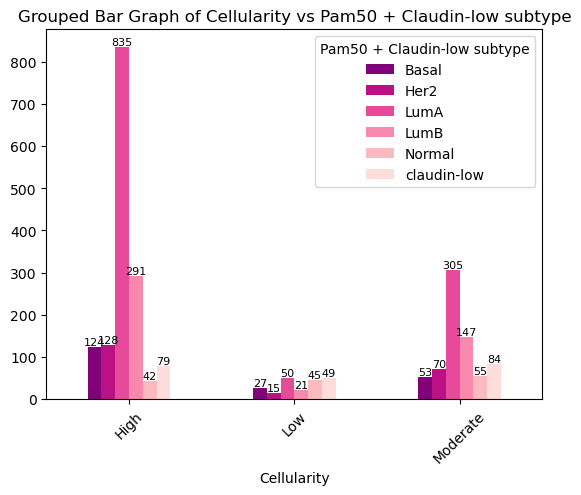

<Figure size 800x600 with 0 Axes>

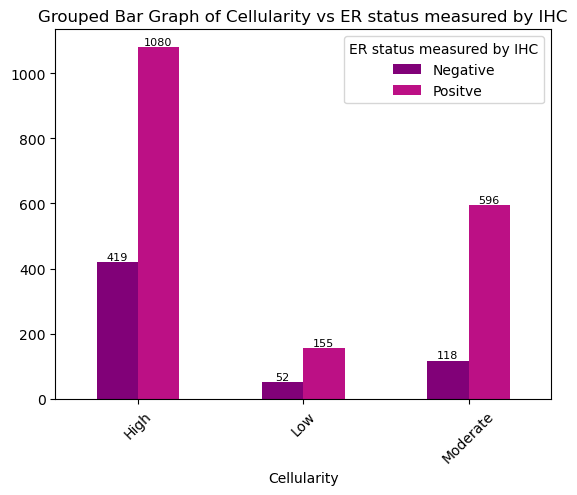

<Figure size 800x600 with 0 Axes>

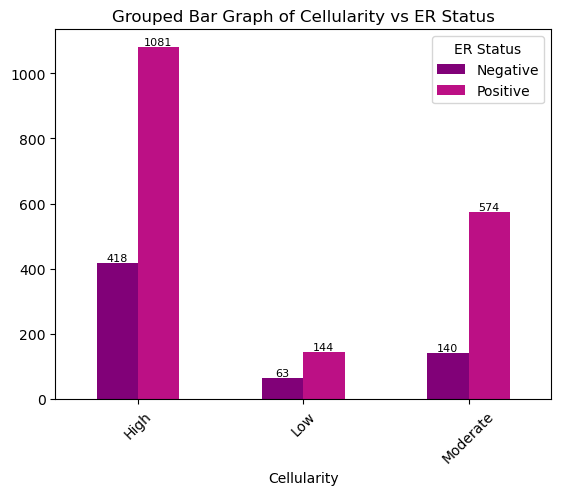

<Figure size 800x600 with 0 Axes>

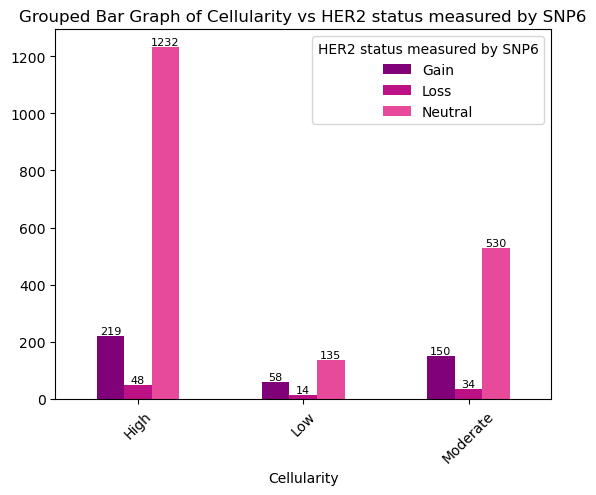

<Figure size 800x600 with 0 Axes>

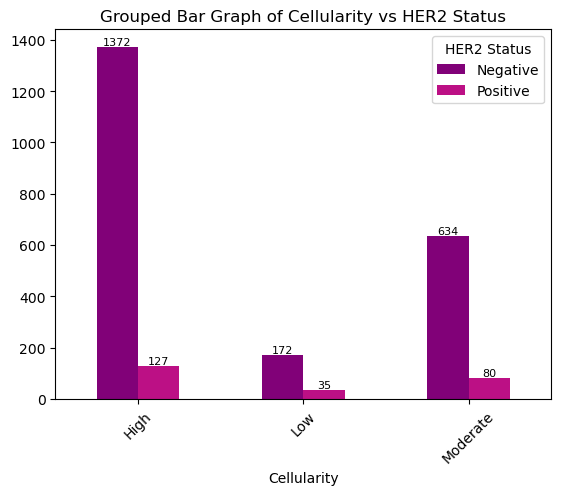

<Figure size 800x600 with 0 Axes>

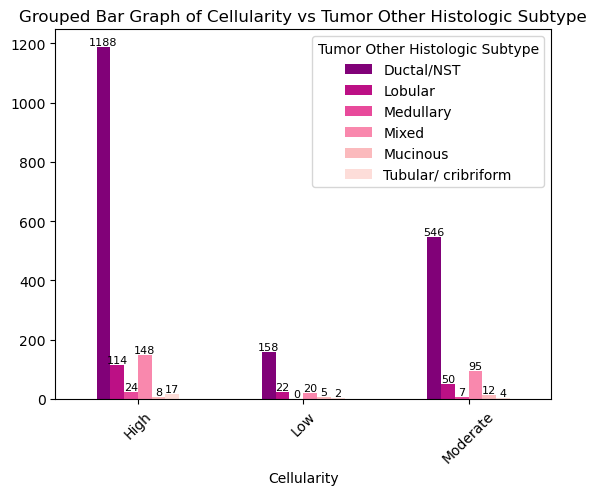

<Figure size 800x600 with 0 Axes>

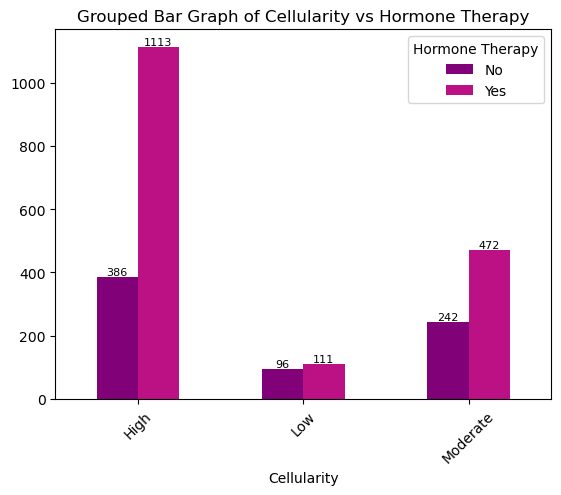

<Figure size 800x600 with 0 Axes>

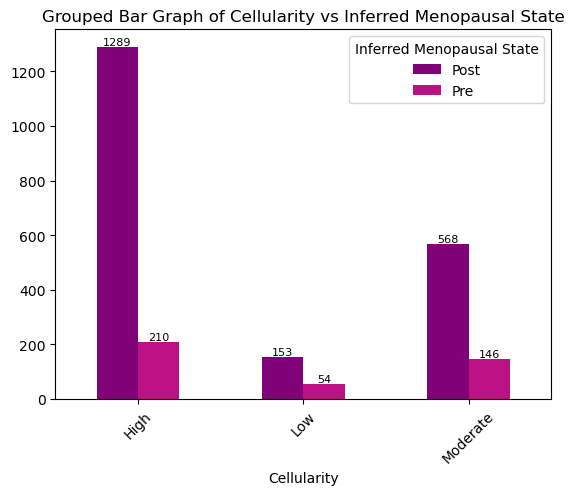

<Figure size 800x600 with 0 Axes>

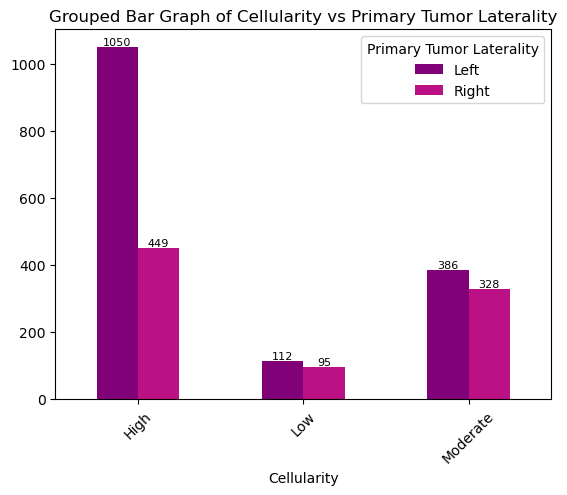

<Figure size 800x600 with 0 Axes>

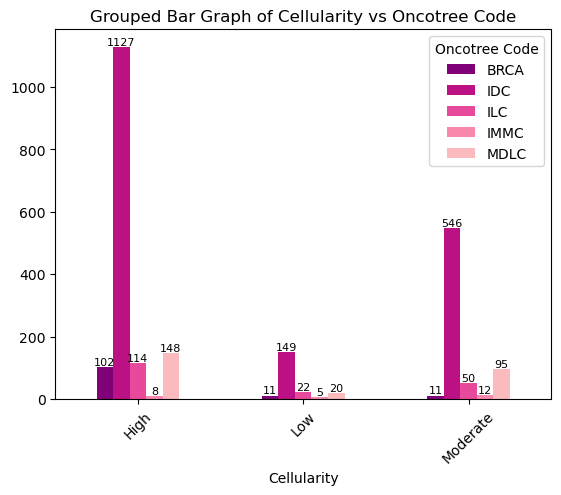

<Figure size 800x600 with 0 Axes>

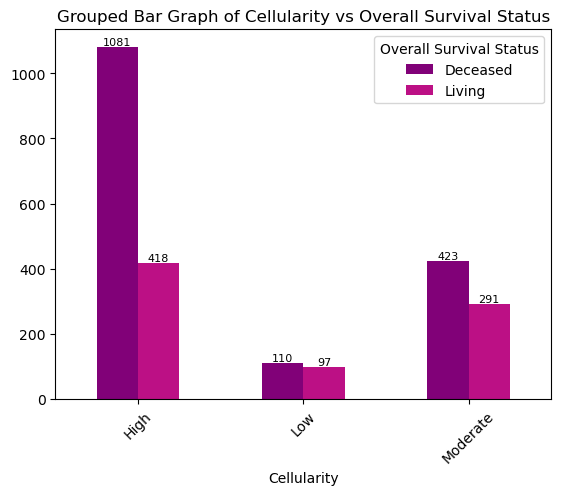

<Figure size 800x600 with 0 Axes>

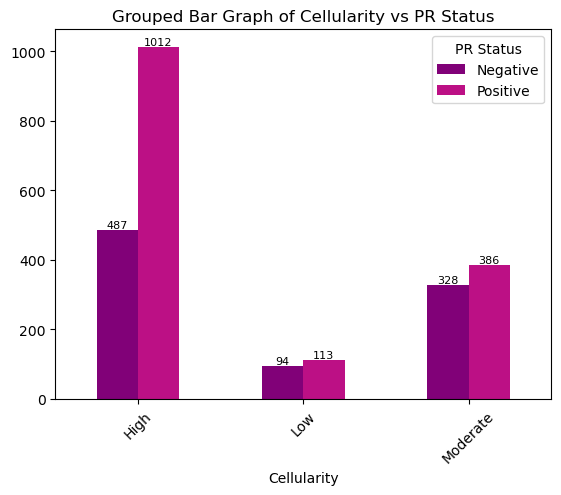

<Figure size 800x600 with 0 Axes>

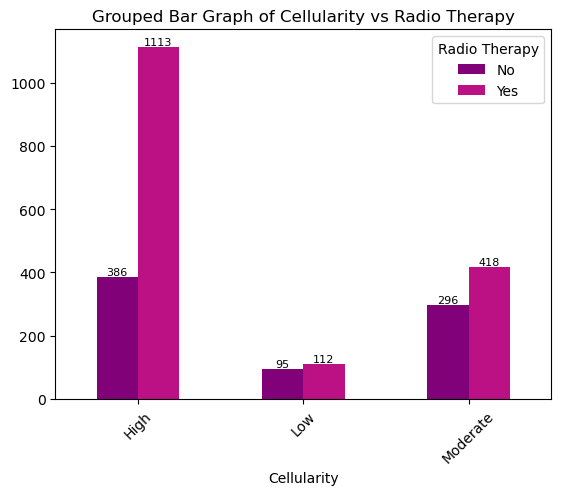

<Figure size 800x600 with 0 Axes>

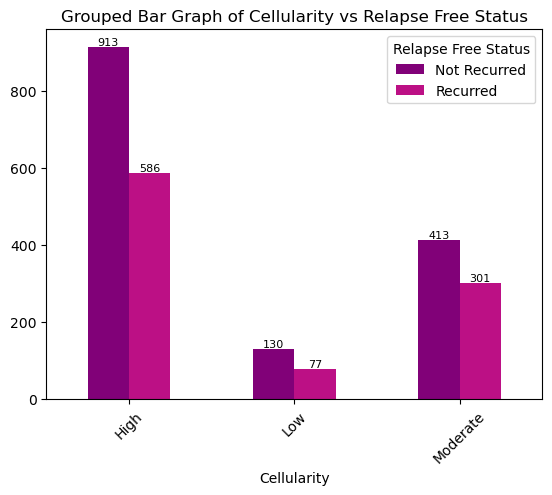

<Figure size 800x600 with 0 Axes>

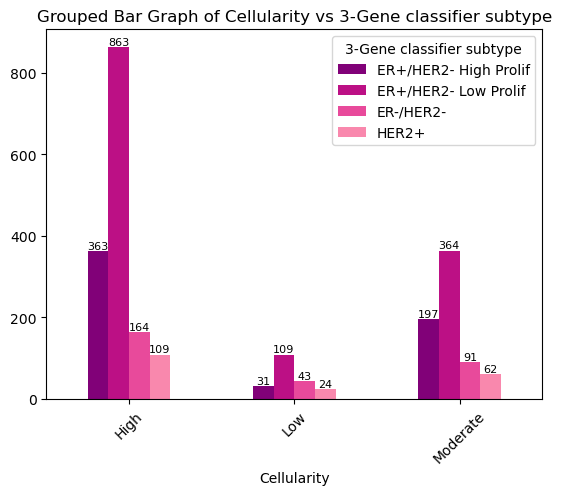

<Figure size 800x600 with 0 Axes>

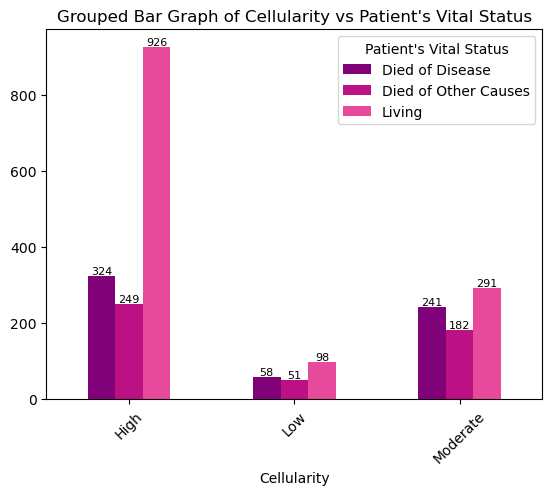

<Figure size 800x600 with 0 Axes>

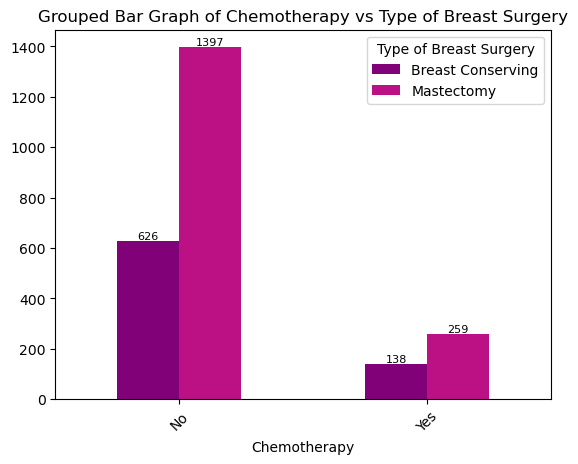

<Figure size 800x600 with 0 Axes>

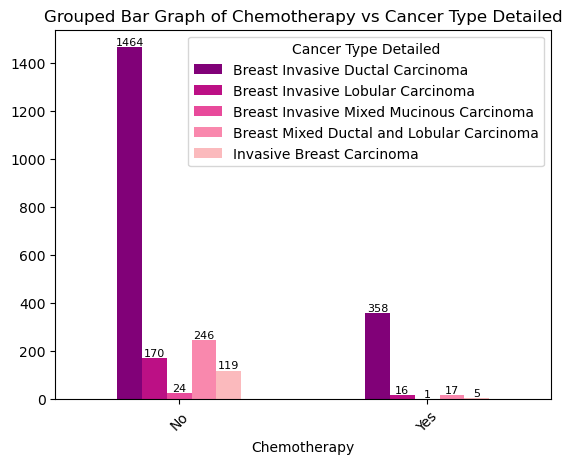

<Figure size 800x600 with 0 Axes>

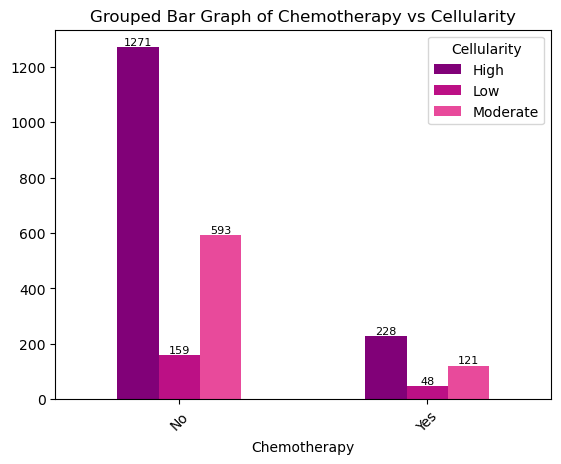

<Figure size 800x600 with 0 Axes>

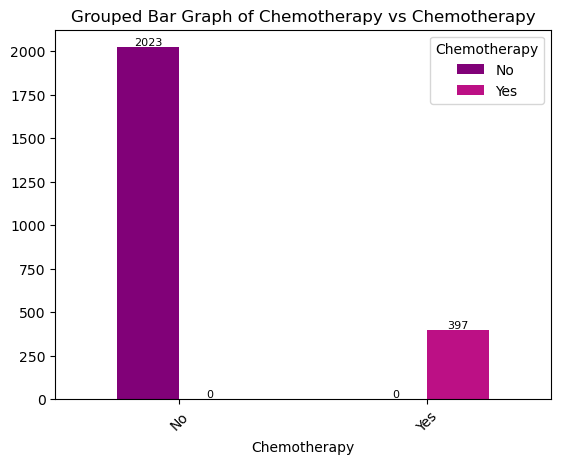

<Figure size 800x600 with 0 Axes>

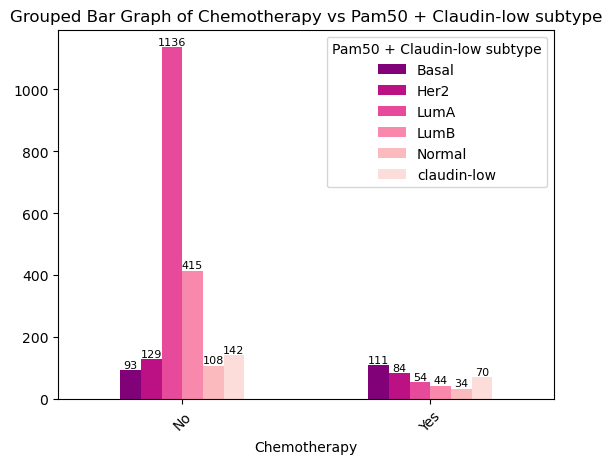

<Figure size 800x600 with 0 Axes>

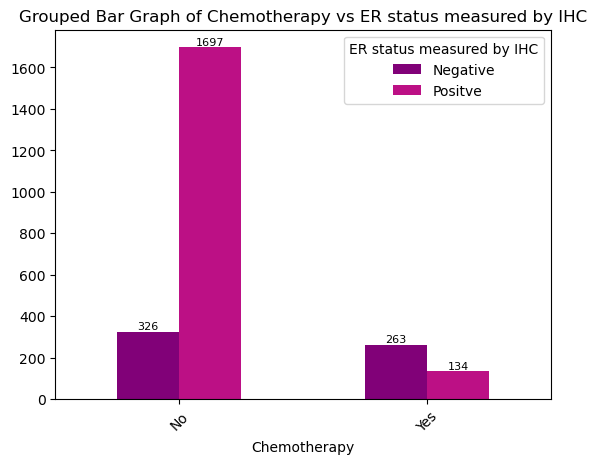

<Figure size 800x600 with 0 Axes>

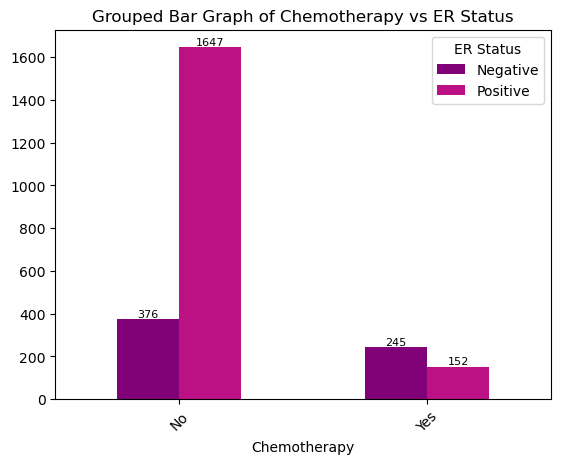

<Figure size 800x600 with 0 Axes>

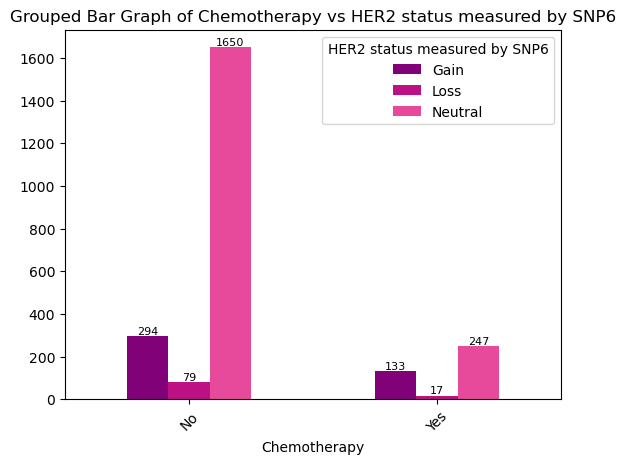

<Figure size 800x600 with 0 Axes>

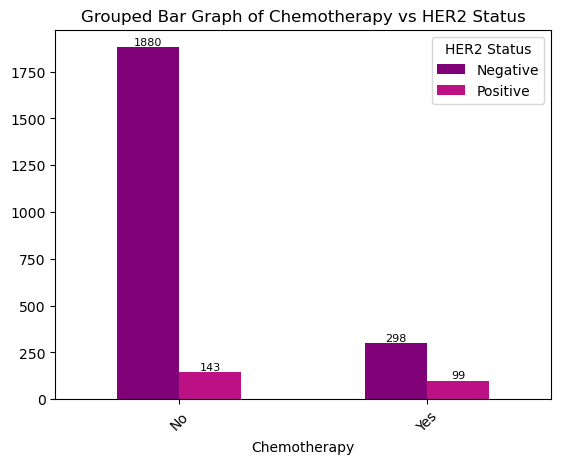

<Figure size 800x600 with 0 Axes>

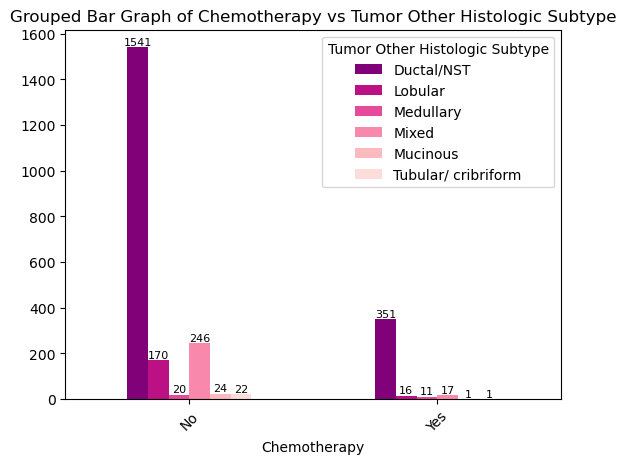

<Figure size 800x600 with 0 Axes>

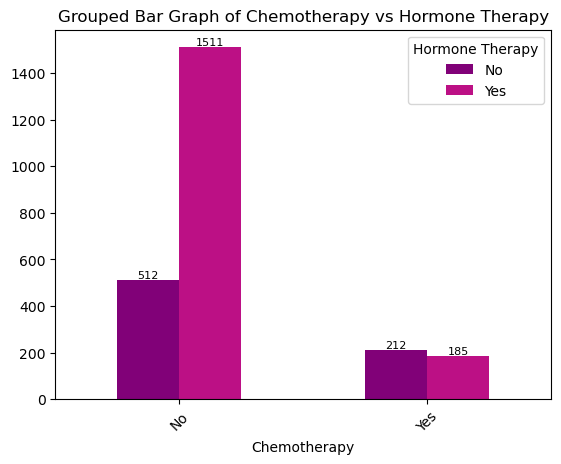

<Figure size 800x600 with 0 Axes>

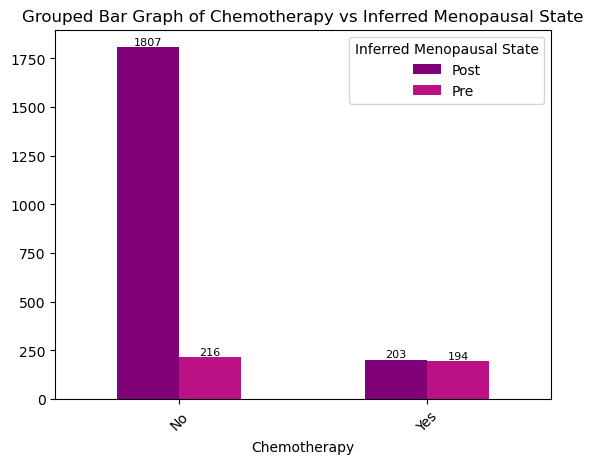

<Figure size 800x600 with 0 Axes>

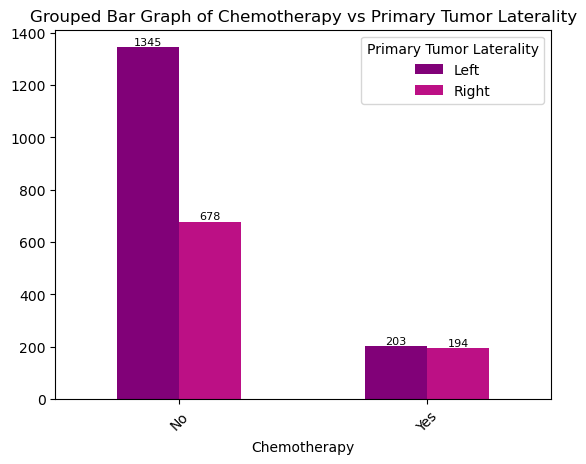

<Figure size 800x600 with 0 Axes>

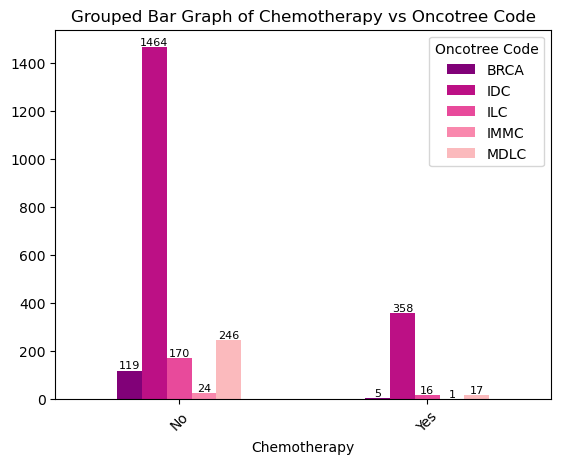

<Figure size 800x600 with 0 Axes>

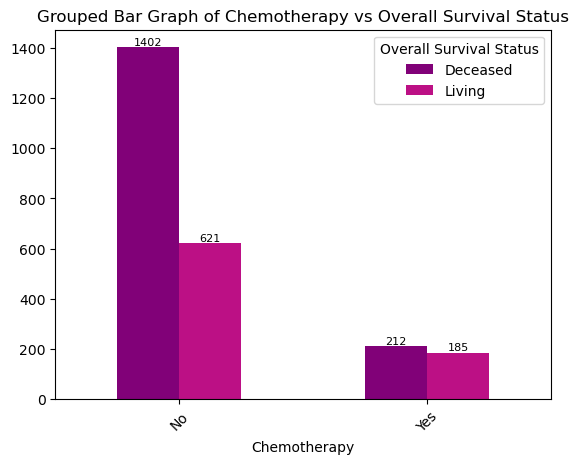

<Figure size 800x600 with 0 Axes>

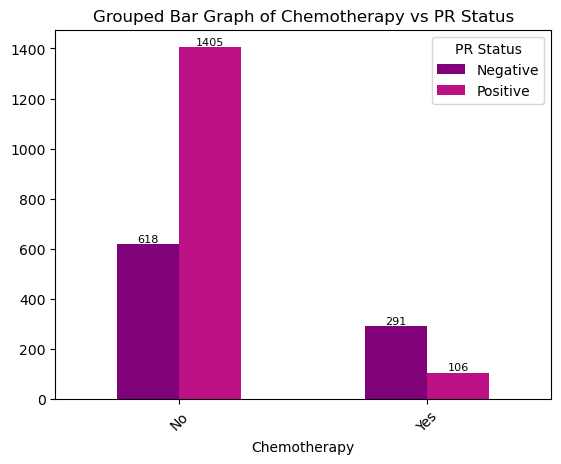

<Figure size 800x600 with 0 Axes>

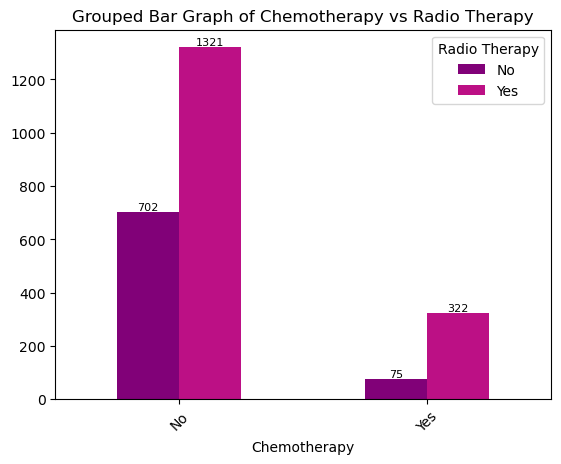

<Figure size 800x600 with 0 Axes>

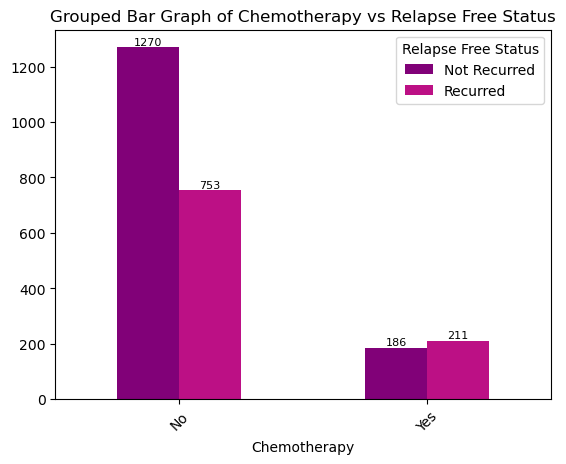

<Figure size 800x600 with 0 Axes>

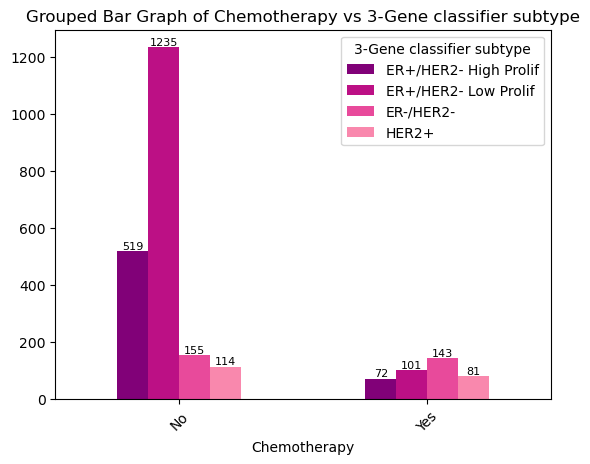

<Figure size 800x600 with 0 Axes>

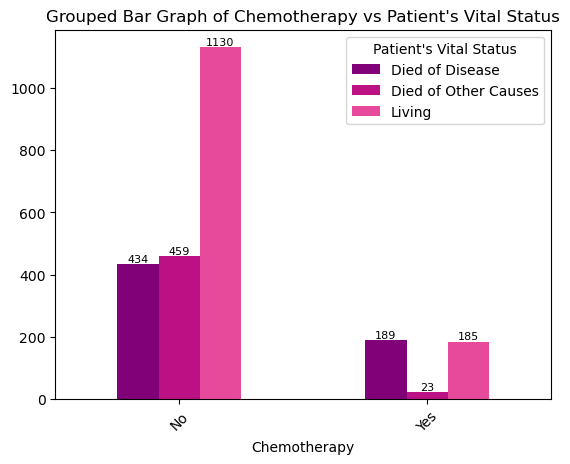

<Figure size 800x600 with 0 Axes>

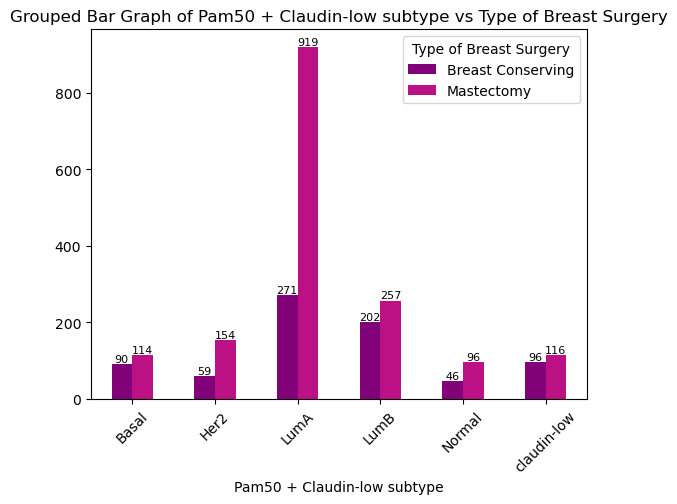

<Figure size 800x600 with 0 Axes>

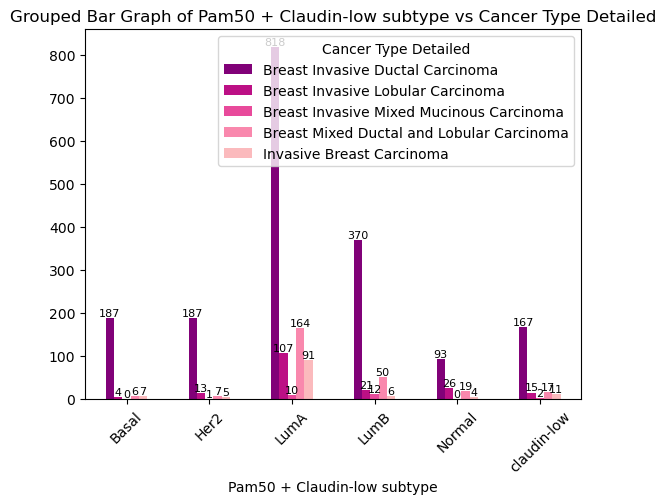

<Figure size 800x600 with 0 Axes>

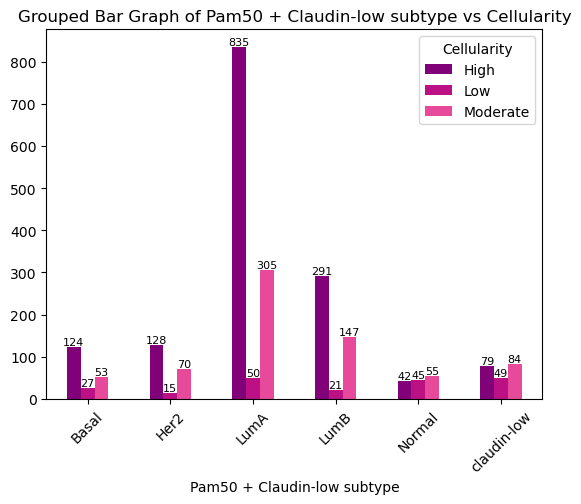

<Figure size 800x600 with 0 Axes>

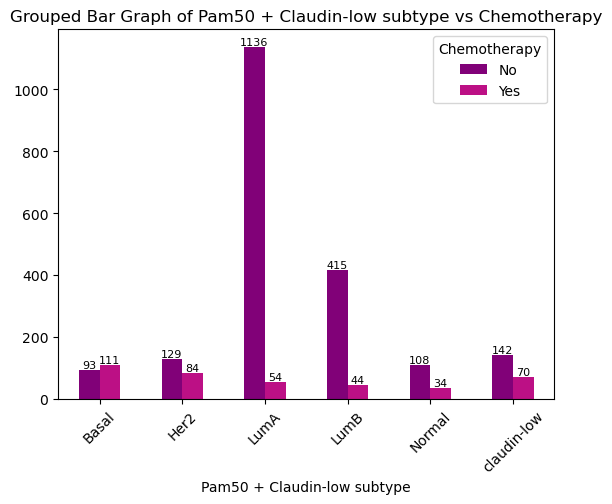

<Figure size 800x600 with 0 Axes>

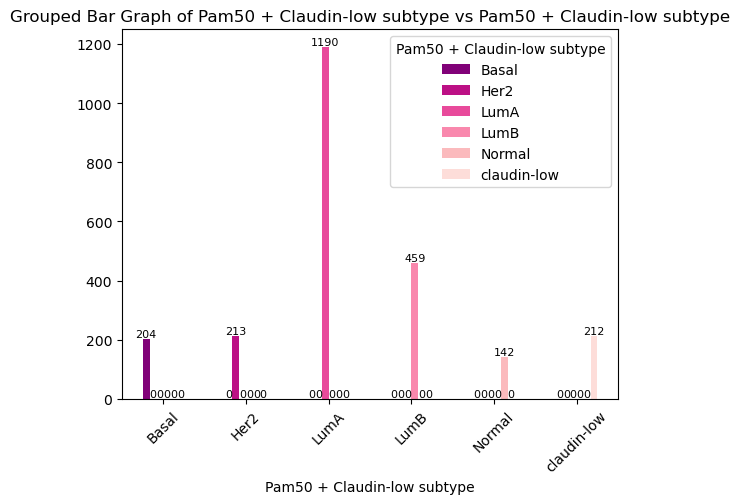

<Figure size 800x600 with 0 Axes>

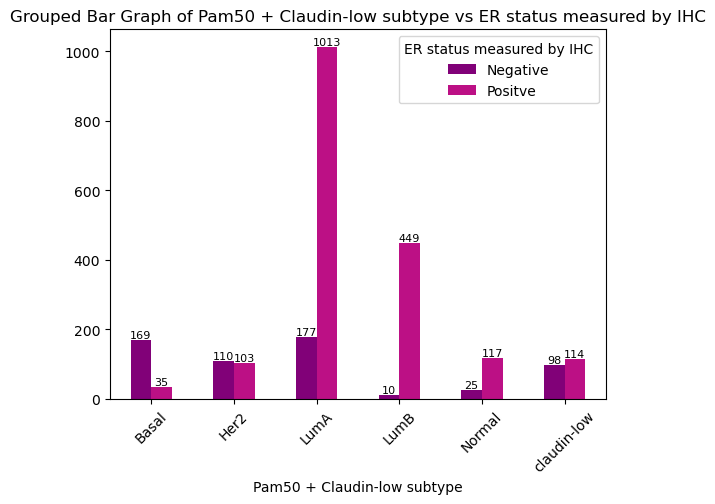

<Figure size 800x600 with 0 Axes>

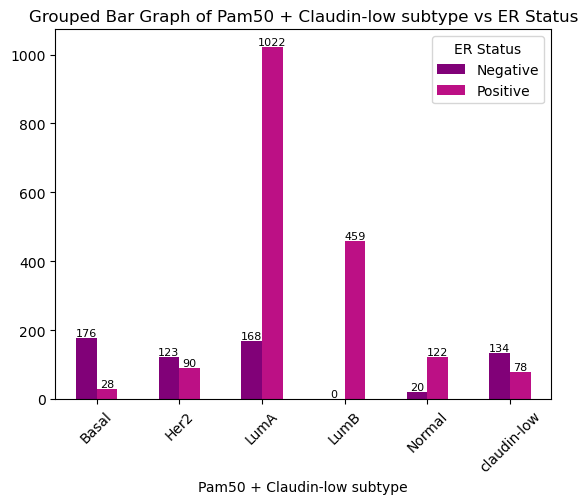

<Figure size 800x600 with 0 Axes>

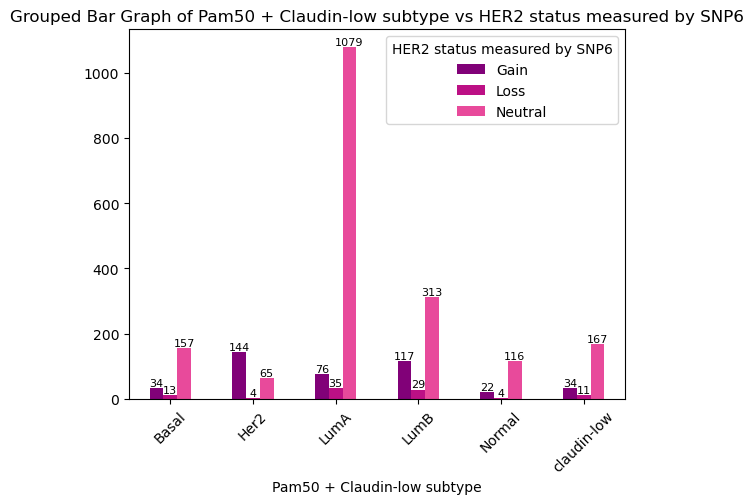

<Figure size 800x600 with 0 Axes>

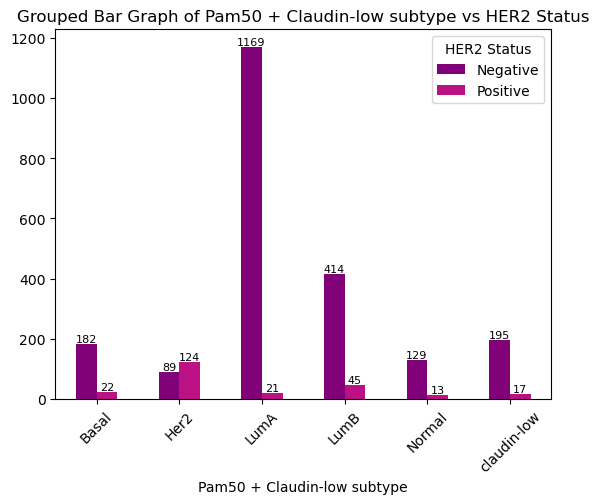

<Figure size 800x600 with 0 Axes>

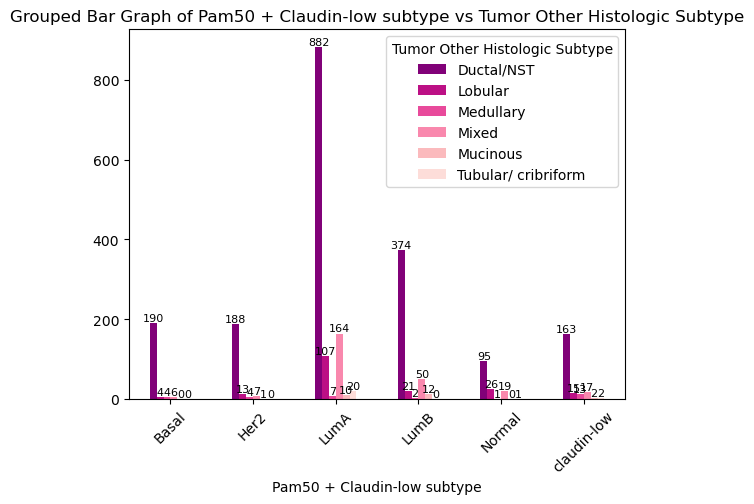

<Figure size 800x600 with 0 Axes>

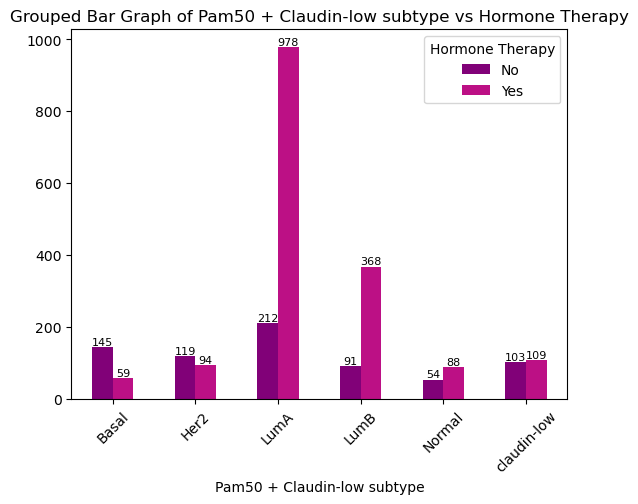

<Figure size 800x600 with 0 Axes>

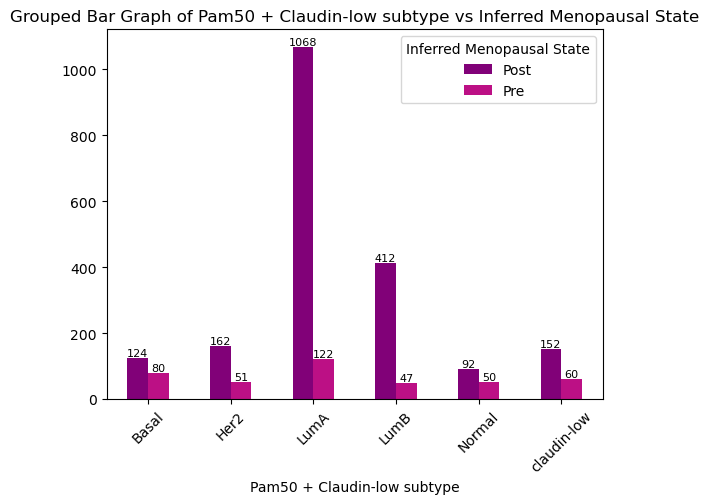

<Figure size 800x600 with 0 Axes>

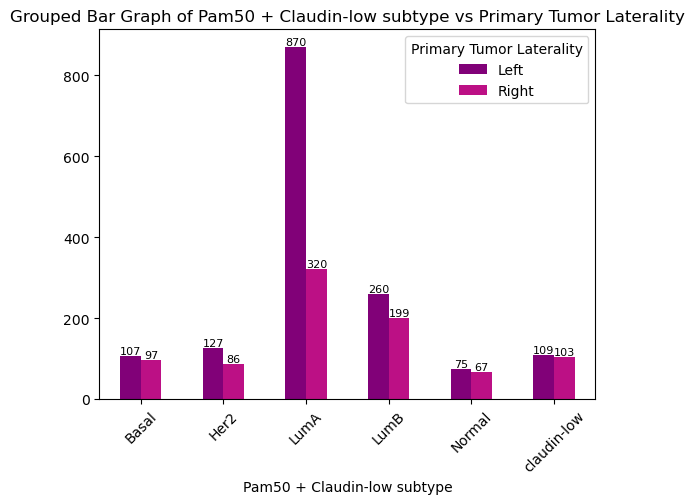

<Figure size 800x600 with 0 Axes>

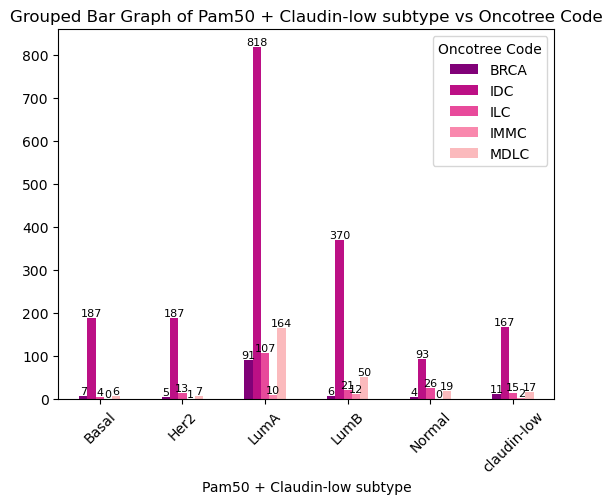

<Figure size 800x600 with 0 Axes>

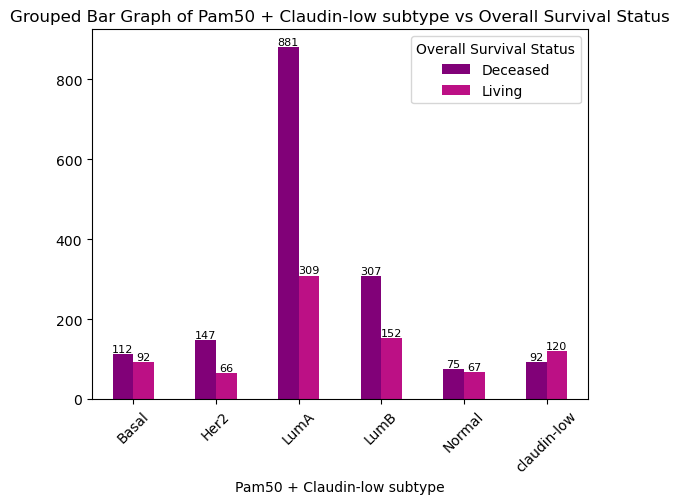

<Figure size 800x600 with 0 Axes>

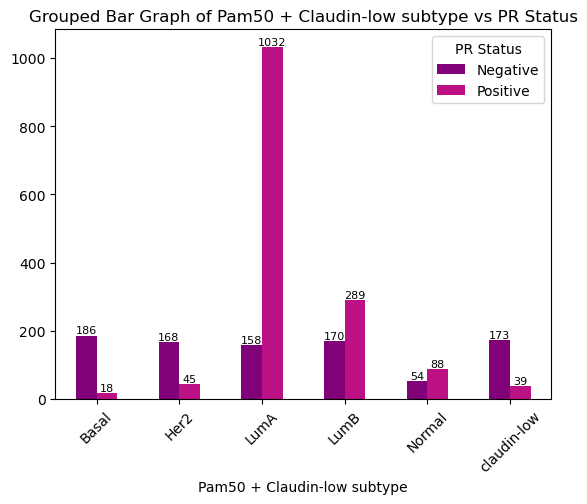

<Figure size 800x600 with 0 Axes>

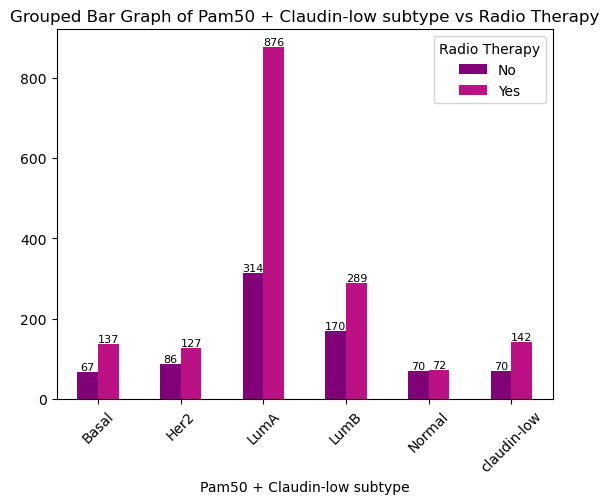

<Figure size 800x600 with 0 Axes>

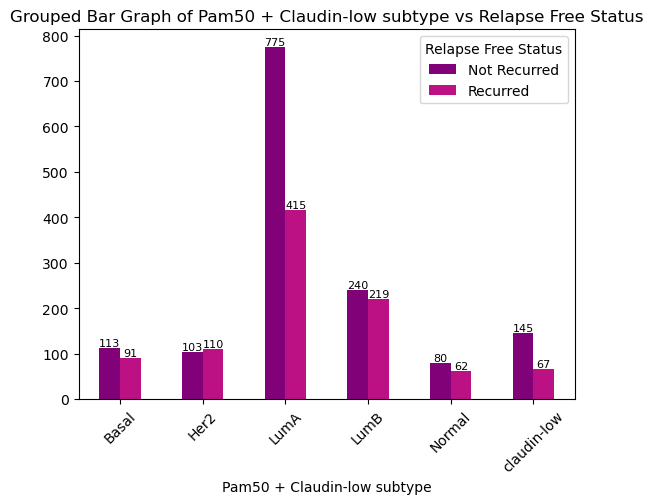

<Figure size 800x600 with 0 Axes>

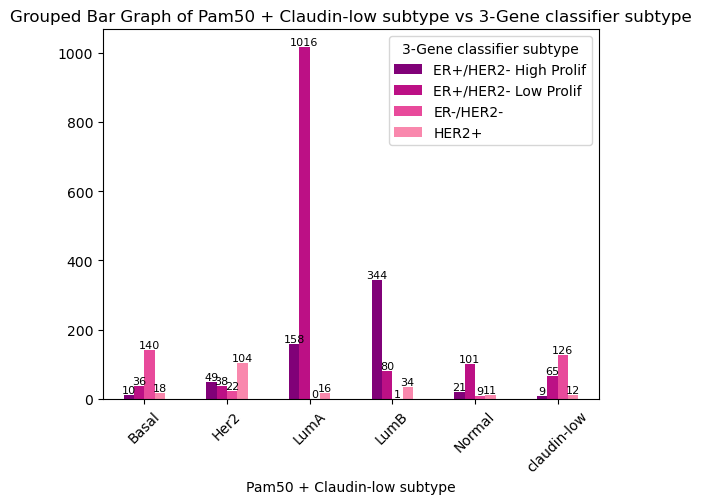

<Figure size 800x600 with 0 Axes>

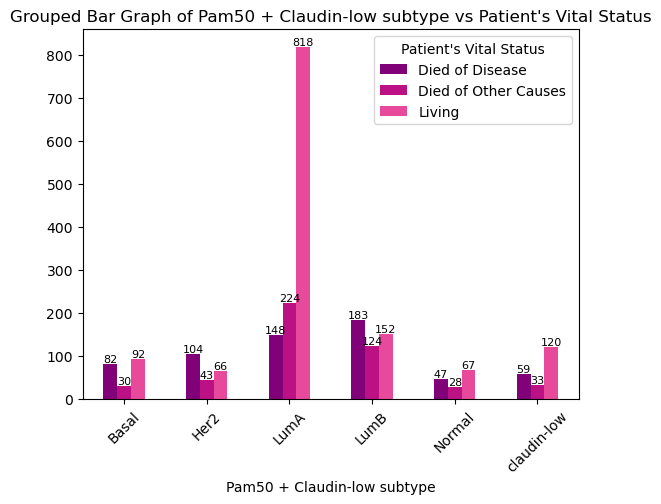

<Figure size 800x600 with 0 Axes>

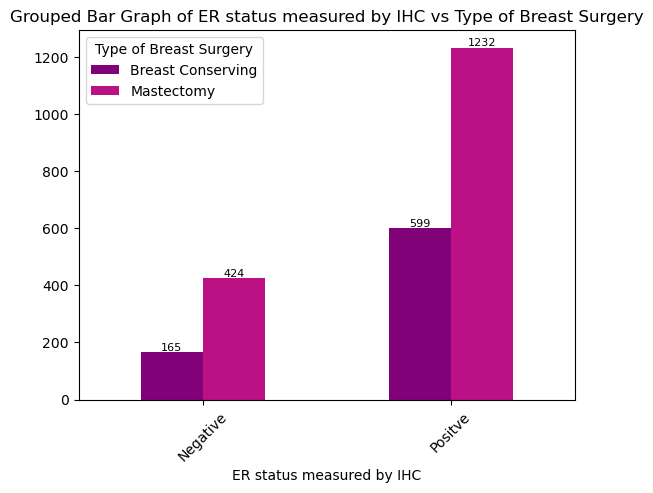

<Figure size 800x600 with 0 Axes>

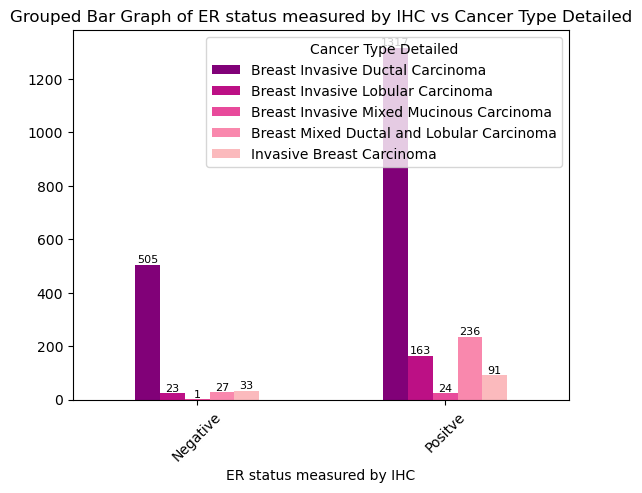

<Figure size 800x600 with 0 Axes>

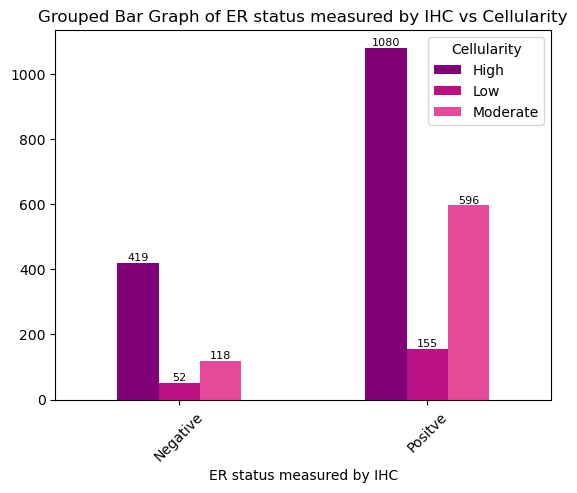

<Figure size 800x600 with 0 Axes>

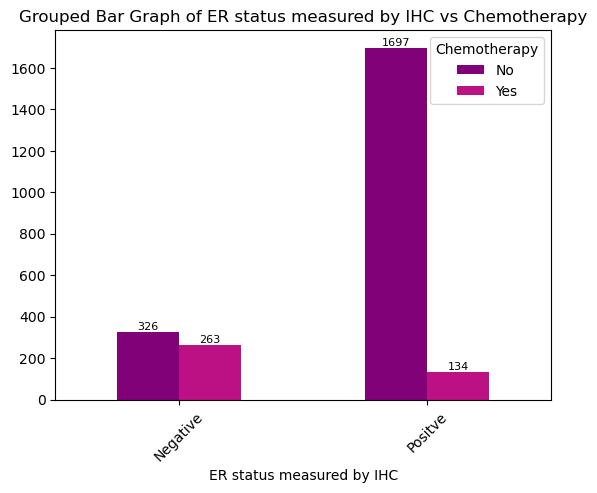

<Figure size 800x600 with 0 Axes>

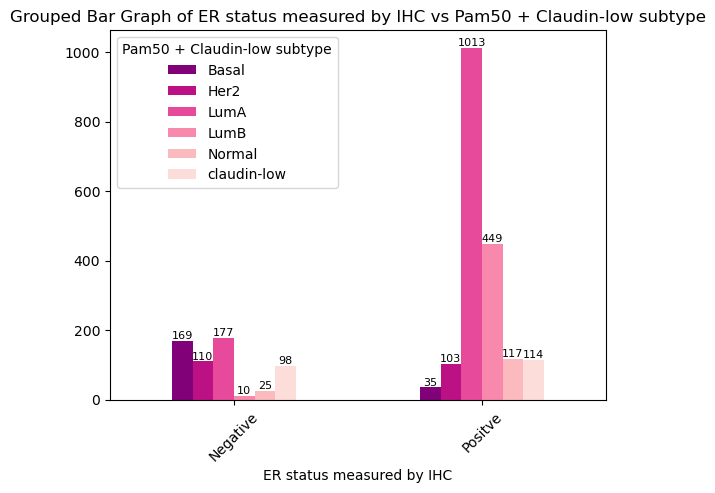

<Figure size 800x600 with 0 Axes>

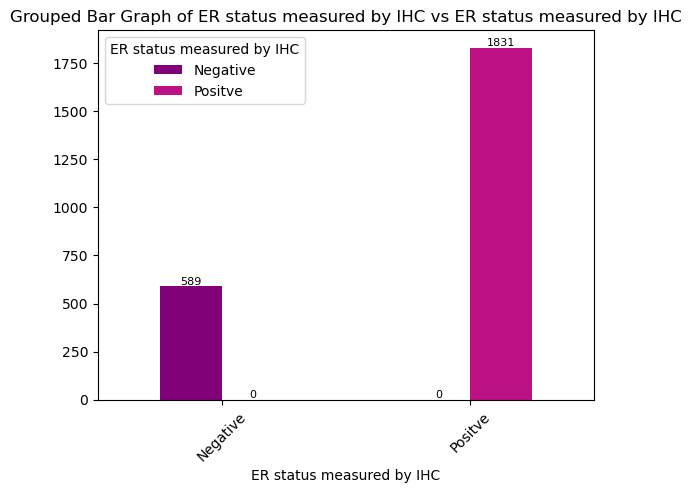

<Figure size 800x600 with 0 Axes>

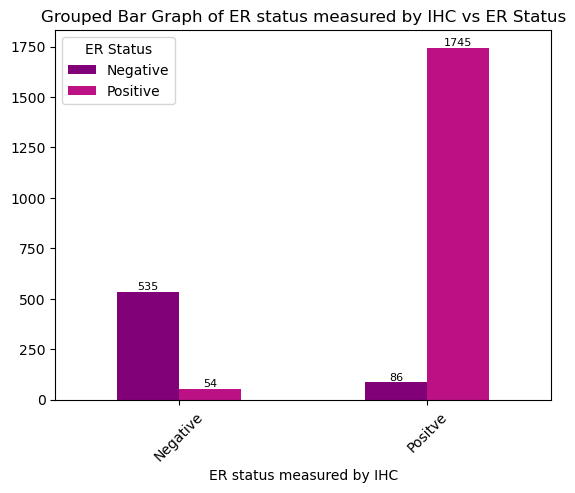

<Figure size 800x600 with 0 Axes>

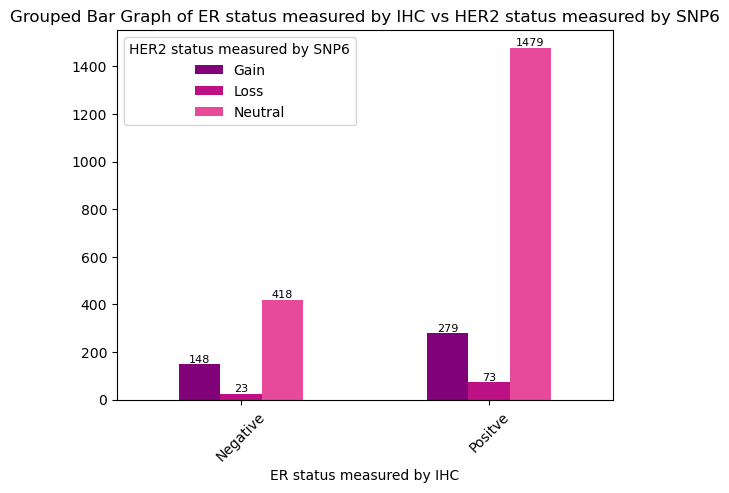

<Figure size 800x600 with 0 Axes>

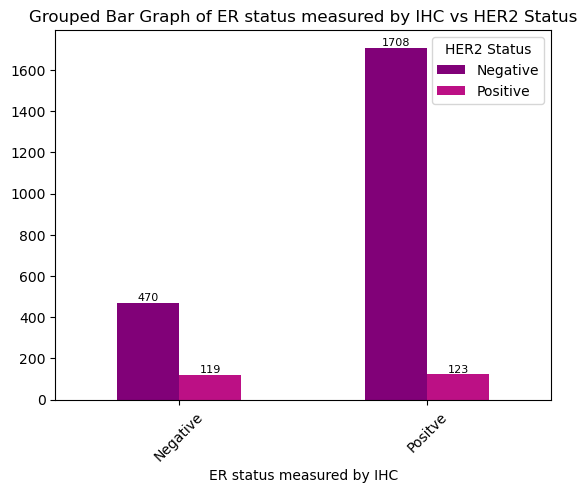

<Figure size 800x600 with 0 Axes>

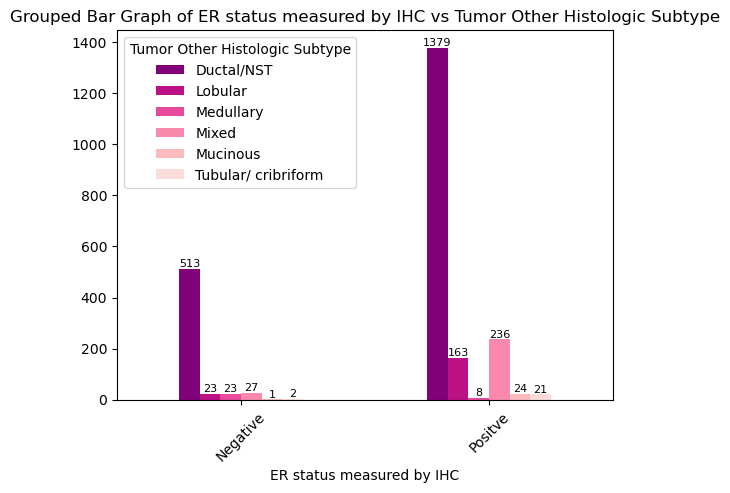

<Figure size 800x600 with 0 Axes>

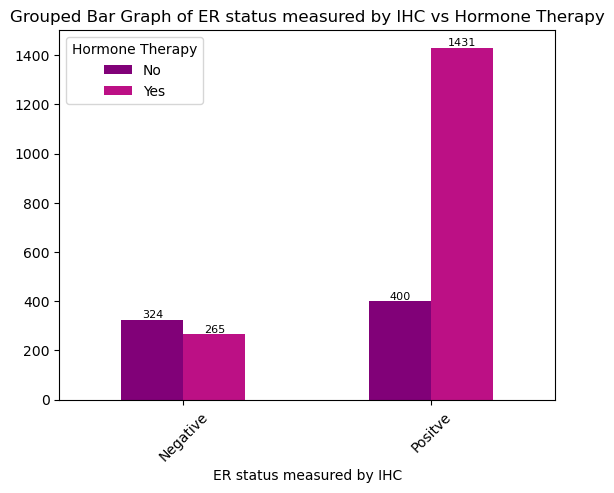

<Figure size 800x600 with 0 Axes>

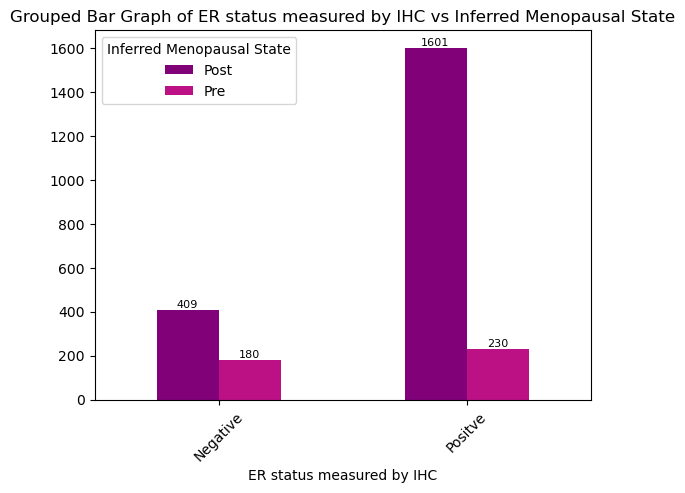

<Figure size 800x600 with 0 Axes>

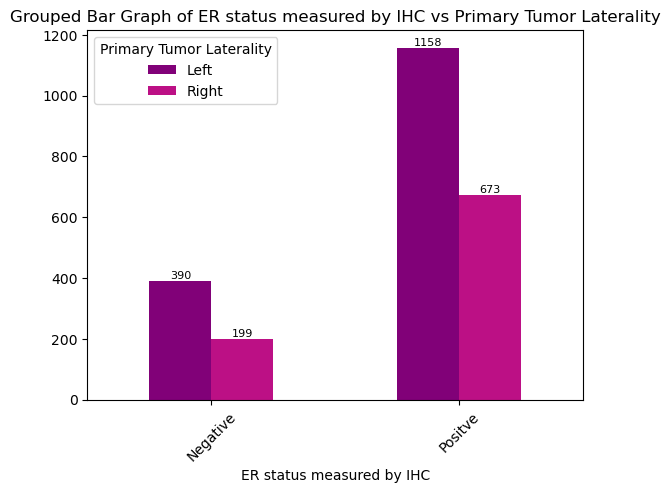

<Figure size 800x600 with 0 Axes>

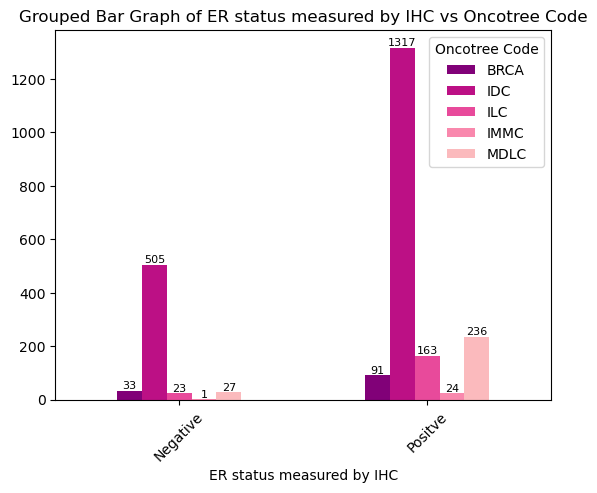

<Figure size 800x600 with 0 Axes>

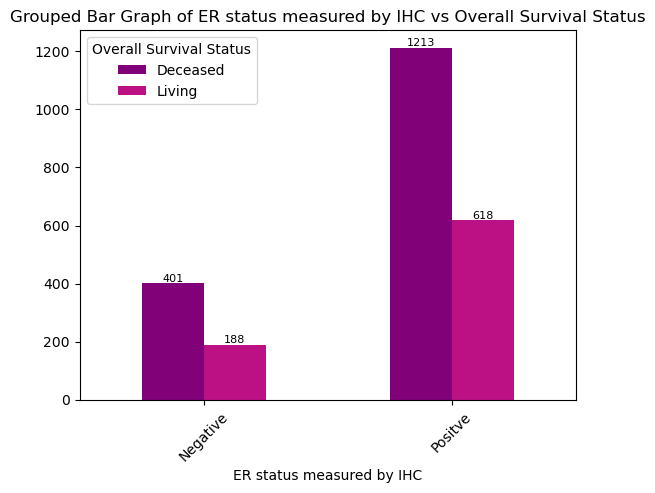

<Figure size 800x600 with 0 Axes>

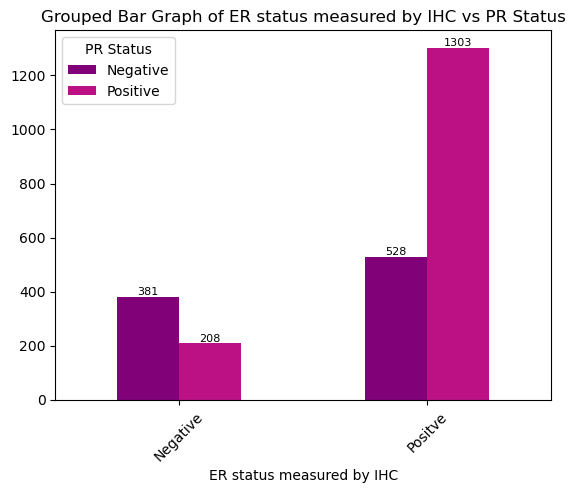

<Figure size 800x600 with 0 Axes>

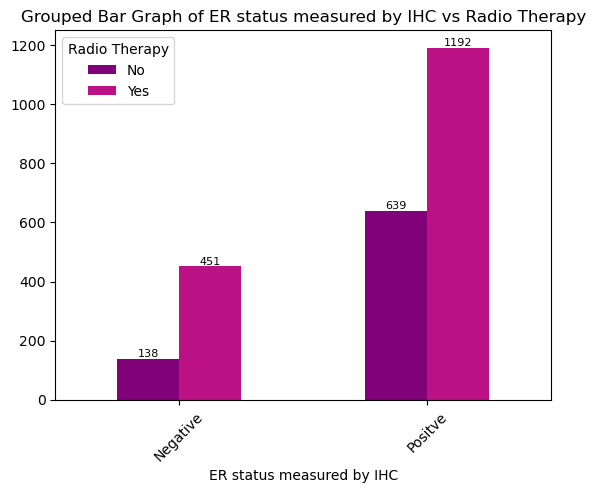

<Figure size 800x600 with 0 Axes>

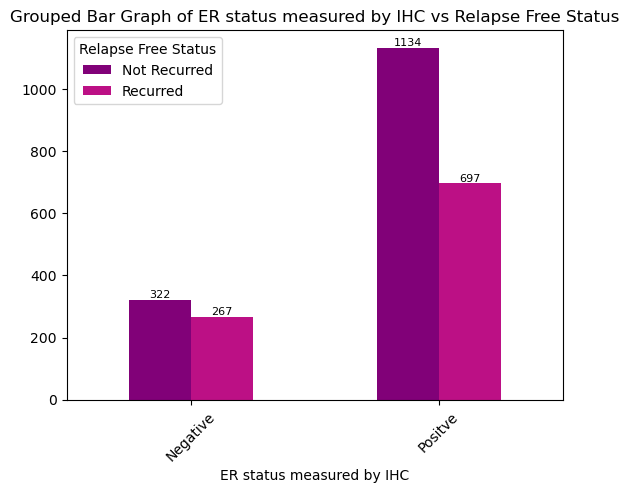

<Figure size 800x600 with 0 Axes>

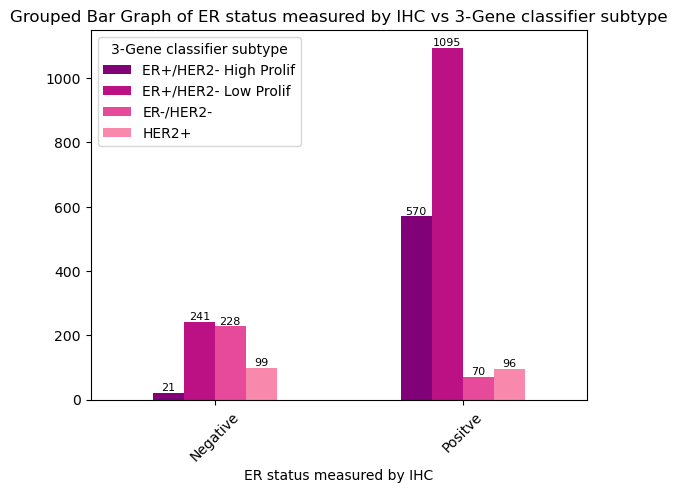

<Figure size 800x600 with 0 Axes>

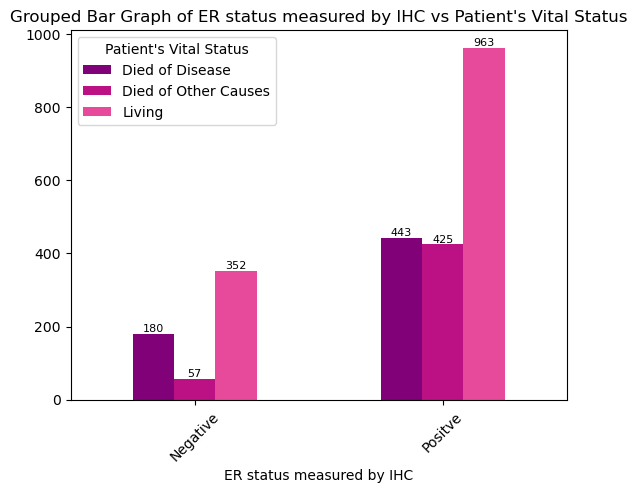

<Figure size 800x600 with 0 Axes>

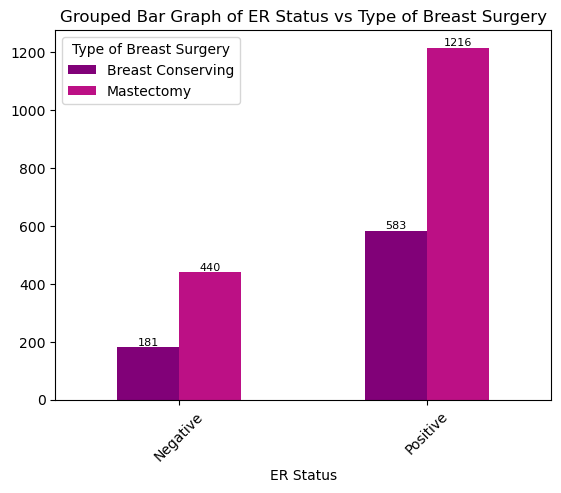

<Figure size 800x600 with 0 Axes>

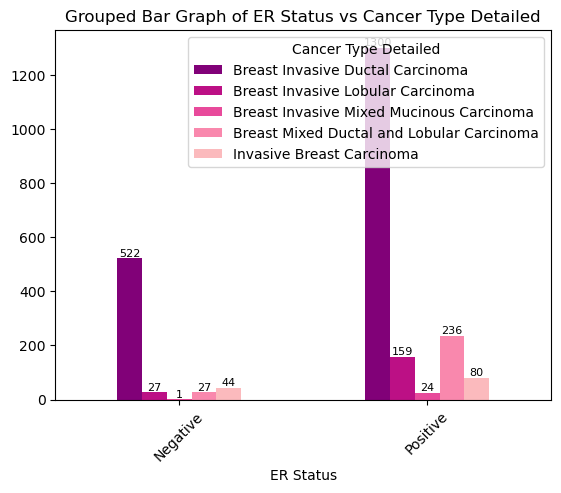

<Figure size 800x600 with 0 Axes>

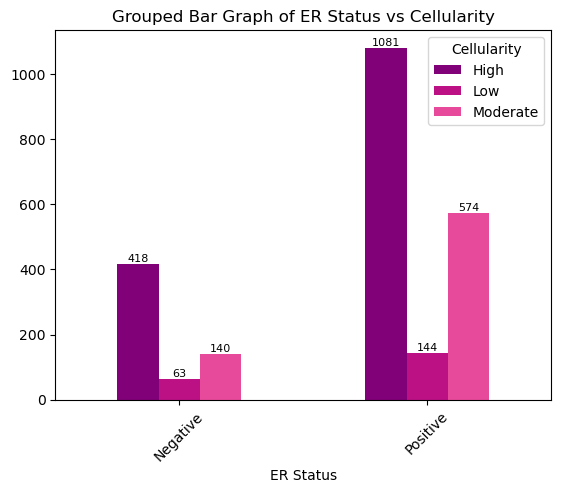

<Figure size 800x600 with 0 Axes>

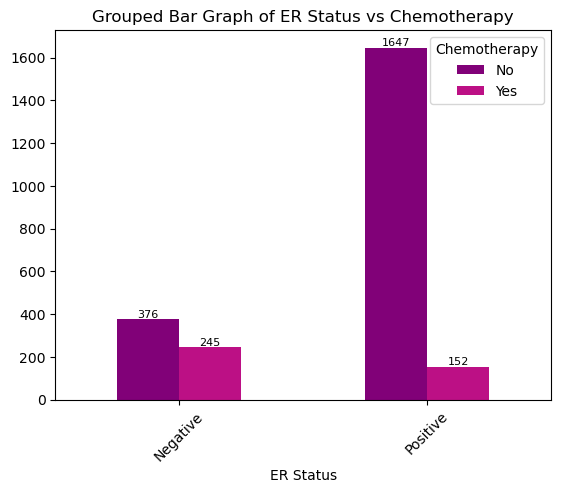

<Figure size 800x600 with 0 Axes>

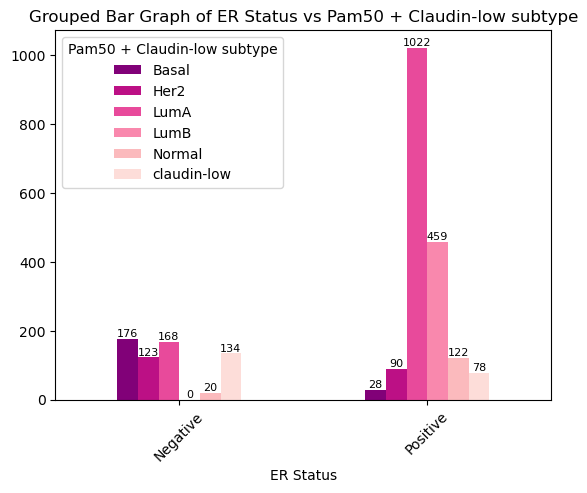

<Figure size 800x600 with 0 Axes>

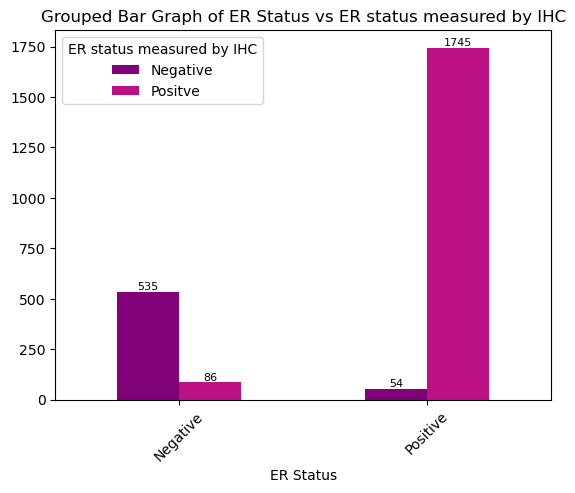

<Figure size 800x600 with 0 Axes>

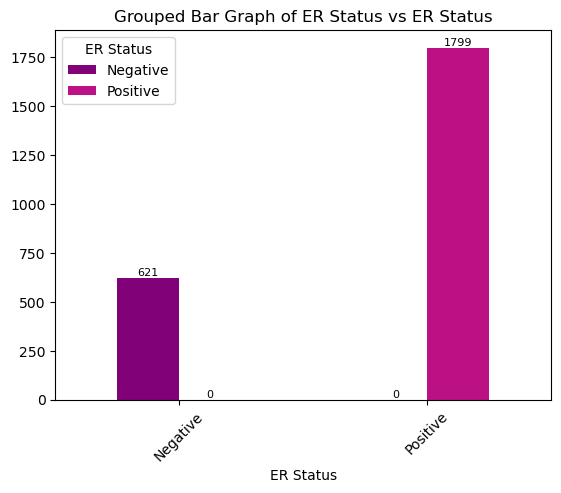

<Figure size 800x600 with 0 Axes>

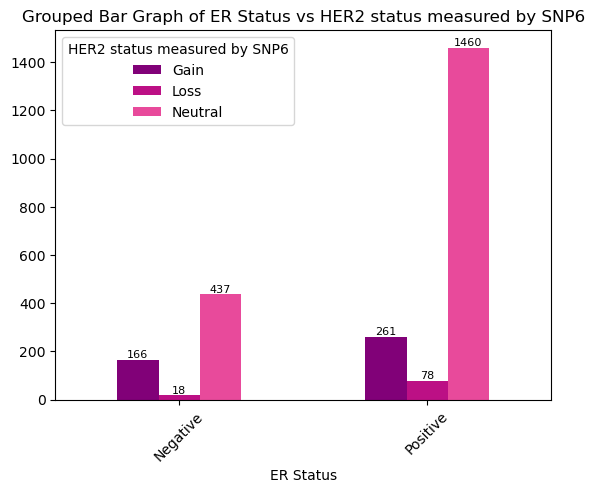

<Figure size 800x600 with 0 Axes>

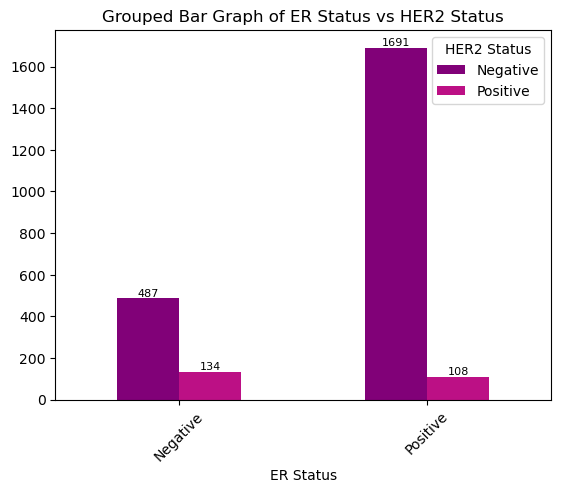

<Figure size 800x600 with 0 Axes>

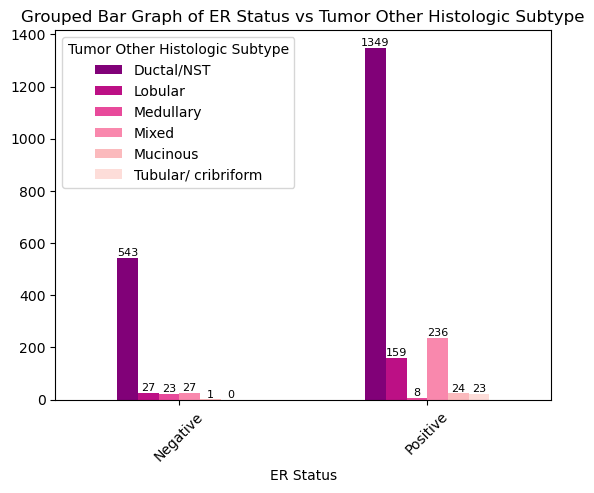

<Figure size 800x600 with 0 Axes>

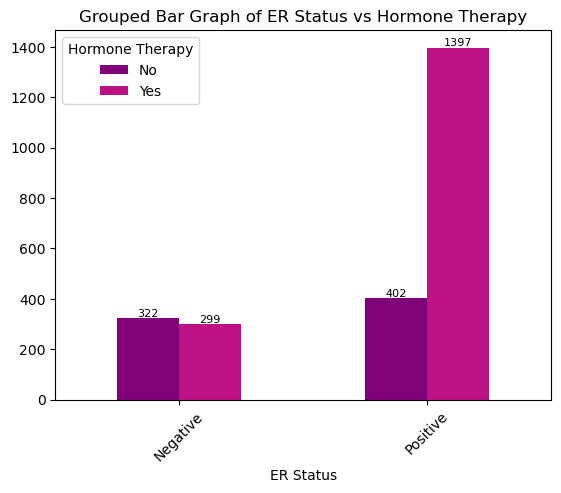

<Figure size 800x600 with 0 Axes>

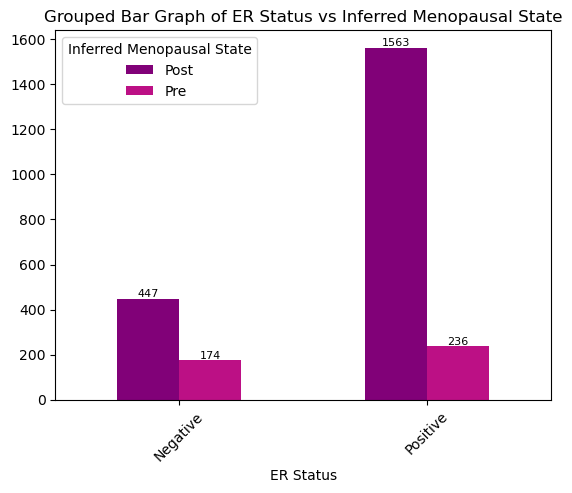

<Figure size 800x600 with 0 Axes>

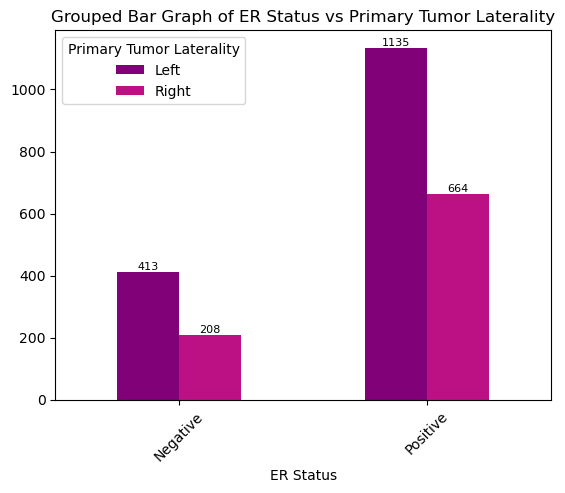

<Figure size 800x600 with 0 Axes>

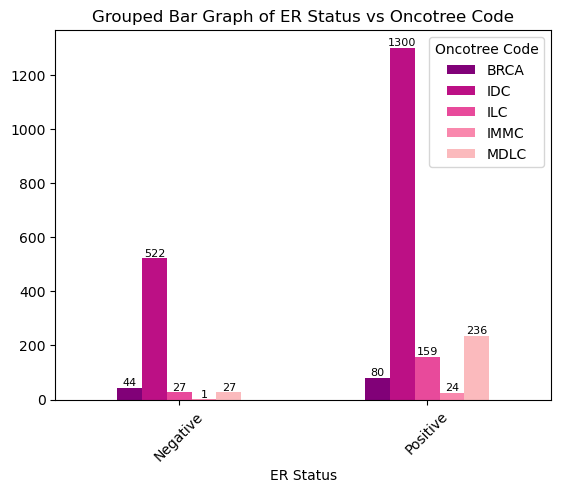

<Figure size 800x600 with 0 Axes>

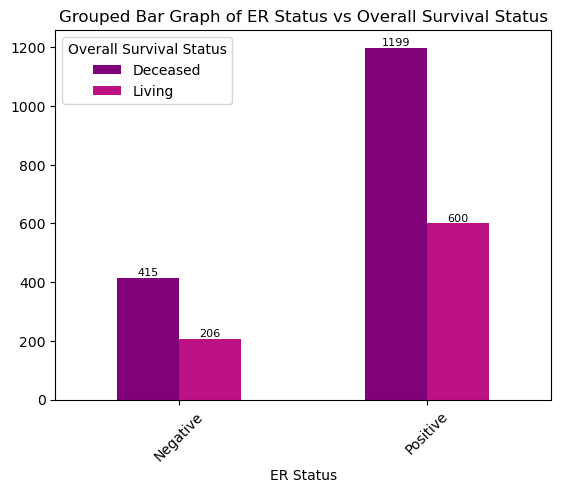

<Figure size 800x600 with 0 Axes>

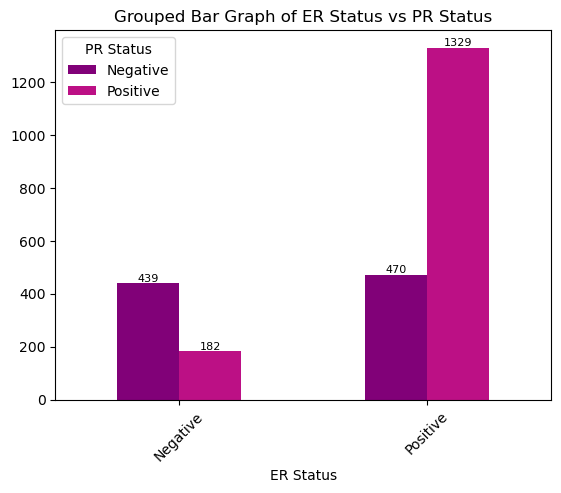

<Figure size 800x600 with 0 Axes>

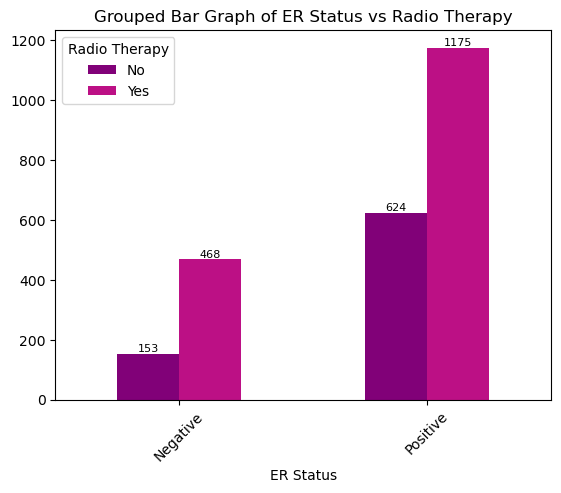

<Figure size 800x600 with 0 Axes>

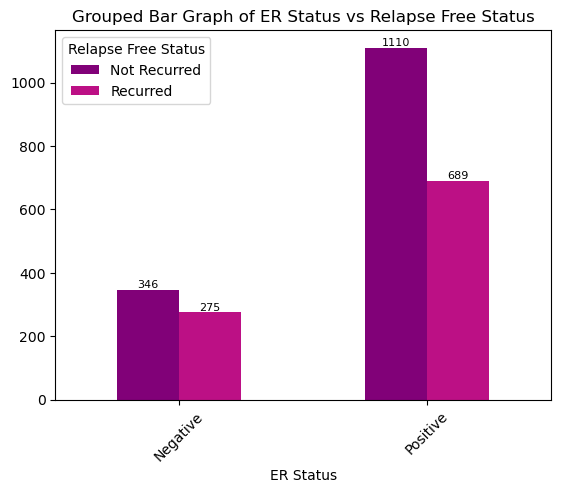

<Figure size 800x600 with 0 Axes>

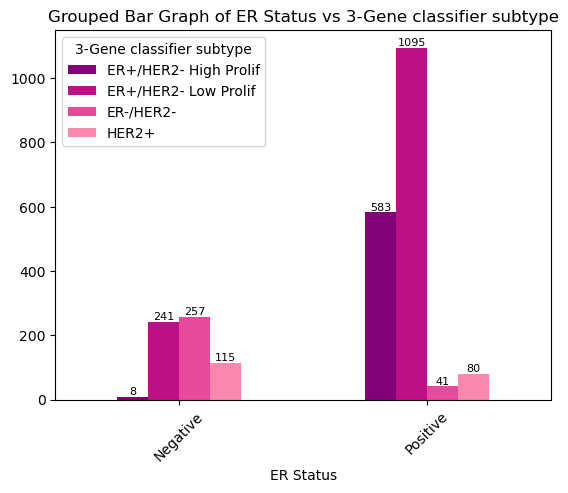

<Figure size 800x600 with 0 Axes>

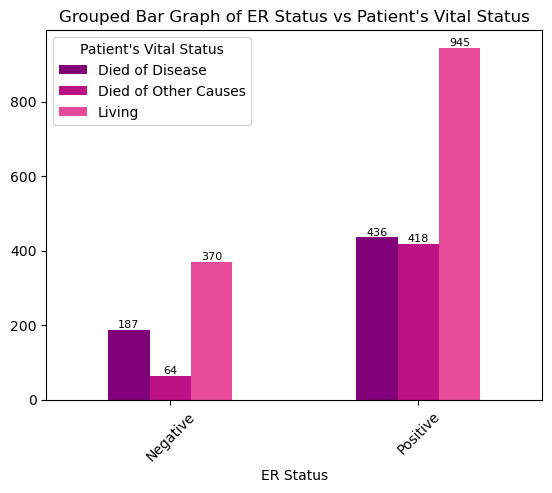

<Figure size 800x600 with 0 Axes>

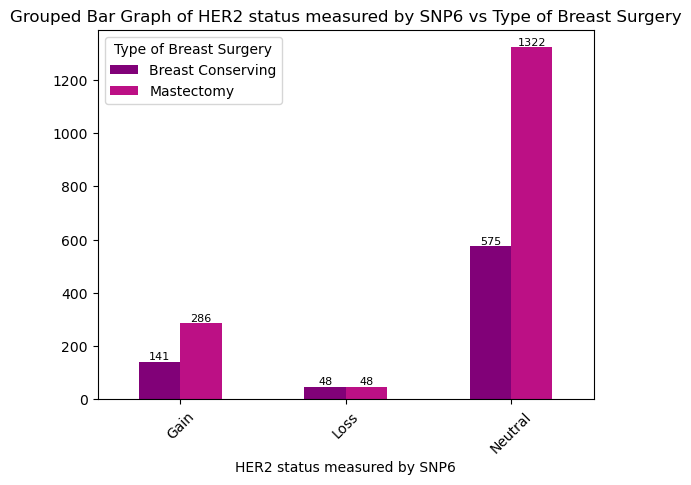

<Figure size 800x600 with 0 Axes>

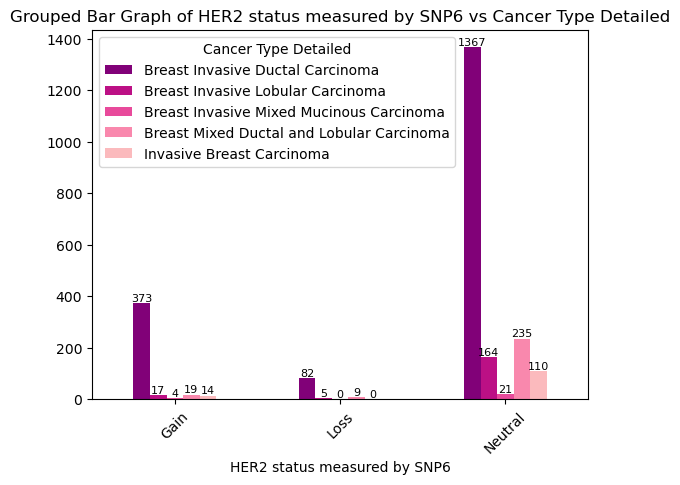

<Figure size 800x600 with 0 Axes>

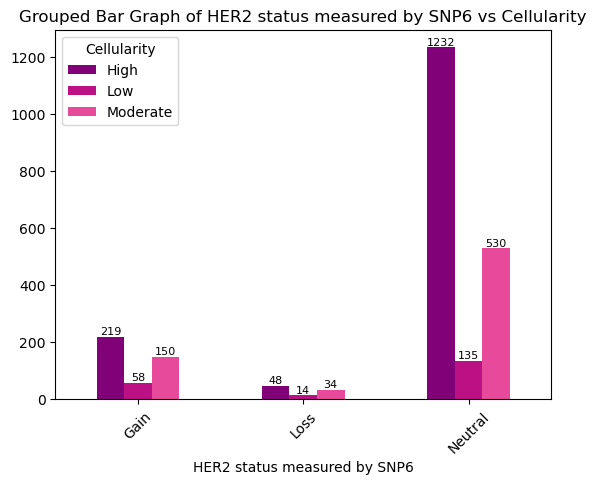

<Figure size 800x600 with 0 Axes>

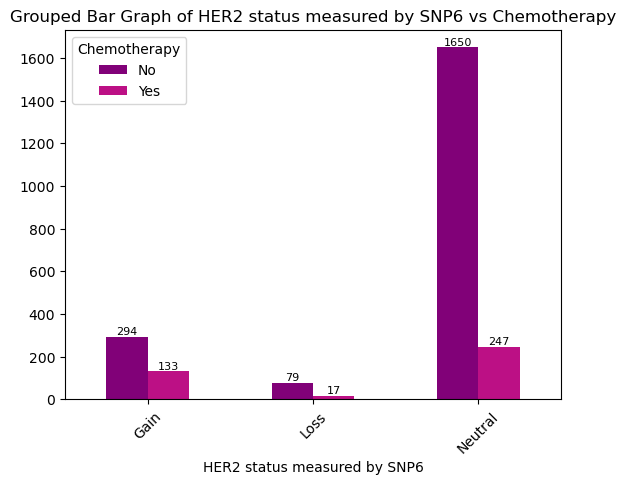

<Figure size 800x600 with 0 Axes>

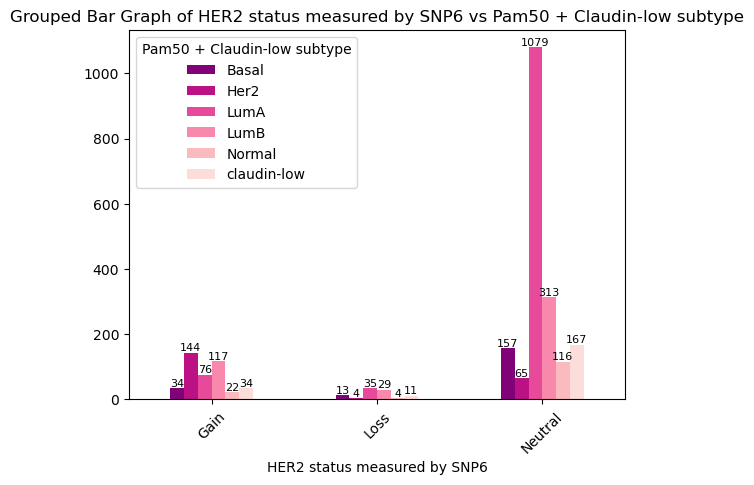

<Figure size 800x600 with 0 Axes>

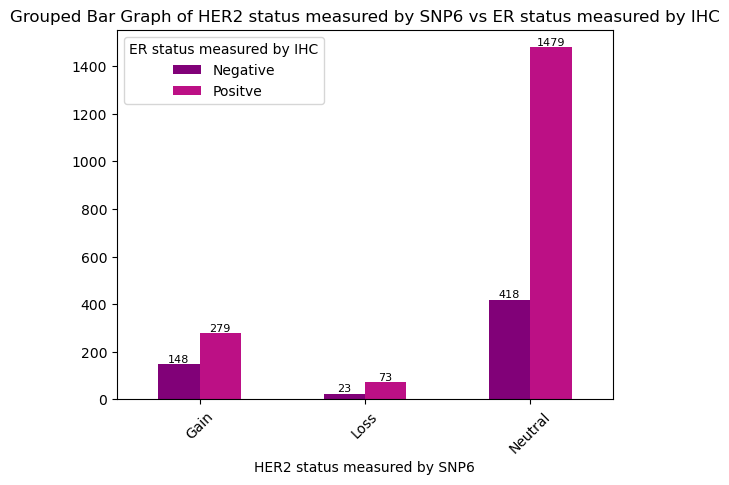

<Figure size 800x600 with 0 Axes>

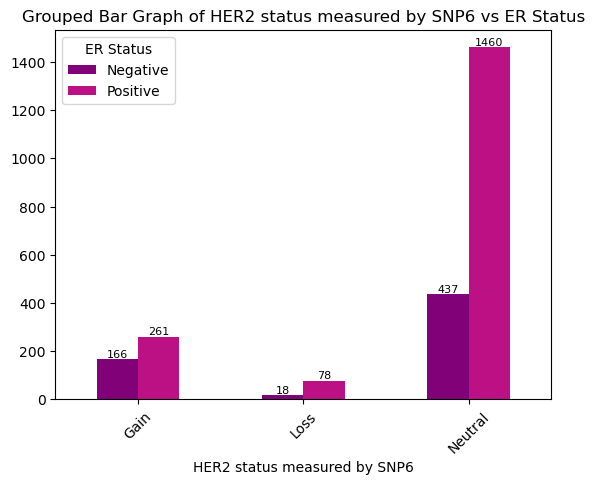

<Figure size 800x600 with 0 Axes>

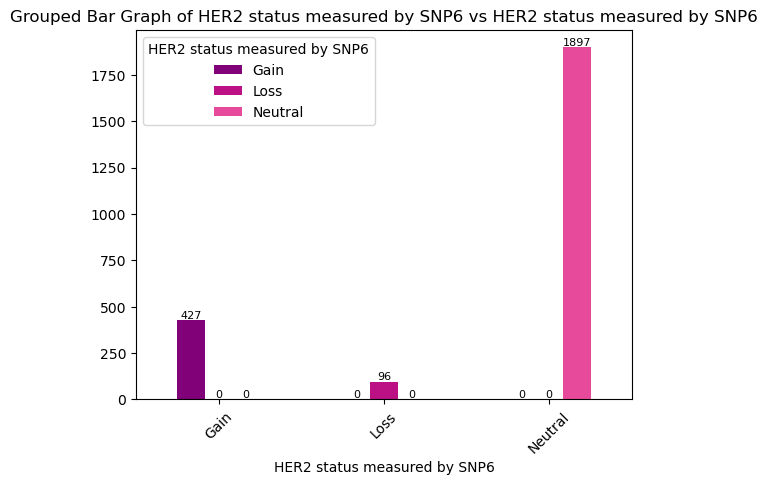

<Figure size 800x600 with 0 Axes>

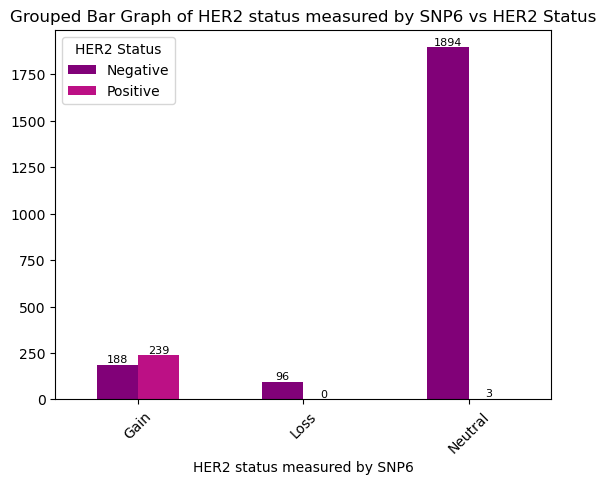

<Figure size 800x600 with 0 Axes>

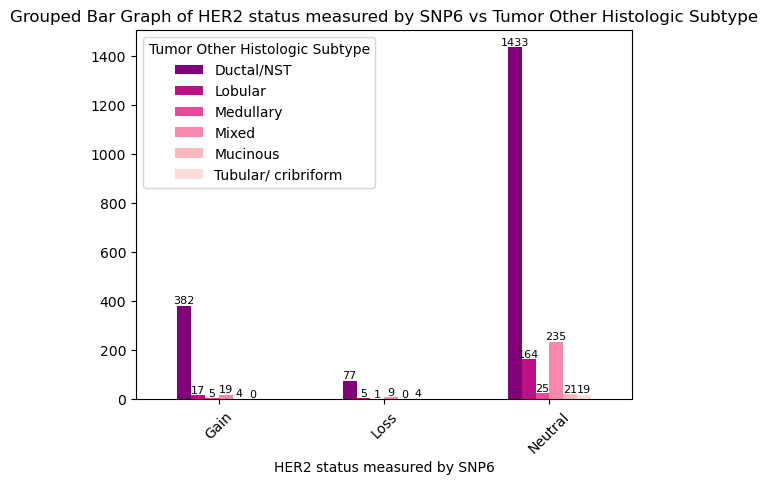

<Figure size 800x600 with 0 Axes>

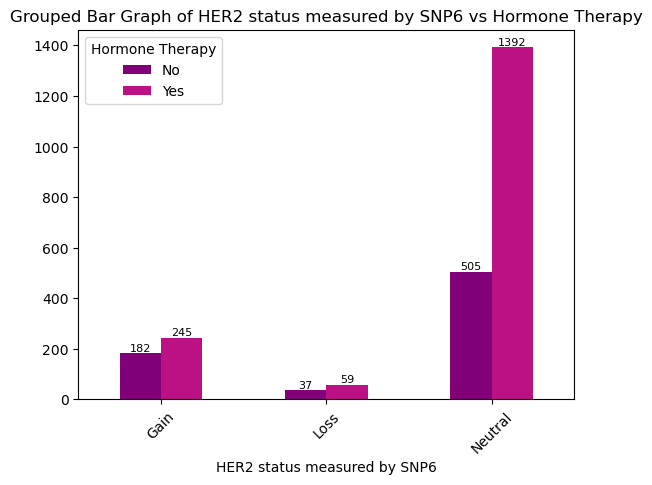

<Figure size 800x600 with 0 Axes>

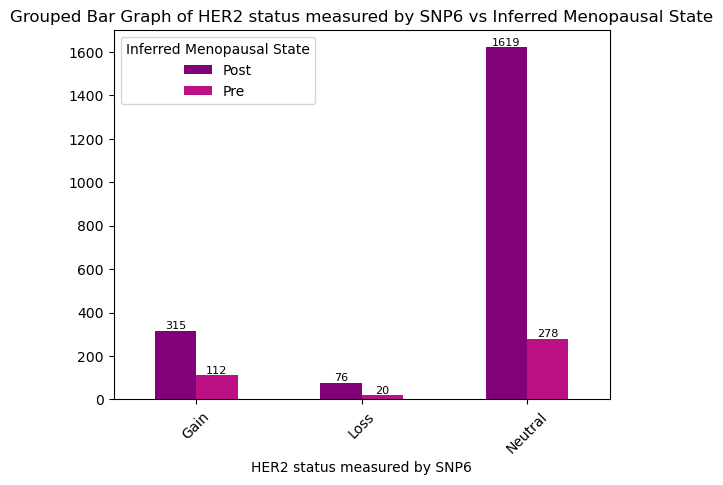

<Figure size 800x600 with 0 Axes>

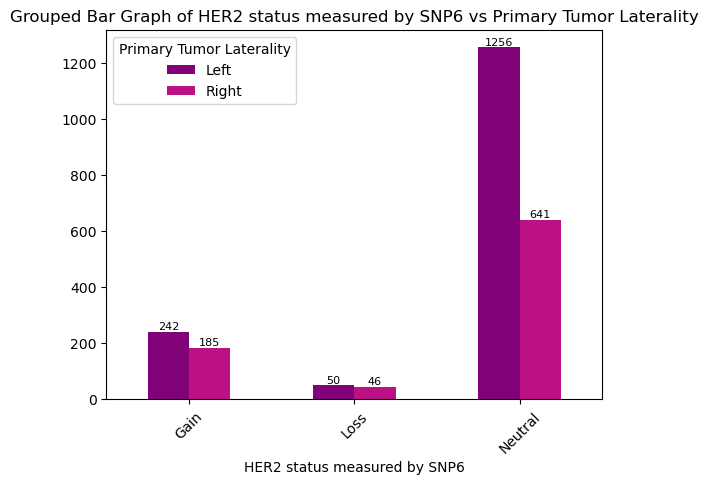

<Figure size 800x600 with 0 Axes>

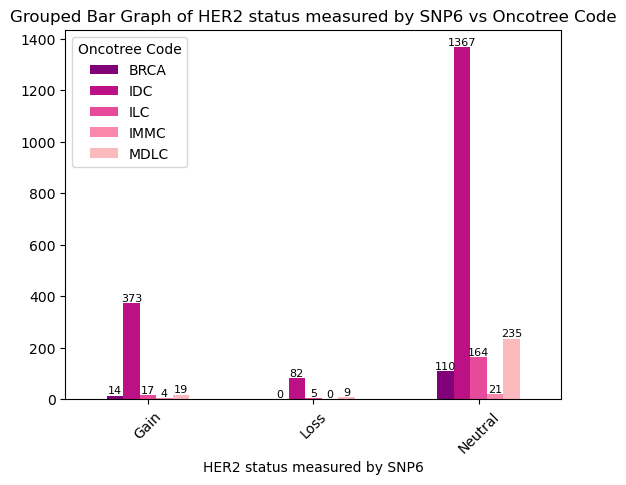

<Figure size 800x600 with 0 Axes>

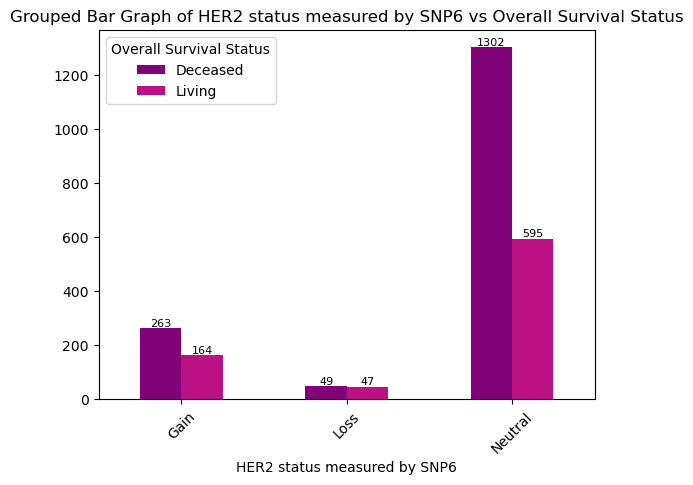

<Figure size 800x600 with 0 Axes>

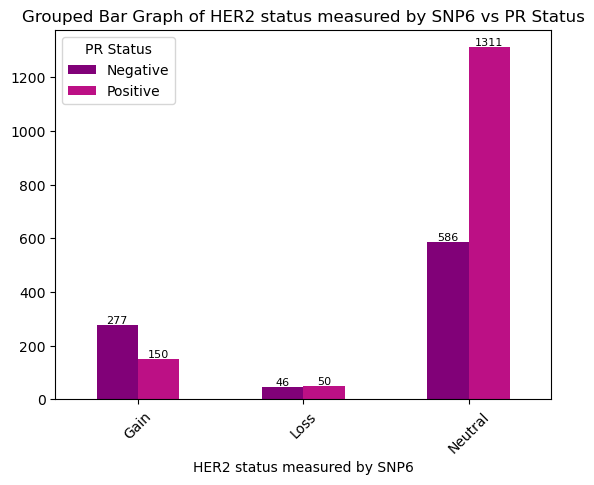

<Figure size 800x600 with 0 Axes>

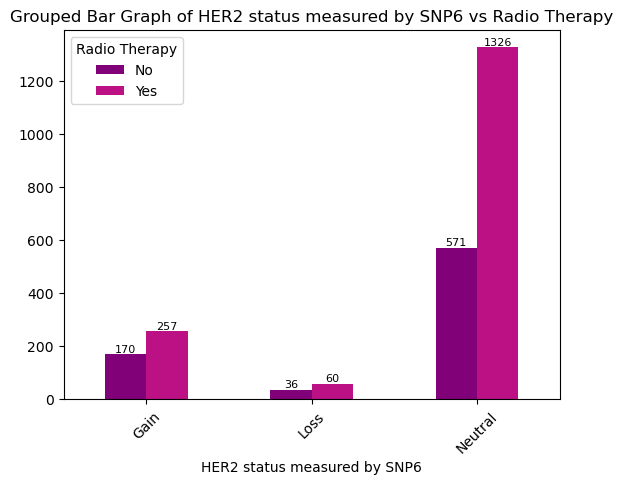

<Figure size 800x600 with 0 Axes>

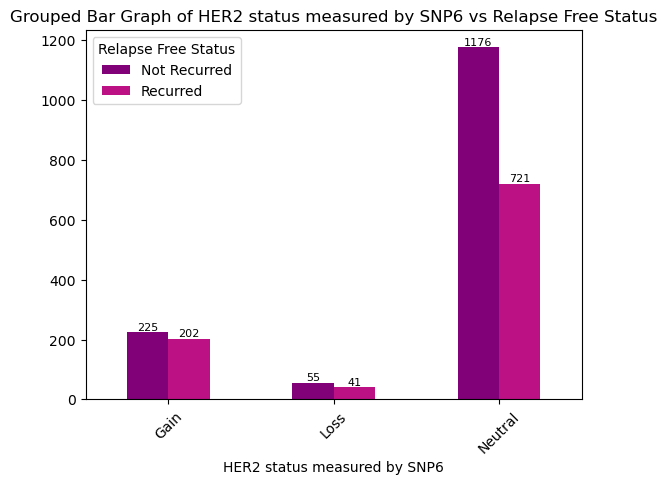

<Figure size 800x600 with 0 Axes>

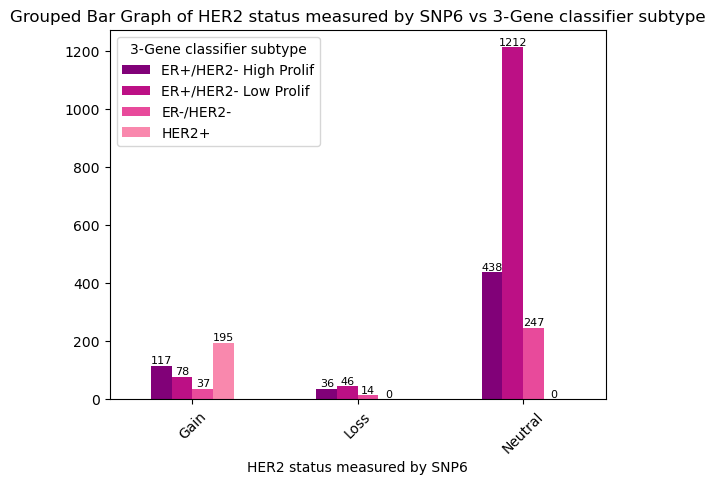

<Figure size 800x600 with 0 Axes>

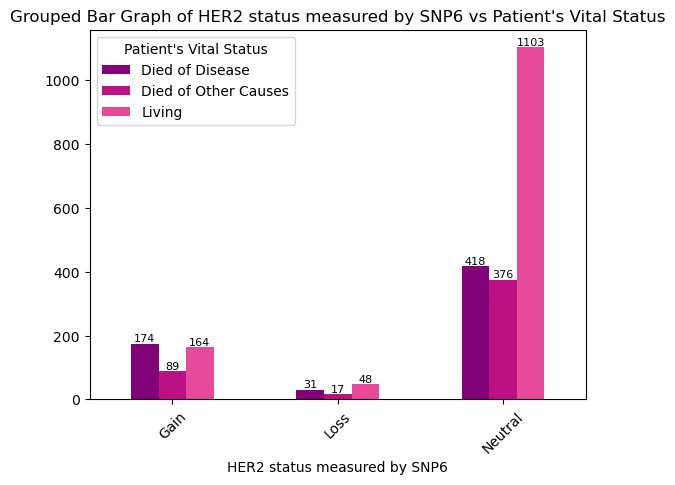

<Figure size 800x600 with 0 Axes>

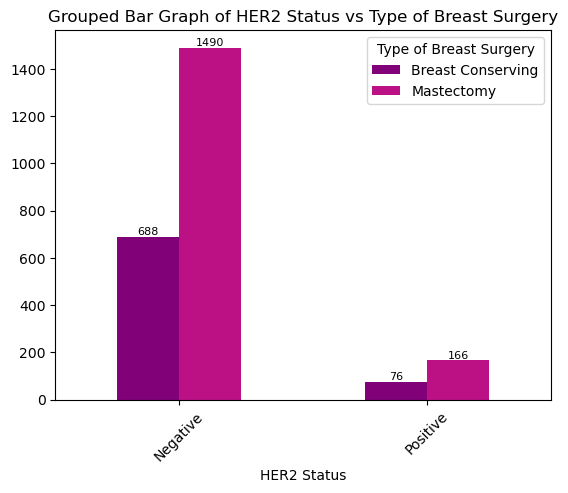

<Figure size 800x600 with 0 Axes>

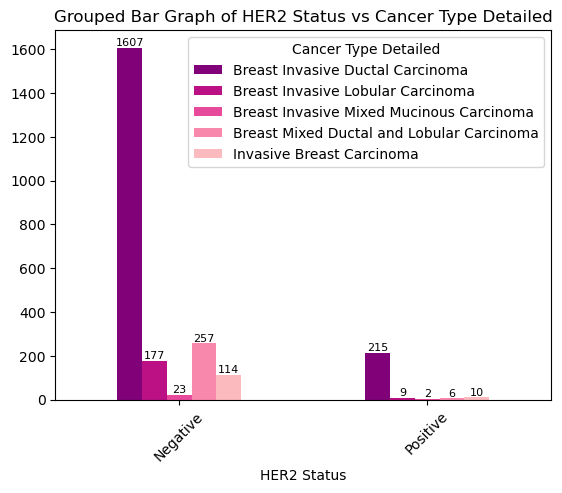

<Figure size 800x600 with 0 Axes>

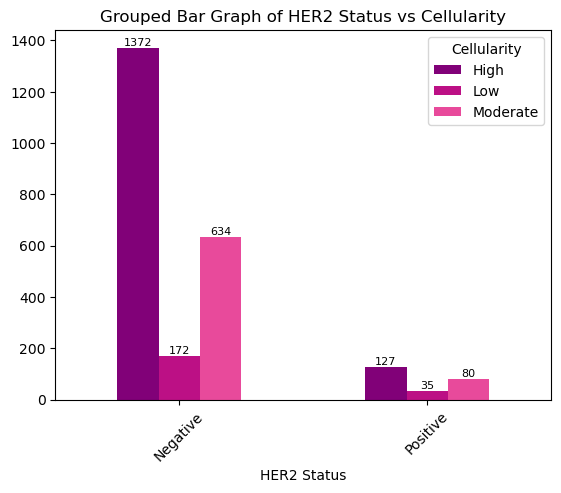

<Figure size 800x600 with 0 Axes>

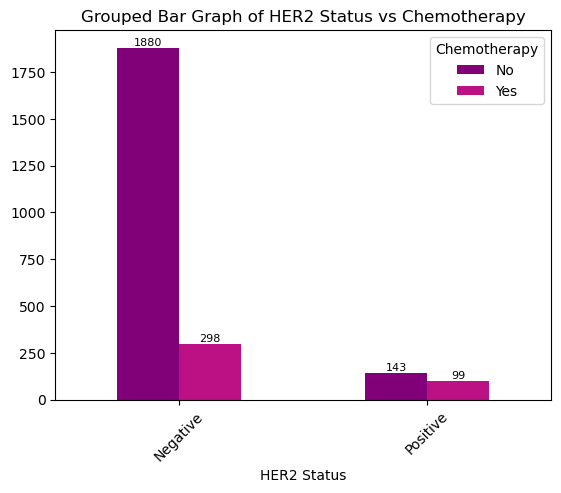

<Figure size 800x600 with 0 Axes>

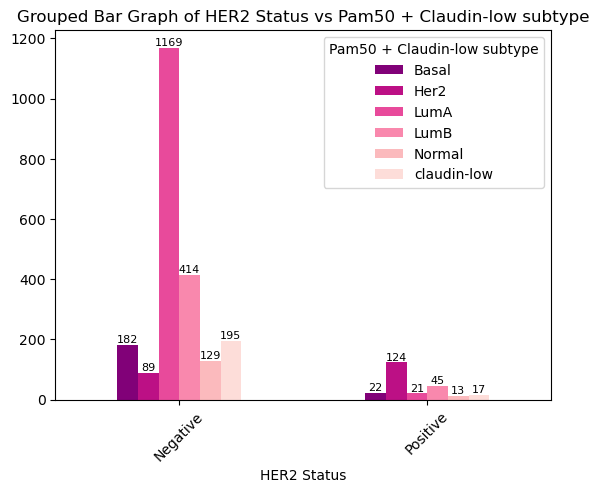

<Figure size 800x600 with 0 Axes>

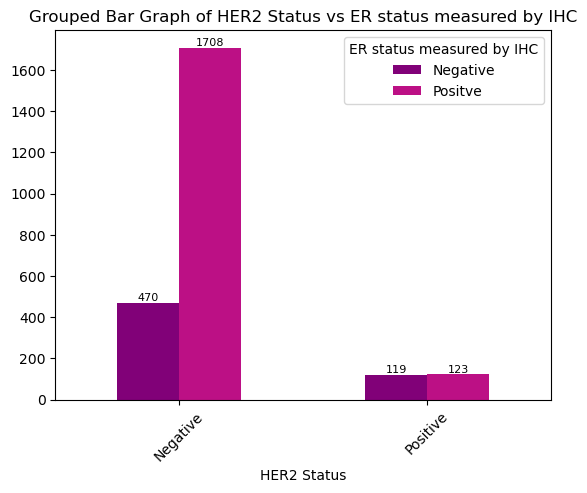

<Figure size 800x600 with 0 Axes>

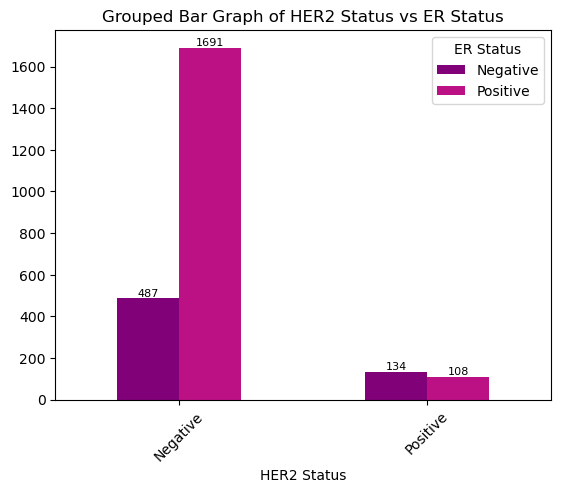

<Figure size 800x600 with 0 Axes>

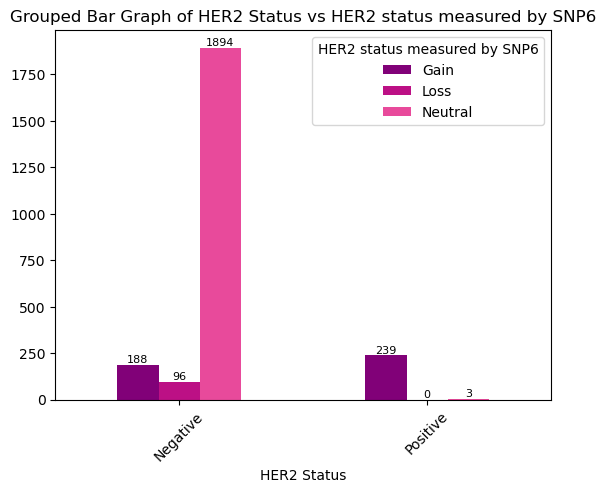

<Figure size 800x600 with 0 Axes>

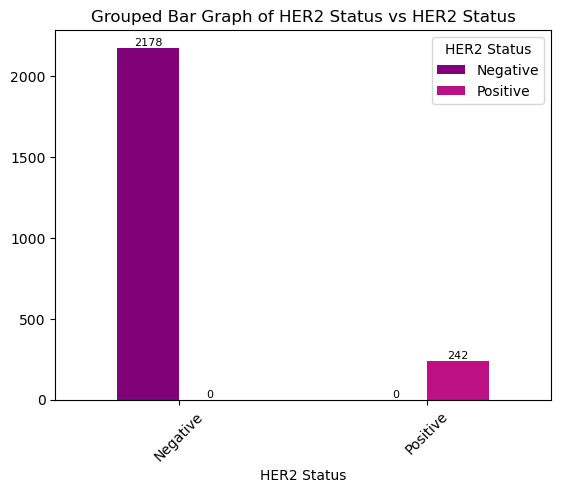

<Figure size 800x600 with 0 Axes>

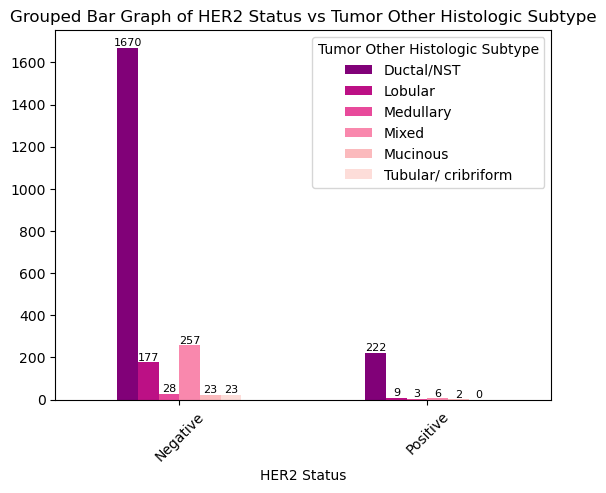

<Figure size 800x600 with 0 Axes>

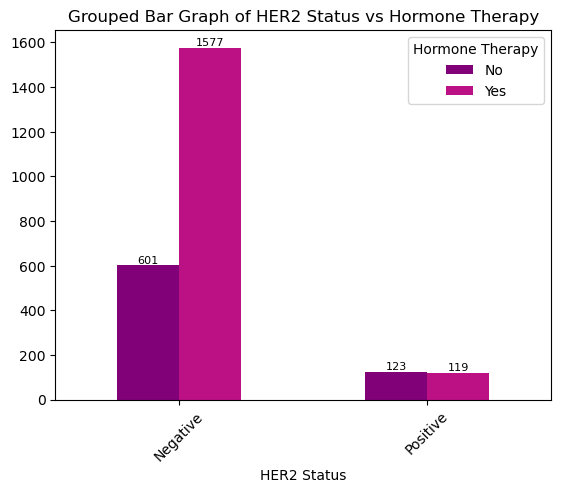

<Figure size 800x600 with 0 Axes>

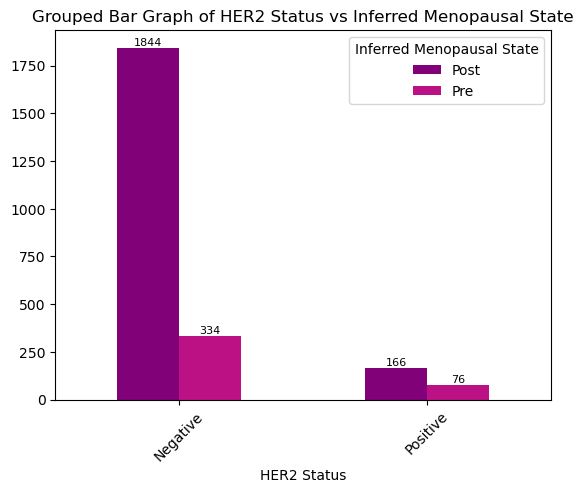

<Figure size 800x600 with 0 Axes>

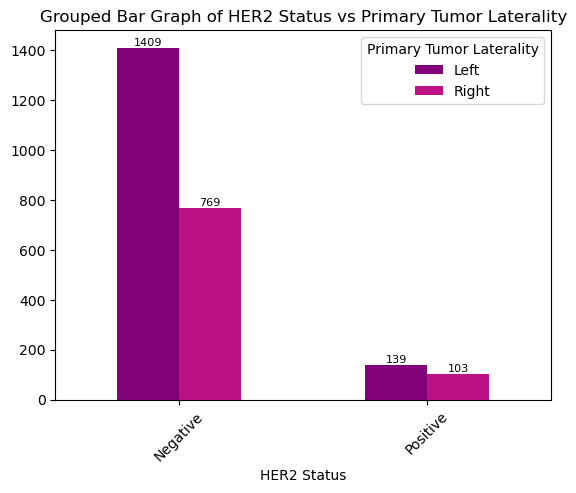

<Figure size 800x600 with 0 Axes>

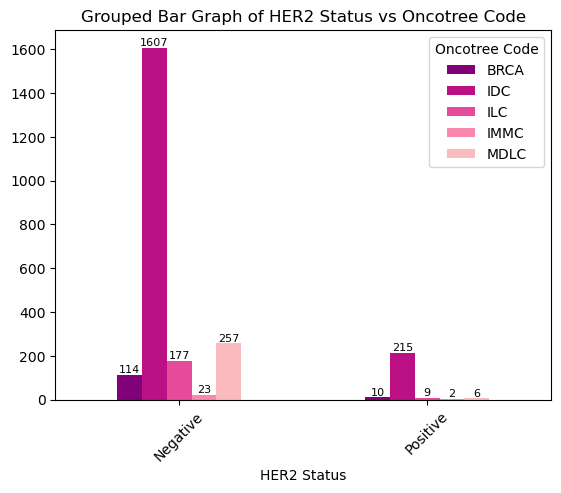

<Figure size 800x600 with 0 Axes>

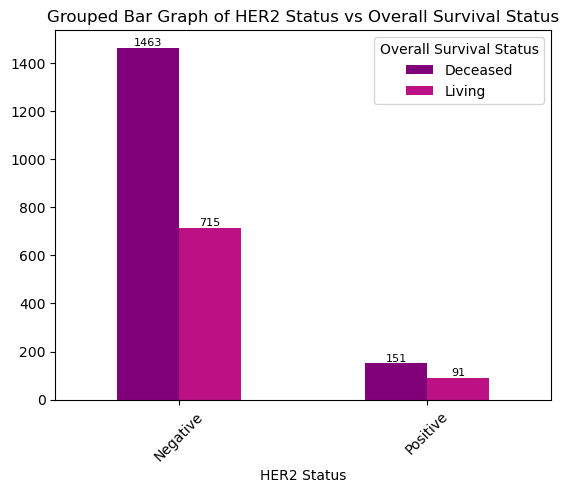

<Figure size 800x600 with 0 Axes>

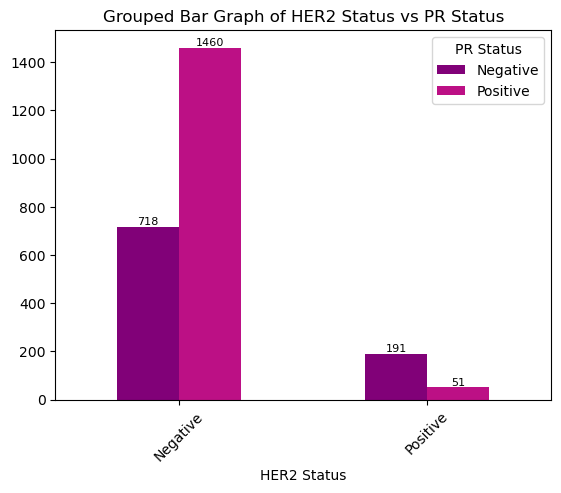

<Figure size 800x600 with 0 Axes>

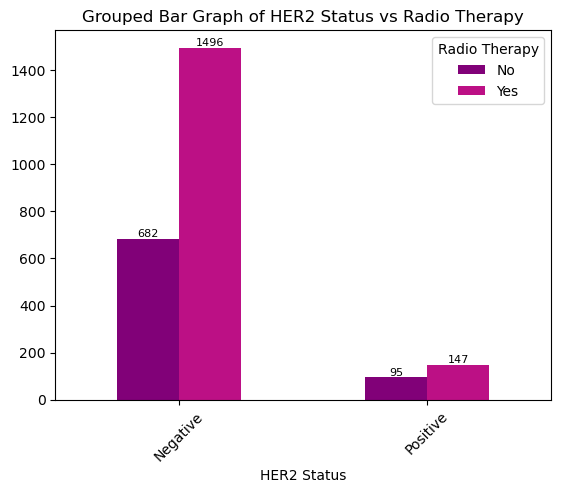

<Figure size 800x600 with 0 Axes>

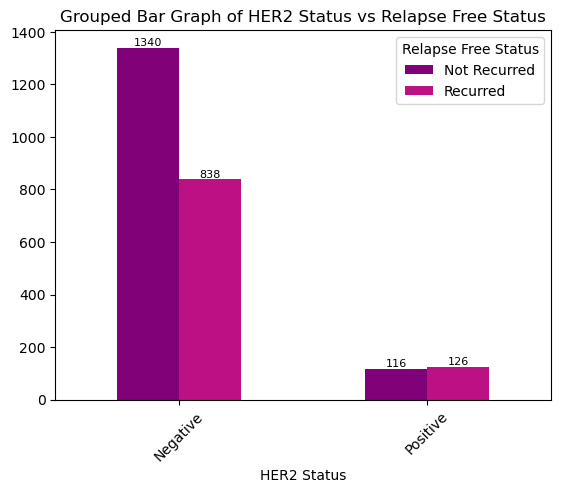

<Figure size 800x600 with 0 Axes>

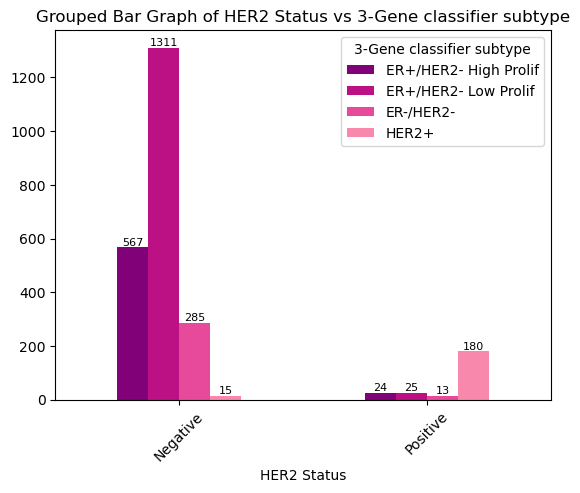

<Figure size 800x600 with 0 Axes>

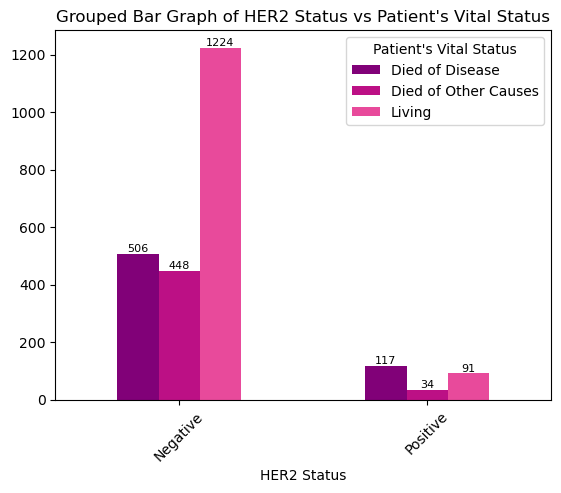

<Figure size 800x600 with 0 Axes>

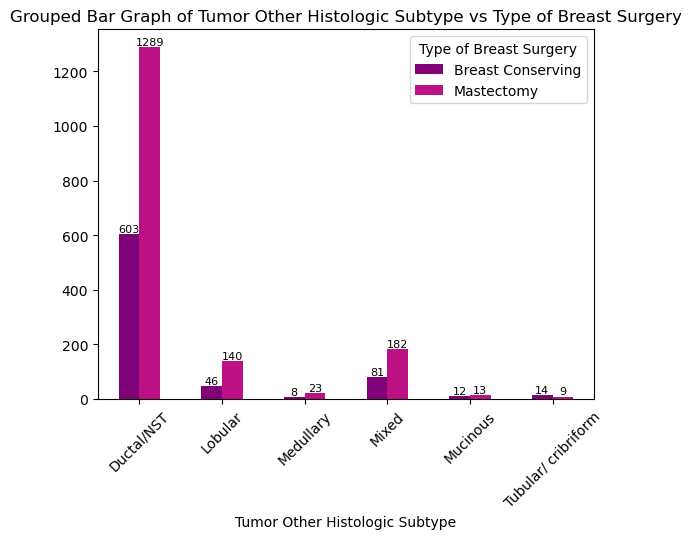

<Figure size 800x600 with 0 Axes>

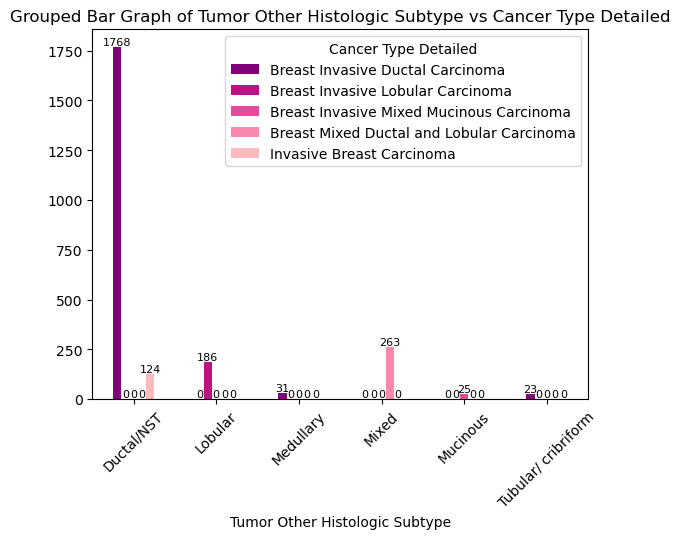

<Figure size 800x600 with 0 Axes>

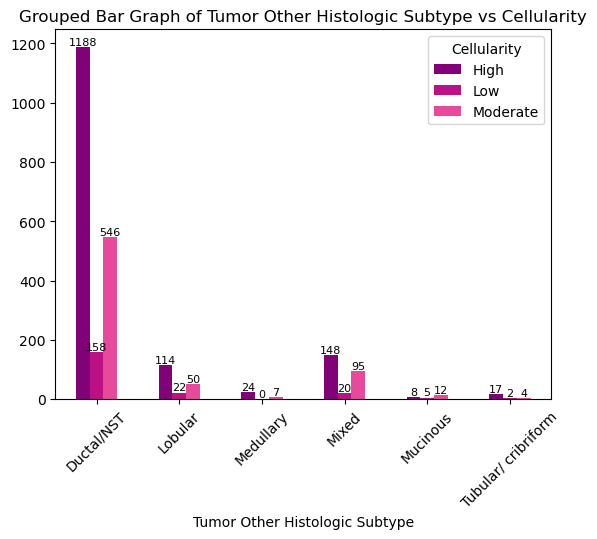

<Figure size 800x600 with 0 Axes>

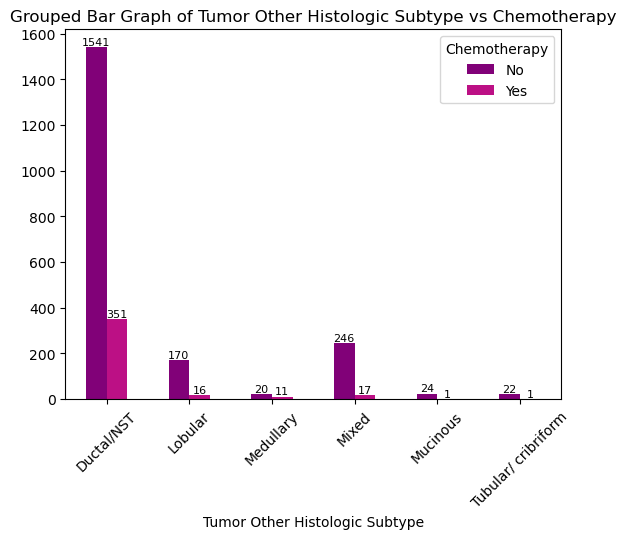

<Figure size 800x600 with 0 Axes>

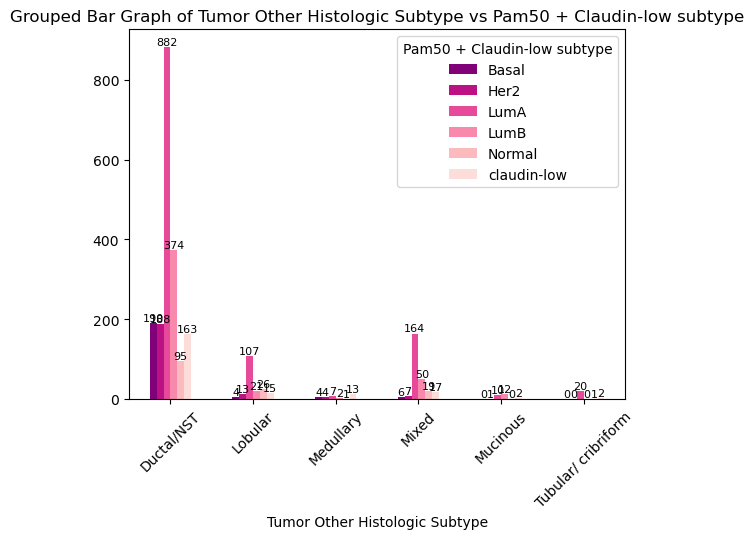

<Figure size 800x600 with 0 Axes>

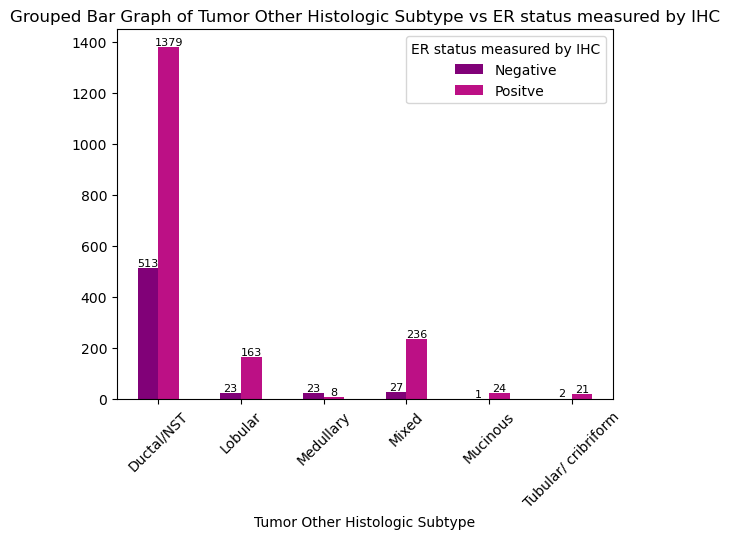

<Figure size 800x600 with 0 Axes>

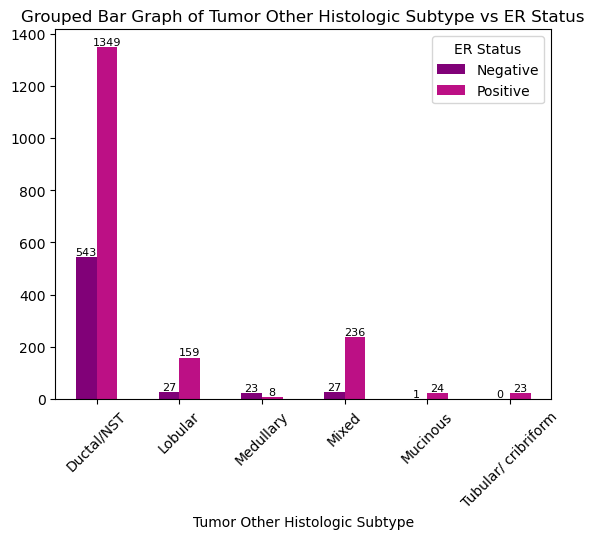

<Figure size 800x600 with 0 Axes>

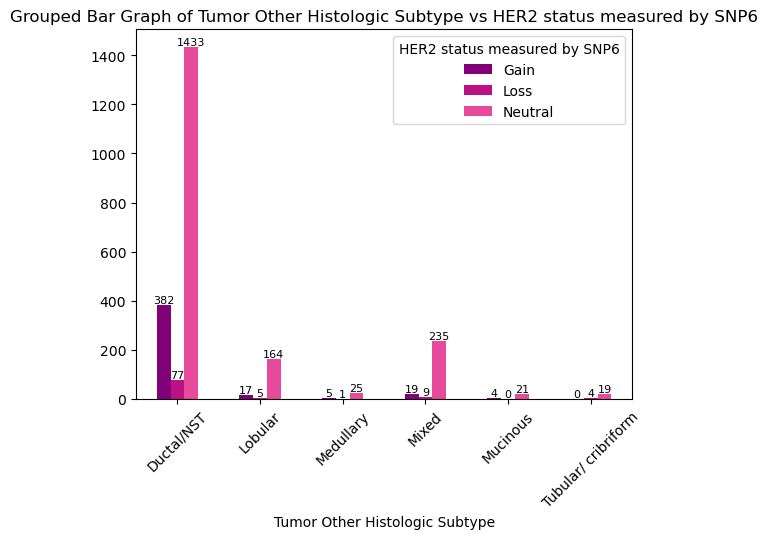

<Figure size 800x600 with 0 Axes>

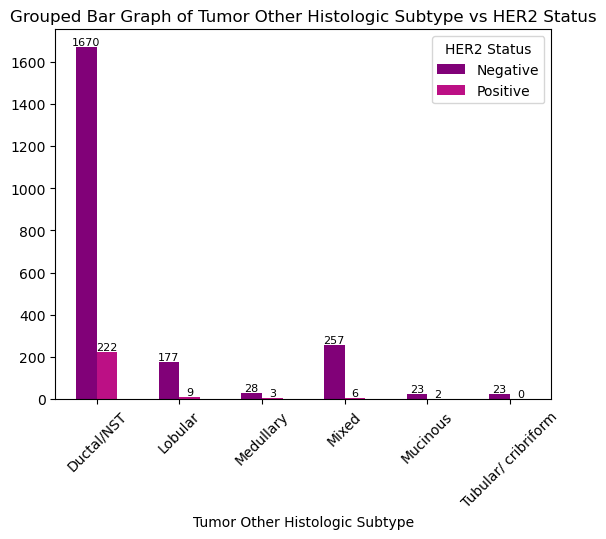

<Figure size 800x600 with 0 Axes>

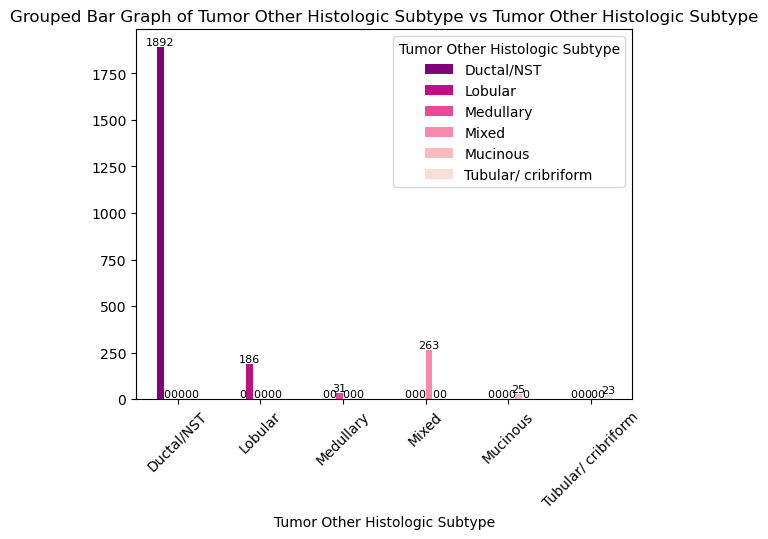

<Figure size 800x600 with 0 Axes>

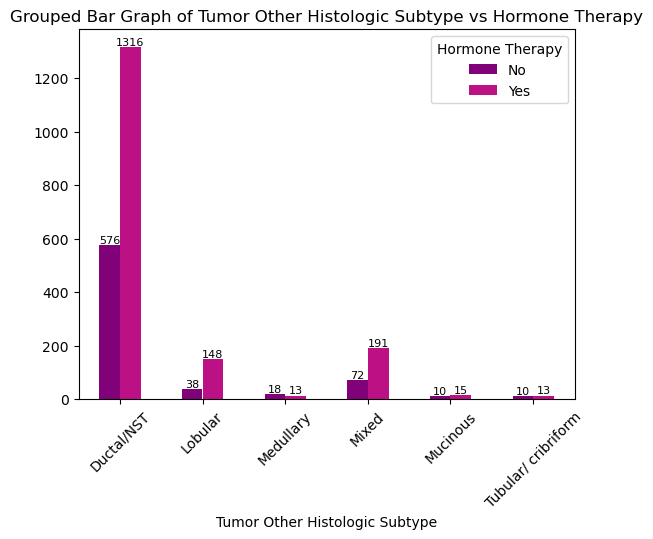

<Figure size 800x600 with 0 Axes>

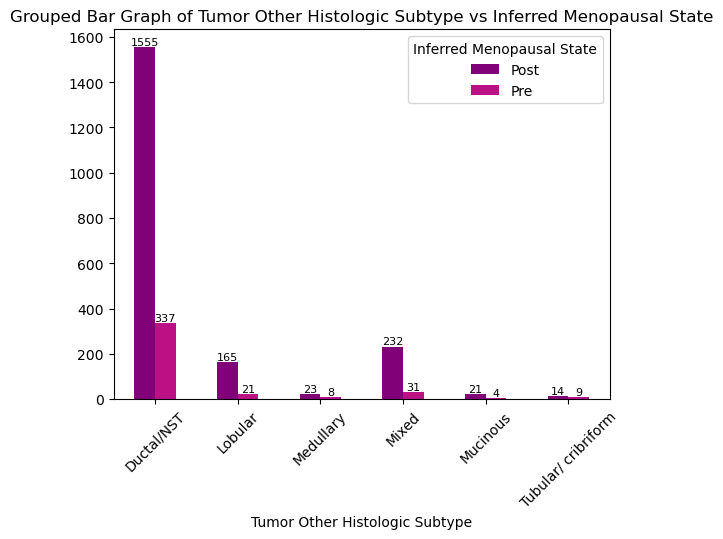

<Figure size 800x600 with 0 Axes>

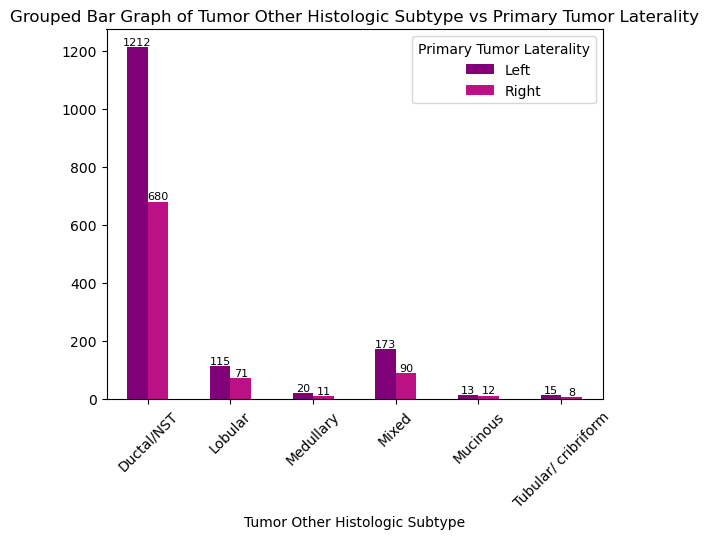

<Figure size 800x600 with 0 Axes>

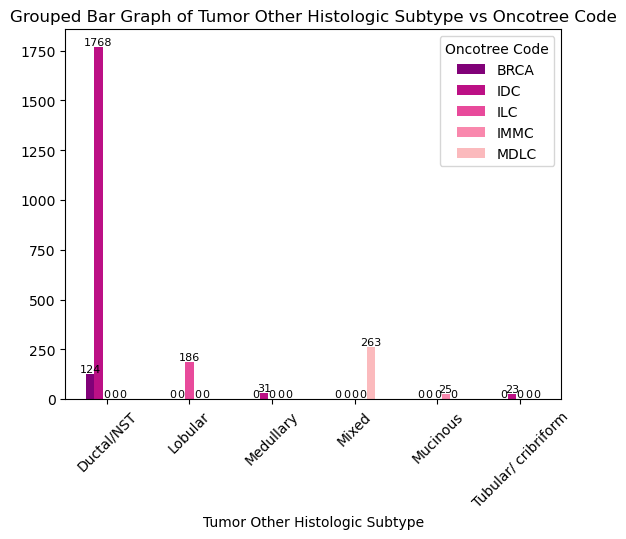

<Figure size 800x600 with 0 Axes>

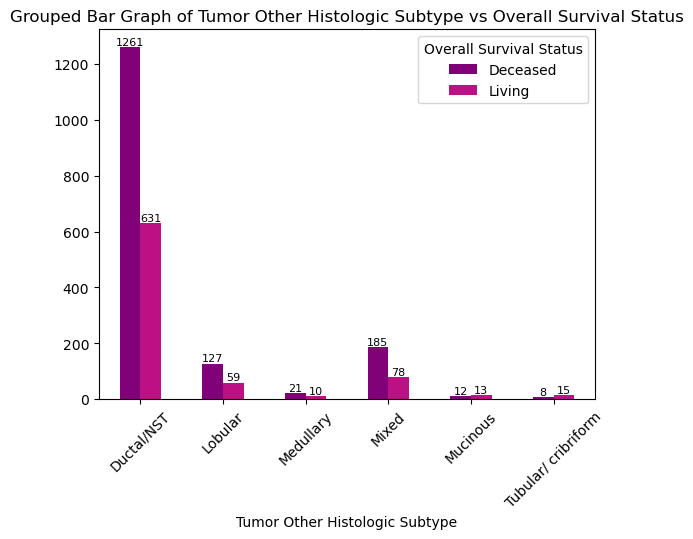

<Figure size 800x600 with 0 Axes>

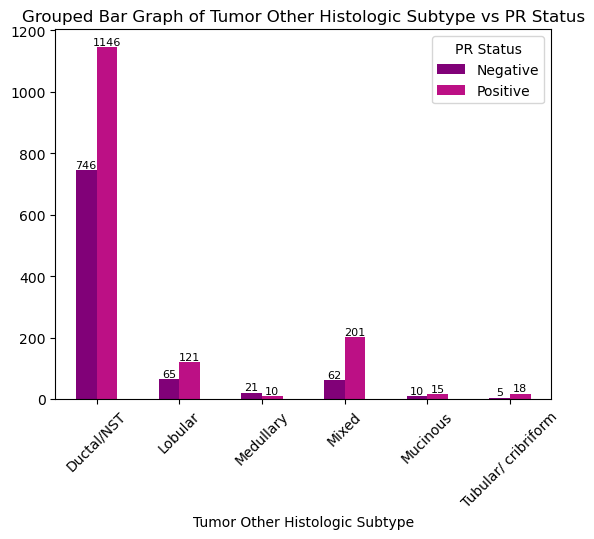

<Figure size 800x600 with 0 Axes>

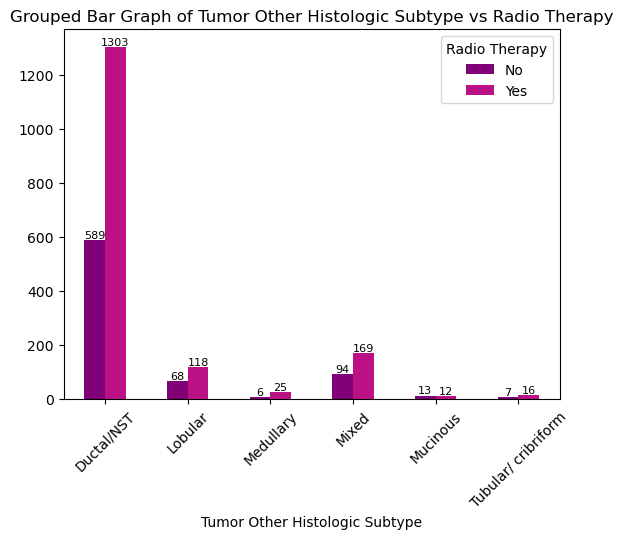

<Figure size 800x600 with 0 Axes>

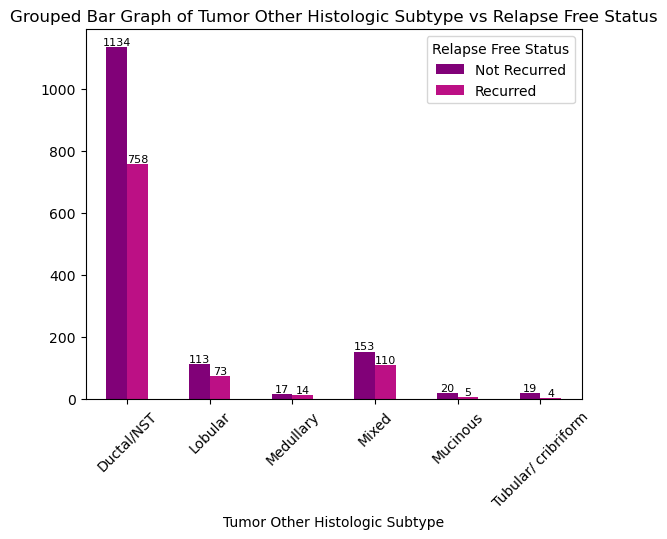

<Figure size 800x600 with 0 Axes>

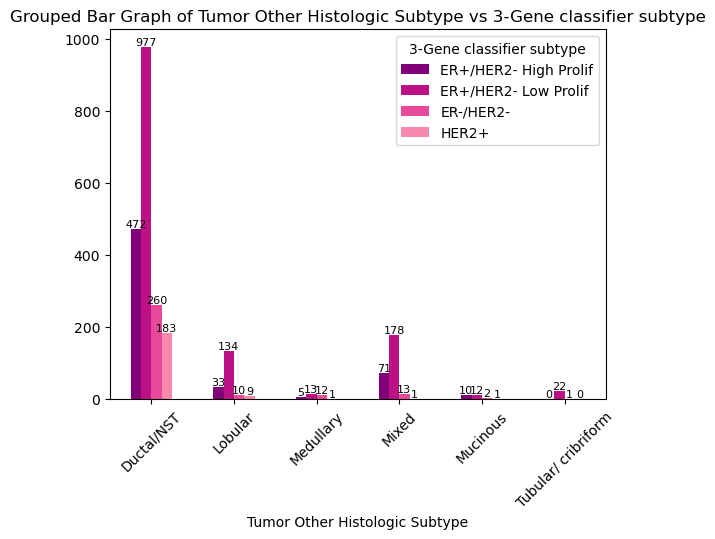

<Figure size 800x600 with 0 Axes>

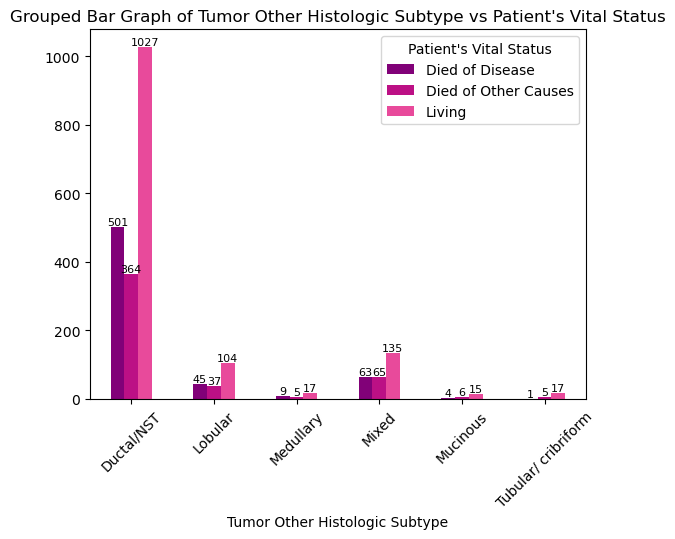

<Figure size 800x600 with 0 Axes>

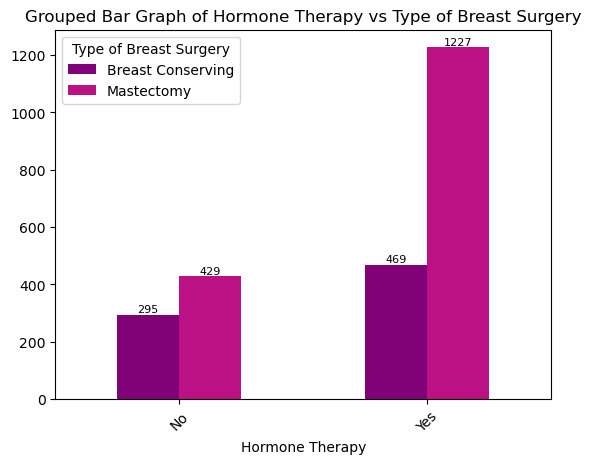

<Figure size 800x600 with 0 Axes>

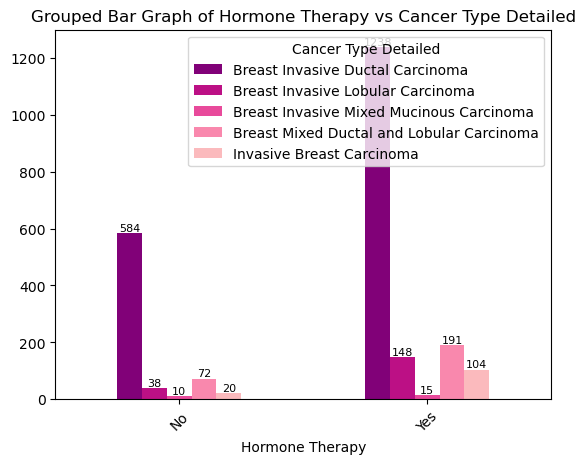

<Figure size 800x600 with 0 Axes>

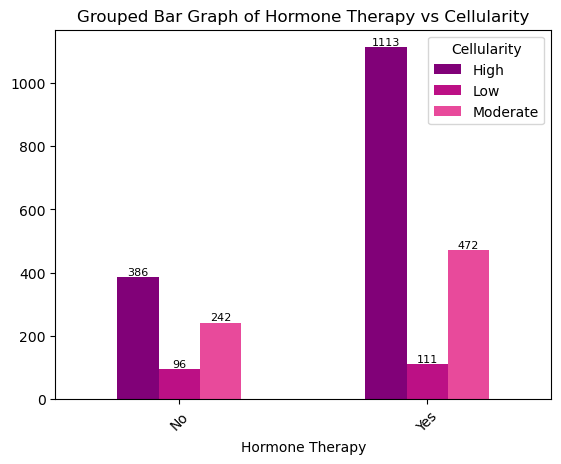

<Figure size 800x600 with 0 Axes>

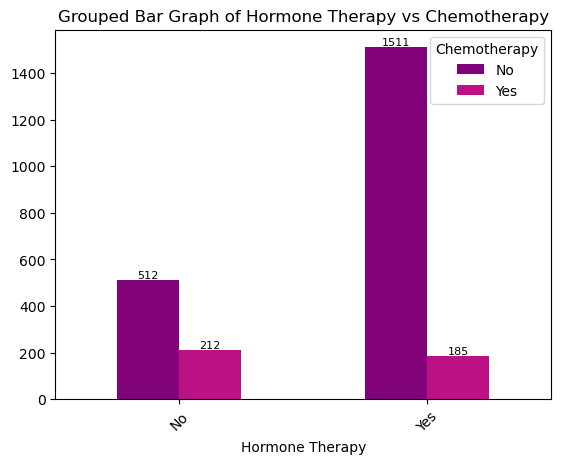

<Figure size 800x600 with 0 Axes>

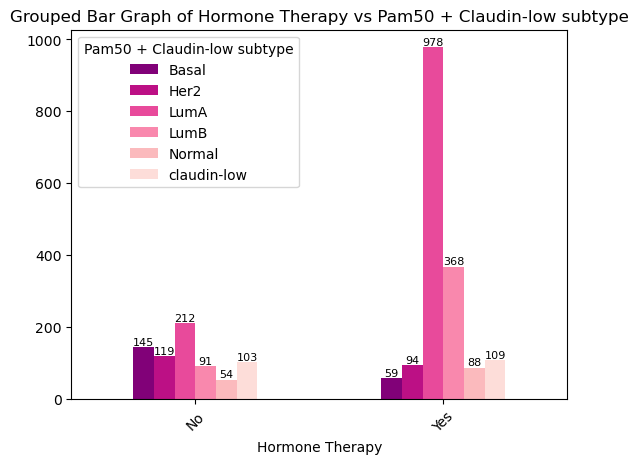

<Figure size 800x600 with 0 Axes>

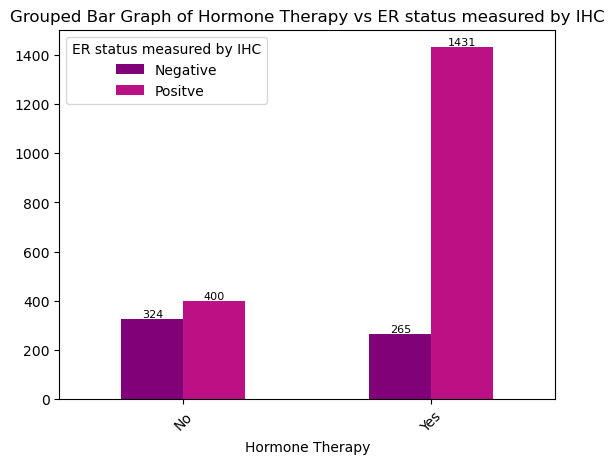

<Figure size 800x600 with 0 Axes>

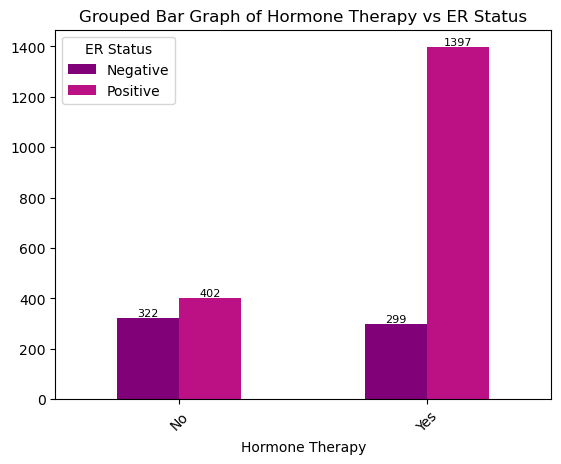

<Figure size 800x600 with 0 Axes>

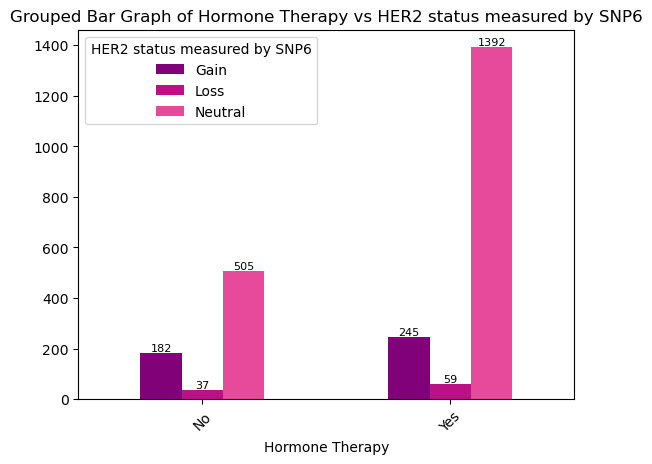

<Figure size 800x600 with 0 Axes>

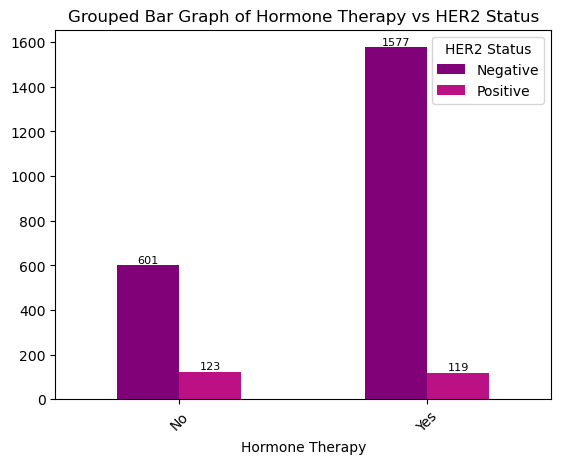

<Figure size 800x600 with 0 Axes>

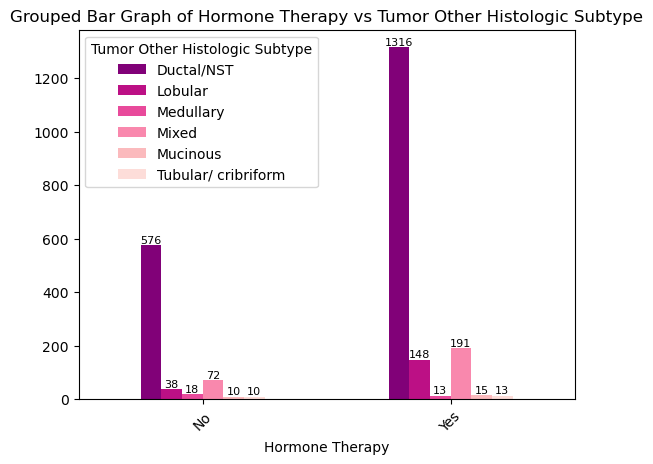

<Figure size 800x600 with 0 Axes>

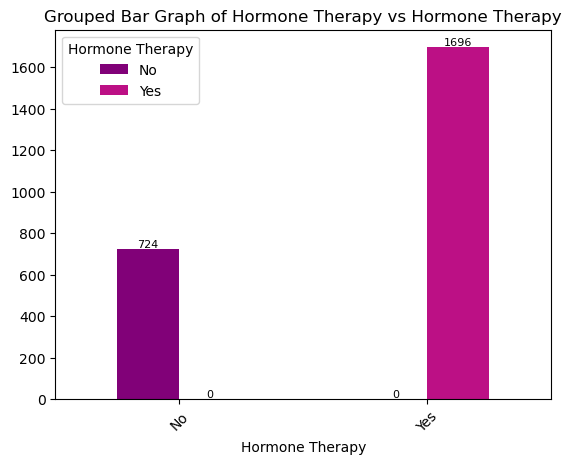

<Figure size 800x600 with 0 Axes>

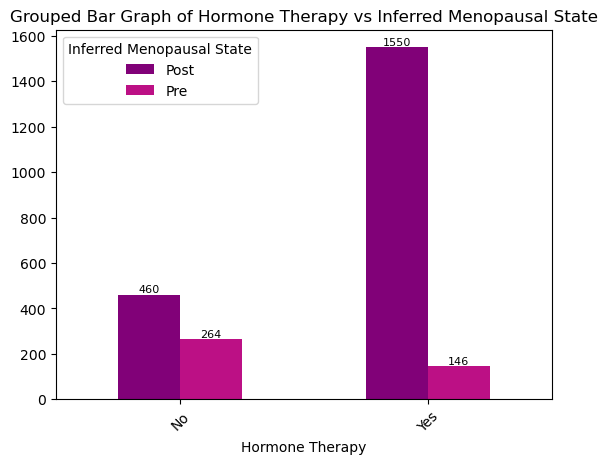

<Figure size 800x600 with 0 Axes>

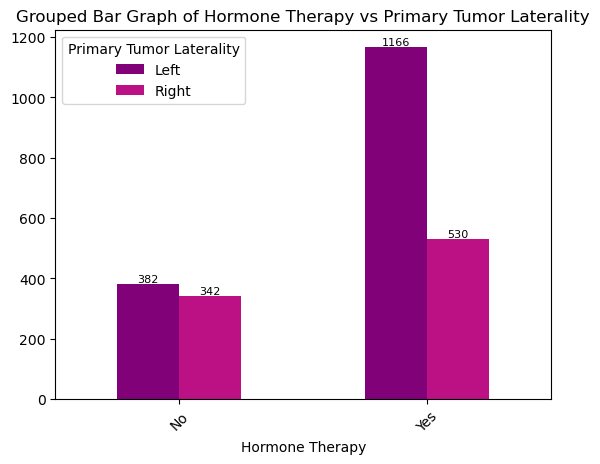

<Figure size 800x600 with 0 Axes>

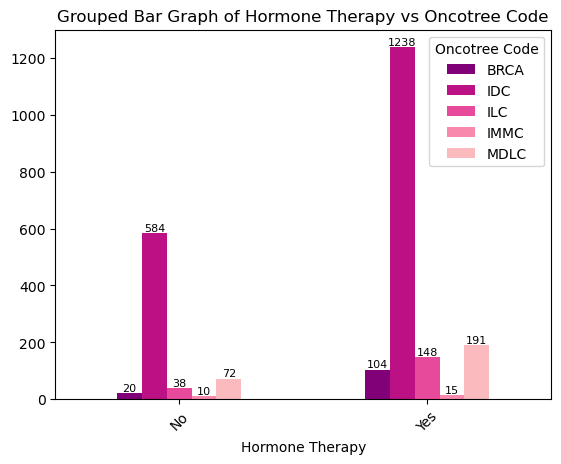

<Figure size 800x600 with 0 Axes>

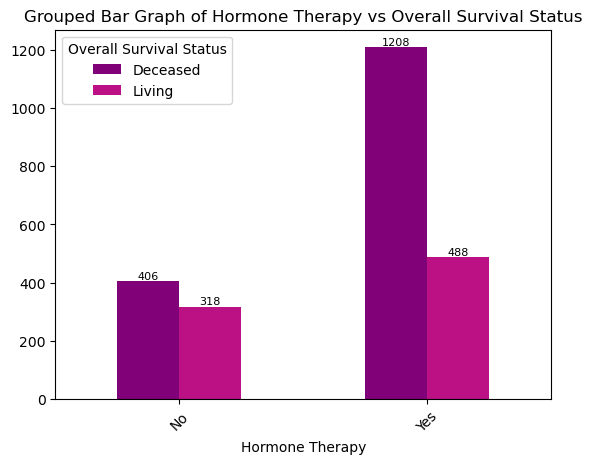

<Figure size 800x600 with 0 Axes>

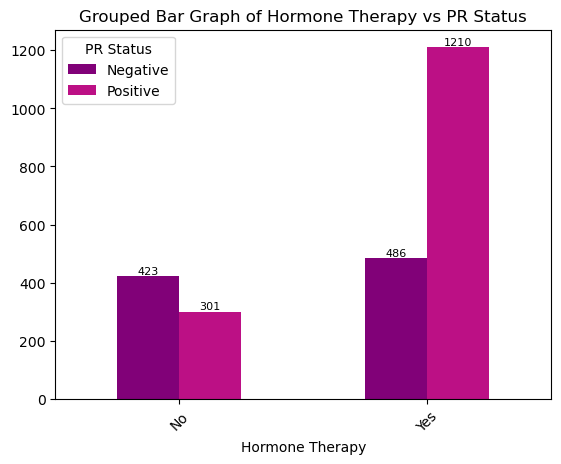

<Figure size 800x600 with 0 Axes>

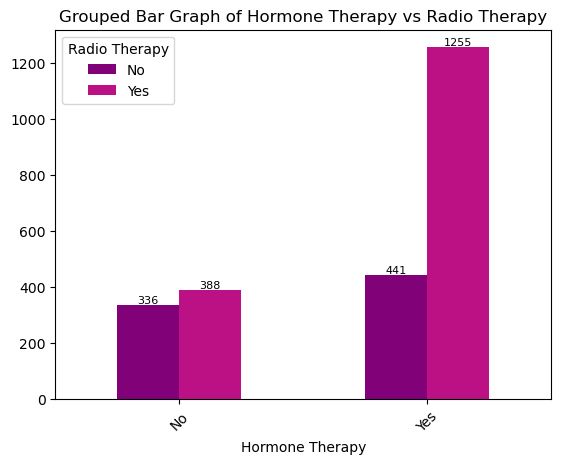

<Figure size 800x600 with 0 Axes>

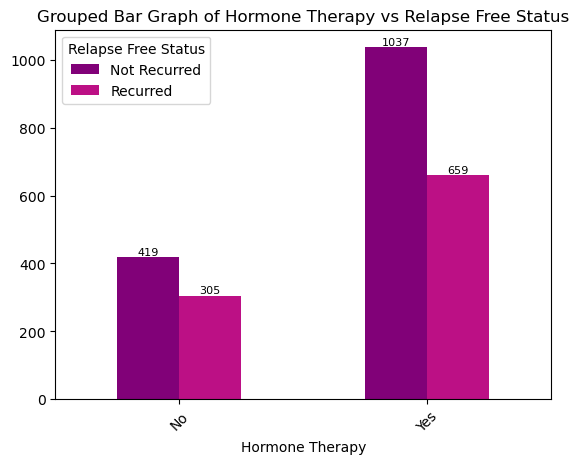

<Figure size 800x600 with 0 Axes>

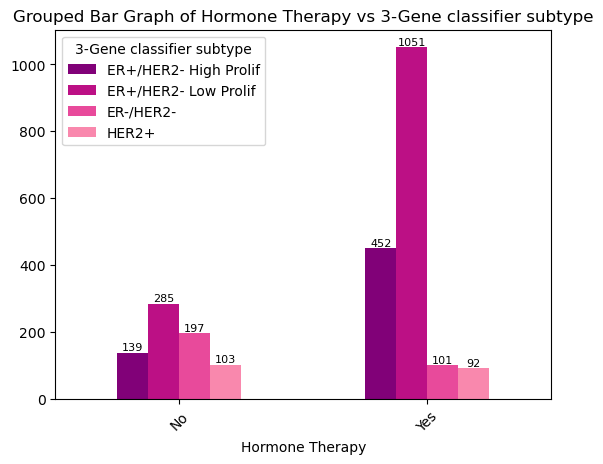

<Figure size 800x600 with 0 Axes>

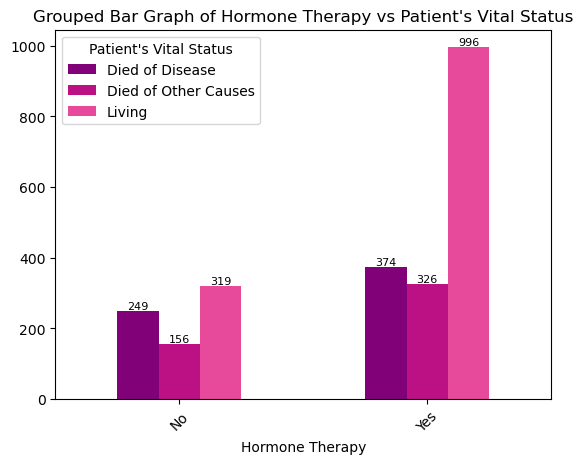

<Figure size 800x600 with 0 Axes>

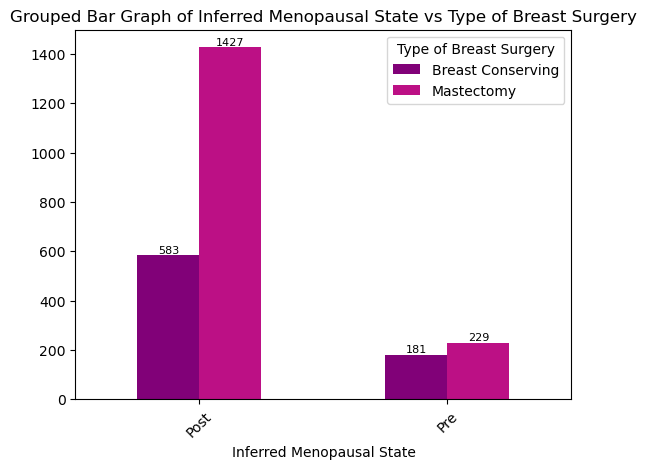

<Figure size 800x600 with 0 Axes>

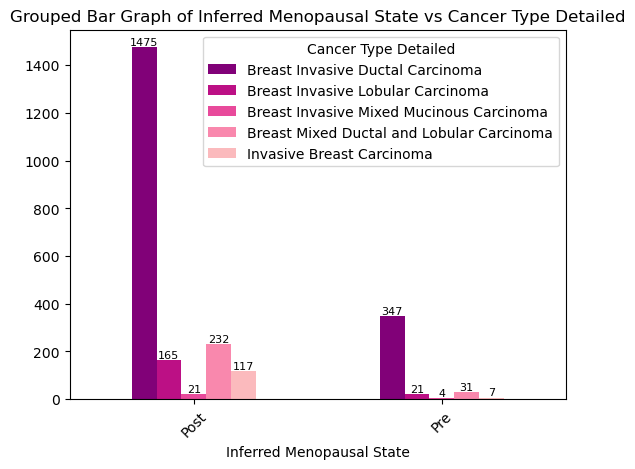

<Figure size 800x600 with 0 Axes>

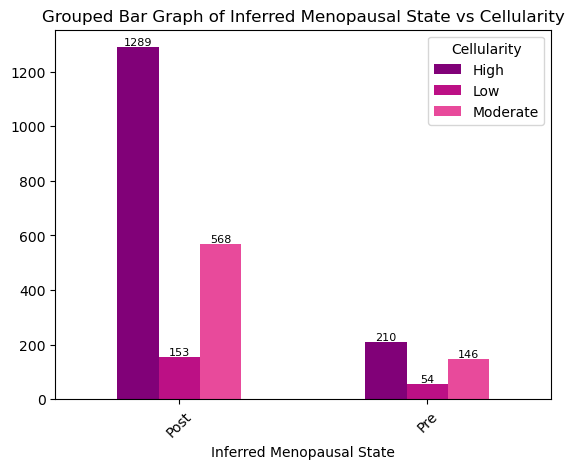

<Figure size 800x600 with 0 Axes>

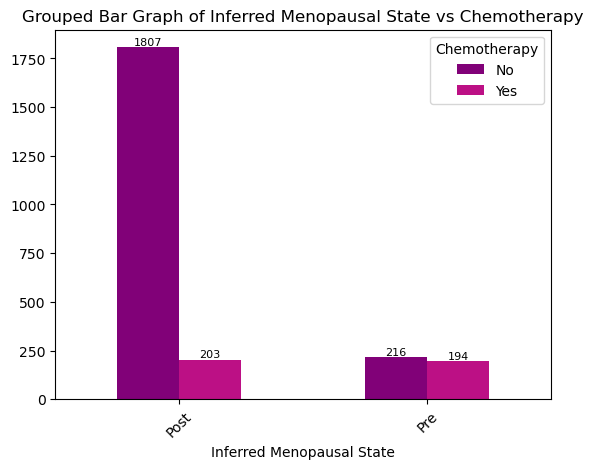

<Figure size 800x600 with 0 Axes>

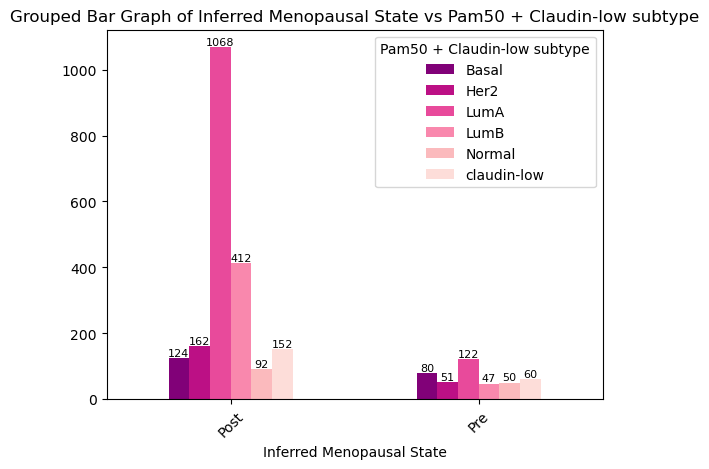

<Figure size 800x600 with 0 Axes>

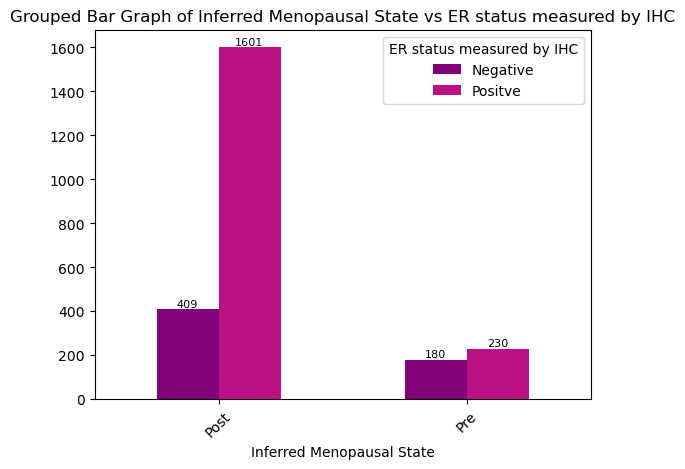

<Figure size 800x600 with 0 Axes>

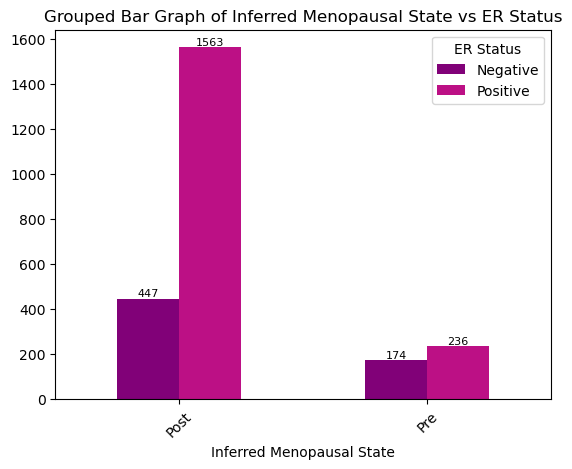

<Figure size 800x600 with 0 Axes>

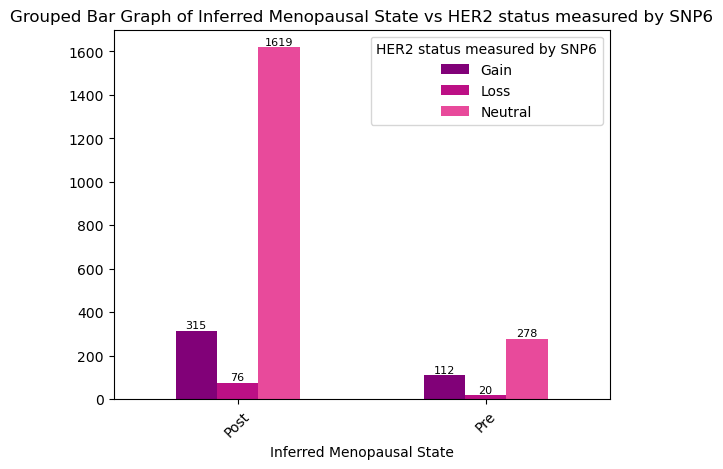

<Figure size 800x600 with 0 Axes>

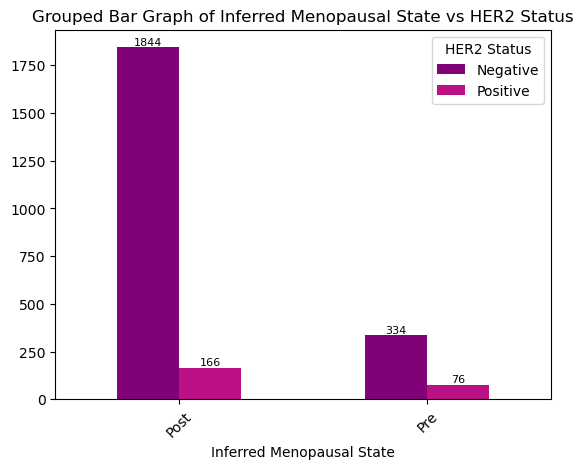

<Figure size 800x600 with 0 Axes>

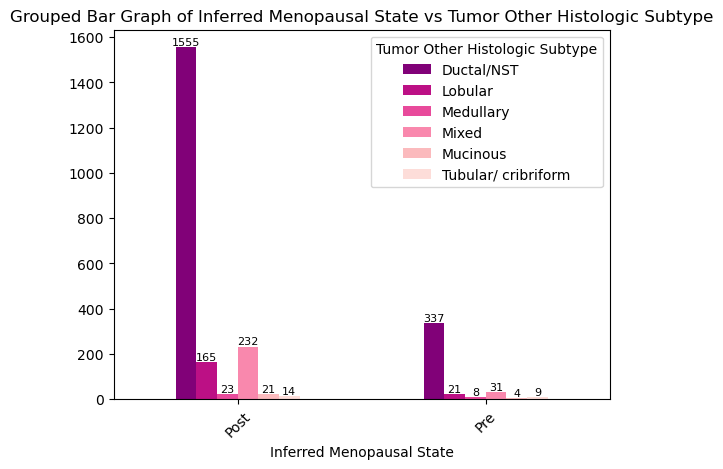

<Figure size 800x600 with 0 Axes>

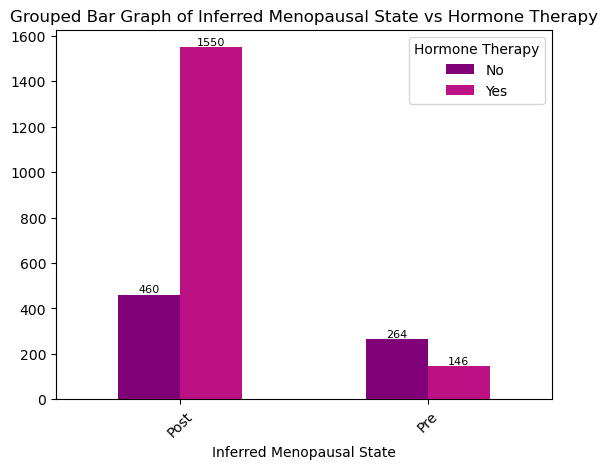

<Figure size 800x600 with 0 Axes>

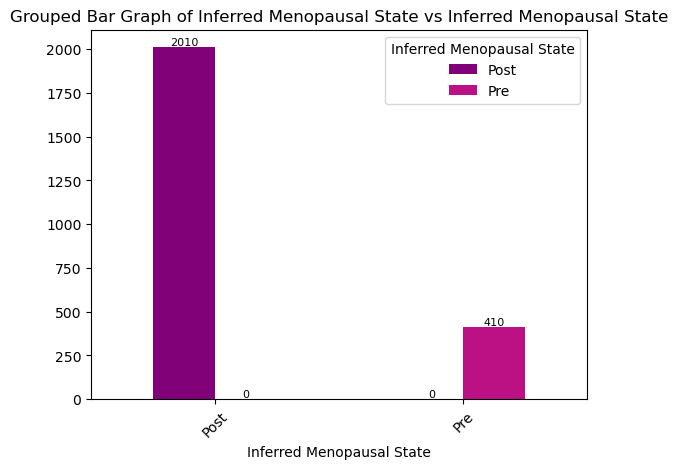

<Figure size 800x600 with 0 Axes>

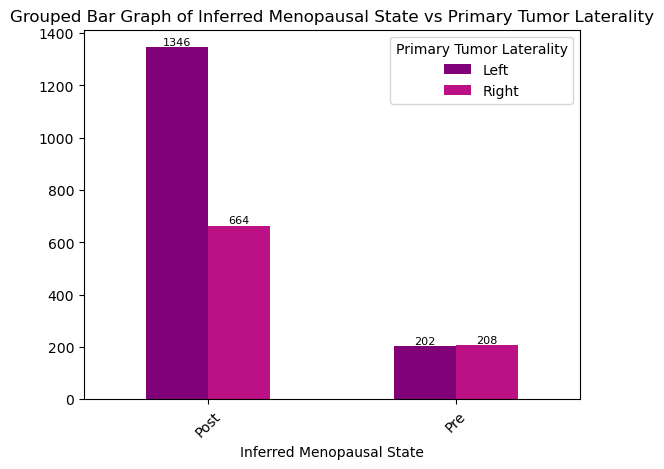

<Figure size 800x600 with 0 Axes>

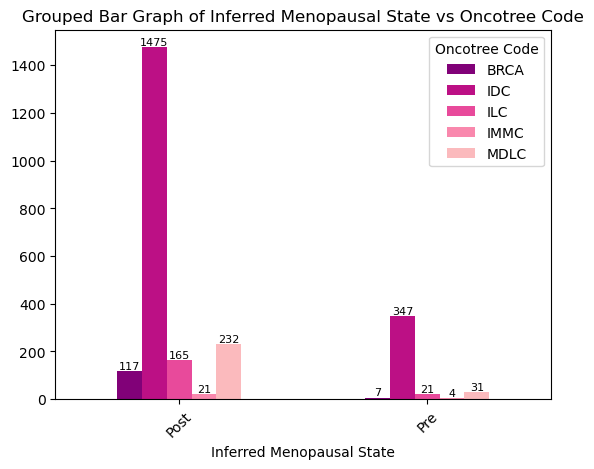

<Figure size 800x600 with 0 Axes>

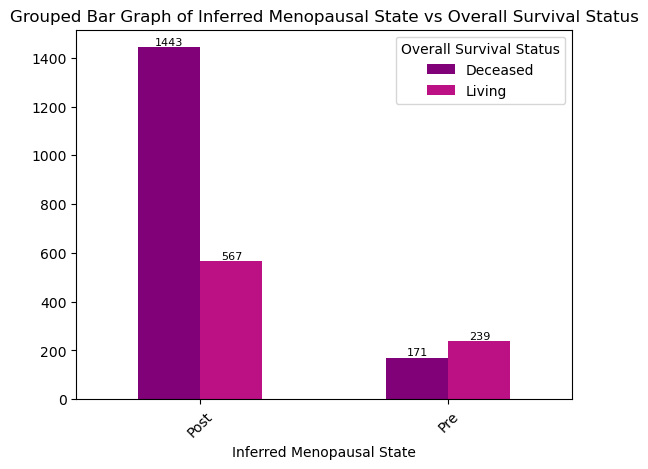

<Figure size 800x600 with 0 Axes>

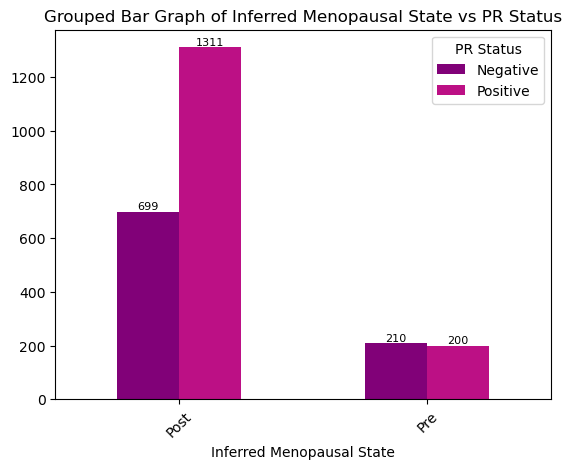

<Figure size 800x600 with 0 Axes>

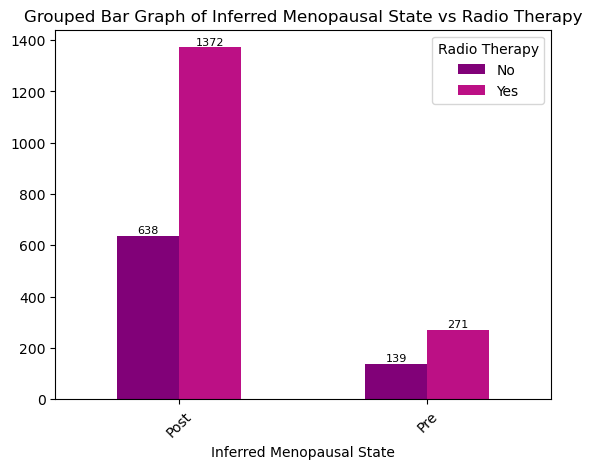

<Figure size 800x600 with 0 Axes>

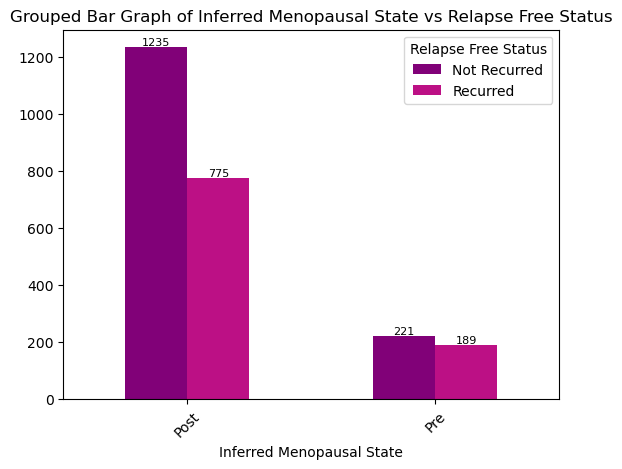

<Figure size 800x600 with 0 Axes>

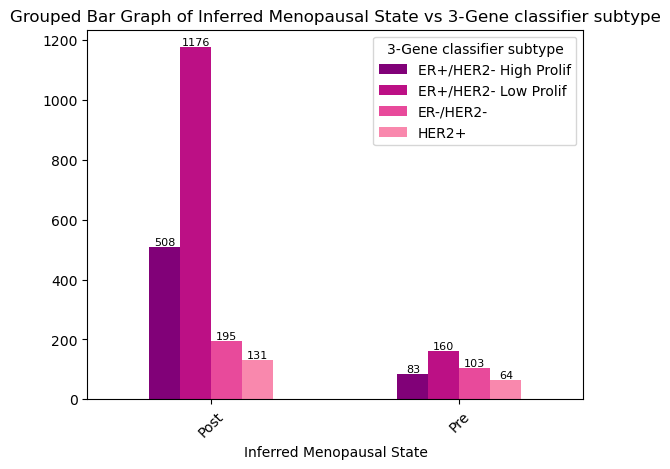

<Figure size 800x600 with 0 Axes>

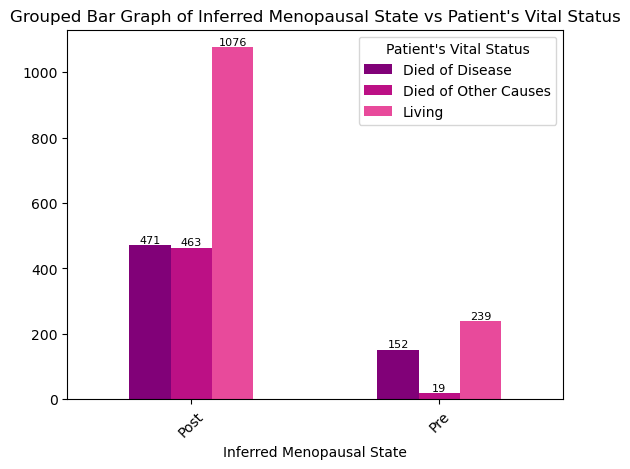

<Figure size 800x600 with 0 Axes>

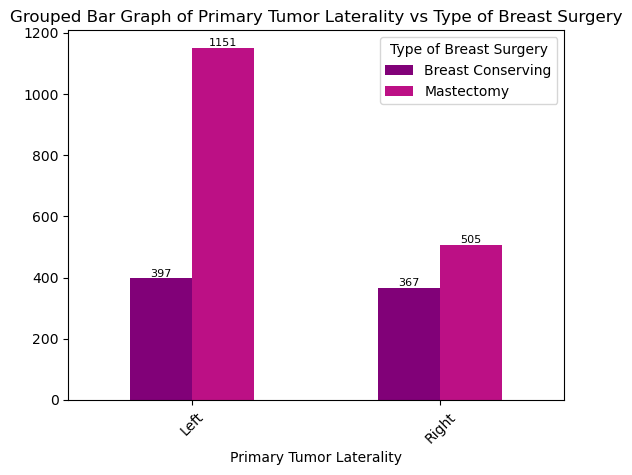

<Figure size 800x600 with 0 Axes>

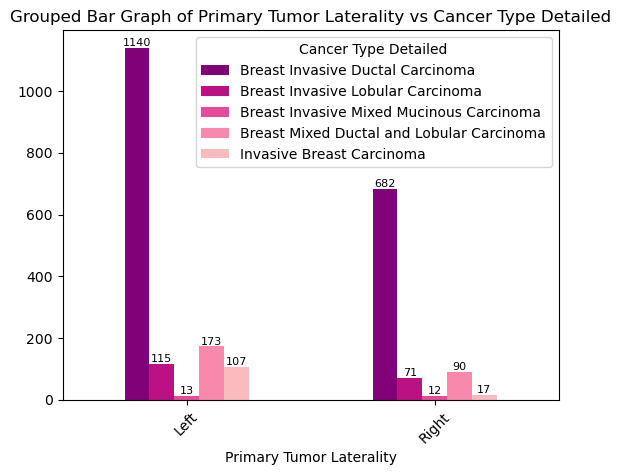

<Figure size 800x600 with 0 Axes>

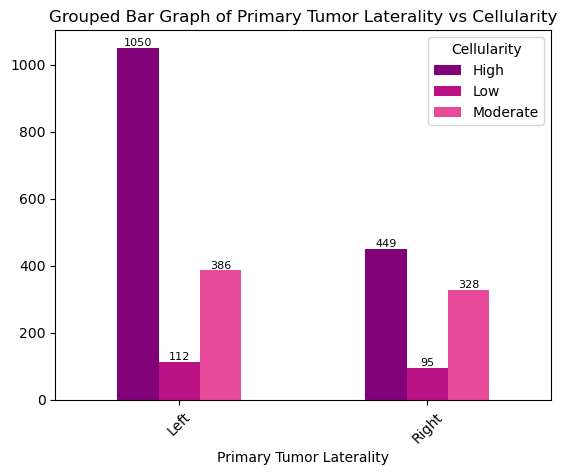

<Figure size 800x600 with 0 Axes>

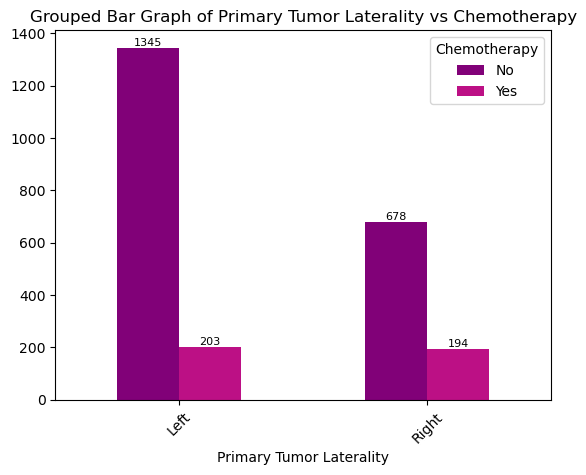

<Figure size 800x600 with 0 Axes>

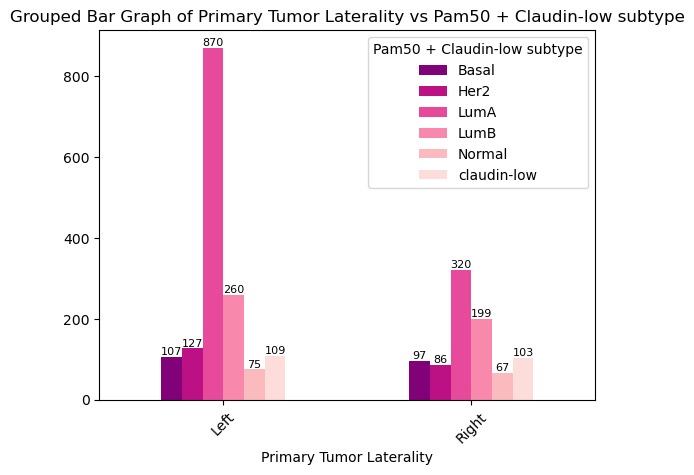

<Figure size 800x600 with 0 Axes>

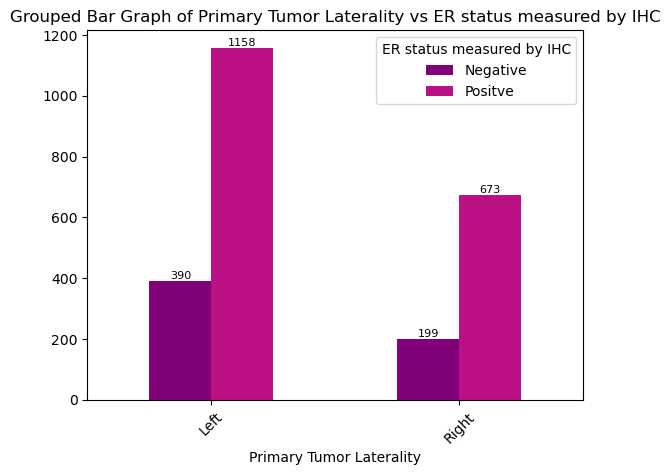

<Figure size 800x600 with 0 Axes>

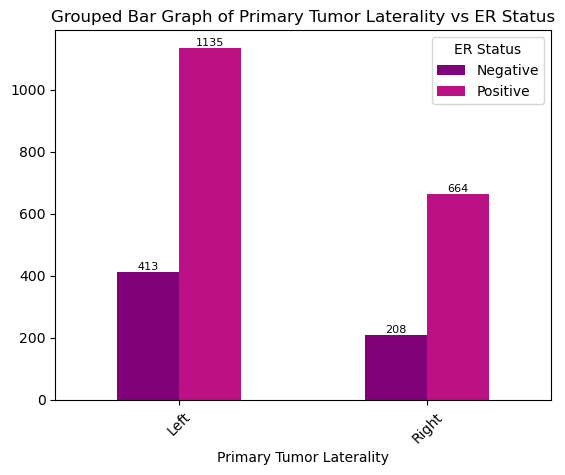

<Figure size 800x600 with 0 Axes>

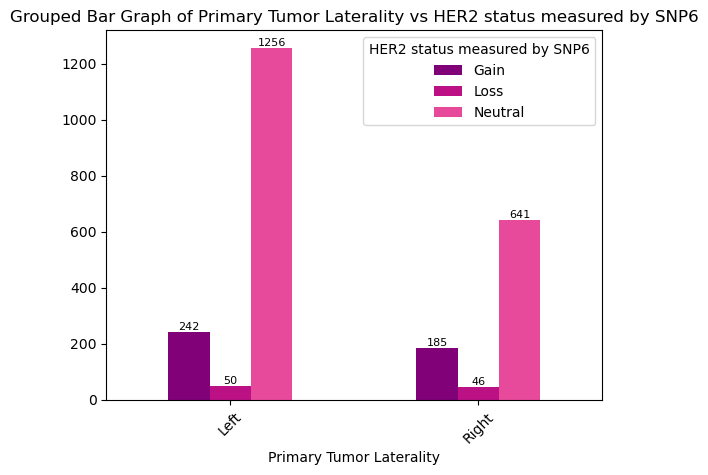

<Figure size 800x600 with 0 Axes>

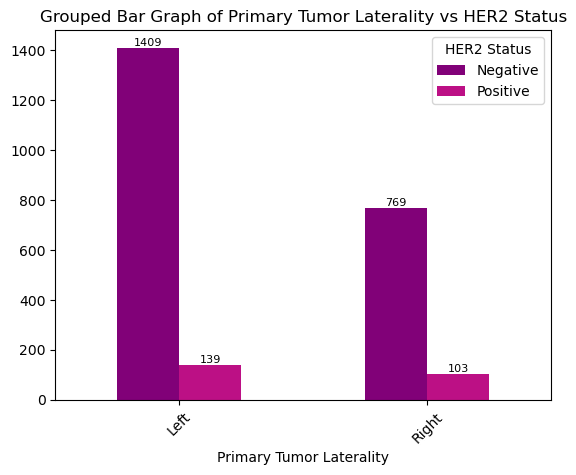

<Figure size 800x600 with 0 Axes>

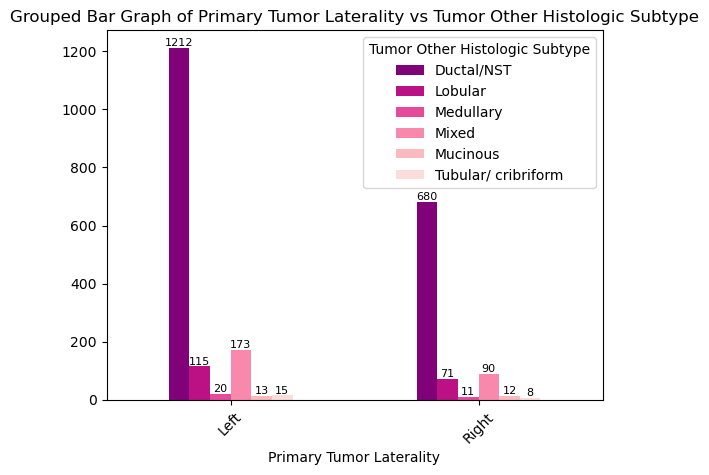

<Figure size 800x600 with 0 Axes>

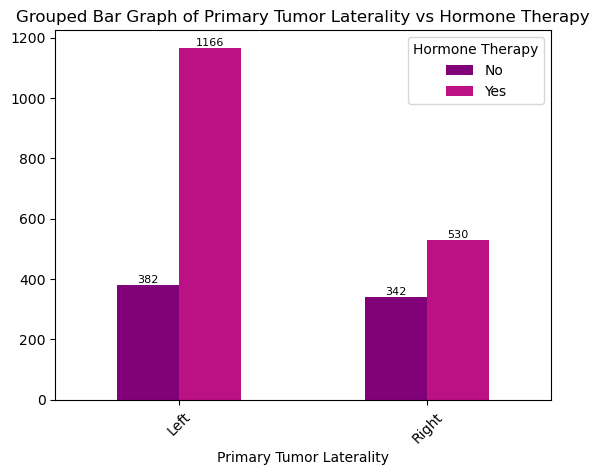

<Figure size 800x600 with 0 Axes>

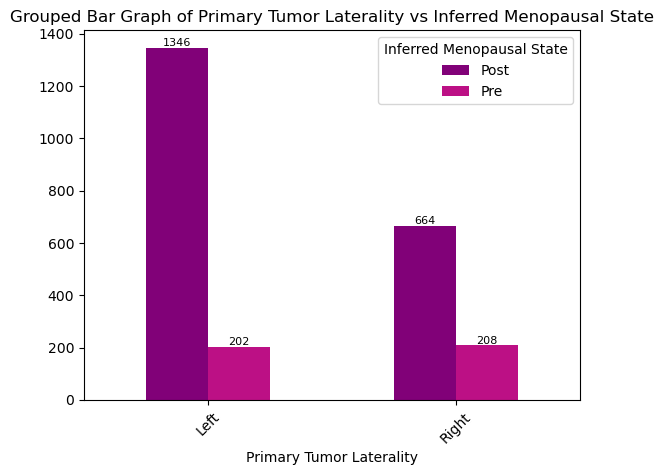

<Figure size 800x600 with 0 Axes>

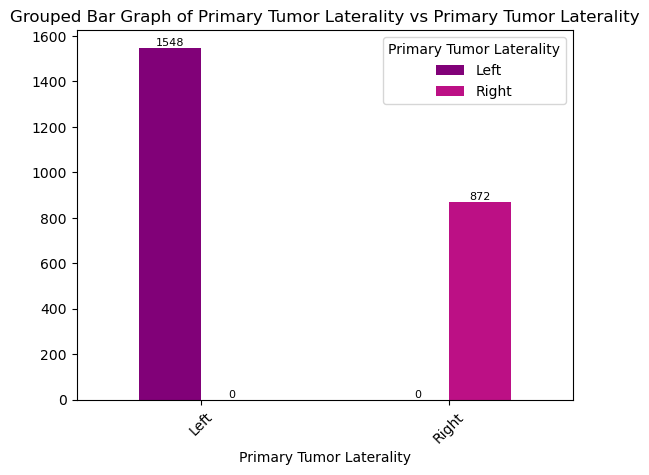

<Figure size 800x600 with 0 Axes>

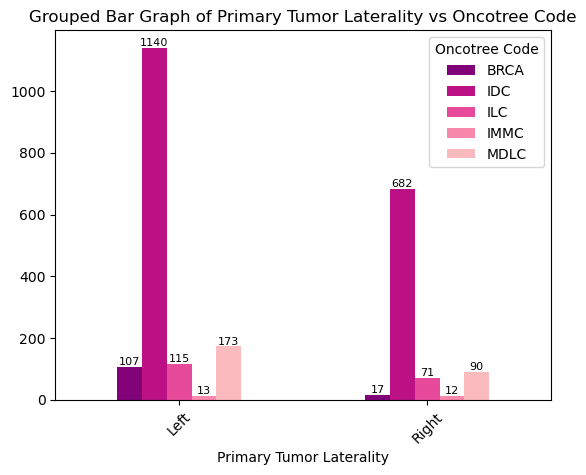

<Figure size 800x600 with 0 Axes>

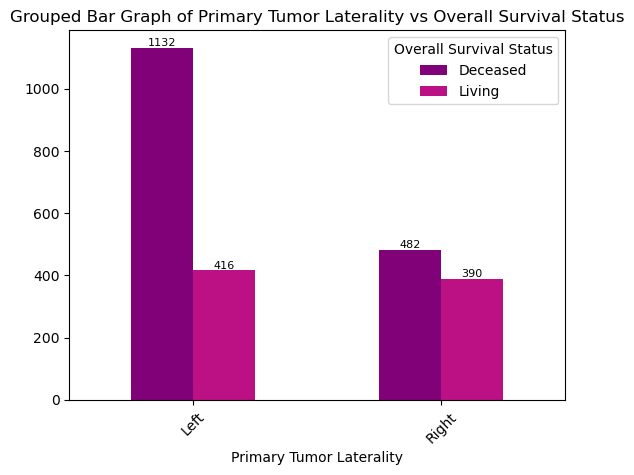

<Figure size 800x600 with 0 Axes>

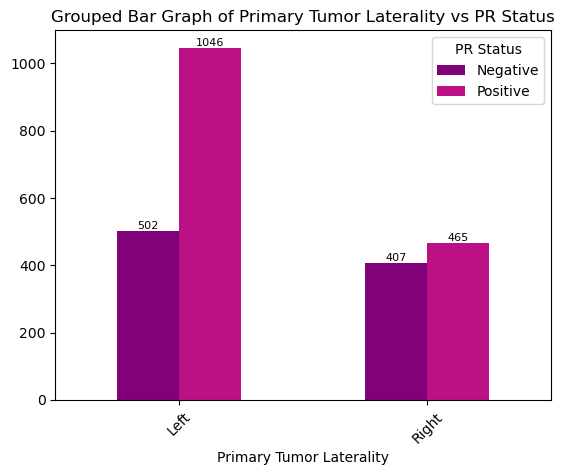

<Figure size 800x600 with 0 Axes>

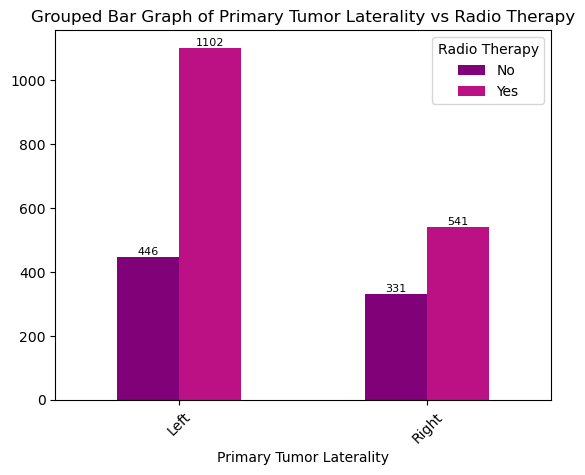

<Figure size 800x600 with 0 Axes>

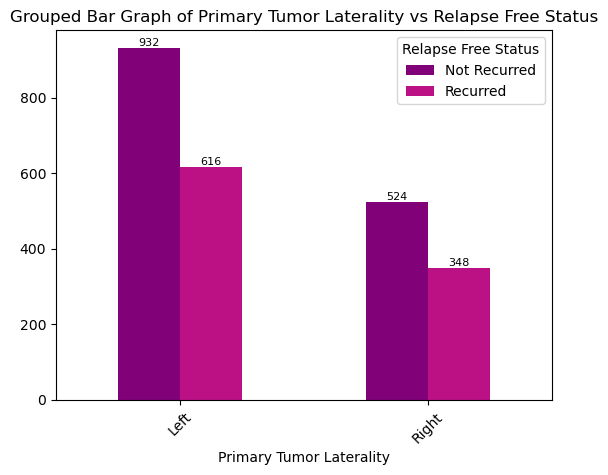

<Figure size 800x600 with 0 Axes>

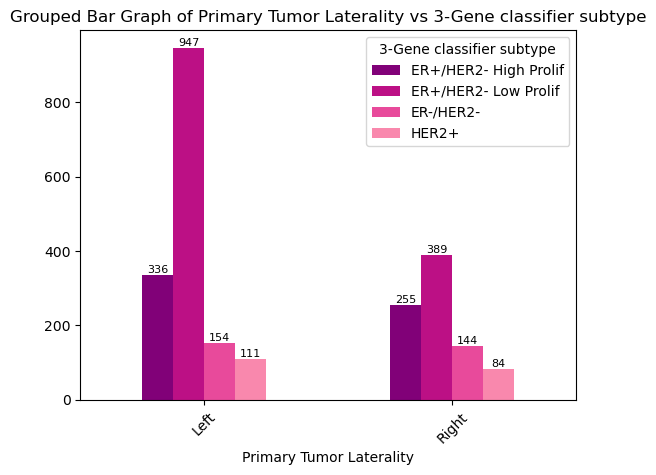

<Figure size 800x600 with 0 Axes>

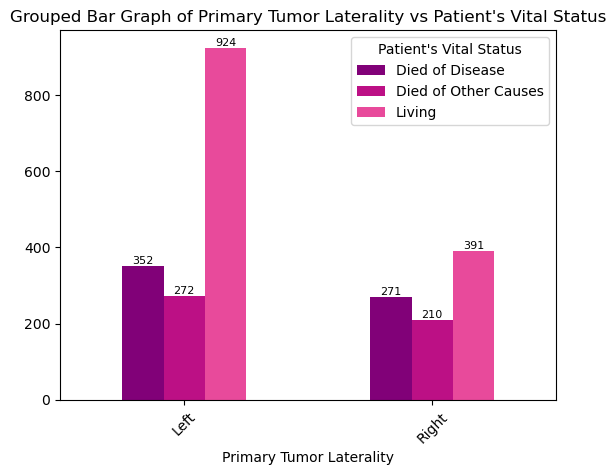

<Figure size 800x600 with 0 Axes>

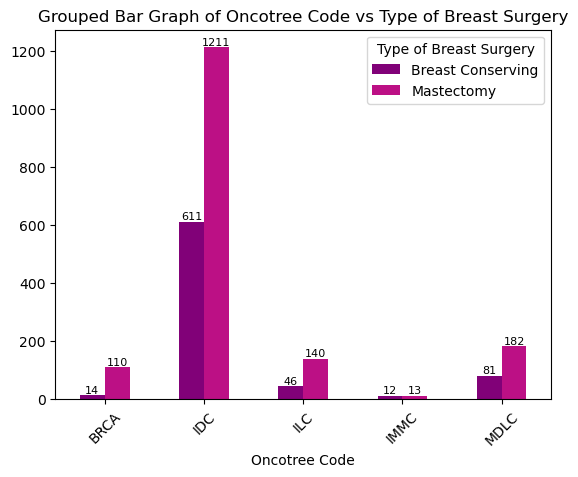

<Figure size 800x600 with 0 Axes>

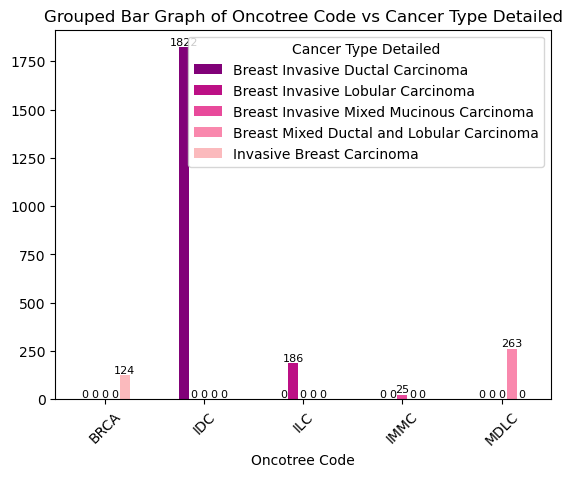

<Figure size 800x600 with 0 Axes>

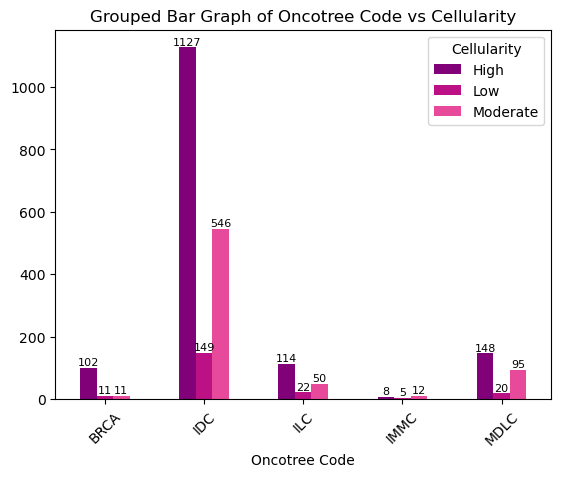

<Figure size 800x600 with 0 Axes>

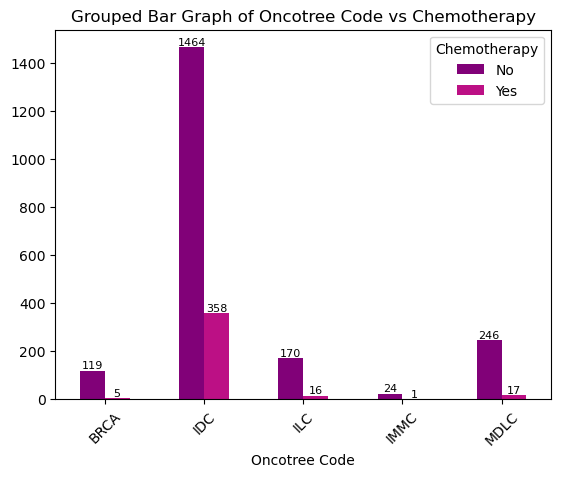

<Figure size 800x600 with 0 Axes>

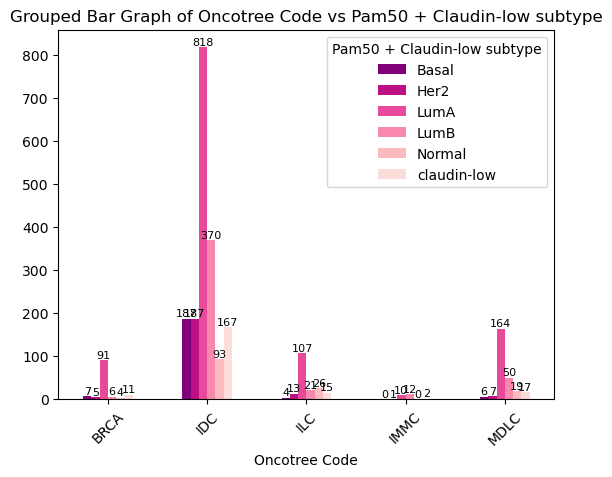

<Figure size 800x600 with 0 Axes>

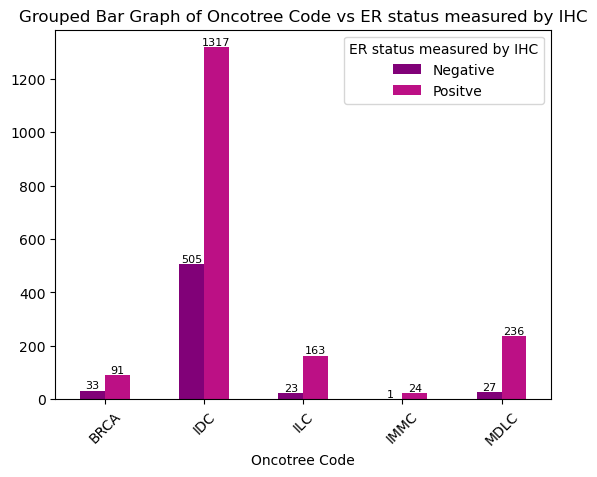

<Figure size 800x600 with 0 Axes>

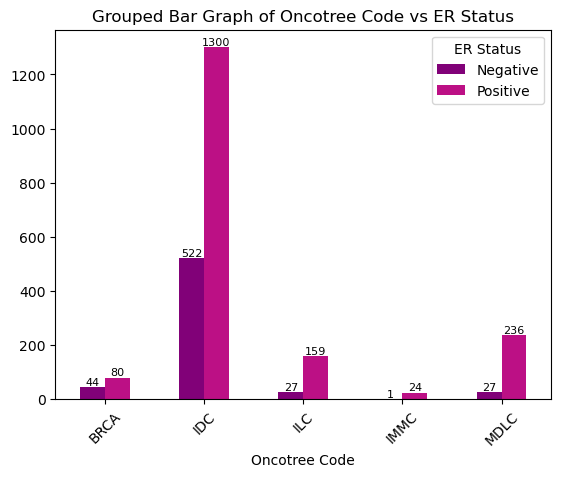

<Figure size 800x600 with 0 Axes>

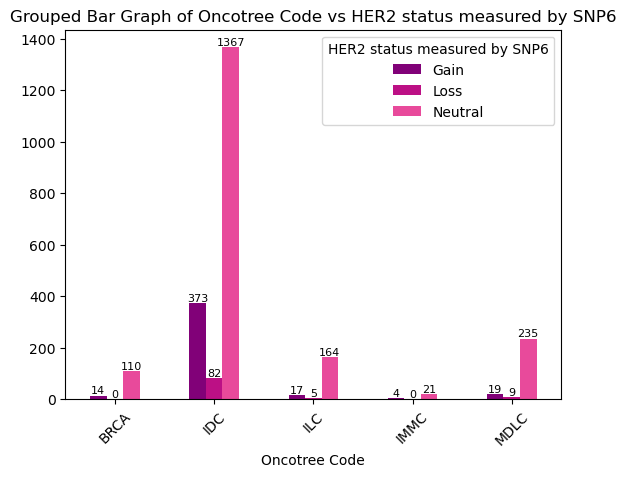

<Figure size 800x600 with 0 Axes>

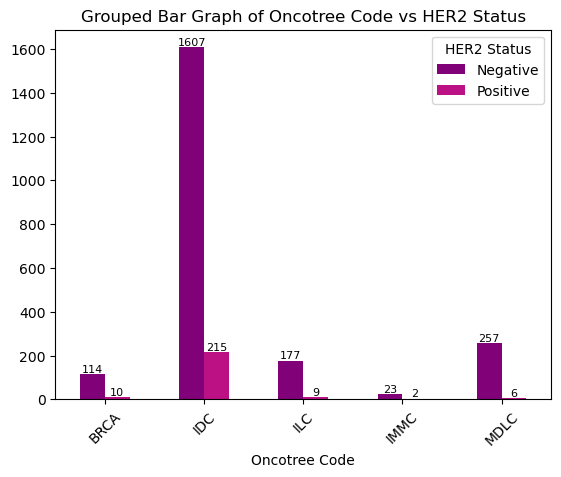

<Figure size 800x600 with 0 Axes>

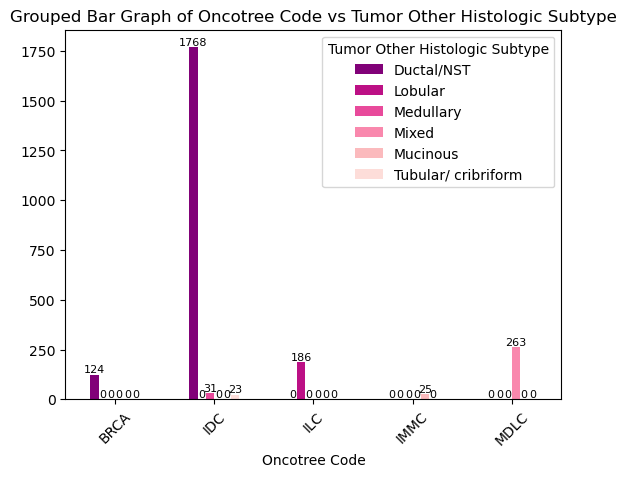

<Figure size 800x600 with 0 Axes>

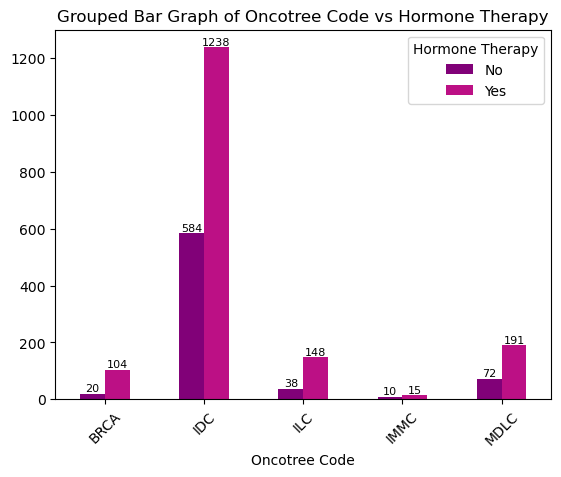

<Figure size 800x600 with 0 Axes>

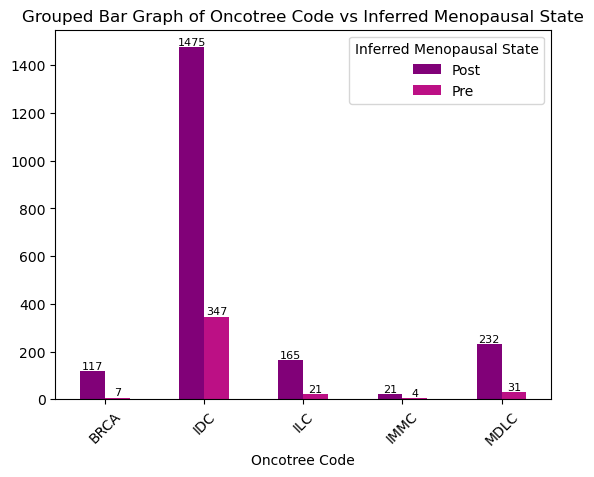

<Figure size 800x600 with 0 Axes>

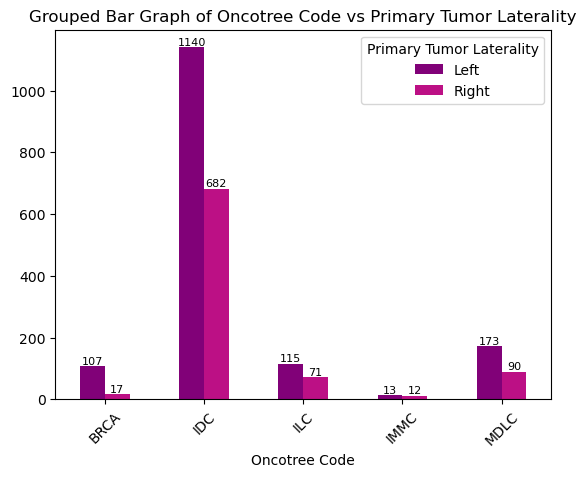

<Figure size 800x600 with 0 Axes>

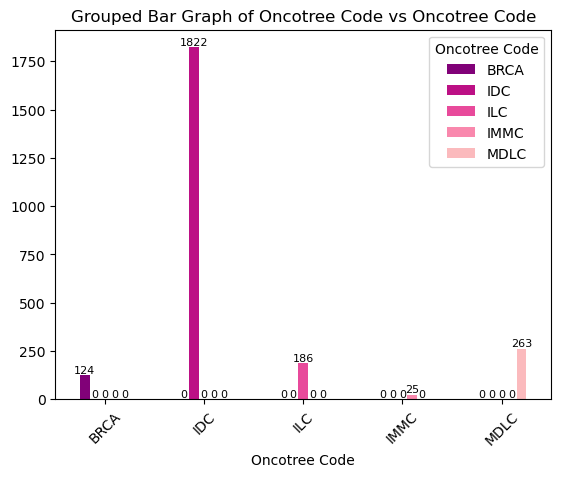

<Figure size 800x600 with 0 Axes>

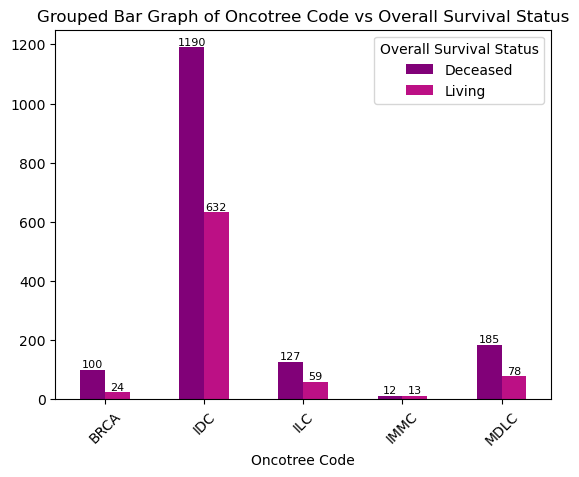

<Figure size 800x600 with 0 Axes>

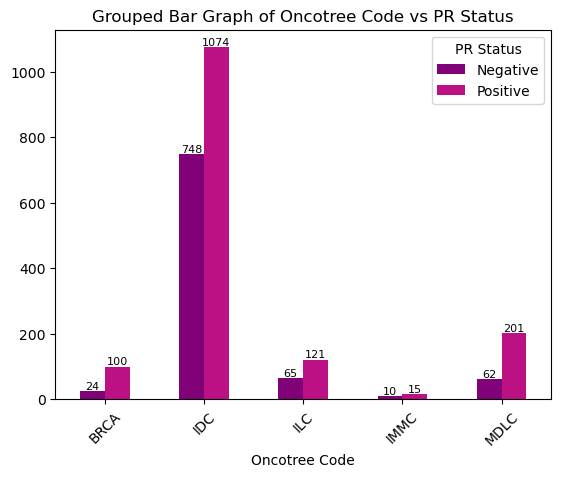

<Figure size 800x600 with 0 Axes>

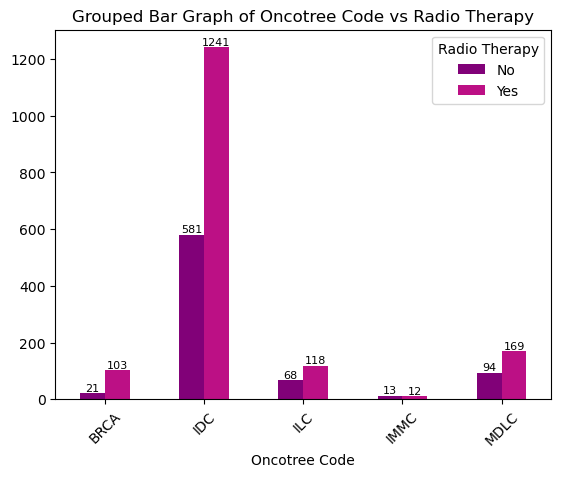

<Figure size 800x600 with 0 Axes>

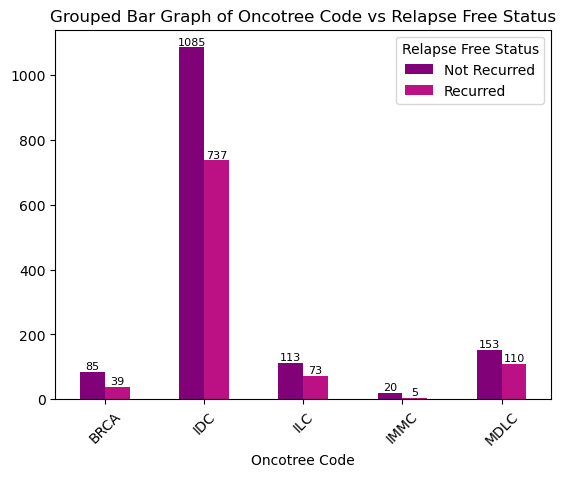

<Figure size 800x600 with 0 Axes>

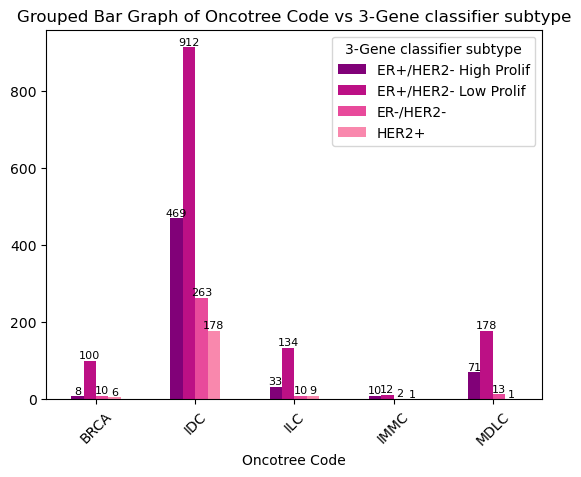

<Figure size 800x600 with 0 Axes>

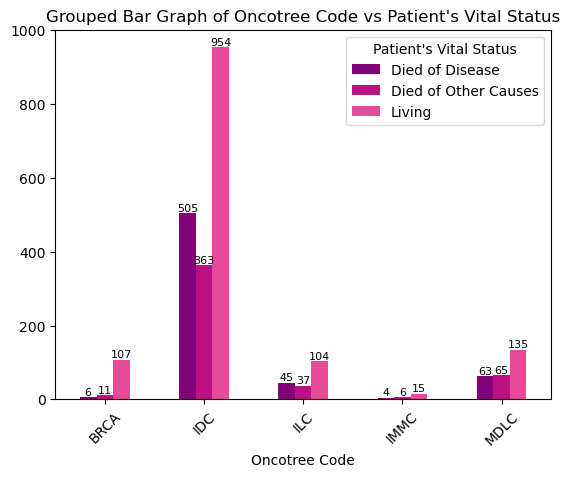

<Figure size 800x600 with 0 Axes>

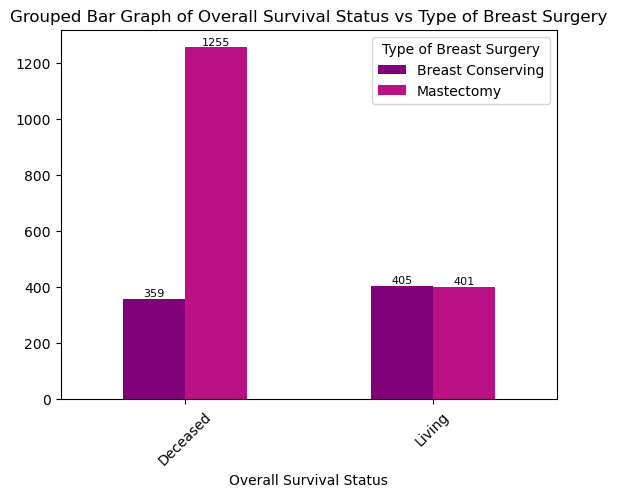

<Figure size 800x600 with 0 Axes>

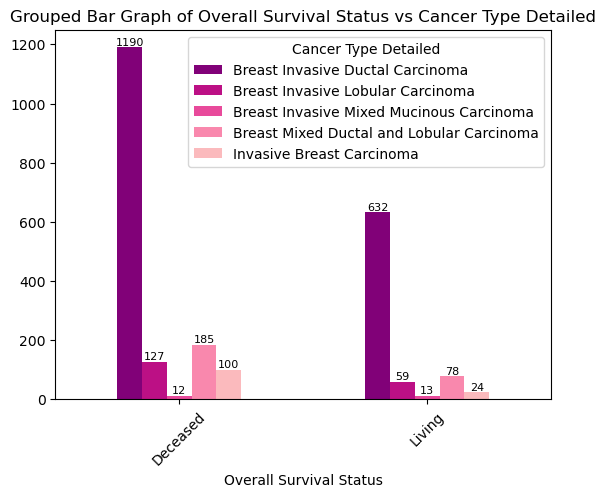

<Figure size 800x600 with 0 Axes>

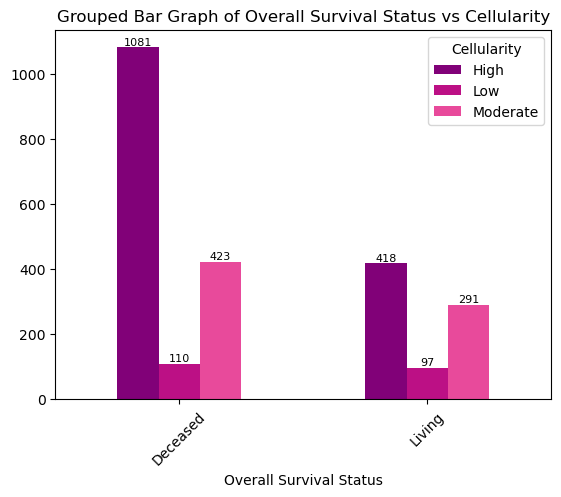

<Figure size 800x600 with 0 Axes>

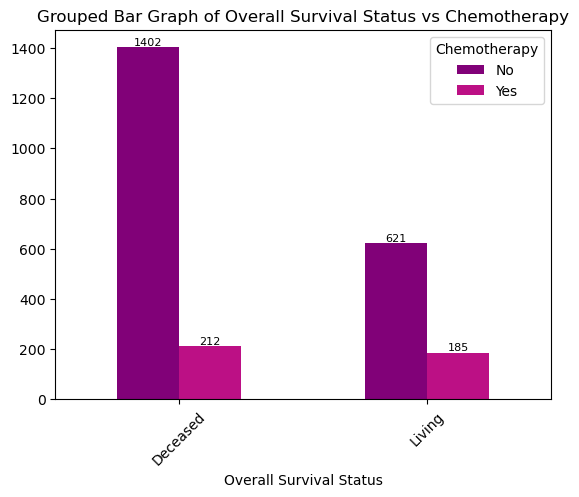

<Figure size 800x600 with 0 Axes>

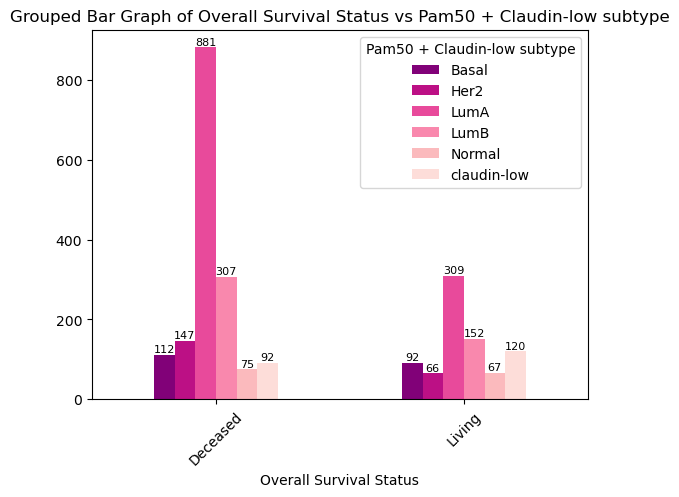

<Figure size 800x600 with 0 Axes>

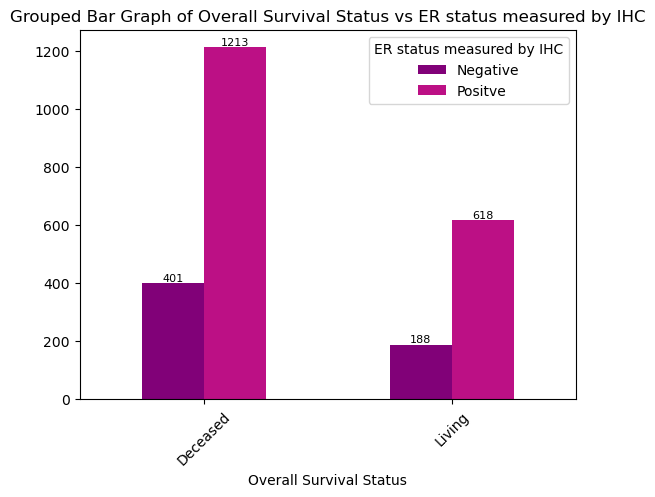

<Figure size 800x600 with 0 Axes>

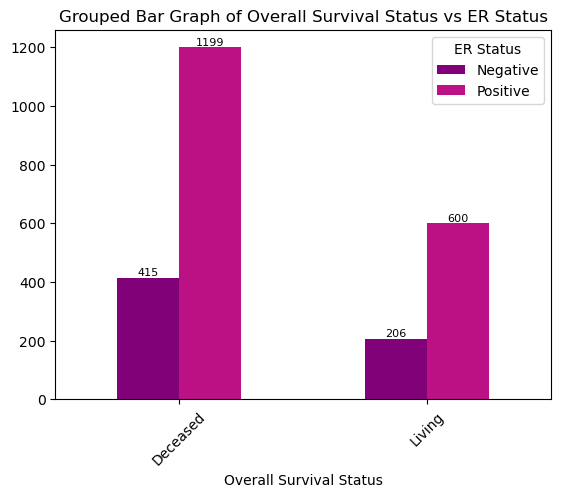

<Figure size 800x600 with 0 Axes>

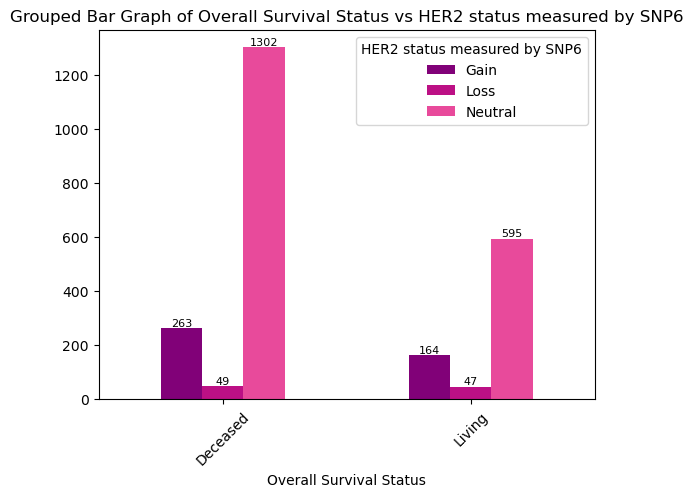

<Figure size 800x600 with 0 Axes>

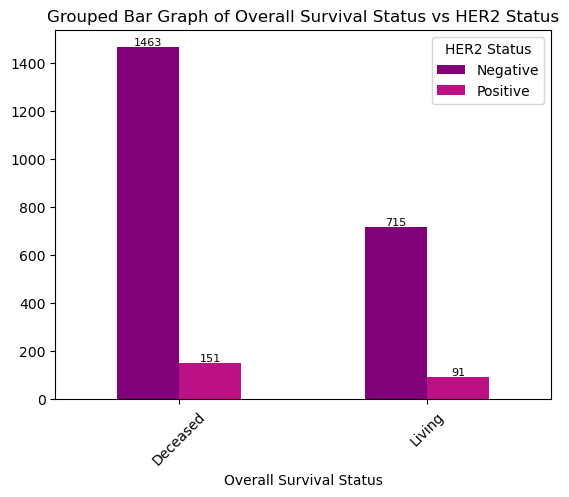

<Figure size 800x600 with 0 Axes>

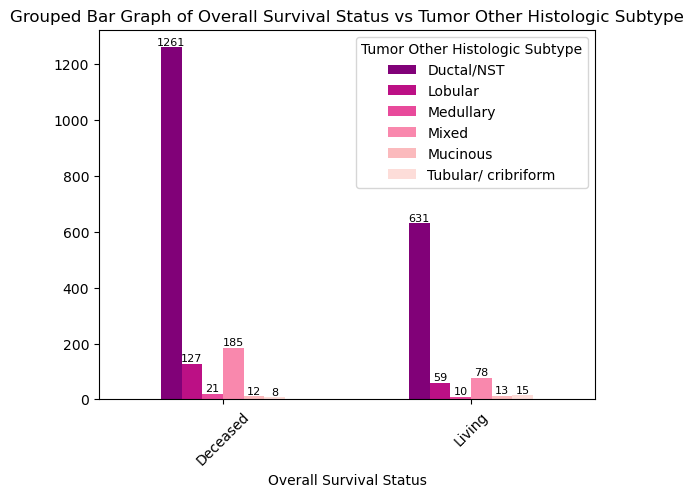

<Figure size 800x600 with 0 Axes>

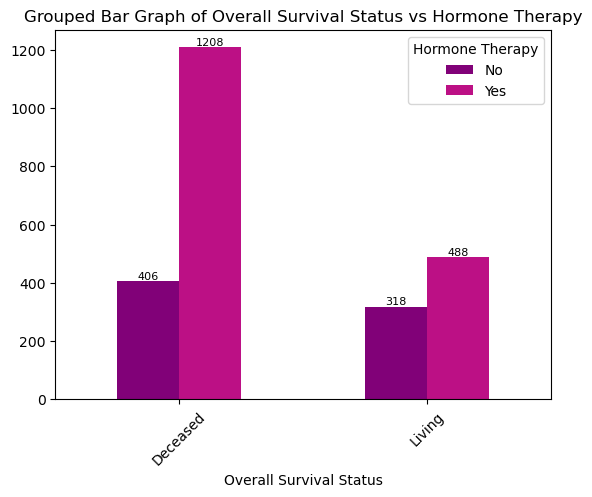

<Figure size 800x600 with 0 Axes>

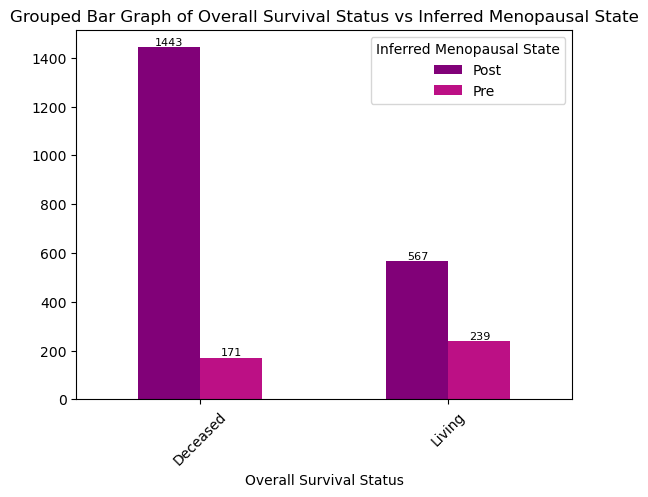

<Figure size 800x600 with 0 Axes>

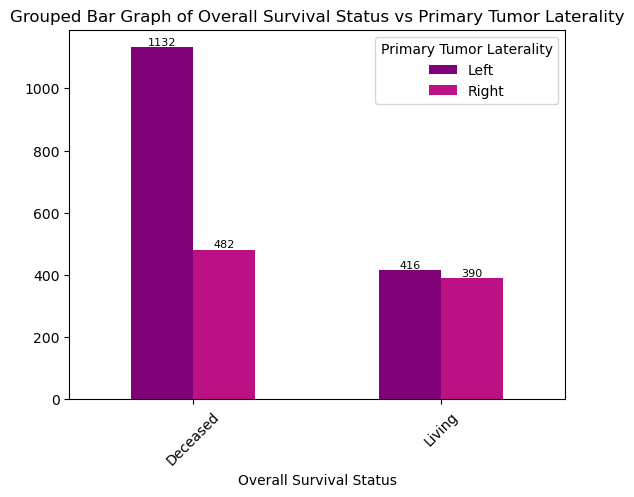

<Figure size 800x600 with 0 Axes>

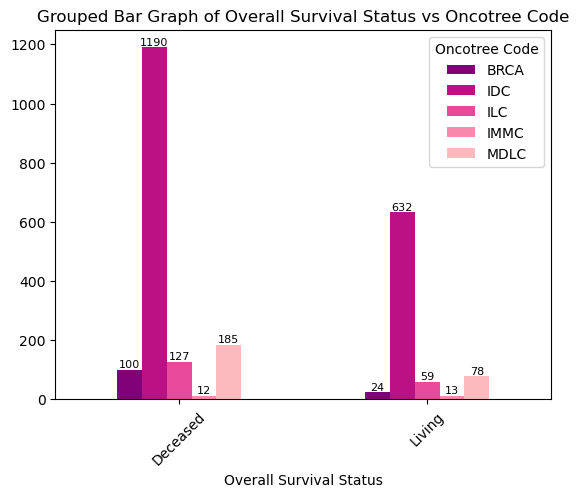

<Figure size 800x600 with 0 Axes>

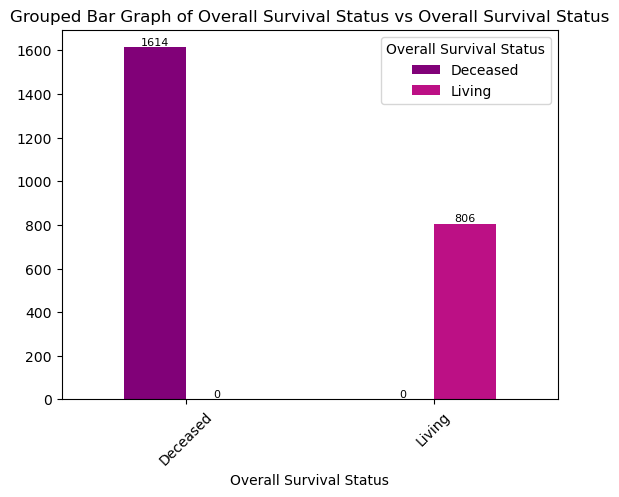

<Figure size 800x600 with 0 Axes>

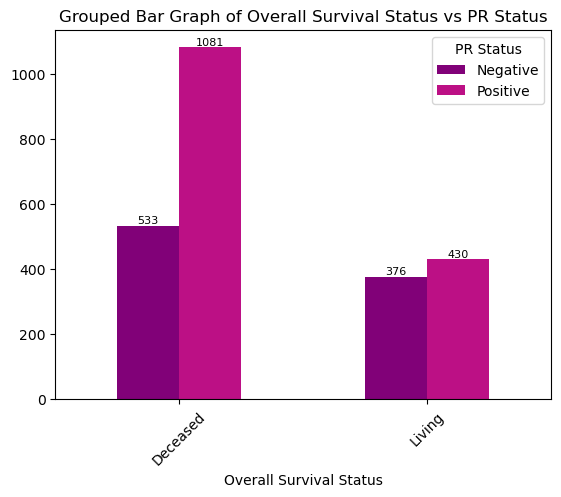

<Figure size 800x600 with 0 Axes>

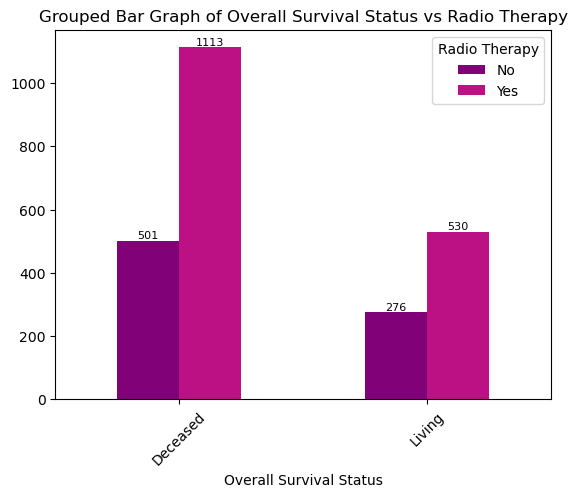

<Figure size 800x600 with 0 Axes>

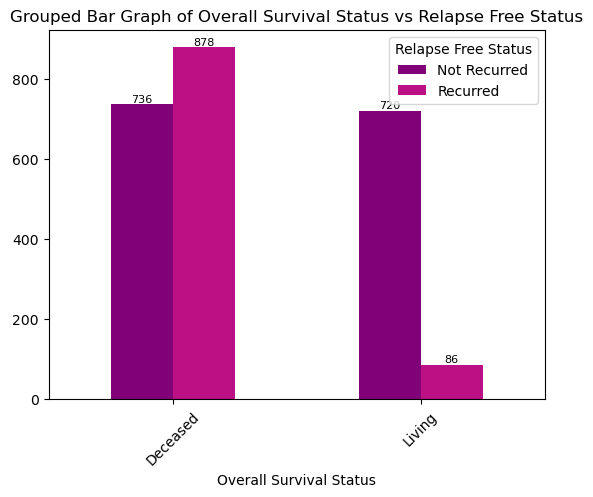

<Figure size 800x600 with 0 Axes>

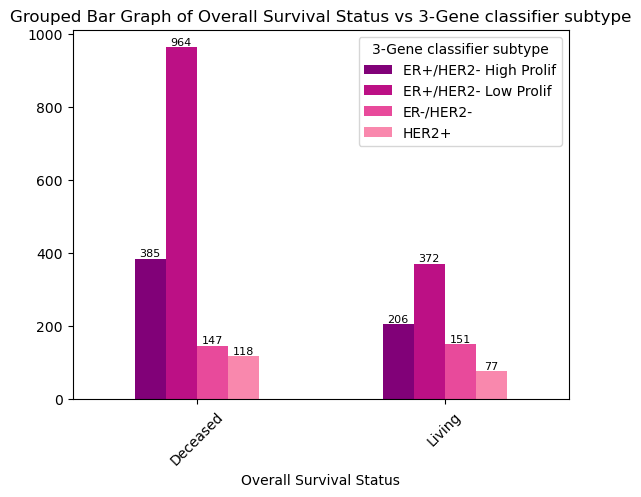

<Figure size 800x600 with 0 Axes>

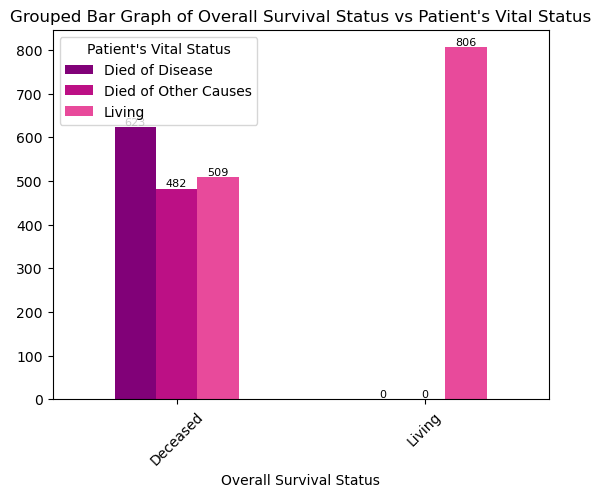

<Figure size 800x600 with 0 Axes>

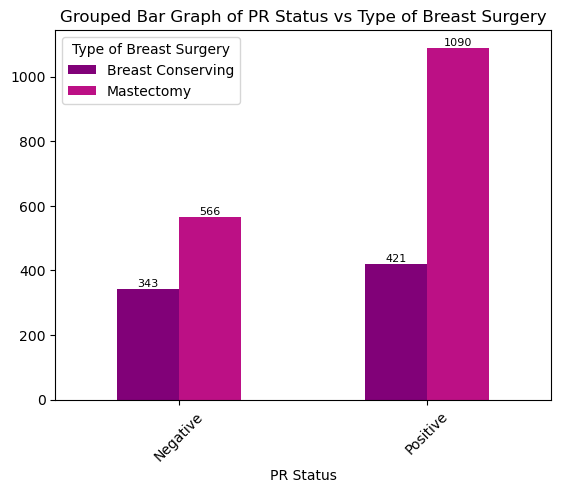

<Figure size 800x600 with 0 Axes>

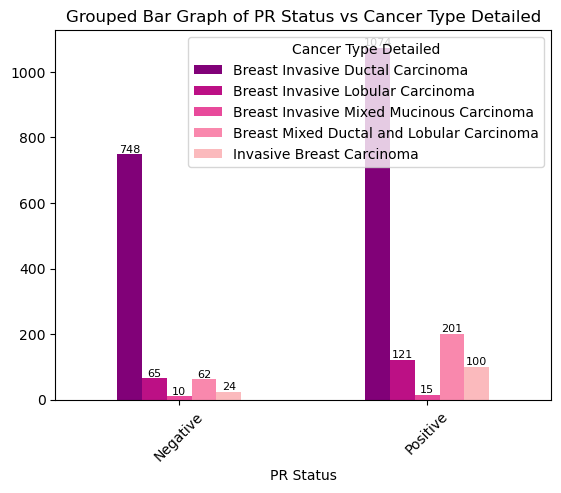

<Figure size 800x600 with 0 Axes>

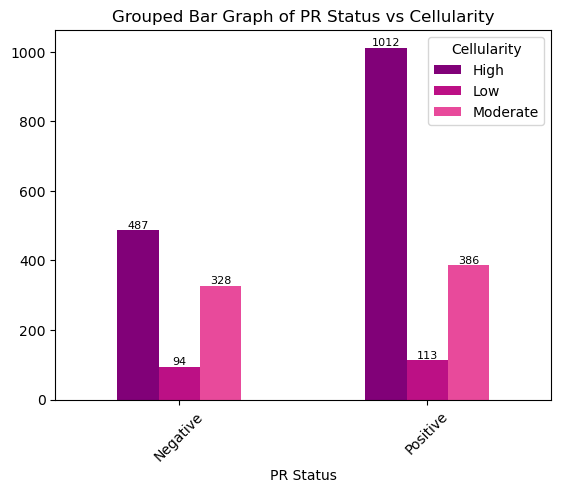

<Figure size 800x600 with 0 Axes>

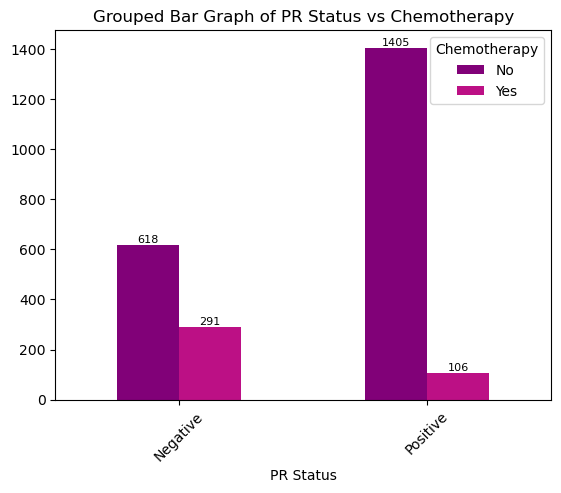

<Figure size 800x600 with 0 Axes>

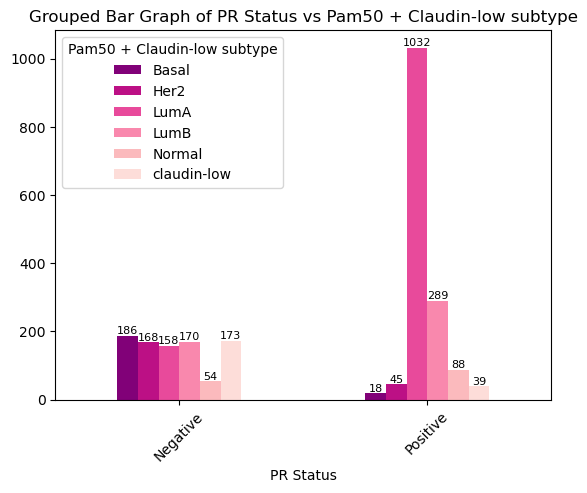

<Figure size 800x600 with 0 Axes>

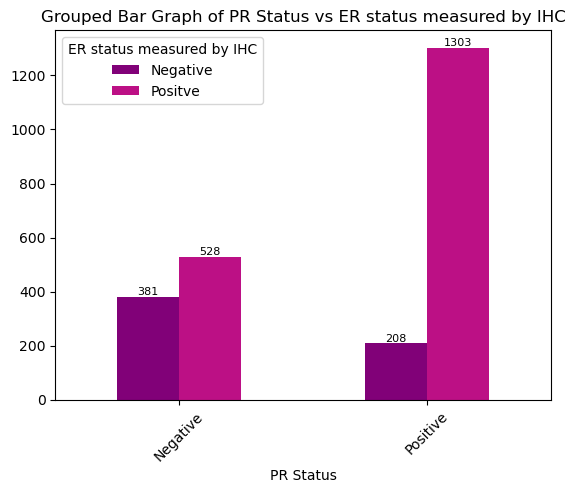

<Figure size 800x600 with 0 Axes>

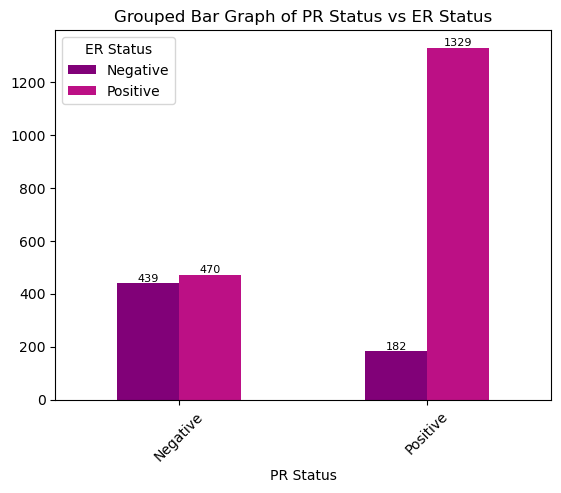

<Figure size 800x600 with 0 Axes>

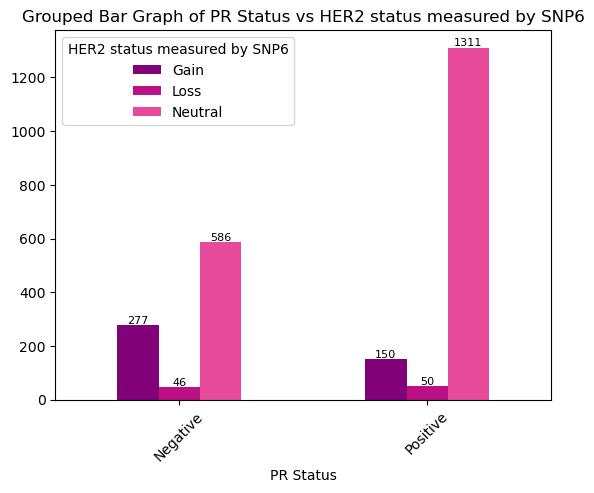

<Figure size 800x600 with 0 Axes>

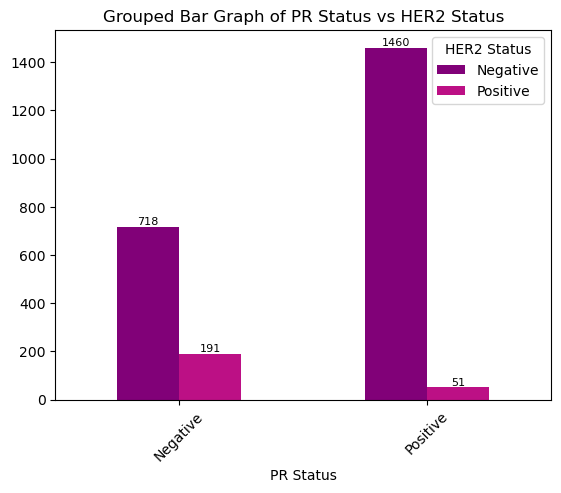

<Figure size 800x600 with 0 Axes>

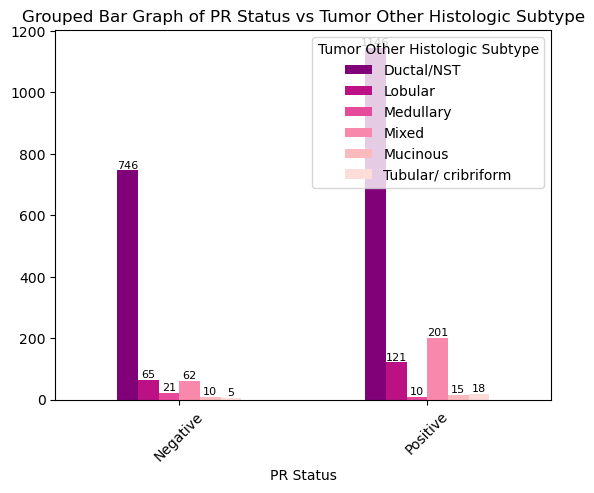

<Figure size 800x600 with 0 Axes>

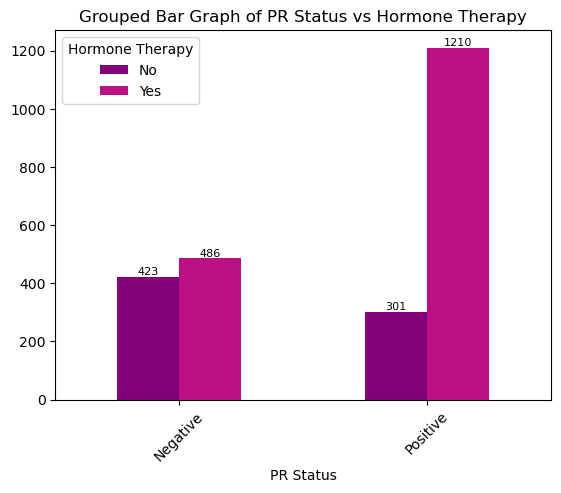

<Figure size 800x600 with 0 Axes>

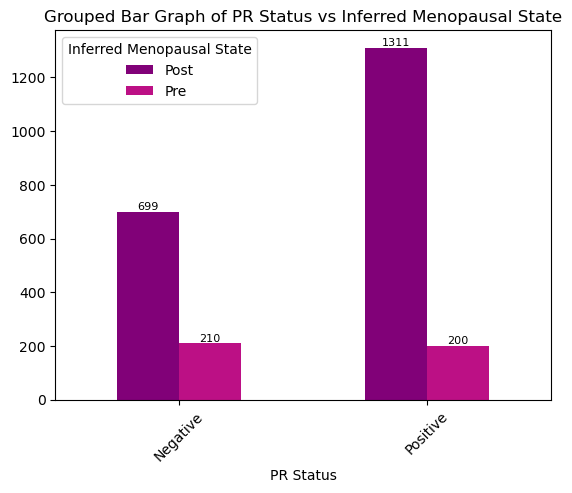

<Figure size 800x600 with 0 Axes>

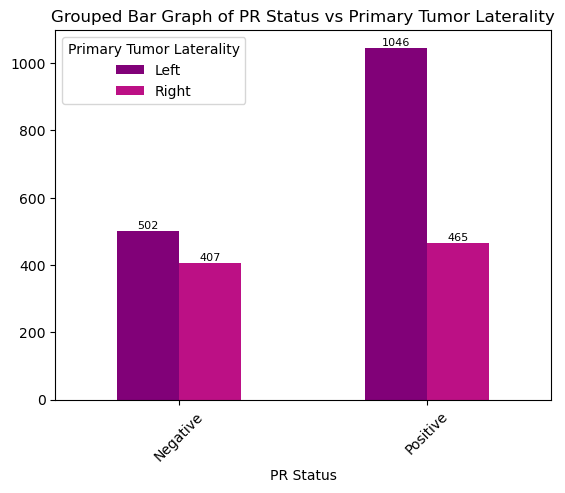

<Figure size 800x600 with 0 Axes>

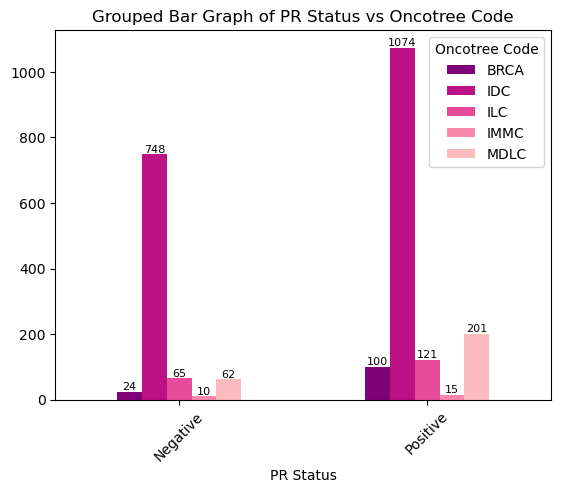

<Figure size 800x600 with 0 Axes>

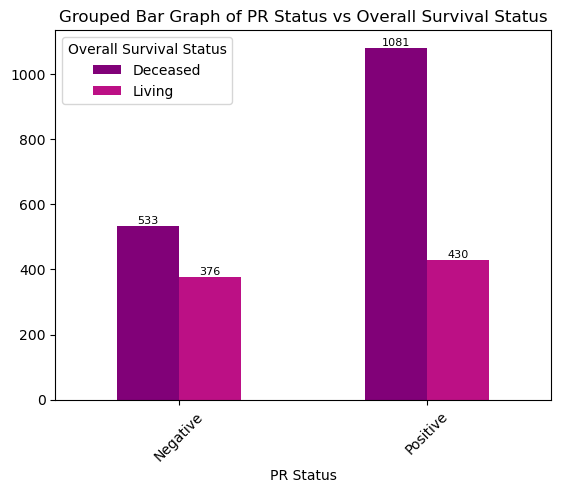

<Figure size 800x600 with 0 Axes>

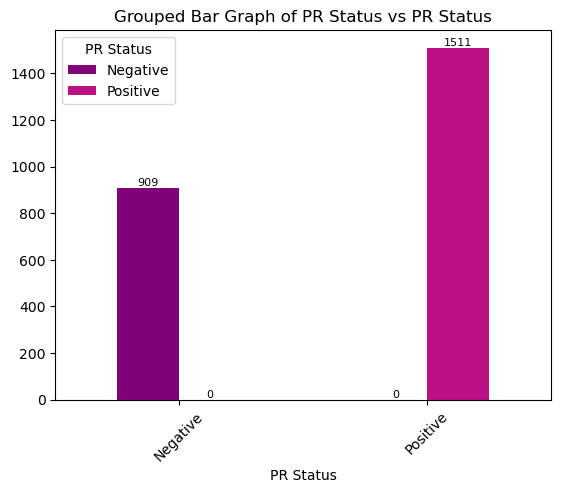

<Figure size 800x600 with 0 Axes>

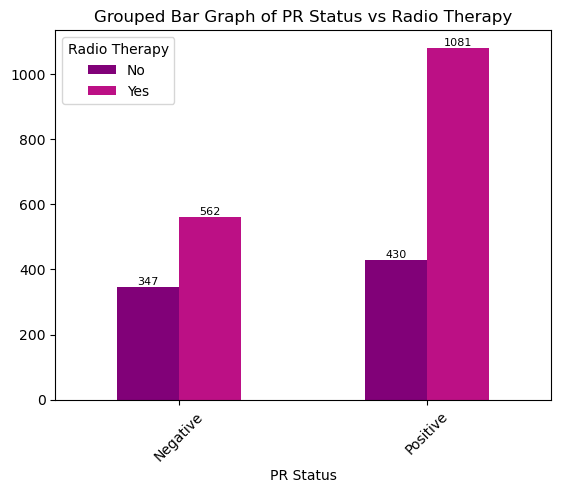

<Figure size 800x600 with 0 Axes>

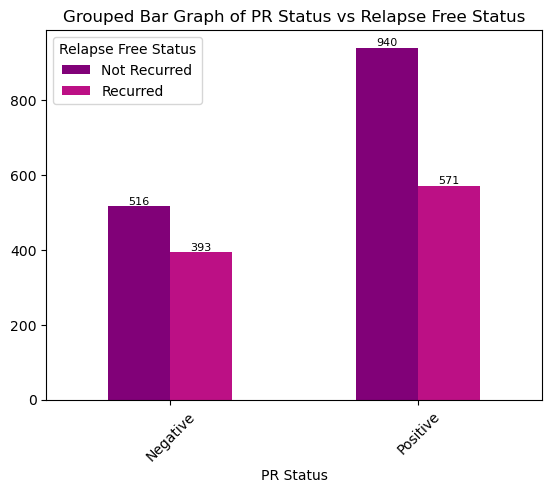

<Figure size 800x600 with 0 Axes>

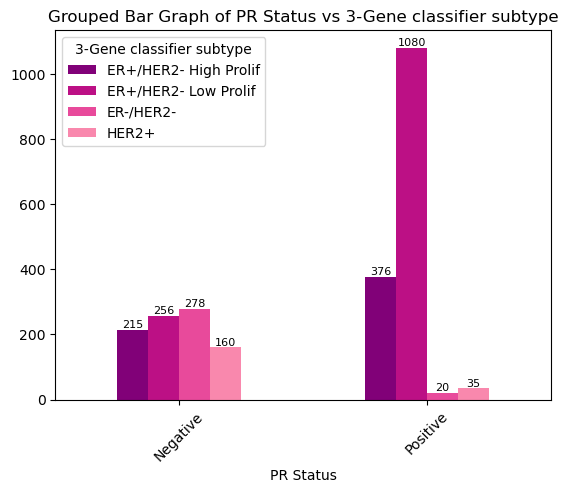

<Figure size 800x600 with 0 Axes>

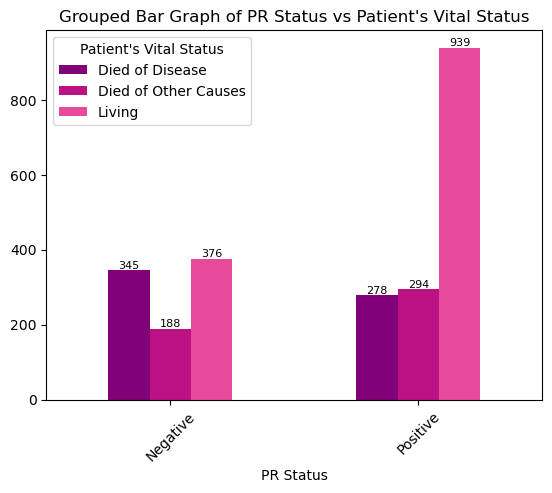

<Figure size 800x600 with 0 Axes>

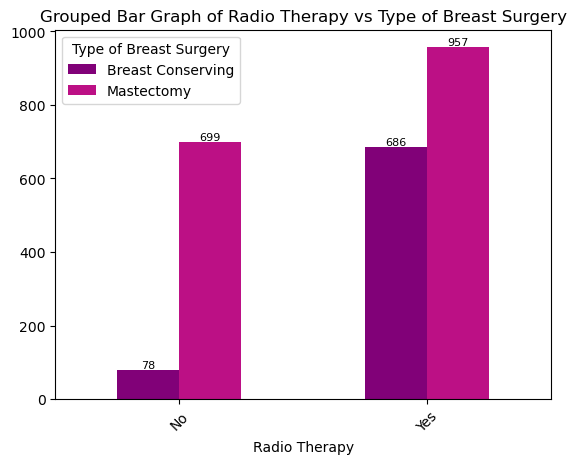

<Figure size 800x600 with 0 Axes>

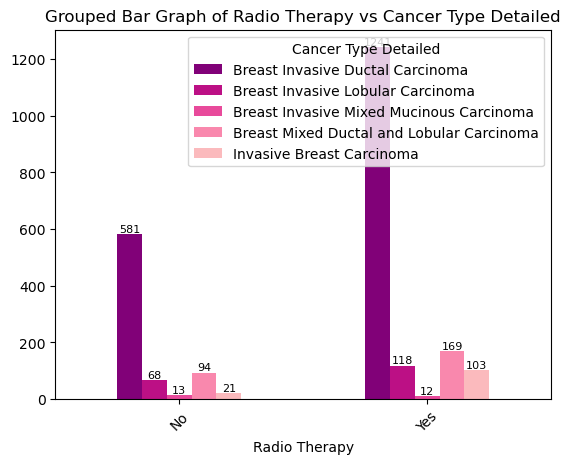

<Figure size 800x600 with 0 Axes>

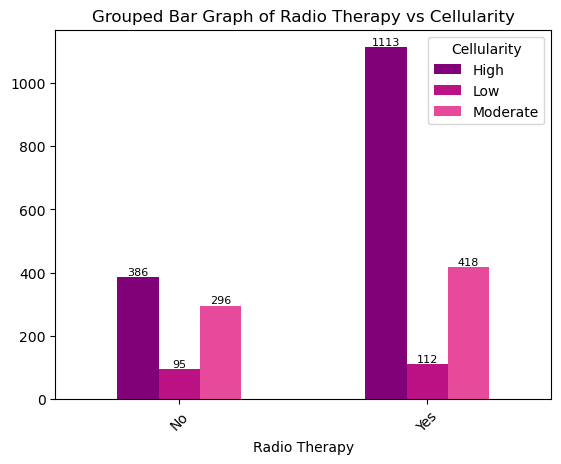

<Figure size 800x600 with 0 Axes>

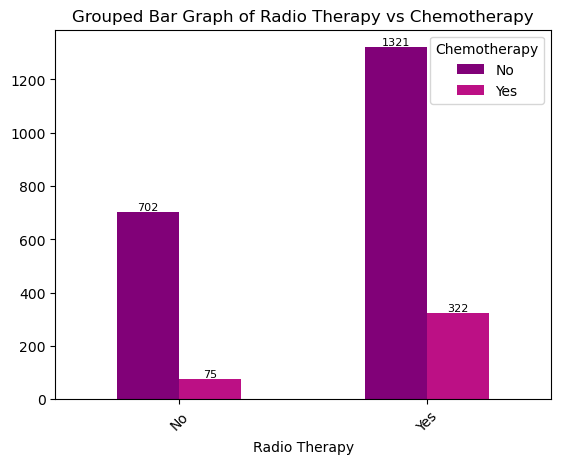

<Figure size 800x600 with 0 Axes>

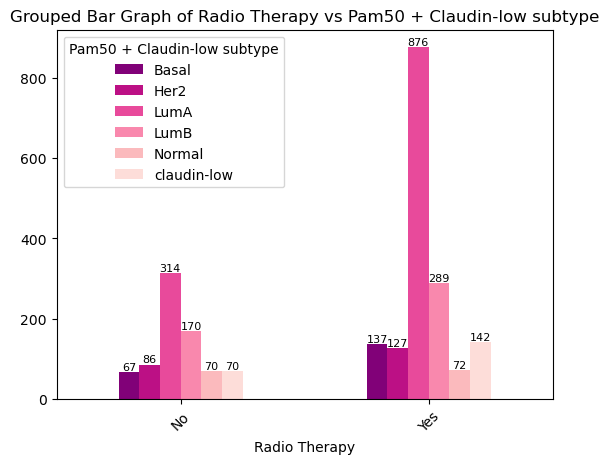

<Figure size 800x600 with 0 Axes>

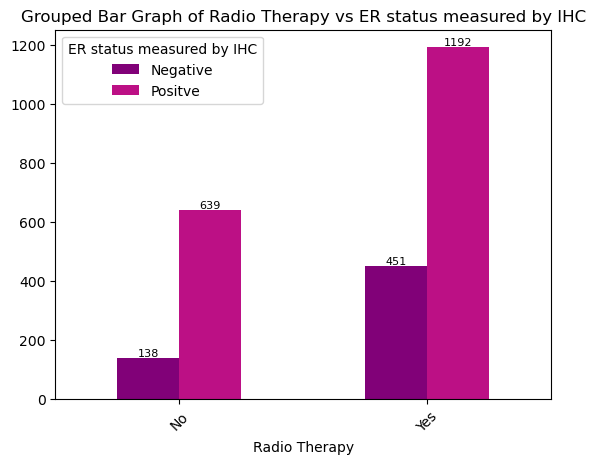

<Figure size 800x600 with 0 Axes>

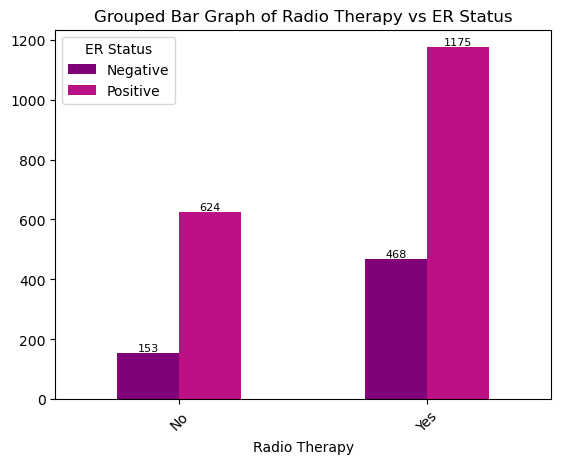

<Figure size 800x600 with 0 Axes>

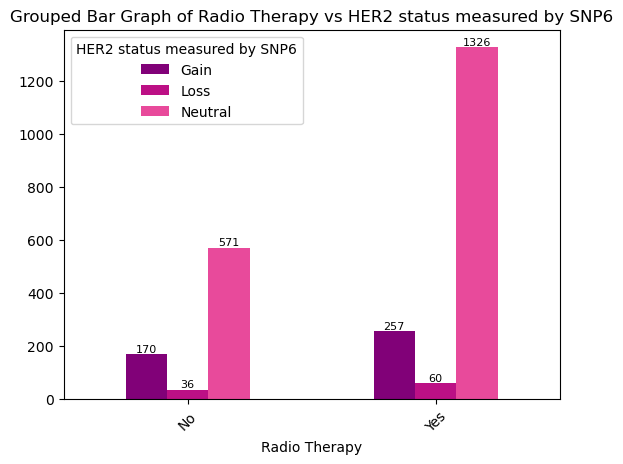

<Figure size 800x600 with 0 Axes>

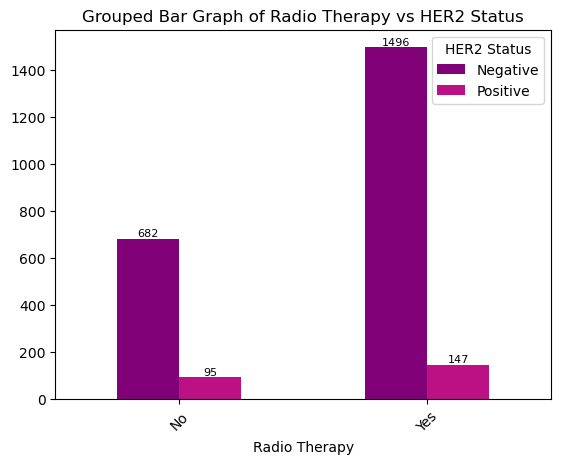

<Figure size 800x600 with 0 Axes>

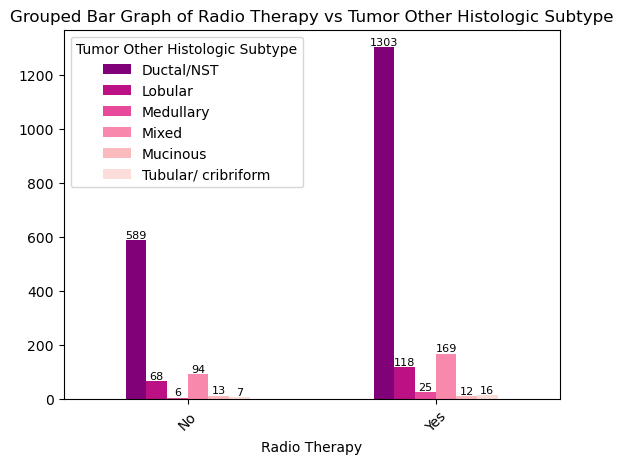

<Figure size 800x600 with 0 Axes>

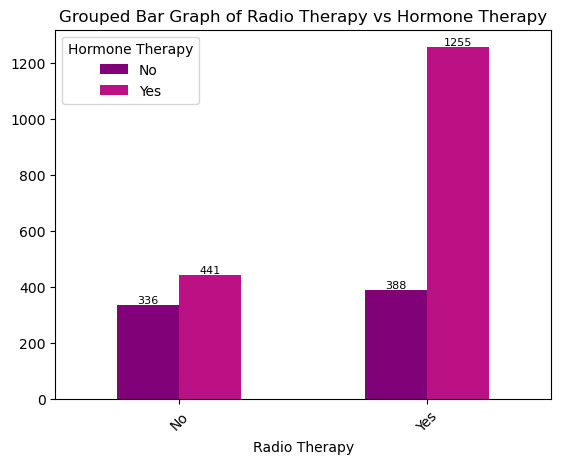

<Figure size 800x600 with 0 Axes>

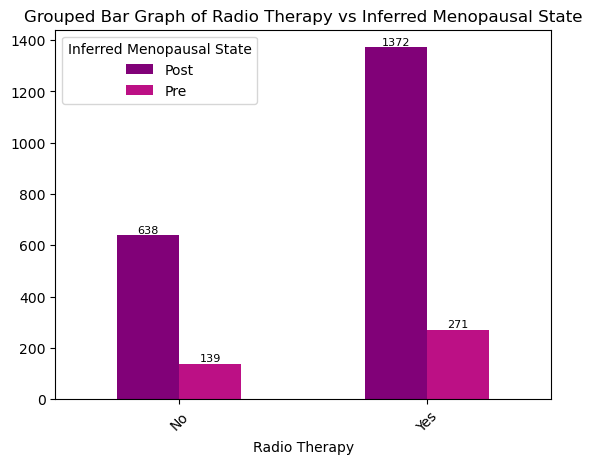

<Figure size 800x600 with 0 Axes>

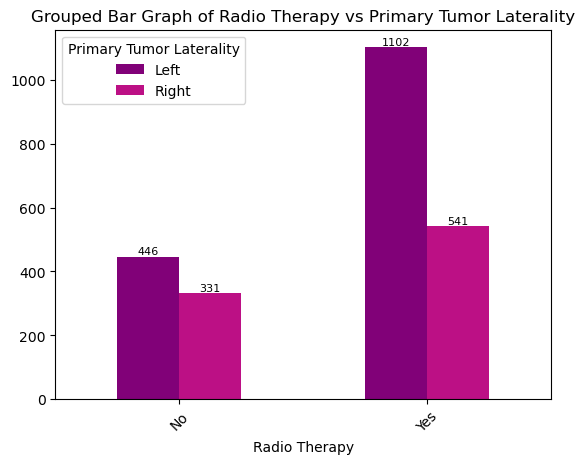

<Figure size 800x600 with 0 Axes>

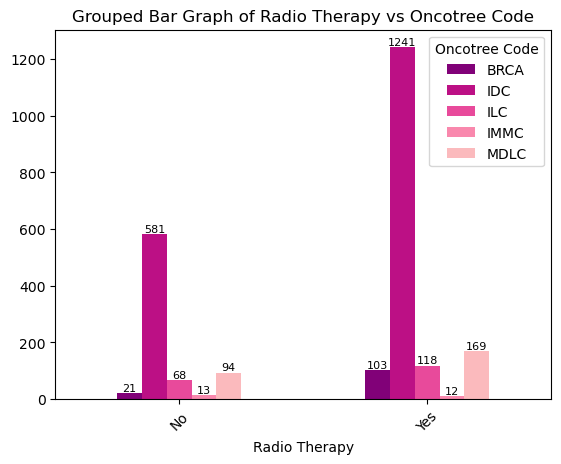

<Figure size 800x600 with 0 Axes>

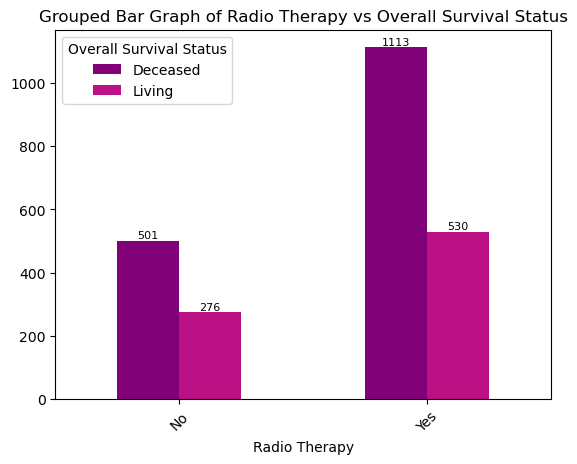

<Figure size 800x600 with 0 Axes>

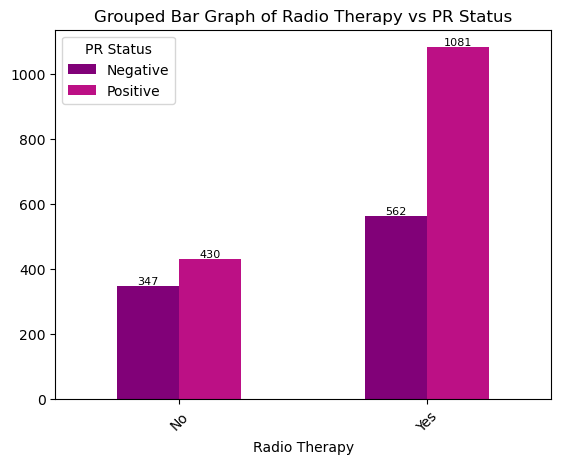

<Figure size 800x600 with 0 Axes>

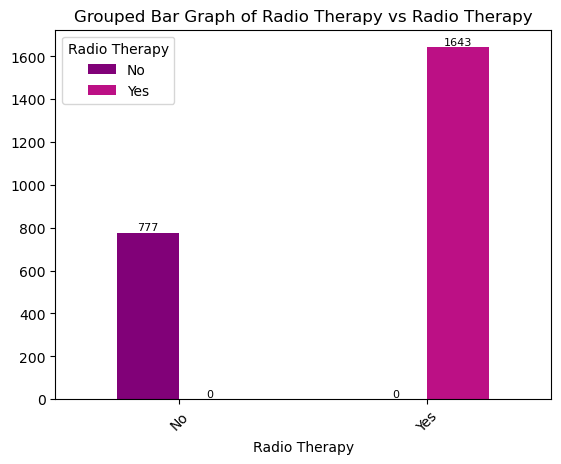

<Figure size 800x600 with 0 Axes>

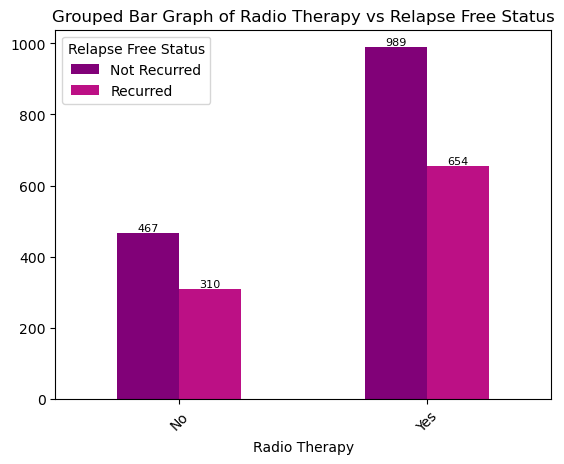

<Figure size 800x600 with 0 Axes>

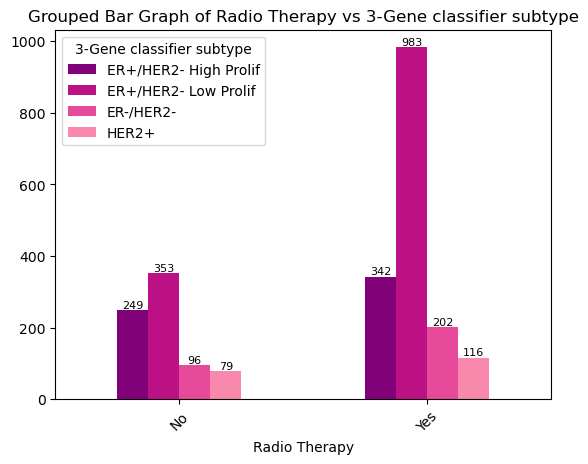

<Figure size 800x600 with 0 Axes>

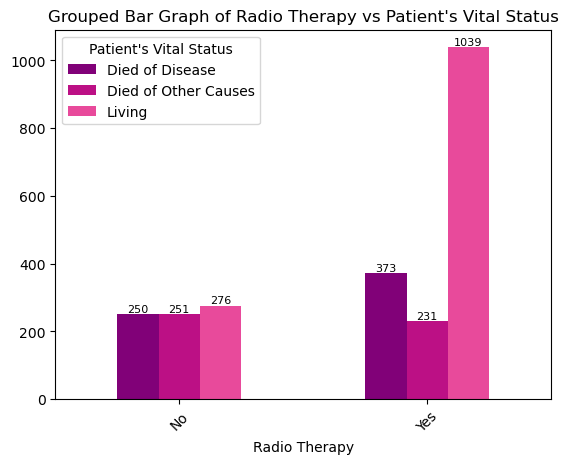

<Figure size 800x600 with 0 Axes>

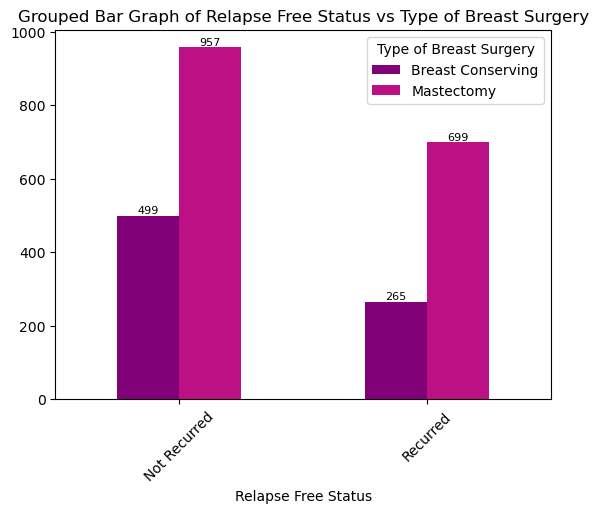

<Figure size 800x600 with 0 Axes>

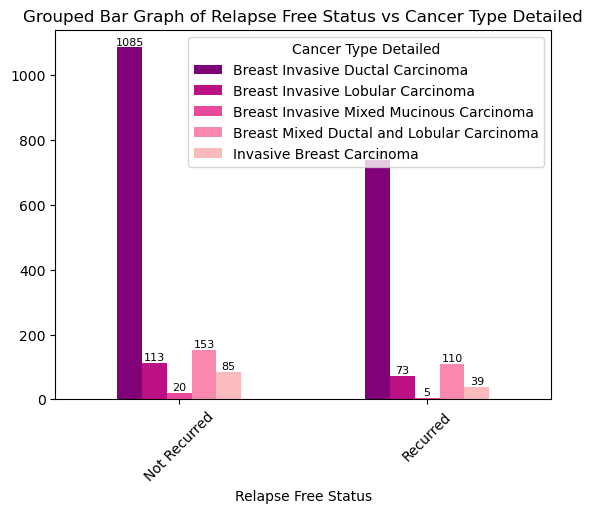

<Figure size 800x600 with 0 Axes>

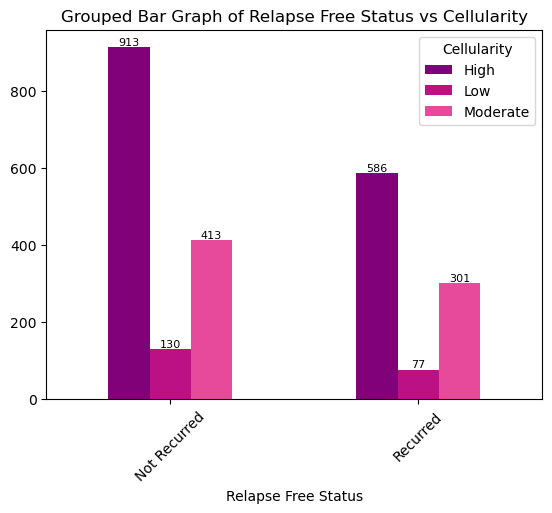

<Figure size 800x600 with 0 Axes>

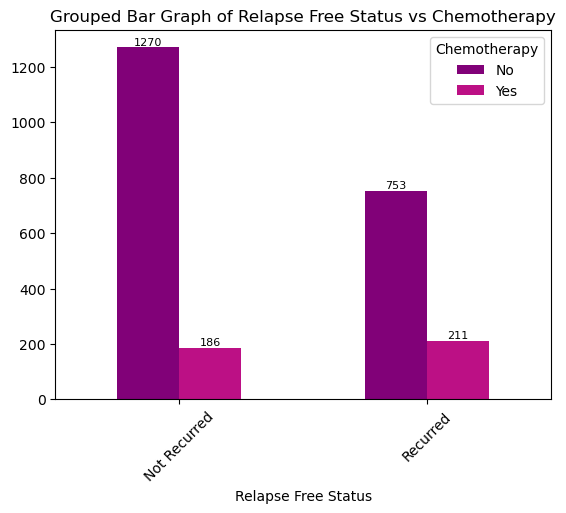

<Figure size 800x600 with 0 Axes>

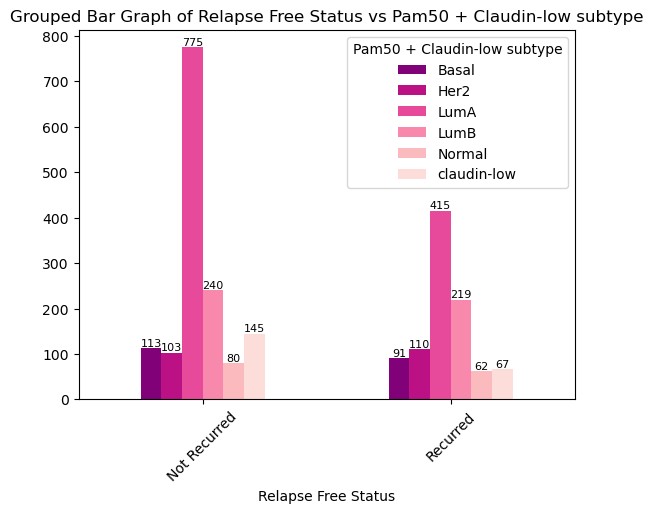

<Figure size 800x600 with 0 Axes>

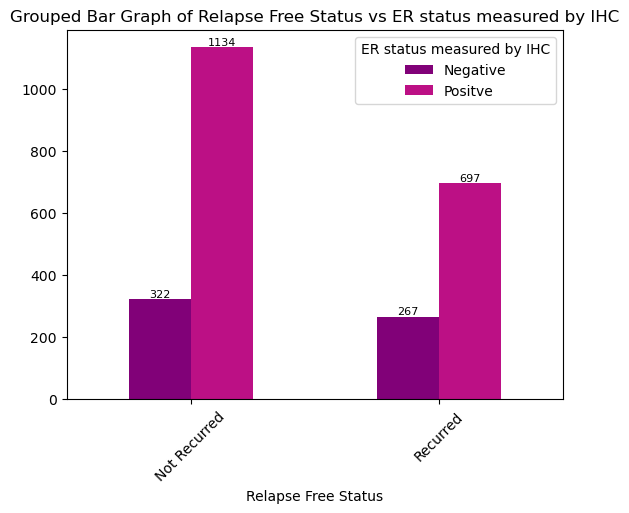

<Figure size 800x600 with 0 Axes>

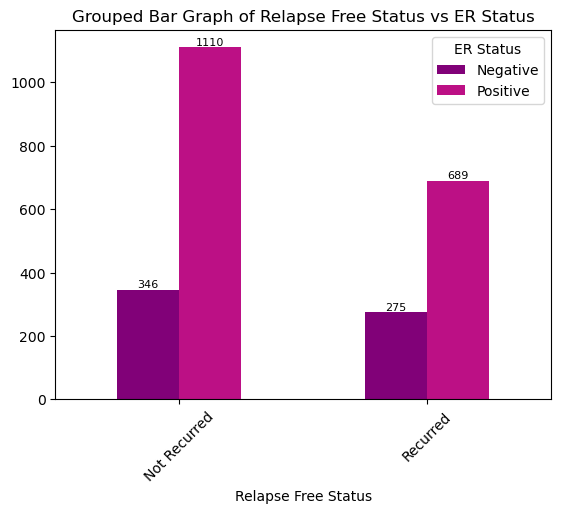

<Figure size 800x600 with 0 Axes>

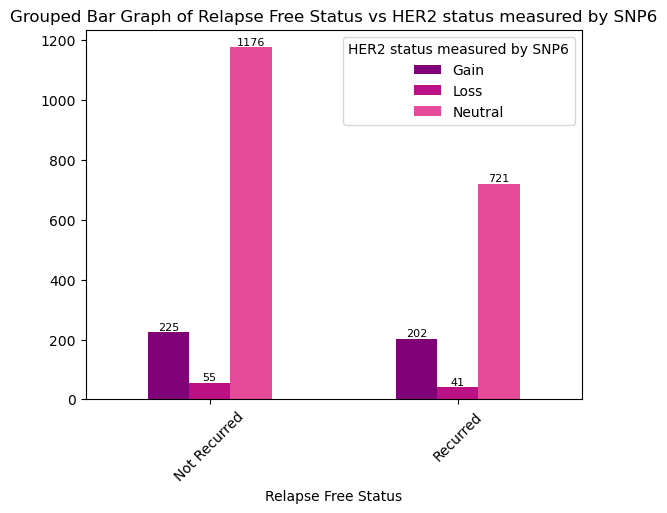

<Figure size 800x600 with 0 Axes>

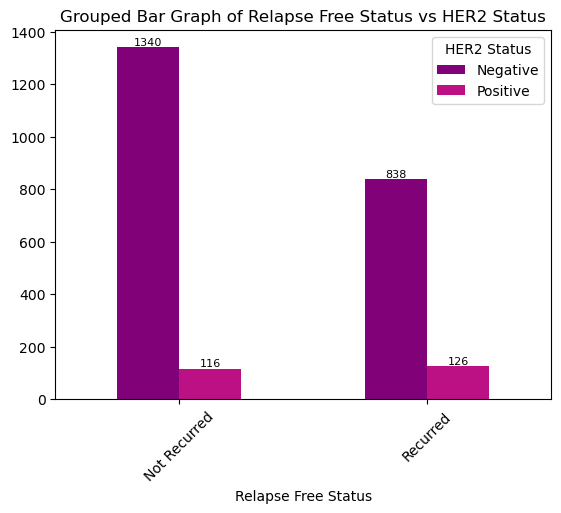

<Figure size 800x600 with 0 Axes>

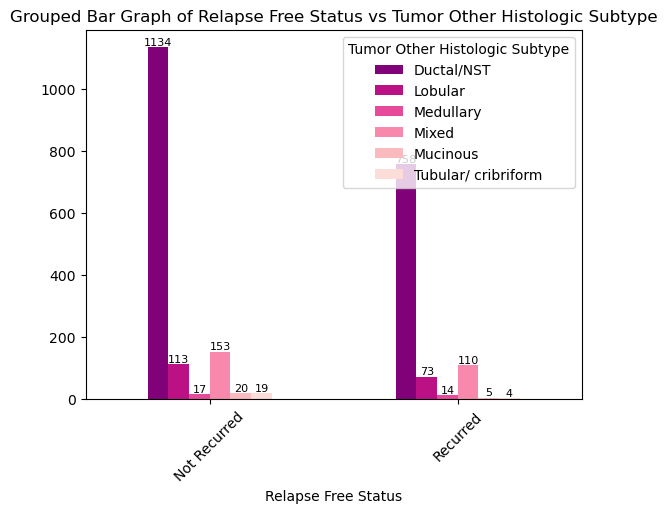

<Figure size 800x600 with 0 Axes>

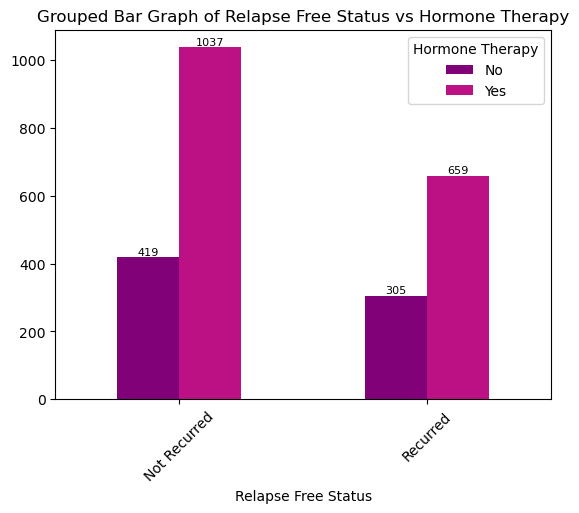

<Figure size 800x600 with 0 Axes>

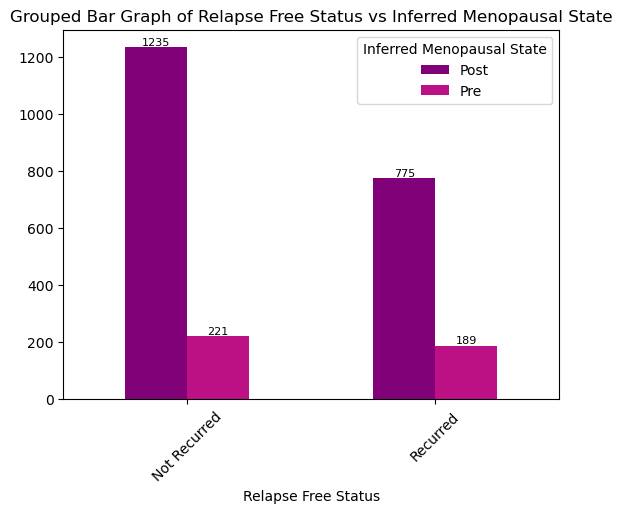

<Figure size 800x600 with 0 Axes>

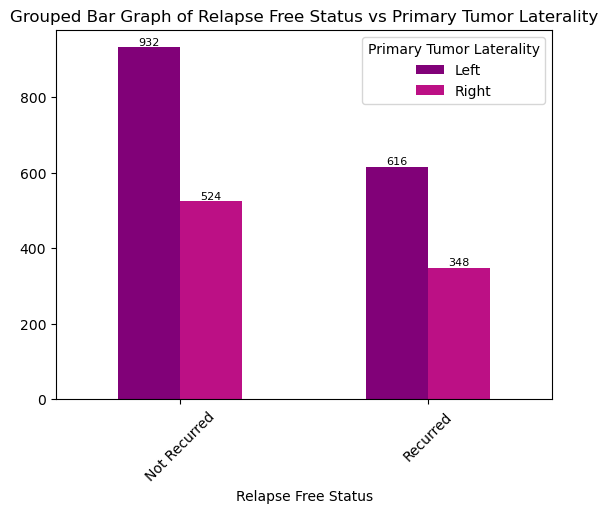

<Figure size 800x600 with 0 Axes>

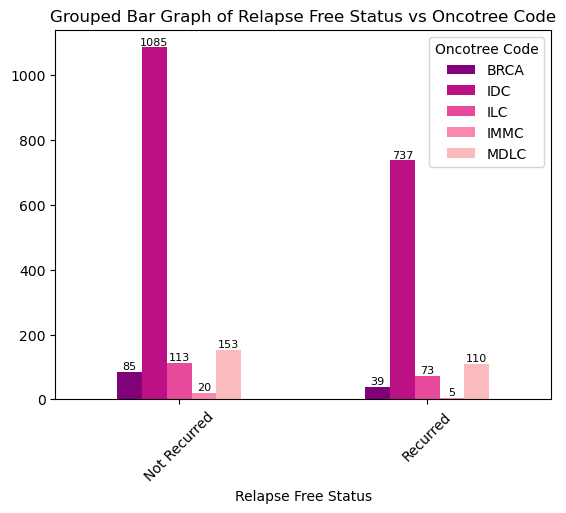

<Figure size 800x600 with 0 Axes>

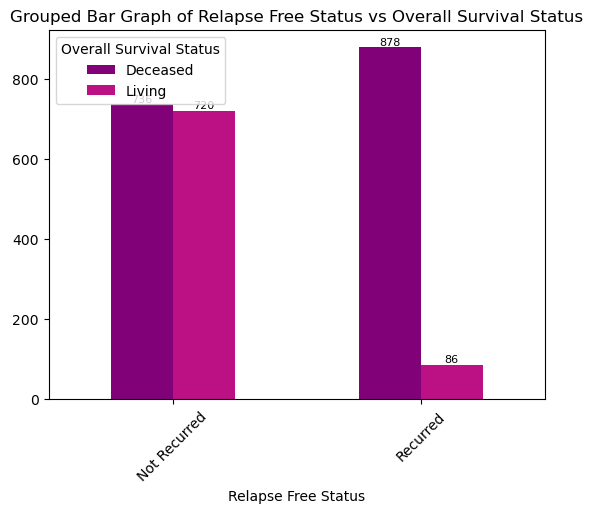

<Figure size 800x600 with 0 Axes>

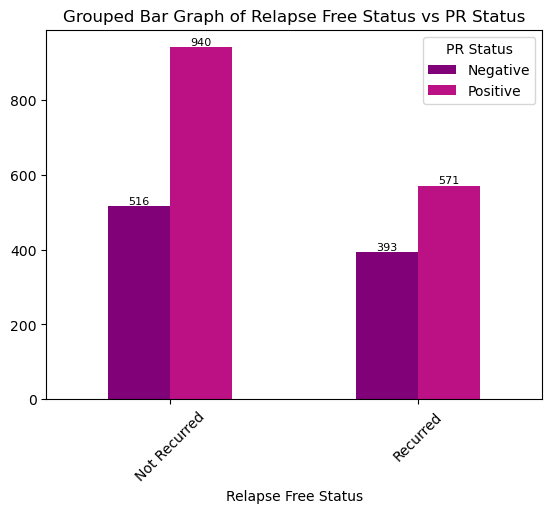

<Figure size 800x600 with 0 Axes>

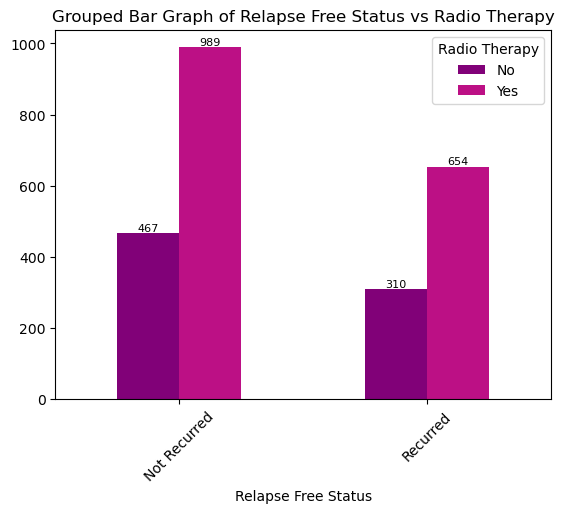

<Figure size 800x600 with 0 Axes>

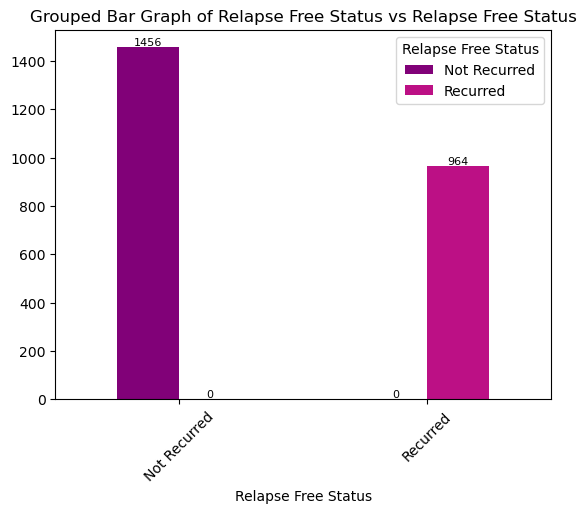

<Figure size 800x600 with 0 Axes>

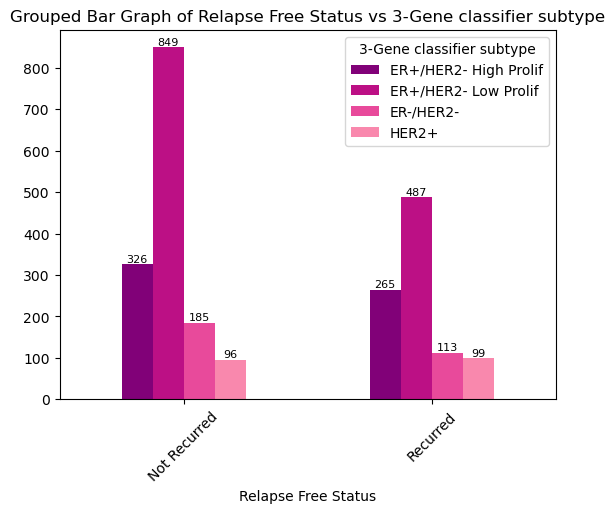

<Figure size 800x600 with 0 Axes>

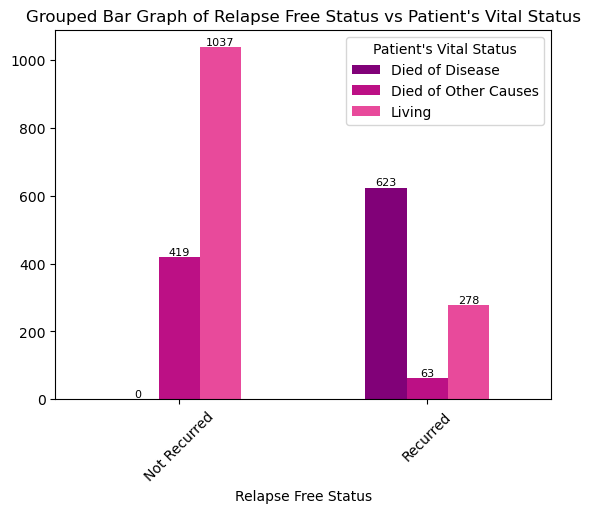

<Figure size 800x600 with 0 Axes>

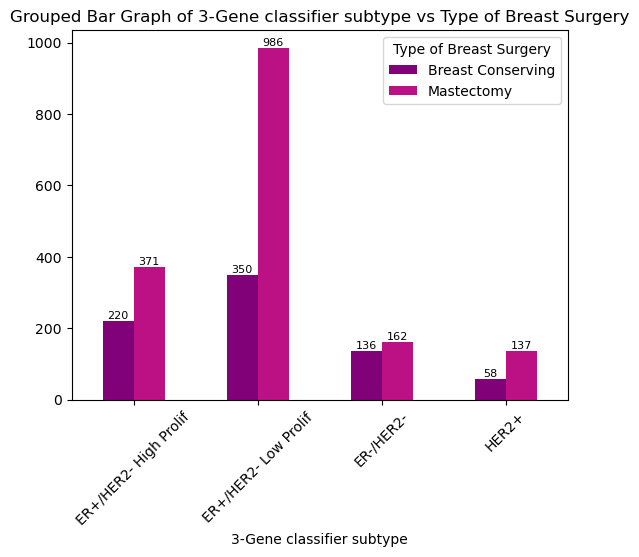

<Figure size 800x600 with 0 Axes>

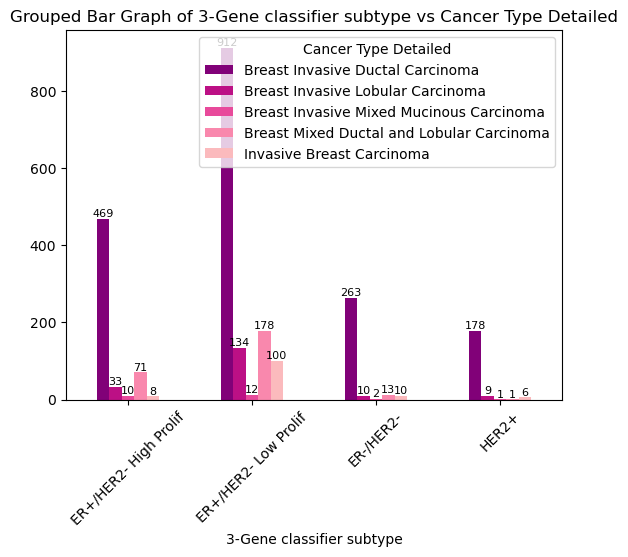

<Figure size 800x600 with 0 Axes>

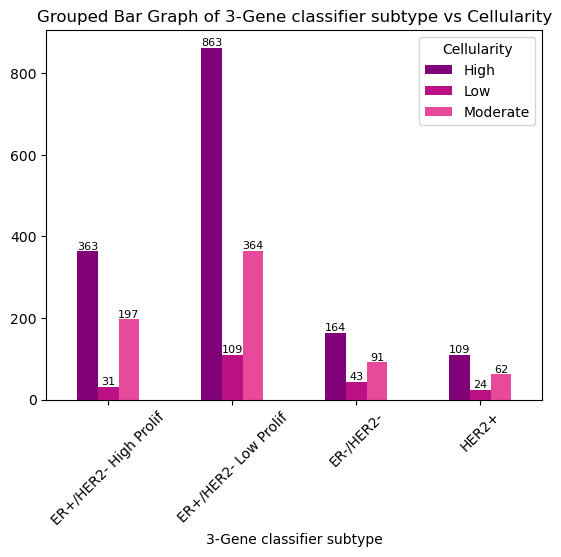

<Figure size 800x600 with 0 Axes>

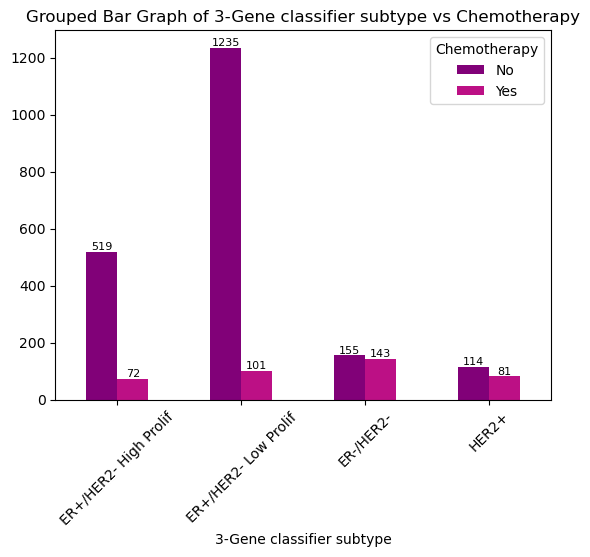

<Figure size 800x600 with 0 Axes>

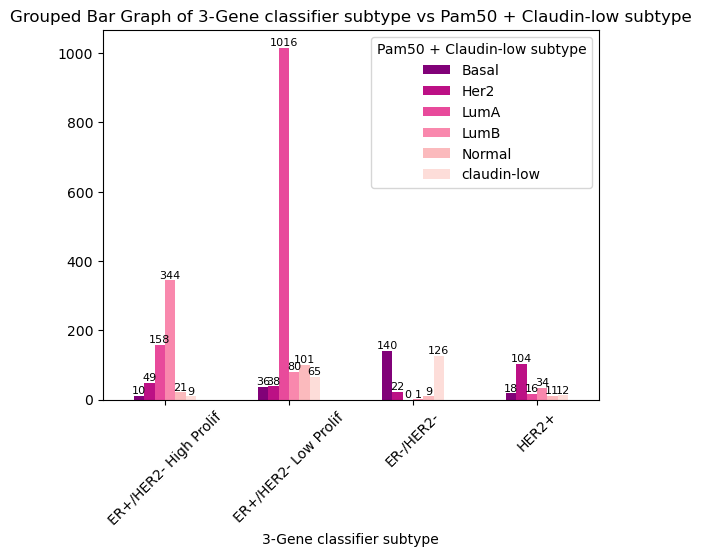

<Figure size 800x600 with 0 Axes>

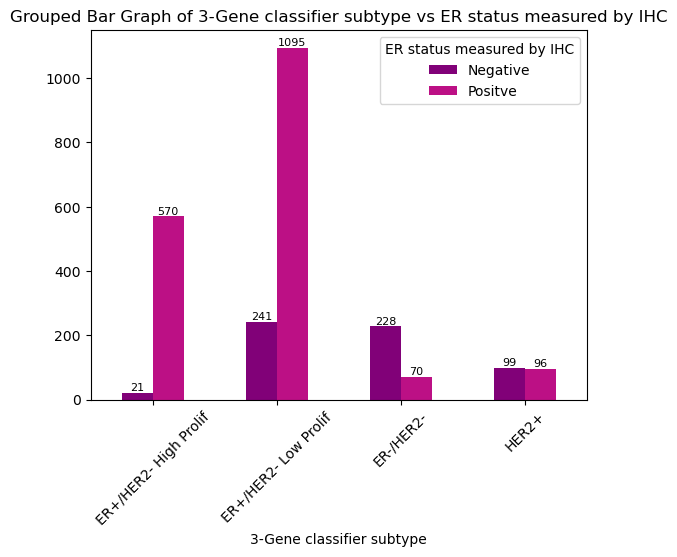

<Figure size 800x600 with 0 Axes>

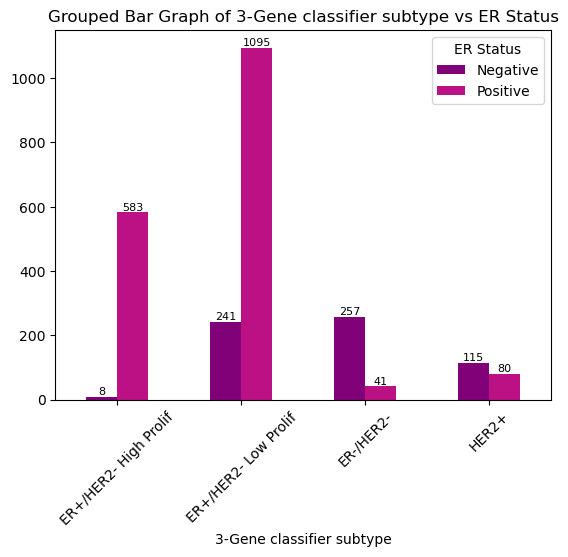

<Figure size 800x600 with 0 Axes>

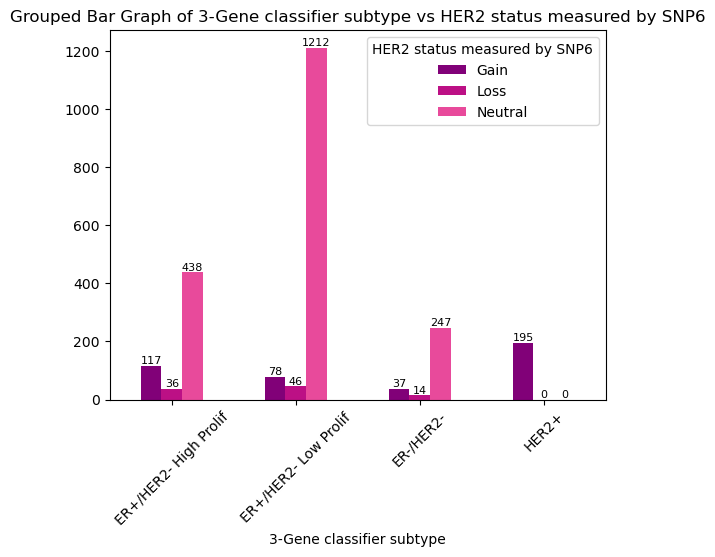

<Figure size 800x600 with 0 Axes>

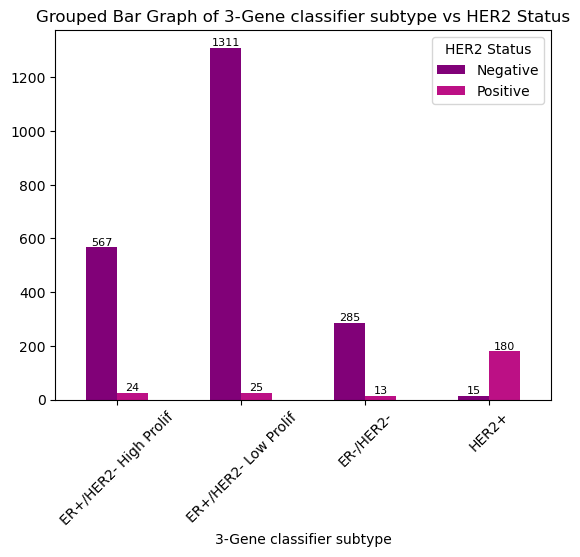

<Figure size 800x600 with 0 Axes>

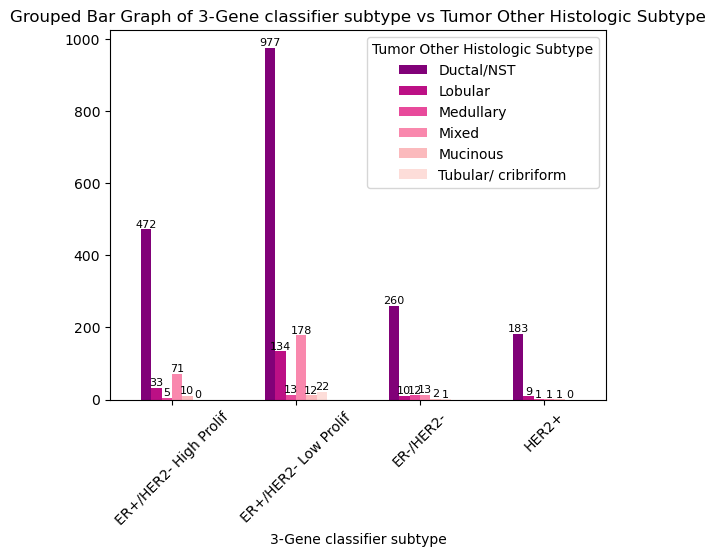

<Figure size 800x600 with 0 Axes>

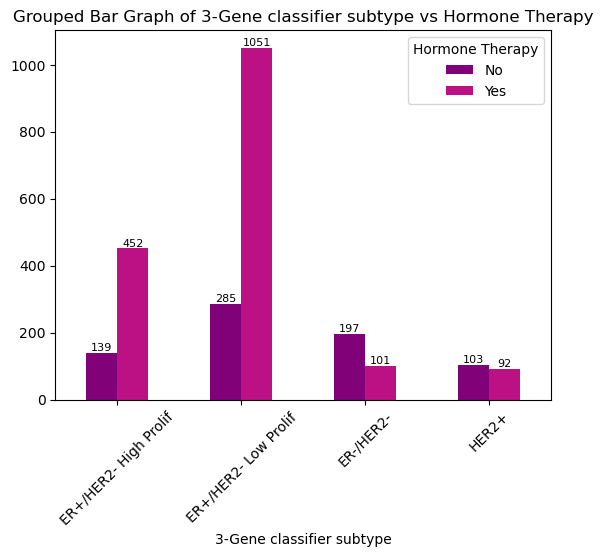

<Figure size 800x600 with 0 Axes>

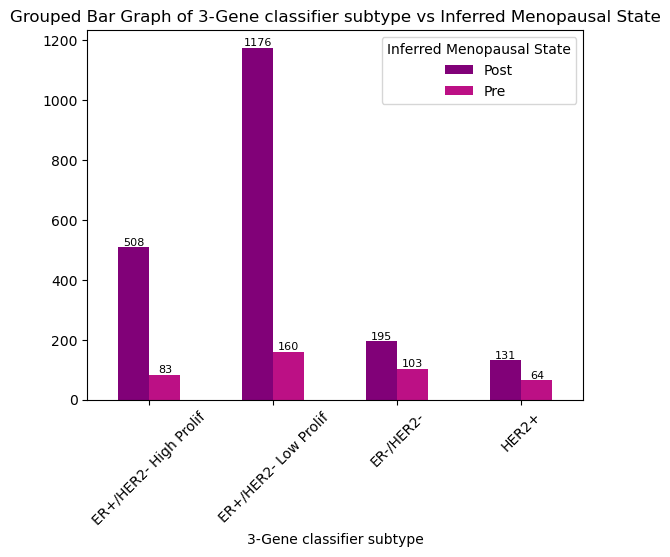

<Figure size 800x600 with 0 Axes>

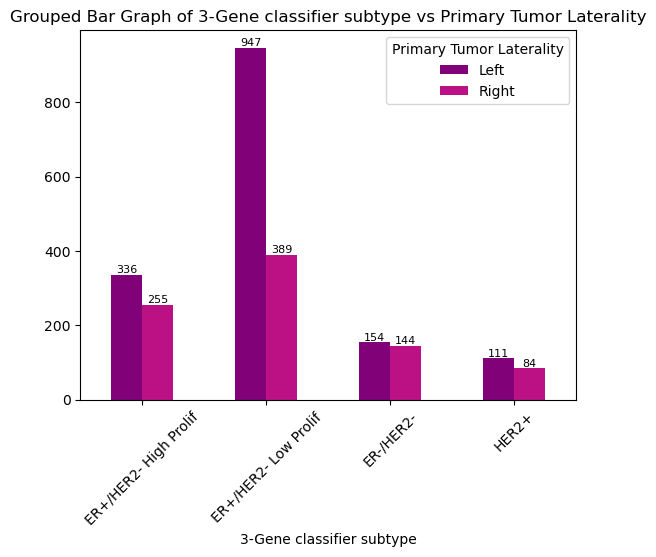

<Figure size 800x600 with 0 Axes>

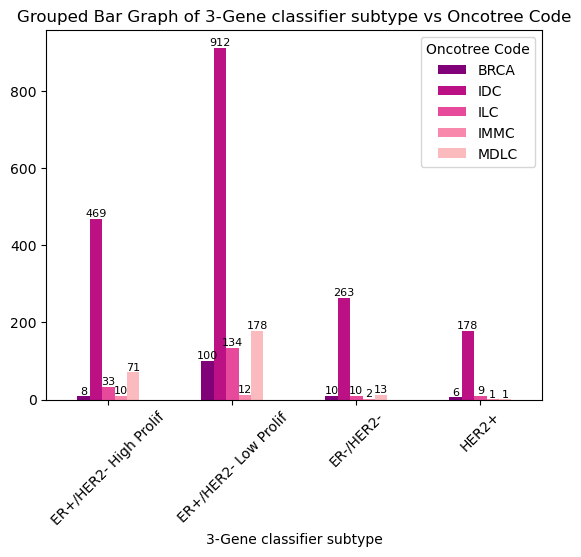

<Figure size 800x600 with 0 Axes>

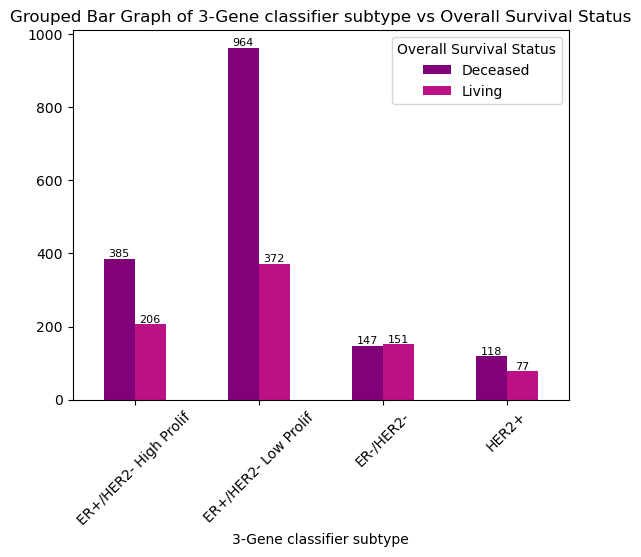

<Figure size 800x600 with 0 Axes>

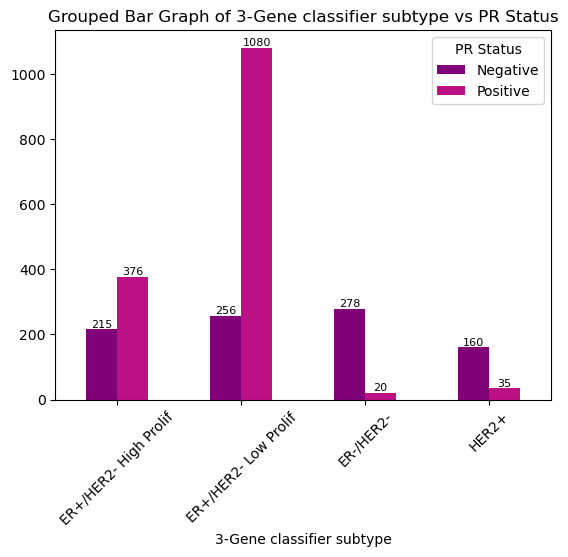

<Figure size 800x600 with 0 Axes>

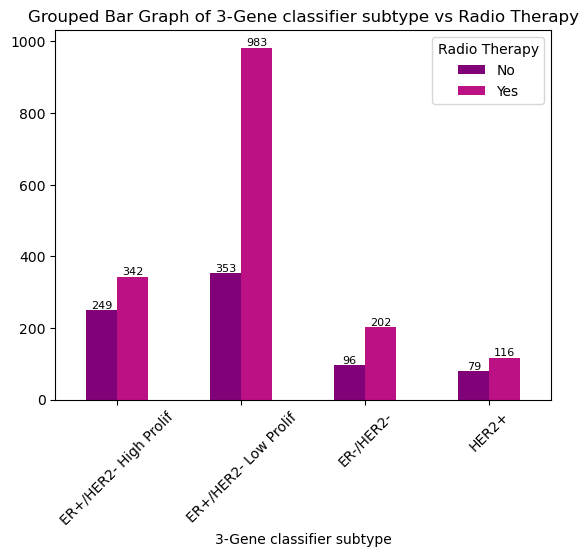

<Figure size 800x600 with 0 Axes>

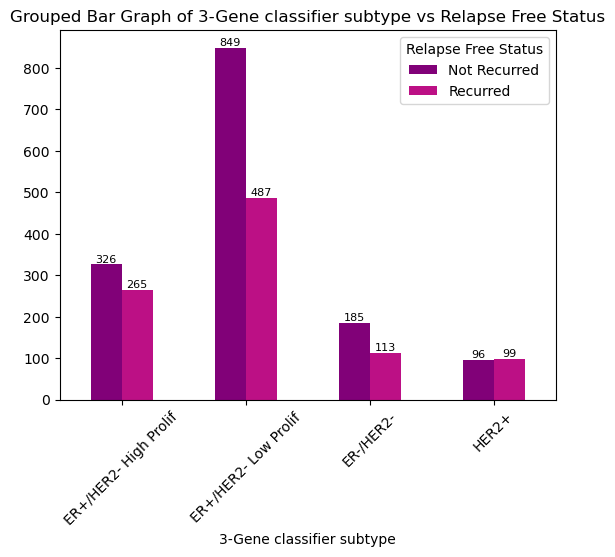

<Figure size 800x600 with 0 Axes>

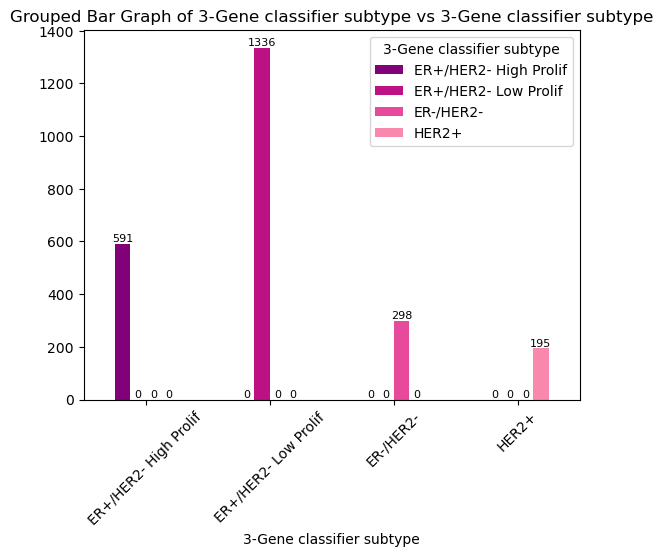

<Figure size 800x600 with 0 Axes>

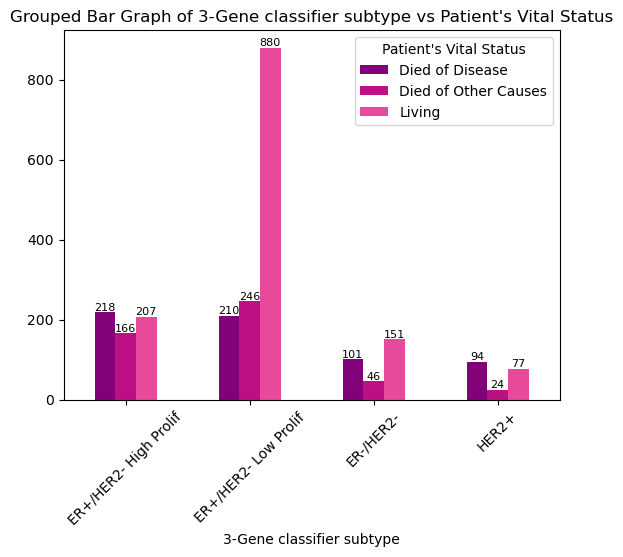

<Figure size 800x600 with 0 Axes>

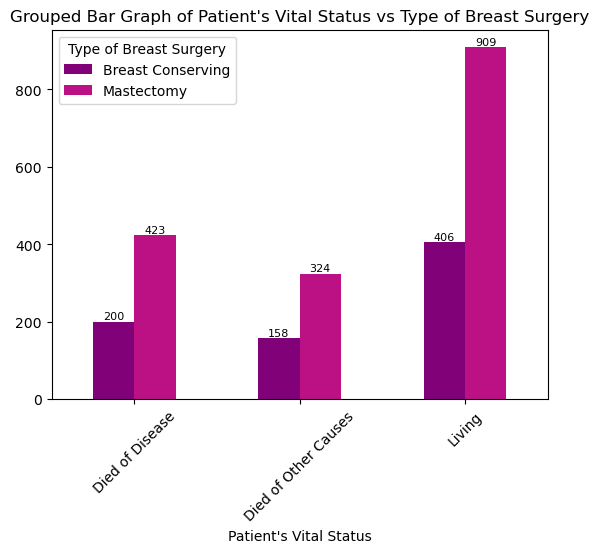

<Figure size 800x600 with 0 Axes>

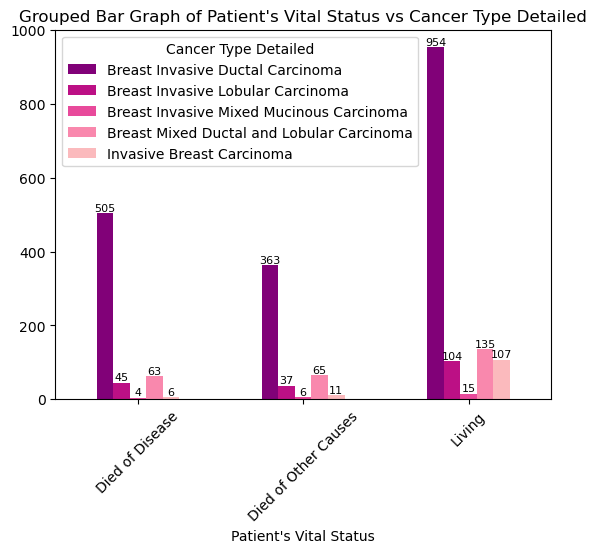

<Figure size 800x600 with 0 Axes>

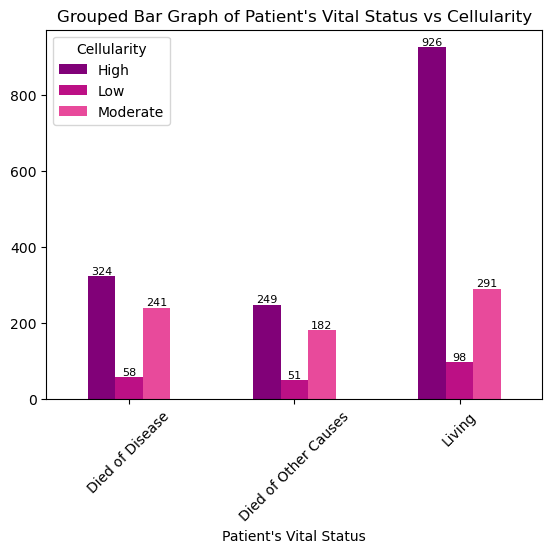

<Figure size 800x600 with 0 Axes>

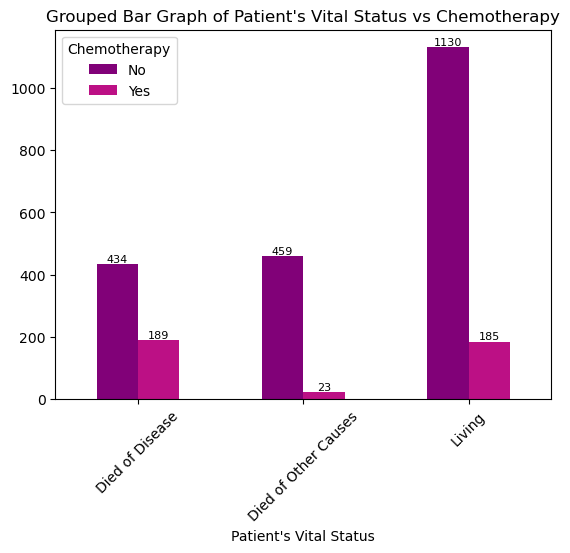

<Figure size 800x600 with 0 Axes>

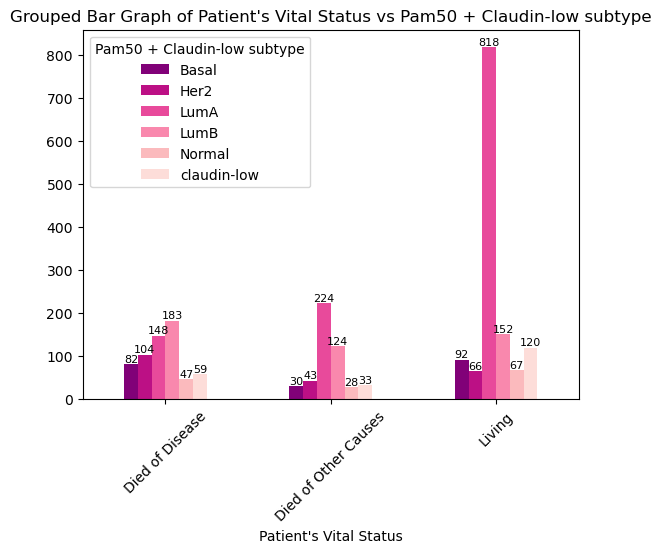

<Figure size 800x600 with 0 Axes>

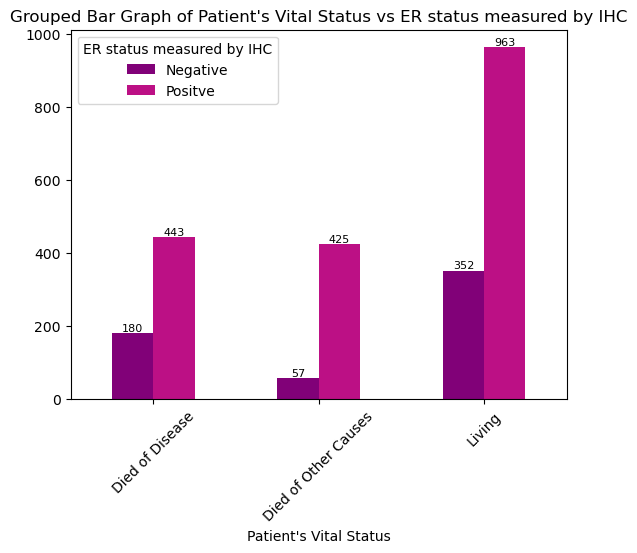

<Figure size 800x600 with 0 Axes>

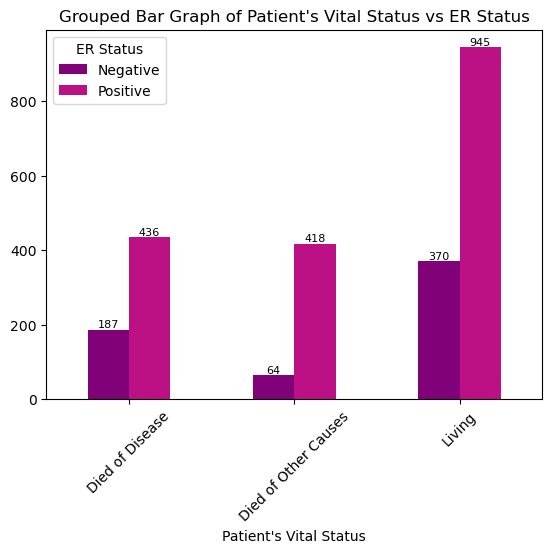

<Figure size 800x600 with 0 Axes>

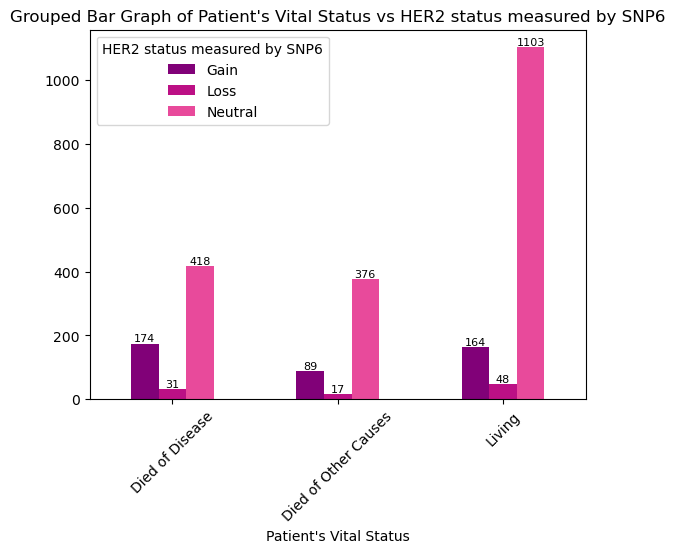

<Figure size 800x600 with 0 Axes>

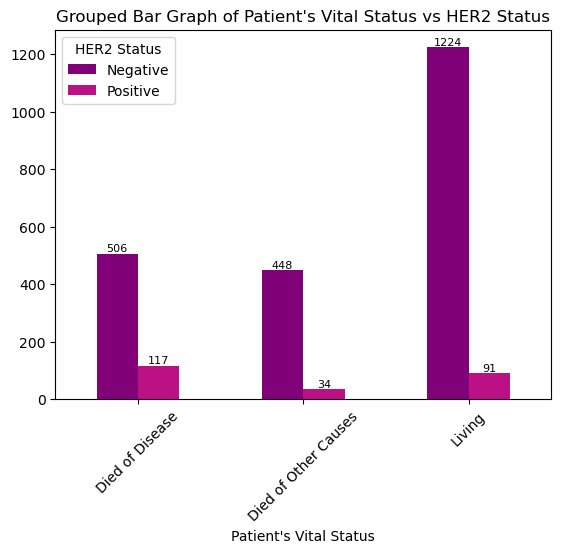

<Figure size 800x600 with 0 Axes>

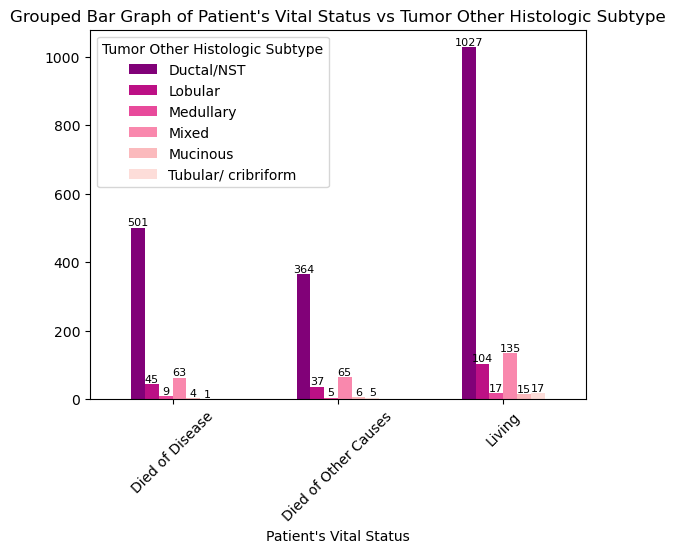

<Figure size 800x600 with 0 Axes>

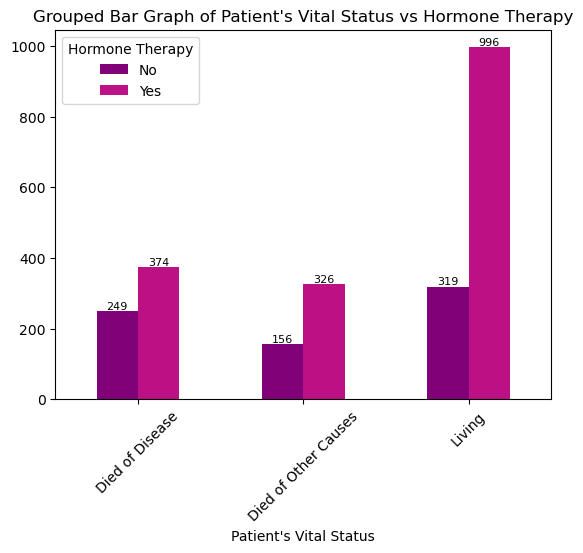

<Figure size 800x600 with 0 Axes>

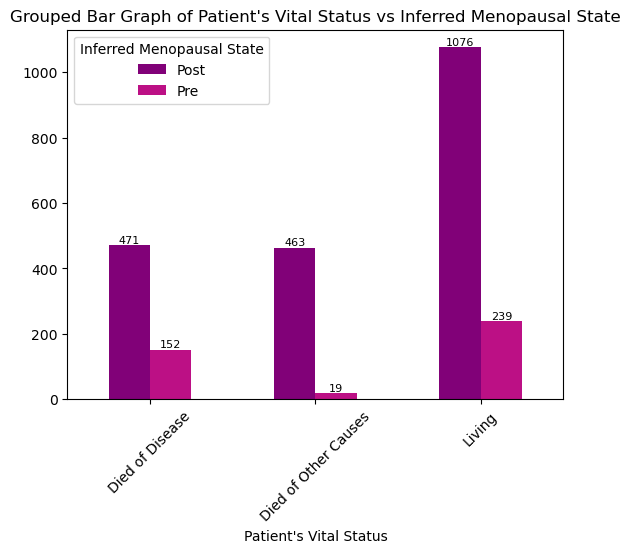

<Figure size 800x600 with 0 Axes>

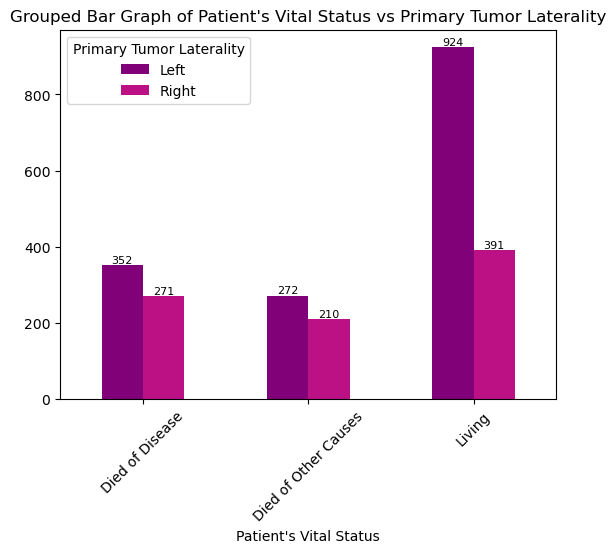

<Figure size 800x600 with 0 Axes>

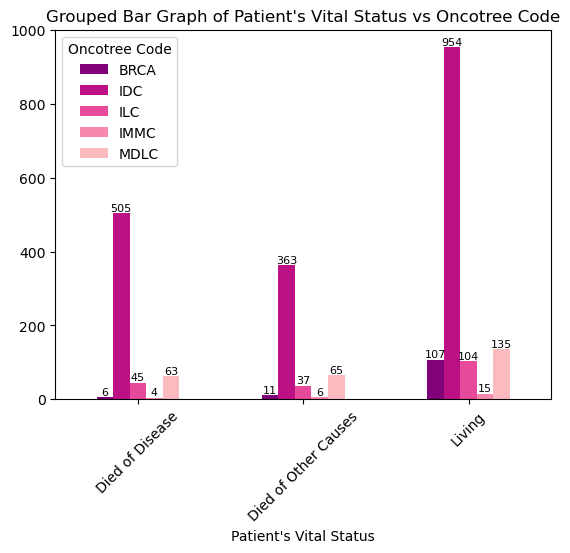

<Figure size 800x600 with 0 Axes>

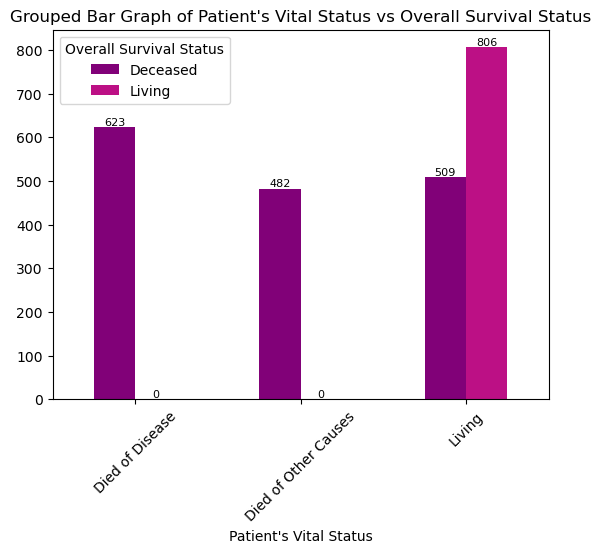

<Figure size 800x600 with 0 Axes>

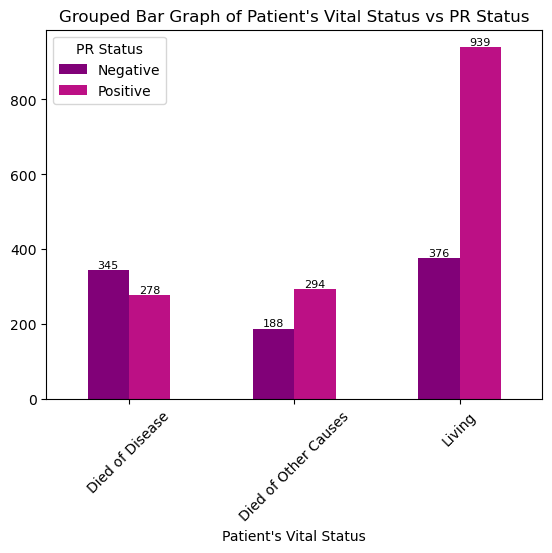

<Figure size 800x600 with 0 Axes>

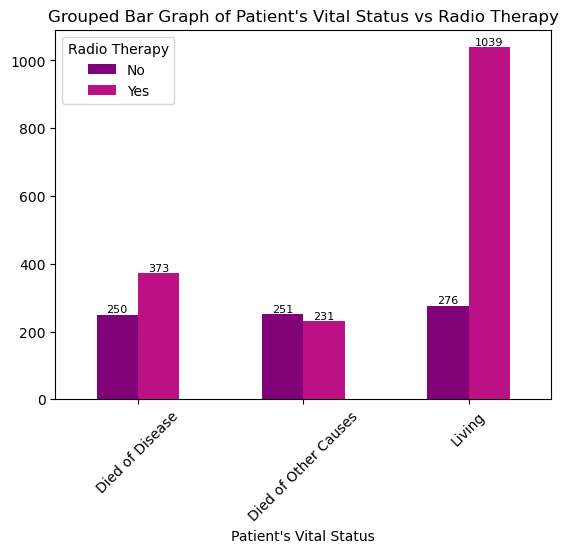

<Figure size 800x600 with 0 Axes>

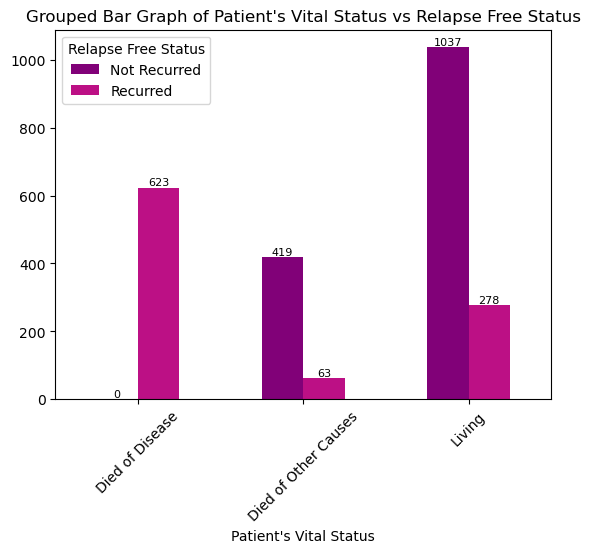

<Figure size 800x600 with 0 Axes>

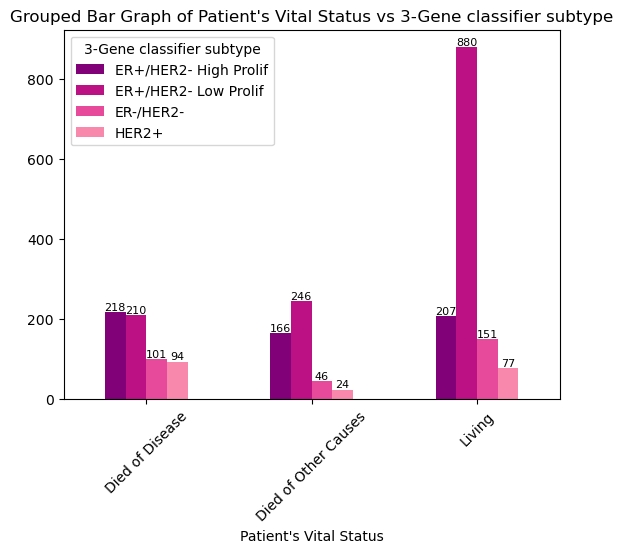

<Figure size 800x600 with 0 Axes>

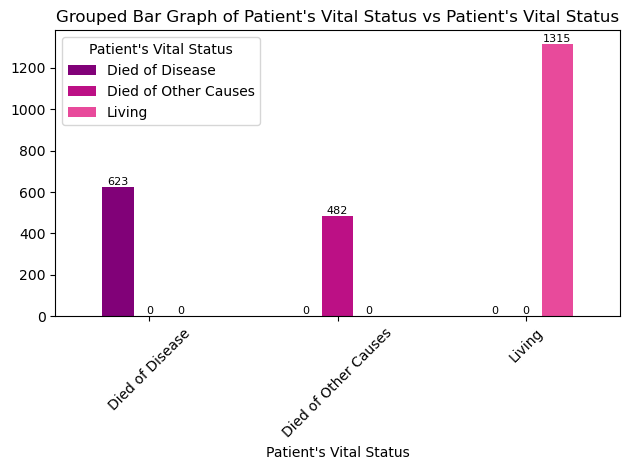

In [149]:
sns.set_palette("RdPu_r", 6)
for i, col1 in enumerate(categorical_columns):
    for j , col2 in enumerate(categorical_columns[i+1:]):
        plt.figure(figsize=(8, 6))
        df.groupby([col1, col2]).size().unstack().plot(kind='bar')
        plt.title(f"Grouped Bar Graph of {col1} vs {col2}")
        plt.xticks(rotation=45)
        
        for p in plt.gca().patches:
            height = p.get_height()
            x, y = p.get_xy()
            plt.annotate(f'{int(height)}', (x + p.get_width() / 2, y + height), ha='center', va='bottom', fontsize=8)
            
plt.tight_layout()
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

There are many graphs for the categorical vs categorical bivariate analysis. So let us take the observations from the most important ones.
* For example let us check the graph of Type of Breast Surgery vs Cellularity. Here, we can see that most of the distribution is similar in both types of surgery. Except that the count is different. So from such graphs, we cannot get much new information.
* Whereas if we check the graph of Type of Surgery vs Overall Survival Status, we can see that the distribution is not the same. Most of the patients i.e. 1255 patients who underwent the mastectomy surgery have passed away. Whereas only 359 patients who underwent the Breast-Conserving Surgery are deceased. Also, the living ratio of patients in both surgeries are same.
* Similarly, let us check the graph of Chemotherapy vs Inferred Menopausal State. Here, the distribution is different. Most of the women who were in post-menopause have not undergone chemotherapy. Whereas an equal number of women who were in post-menopause and pre-menopause underwent the chemotherapy.
* Checking the graph of Chemotherapy vs ER Status, we can see that most of the women who had positive ER Status have not undergone chemotherapy. Whereas, most of the women who received chemotherapy had a negative ER Status.

Similarly, we can check the difference in the distributions of the graph and then extract important information.

### <b><span style='color:#FF69B4'>Step 5.3.3 |</span><span style='color:#FF1493'> Numerical vs Target Bivariate Analysis</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

* In the data, we have two features "Patient's Vital Status" and "Overall Survival Status" that give the survival status of patients. The Overall Survival Status column gives information on whether the patients are "Living" or "Deceased". Whereas the Patient's Vital Status column gives more information on whether the patients are "Living", "Died of disease", or "Died of other causes". The Overall Survival Status considers both "Died of disease" and "Died of other causes" as "Deceased". But we want to predict how many patients die of the disease and how many will live. So we will use the "Patient's Vital Status" as the target column and drop the "Overall Survival Status" column.
* Since the value "Died of other causes" does not give much information, it cannot be dropped as it will lead to data loss. So we will instead isolate patients who "Died of disease" as "Y" and the rest two, i.e. "Living" and "Died of other causes" can be transformed into a single "N" value to balance the distributions and mainly target the risks/factors for "Y".
* 1 - "Y" - "Died of Disease" and 0 - "N" - "Did not die of disease"
* The target variable should also be encoded using label encoding to deal with numerical data. (Label encoding is mostly used to encode the target variable.) 

In [154]:
data = df.drop(['Overall Survival Status'], axis=1)

In [156]:
data['Patient\'s Vital Status'] = data['Patient\'s Vital Status'].apply(lambda x: 'Y' if x == 'Died of Disease' else 'N')

In [158]:
target_col = 'Patient\'s Vital Status' 

# Initializing and fitting LabelEncoder
label_encoder = LabelEncoder()
data[target_col] = label_encoder.fit_transform(data[target_col])

In [160]:
data.head()

,Age at Diagnosis,Type of Breast Surgery,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,Overall Survival (Months),PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,75.65,Mastectomy,Breast Invasive Ductal Carcinoma,High,No,claudin-low,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,4.0,Right,10.0,5.0,6.044,IDC,140.500000,Negative,Yes,138.65,Not Recurred,ER-/HER2-,22.0,2.0,0
1,43.19,Breast Conserving,Breast Invasive Ductal Carcinoma,High,No,LumA,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Pre,4.0,Right,0.0,2.0,4.020,IDC,84.633333,Positive,Yes,83.52,Not Recurred,ER+/HER2- High Prolif,10.0,1.0,0
2,48.87,Mastectomy,Breast Invasive Ductal Carcinoma,High,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Ductal/NST,Yes,Pre,3.0,Right,1.0,2.0,4.030,IDC,163.700000,Positive,No,151.28,Recurred,ER+/HER2- Low Prolif,15.0,2.0,1
3,47.68,Mastectomy,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Mixed,Yes,Pre,9.0,Right,3.0,1.0,4.050,MDLC,164.933333,Positive,Yes,162.76,Not Recurred,ER+/HER2- Low Prolif,25.0,2.0,0
4,76.97,Mastectomy,Breast Mixed Ductal and Lobular Carcinoma,High,Yes,LumB,1.0,Positve,Positive,3.0,Neutral,Negative,Mixed,Yes,Post,9.0,Right,8.0,2.0,6.080,MDLC,41.366667,Positive,Yes,18.55,Recurred,ER+/HER2- High Prolif,40.0,2.0,1


In [162]:
data.shape

(2420, 30)

### <b><span style='color:#FF69B4'>Statistical t-test

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Interpretation</font></h3>

1. **T-Statistic Interpretation**<br>
• Positive t-statistic: If the t-statistic is positive, it means that the mean of the feature for patients who died of the disease (group 2) is higher than the mean for those who did not die of disease (group 1).<br>
• Negative t-statistic: If the t-statistic is negative, it means that the mean of the feature for patients who died of the disease is lower than the mean for those who did not die of the disease.

2. **P-Value Interpretation**<br>
• Low p-value (e.g., p < 0.05): This suggests that the observed difference in means is statistically significant and unlikely to be due to random chance. It indicates that the feature differs significantly between the two groups.<br>
• High p-value (e.g., p >= 0.05): This suggests that the observed difference in means is not statistically significant. It indicates that there is insufficient evidence to conclude that the feature differs between the two groups.

4. **Summary**<br>
• If the t-statistic is positive and the p-value is low (e.g., < 0.05), this indicates that the feature's mean is significantly higher for patients who died of the disease than for those who did not.<br>
• If the t-statistic is negative and the p-value is low, this indicates that the feature's mean is significantly lower for patients who died of the disease than for those who did not.<br>
• If the p-value is high, regardless of whether the t-statistic is positive or negative, it indicates that the difference in means is not statistically significant, suggesting that this feature may not be strongly associated with the patient's vital status.

In [166]:
for col in numerical_columns:
    from scipy.stats import ttest_ind
    group1 = data[data['Patient\'s Vital Status'] == 0][col]
    group2 = data[data['Patient\'s Vital Status'] == 1][col]
    t_stat, p_value = ttest_ind(group1, group2)
    print(f"T-test for {col}:")
    print(f"t-statistic: {t_stat:.2f}")
    print(f"p-value: {p_value:.4f}")

T-test for Age at Diagnosis:
t-statistic: 0.03
p-value: 0.9796
T-test for Cohort:
t-statistic: 3.83
p-value: 0.0001
T-test for Neoplasm Histologic Grade:
t-statistic: -6.62
p-value: 0.0000
T-test for Integrative Cluster:
t-statistic: -2.09
p-value: 0.0366
T-test for Lymph nodes examined positive:
t-statistic: -11.90
p-value: 0.0000
T-test for Mutation Count:
t-statistic: -1.94
p-value: 0.0529
T-test for Nottingham prognostic index:
t-statistic: -11.09
p-value: 0.0000
T-test for Overall Survival (Months):
t-statistic: 21.60
p-value: 0.0000
T-test for Relapse Free Status (Months):
t-statistic: 22.75
p-value: 0.0000
T-test for Tumor Size:
t-statistic: -7.91
p-value: 0.0000
T-test for Tumor Stage:
t-statistic: -8.08
p-value: 0.0000


<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Inferences:</font></h3>

Putting all the interpretations and observations together we can conclude the following:
* Age at Diagnosis and Mutation Count does not have much significant difference and may not be strongly associated with the Patient's Vital Status because of a higher p-value.
* Overall Survival (Months) and Relapse Free Status (Months) have a comparatively higher t-statistic value with a p-value < 0.05, which suggests that they might have a strong association with the target variable.
* Cohort also has a good association with Patient's Vital Status, but less comparative to the Overall Survival (Months) and Relapse Free Status (Months).
* Lymph nodes examined positive, Nottingham prognostic index, Tumor Stage, Tumor Size, Neoplasm Histologic Grade, Integrative Cluster, and Mutation Count all have p-values < 0.05 with negative t-statistic values of -11.90, -11.09, -8.08, -7.91, -6.62, -2.09, and -1.94 respectively. This indicates that the features mean is significantly higher for patients who did not die of the disease than for those who died.<br>

Let us double-check if the observations are right using the visualization.

### <b><span style='color:#FF69B4'>KDE Plot

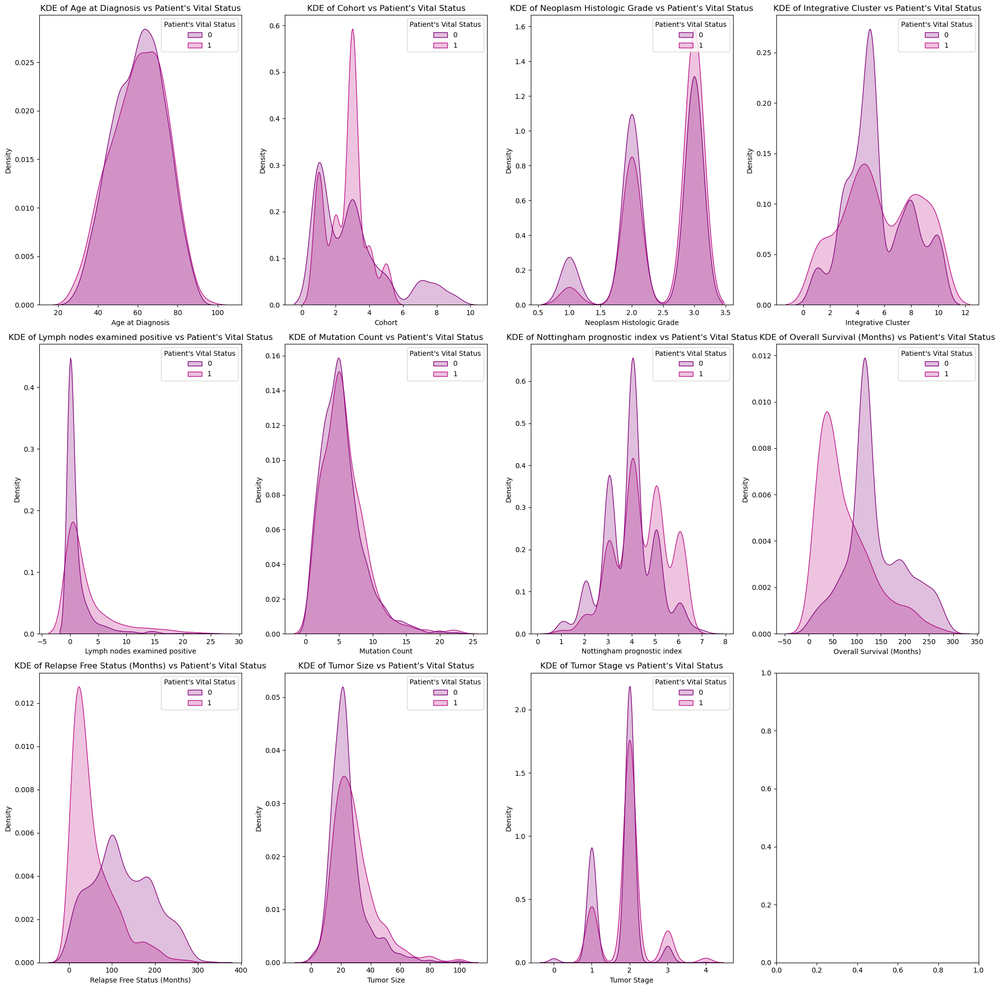

In [170]:
numerical_columns = data.iloc[:, [0, 6, 9, 15, 17, 18, 19, 21, 24, 27, 28]]

fig, axes = plt.subplots(3, 4, figsize=(20, 20))
# sns.set_palette("RdPu_r", 6)

axes = axes.flatten()

for i, col in enumerate(numerical_columns):
    sns.kdeplot(data=data, x=col, hue='Patient\'s Vital Status', ax=axes[i], color='#FF1493', fill=True, common_norm=False)
    axes[i].set_title(f'KDE of {col} vs {'Patient\'s Vital Status'}')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Density')

# Adjust layout
plt.tight_layout()
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Inferences:</font></h3>

We can see that the observations from the statistical test match that of the visualization.

1. **Age at Diagnosis vs Patient's Vital Status:** The distribution of "Age at Diagnosis" doesn't show a significant difference between the two vital status groups. But we can see that the proportion of patients who did not die of the disease is more than that of the patients who died of the disease at an average of 60 years.
2. **Cohort vs Patient's Vital Status:** Here, we can see that most of the patients of cohort group 3 died of the disease and patients of the groups greater than 6 did not die of the disease. 
3. **Neoplasm Histologic Grade vs Patient's Vital Status:** As the Neoplasm Histologic Grade increases, the density of the "Died" category also increases. In grades 1 and 2, the proportion of patients who did not die of the disease is higher, whereas in grade 3 the proportion of patients who died is higher.
4. **Integrative Cluster vs Patient's Vital Status:** Most of the patients of integrative clusters 4 to 6 did not die of the disease. Whereas, compared to other clusters, patients of cluster 4 have the highest number of deceased.
5. **Lymph nodes examined positive vs Patient's Vital Status**: Most of the patients whose number of lymph nodes examined positive are from 0 to 2 approximately did not die of the disease. Whereas those who had a greater number of positive lymph nodes died of the disease.
6. **Mutation Count vs Patient's Vital Status:** Similar to Age at Diagnosis, the distribution of "Mutation Count" doesn't show a significant difference between the two vital status groups. It's difficult to draw definitive conclusions about the impact of mutation count on survival.
7. **Nottingham prognostic index vs Patient's Vital Status:** There is a good proportion of patients who did not die of the disease till the 4th prognostic score. It is observed that as the prognostic score increases the patients who die of the disease also increases.
8. **Overall Survival (Months) vs Patient's Vital Status:** These two variables quite follow the trend, that is low survival months indicate more deaths because of the disease, and high survival months indicate less number of deaths. Also, most of the patients died within 50 months of the disease and most of the patients had a good survival rate between 100 to 125 months approximately.
9. **Relapse Free Status (Months) vs Patient's Vital Status:** A majority of the patients who had a relapse of cancer within 0 to 50 months died of the disease. Most of the patients were alive when they did not have a relapse within 120 months.
10. **Tumor Size vs Patient's Vital Status:** Tumor size 20 has the highest proportion of both the status group with patients who did not die of the disease being more. As the tumor size increases the number of deaths also increases.
11. **Tumor Stage vs Patient's Vital Status:** There is a good proportion of patients who did not die of the disease till the tumor stage 2. Patients who had tumor stages greater than two died of the disease.

### <b><span style='color:#FF69B4'>Step 5.3.4 |</span><span style='color:#FF1493'> Categorical vs Target Bivariate Analysis</span></b>

### <b><span style='color:#FF69B4'>Chi-square test

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Interpretation</font></h3>

1. **Chi-square-Statistic Interpretation**<br>
• Higher Chi-square statistic: A high Chi-square value suggests that the observed counts differ considerably from the expected counts under the assumption of independence. This indicates a strong association between the feature and the target variable.<br>
• Lower Chi-square statistic: A low Chi-square value suggests that the observed counts are close to the expected counts, indicating that there may be little to no association between the feature and the target variable.

2. **P-Value Interpretation**<br>
• Low p-value (e.g., p < 0.05): This suggests that the observed difference in means is statistically significant and unlikely to be due to random chance. It indicates that the feature differs significantly between the two groups.<br>
• High p-value (e.g., p >= 0.05): This suggests that the observed difference in means is not statistically significant. It indicates that there is insufficient evidence to conclude that the feature differs between the two groups.

4. **Summary**<br>
• If the Chi-square statistic is high and the p-value is low (e.g., < 0.05), this suggests a strong and statistically significant association between the categorical feature and the patient's vital status.<br>
• If the Chi-square statistic is low and the p-value is high (e.g., ≥ 0.05), this suggests that there is no significant association between the categorical feature and the patient's vital status.<br>

In [176]:
categorical_columns = data.iloc[:, [1, 2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 16, 20, 22, 23, 25, 26]]
for i, col in enumerate(categorical_columns):
    crosstab = pd.crosstab(data[col], data['Patient\'s Vital Status'], normalize='index') * 100
    chi2, p, dof, expected = chi2_contingency(crosstab)
    print(f"Chi-square test for {col}:")
    print(f"Chi-square statistic: {chi2:.2f}")
    print(f"p-value: {p:.4f}")

Chi-square test for Type of Breast Surgery:
Chi-square statistic: 0.00
p-value: 1.0000
Chi-square test for Cancer Type Detailed:
Chi-square statistic: 21.57
p-value: 0.0002
Chi-square test for Cellularity:
Chi-square statistic: 3.67
p-value: 0.1592
Chi-square test for Chemotherapy:
Chi-square statistic: 13.99
p-value: 0.0002
Chi-square test for Pam50 + Claudin-low subtype:
Chi-square statistic: 35.62
p-value: 0.0000
Chi-square test for ER status measured by IHC:
Chi-square statistic: 0.72
p-value: 0.3948
Chi-square test for ER Status:
Chi-square statistic: 0.60
p-value: 0.4382
Chi-square test for HER2 status measured by SNP6:
Chi-square statistic: 8.11
p-value: 0.0173
Chi-square test for HER2 Status:
Chi-square statistic: 12.65
p-value: 0.0004
Chi-square test for Tumor Other Histologic Subtype:
Chi-square statistic: 25.32
p-value: 0.0001
Chi-square test for Hormone Therapy:
Chi-square statistic: 3.17
p-value: 0.0748
Chi-square test for Inferred Menopausal State:
Chi-square statistic: 3

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Inferences:</font></h3>

Putting all the interpretations and observations together we can conclude the following:
* **High Chi-square & Low p-value:** Cancer Type Detailed, Chemotherapy, Pam50 + Claudin-low subtype, HER2 status measured by SNP6, HER2 Status, Relapse Free Status, 3-Gene classifier subtype, Oncotree Code, PR Status, and Tumor Other Histologic Subtype have a strong and statistically significant association with the patient's vital status.
  
List of features from high association to low association:<br>
Relapse Free Status (92.55), Pam50 + Claudin-low subtype (35.62), Tumor Other Histologic Subtype (25.32), 3-Gene classifier subtype (24.35), Oncotree Code and Cancer Type Detailed (21.57), Chemotherapy (13.99), HER2 Status (12.65), and HER2 status measured by SNP6 (8.11)

* **Low Chi-square & High p-value:** Radio Therapy, Primary Tumor Laterality, Inferred Menopausal State, Hormone Therapy, ER Status, ER status measured by IHC, Cellularity, and Type of Breast Surgery have no significant association with the patient's vital status.

Let us double-check if the observations are right using the visualization.

### <b><span style='color:#FF69B4'>Stacked Bar Plot

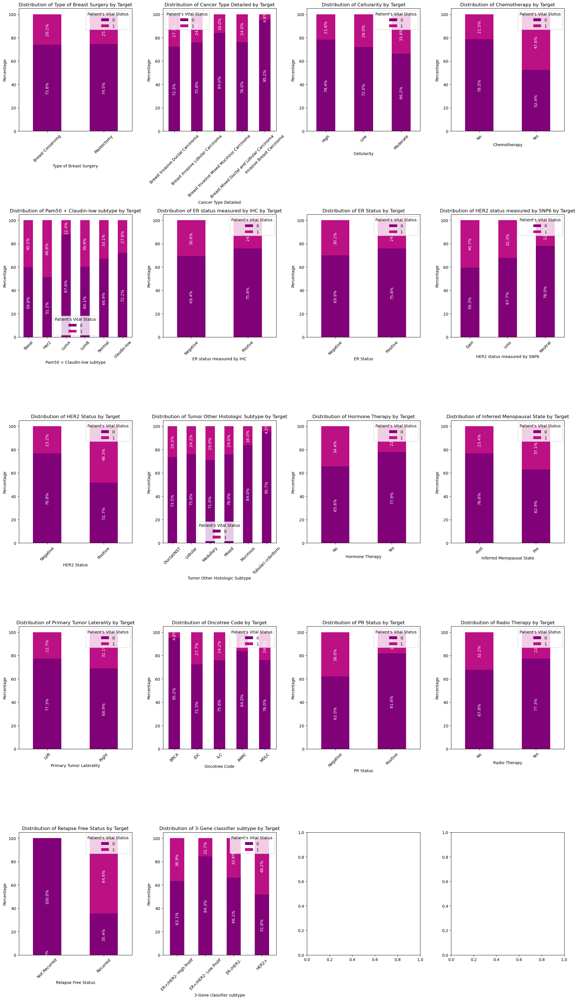

In [180]:
fig, axes = plt.subplots(5, 4, figsize=(20, 35))

axes = axes.flatten()

for i, col in enumerate(categorical_columns):
    crosstab = pd.crosstab(data[col], data['Patient\'s Vital Status'], normalize='index') * 100
    crosstab.plot(kind='bar', stacked=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col} by Target')
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Percentage')
    axes[i].tick_params(axis='x', rotation=45)

    for p in axes[i].patches:
        width, height = p.get_width(), p.get_height()
        x, y = p.get_xy()
        axes[i].annotate(f'{height:.1f}%', (x + width/2, y + height/2), ha='center', va='center', color='white', rotation=90)

plt.tight_layout()
plt.show()

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">

<h3 align="left"><font color=#FF1493>Inferences:</font></h3>

We can see that the observations from the statistical test match those of the visualization.

1. **Type of Breast Surgery by Target:** The distribution doesn't show a significant difference between the two vital status groups. The percentage of the status "Died of Disease" is almost the same with 26.2% of deaths in breast-conserving surgery and 25.5% of deaths in mastectomy surgery.
2. **Cancer Type Detailed by Target:** Here, we can see that most of the patients who had breast invasive ductal carcinoma had the highest percentage of deaths compared to other cancer types. Whereas, only 4.8% of the patients who had invasive breast carcinoma were deceased.
3. **Cellularity by Target:** Patients with high cellularity are less prone to die of the disease.
4. **Chemotherapy by Target:** Patients who have undergone chemotherapy have an approximately equal percentage of living and dying of the disease. Whereas we can see that patients who have not received chemotherapy have higher rates of survival.
5. **Pam50 + Claudin-low subtype by Target:** The LumA subtype shows a very low percentage of deaths and the Her2 subtype shows a high percentage of deaths.
6. **ER status measured by IHC by Target:** The distribution doesn't show a significant difference between the two vital status groups. It's difficult to draw definitive conclusions about the impact of this feature on survival.
7. **ER Status by Target:** Similar conclusion as the ER Status measured by IHC. 
8. **HER2 status measured by SNP6:** This distribution shows that people with neutral HER2 status have better survival rates than the people with gain HER2 status.
9. **HER2 Status by Target:** Patients with positive HER2 status have an approximately equal percentage of living and dying of the disease. Whereas we can see that patients who have negative HER2 status have higher rates of survival.
10. **Tumor Other Histologic Subtype by Target:** The Tubular/cribriform subtype shows a very low percentage of deaths (4.3%) and the Medullary subtype shows a high percentage of deaths (29%).
11. **Hormone Therapy by Target:** 77.9% of the patients who have undergone hormone therapy are living. And 5.6% of the patients who have not undergone hormone therapy are living.
12. **Inferred Menopausal State by Target:** Women in pre-menopausal states have a higher death percentage than those in post-menopausal states.
13. **Primary Tumor Laterality by Target:** Women who have tumors in their left breast are considered to have a higher survival rate than those who have tumors in their right breast.
14. **Oncotree Code by Target:** The survival/living rates are higher in all types of oncotree codes. With the BRCA code having the highest percentage of 95.2 living status. Whereas the IDC code has 72.3% of living status.
15. **PR Status by Target:** It is seen that patients with positive PR status have good survival rates of 81.6%.
16. **Radio therapy by Target:** The difference between the deaths of patients who received the radiotherapy and those who did not is about 10%, where patients who received radiotherapy have a higher living percentage.
17. **Relapse Free Status by Target:** Patients who did not have a relapse of cancer have a 100% survival rate. Whereas the percentage of the patients who are still living is 35.4%.
18. **3-Gene classifier subtype by Target:** The ER+/HER2- Low Prolif subtype shows a very low percentage of deaths (15.7%) and the HER2+ subtype shows a high percentage of deaths (48.2%).

## <b><span style='color:#FF69B4'>Step 5.4 |</span><span style='color:#FF1493'> Survival Analysis</span></b>

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">
This project's aim is to develop a comprehensive survival analysis model and a robust machine learning model to accurately predict 10-year mortality risk for breast cancer patients. We can predict the 10-year mortality risk later after our model training without having to drop data but for the survival analysis and detailed visualization let us trim the existing data to acquire new data only consisting of patients who survived after 10 years and who died within 10 years. 

In [188]:
df.shape

(2420, 31)

In [190]:
df.drop(['Overall Survival Status'], axis=1, inplace=True)

In [192]:
N = df[(df["Patient's Vital Status"].isin(['Living', 'Died of other causes'])) & (df['Overall Survival (Months)'] >= 120)]
Y = df[(df["Patient's Vital Status"] == 'Died of Disease') & (df['Overall Survival (Months)'] < 120)]

In [194]:
tenyears = pd.concat([N, Y])

In [196]:
tenyears.head()

,Age at Diagnosis,Type of Breast Surgery,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,Overall Survival (Months),PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,75.65,Mastectomy,Breast Invasive Ductal Carcinoma,High,No,claudin-low,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,4.0,Right,10.0,5.0,6.044,IDC,140.500000,Negative,Yes,138.65,Not Recurred,ER-/HER2-,22.0,2.0,Living
3,47.68,Mastectomy,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Mixed,Yes,Pre,9.0,Right,3.0,1.0,4.050,MDLC,164.933333,Positive,Yes,162.76,Not Recurred,ER+/HER2- Low Prolif,25.0,2.0,Living
6,56.45,Breast Conserving,Breast Invasive Ductal Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Loss,Negative,Ductal/NST,Yes,Post,3.0,Right,1.0,4.0,4.020,IDC,164.333333,Positive,Yes,162.17,Not Recurred,ER+/HER2- Low Prolif,10.0,2.0,Living
13,70.91,Breast Conserving,Breast Invasive Ductal Carcinoma,High,No,LumB,1.0,Positve,Positive,1.0,Gain,Negative,Ductal/NST,Yes,Post,4.0,Left,0.0,3.0,2.042,IDC,163.533333,Positive,Yes,161.38,Not Recurred,ER+/HER2- Low Prolif,21.0,1.0,Living
14,45.27,Mastectomy,Breast Invasive Ductal Carcinoma,High,Yes,claudin-low,1.0,Negative,Negative,3.0,Neutral,Negative,Ductal/NST,No,Pre,4.0,Right,3.0,5.0,5.038,IDC,164.900000,Positive,Yes,105.99,Recurred,ER+/HER2- Low Prolif,19.0,2.0,Living


In [198]:
# Specify the name of your target column
target_col = 'Patient\'s Vital Status'  # Replace with the actual target column name

# Initialize and fit LabelEncoder
label_encoder = LabelEncoder()
tenyears[target_col] = label_encoder.fit_transform(tenyears[target_col])

In [200]:
tenyears.head()

,Age at Diagnosis,Type of Breast Surgery,Cancer Type Detailed,Cellularity,Chemotherapy,Pam50 + Claudin-low subtype,Cohort,ER status measured by IHC,ER Status,Neoplasm Histologic Grade,HER2 status measured by SNP6,HER2 Status,Tumor Other Histologic Subtype,Hormone Therapy,Inferred Menopausal State,Integrative Cluster,Primary Tumor Laterality,Lymph nodes examined positive,Mutation Count,Nottingham prognostic index,Oncotree Code,Overall Survival (Months),PR Status,Radio Therapy,Relapse Free Status (Months),Relapse Free Status,3-Gene classifier subtype,Tumor Size,Tumor Stage,Patient's Vital Status
0,75.65,Mastectomy,Breast Invasive Ductal Carcinoma,High,No,claudin-low,1.0,Positve,Positive,3.0,Neutral,Negative,Ductal/NST,Yes,Post,4.0,Right,10.0,5.0,6.044,IDC,140.500000,Negative,Yes,138.65,Not Recurred,ER-/HER2-,22.0,2.0,1
3,47.68,Mastectomy,Breast Mixed Ductal and Lobular Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Neutral,Negative,Mixed,Yes,Pre,9.0,Right,3.0,1.0,4.050,MDLC,164.933333,Positive,Yes,162.76,Not Recurred,ER+/HER2- Low Prolif,25.0,2.0,1
6,56.45,Breast Conserving,Breast Invasive Ductal Carcinoma,Moderate,Yes,LumB,1.0,Positve,Positive,2.0,Loss,Negative,Ductal/NST,Yes,Post,3.0,Right,1.0,4.0,4.020,IDC,164.333333,Positive,Yes,162.17,Not Recurred,ER+/HER2- Low Prolif,10.0,2.0,1
13,70.91,Breast Conserving,Breast Invasive Ductal Carcinoma,High,No,LumB,1.0,Positve,Positive,1.0,Gain,Negative,Ductal/NST,Yes,Post,4.0,Left,0.0,3.0,2.042,IDC,163.533333,Positive,Yes,161.38,Not Recurred,ER+/HER2- Low Prolif,21.0,1.0,1
14,45.27,Mastectomy,Breast Invasive Ductal Carcinoma,High,Yes,claudin-low,1.0,Negative,Negative,3.0,Neutral,Negative,Ductal/NST,No,Pre,4.0,Right,3.0,5.0,5.038,IDC,164.900000,Positive,Yes,105.99,Recurred,ER+/HER2- Low Prolif,19.0,2.0,1


In [202]:
tenyears.shape

(1043, 30)

<div style="border-radius:10px; padding: 15px; background-color: #FFB6C1; font-size:115%; text-align:left">
From both the Numerical vs Target and Categorical vs Target Bivariate Analysis we can observe that apart from Radio Therapy, Primary Tumor Laterality, Inferred Menopausal State, Hormone Therapy, ER Status, ER status measured by IHC, Cellularity, Type of Breast Surgery, Age at Diagnosis, and Mutation Count all the other features show good significant association with the target variable "Patient's Vital Status".
    
<br>**Features with significant association:**<br>
Cancer Type Detailed, Chemotherapy, Pam50 + Claudin-low subtype, HER2 status measured by SNP6, HER2 Status, Relapse Free Status, 3-Gene classifier subtype, Oncotree Code, PR Status, Tumor Other Histologic Subtype, Lymph nodes examined positive, Nottingham prognostic index, Tumor Stage, Tumor Size, Neoplasm Histologic Grade, Integrative Cluster, Mutation Count, Cohort, Overall Survival (Months) and Relapse Free Status (Months).

Let us use few of these features in the survival analysis and check how they impact the survival status.

### <b><span style='color:#FF69B4'>Kaplan Meier Survival Curve

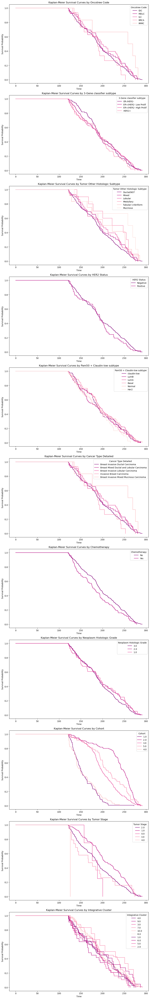

In [206]:
# List of columns to use for grouping
group_columns = ['Oncotree Code', '3-Gene classifier subtype', 'Tumor Other Histologic Subtype', 'HER2 Status', 'Pam50 + Claudin-low subtype', 
                 'Cancer Type Detailed', 'Chemotherapy', 'Neoplasm Histologic Grade', 'Cohort', 'Tumor Stage', 'Integrative Cluster']

fig, axes = plt.subplots(len(group_columns), 1, figsize=(10, 6 * len(group_columns)))
axes = axes.flatten()  # Flatten in case there's only one subplot

# Looping through each column and plot Kaplan-Meier curves
for idx, group_column in enumerate(group_columns):
    ax = axes[idx]  # Get the subplot axis for the current feature
    kmf = KaplanMeierFitter()  # Initialize Kaplan-Meier fitter
    
    # Looping through each unique group in the current column
    for group in tenyears[group_column].unique():
        mask = tenyears[group_column] == group
        kmf.fit(durations=tenyears[mask]['Overall Survival (Months)'], event_observed=tenyears[mask]['Patient\'s Vital Status'], label=str(group))
        kmf.plot_survival_function(ax=ax, ci_show=False)  
    
    ax.set_title(f"Kaplan-Meier Survival Curves by {group_column}")
    ax.set_xlabel("Time")
    ax.set_ylabel("Survival Probability")
    ax.legend(title=group_column)

plt.tight_layout()
plt.show()

In [208]:
data.to_csv('Breast_Cancer_Data.csv', sep=',', index=False, encoding='utf-8')

In [210]:
import gc
gc.collect()

3407